<a href="https://colab.research.google.com/github/Szuyingpan/NLP_Transformers-/blob/main/5_Beyond_Binary_Opinions_Exploring_Political_Polarisation_with_Transformer_Based_Algorithms.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install ipython-autotime
%load_ext autotime

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 71.6 MB/s eta 0:00:00
time: 271 µs (started: 2024-07-25 16:19:19 +00:00)


In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

/bin/bash: line 1: nvidia-smi: command not found


In [ ]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 54.8 gigabytes of available RAM

You are using a high-RAM runtime!


# 1. Import libraby

In [ ]:
import nltk
nltk.download('sentiwordnet')
nltk.download('wordnet')
nltk.download('punkt')

[nltk_data] Downloading package sentiwordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/sentiwordnet.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
!pip install transformers torch

  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl.metadata (1.8 kB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinu

In [ ]:
!pip install scikit-learn

time: 2.31 s (started: 2024-07-25 16:20:35 +00:00)


In [ ]:
!pip install accelerate

  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl.metadata (1.8 kB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinu

In [ ]:
!pip install vaderSentiment

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 126.0/126.0 kB 9.9 MB/s eta 0:00:00
time: 2.42 s (started: 2024-07-25 16:19:44 +00:00)


In [ ]:
!pip install textblob

time: 2.31 s (started: 2024-07-25 16:19:41 +00:00)


# **Import Library** <a name="import-libraries"></a>

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sn

import tensorflow as tf

import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from textblob import TextBlob

import torch
import accelerate
from transformers import BertTokenizer, BertForSequenceClassification, DistilBertTokenizer, DistilBertForSequenceClassification, Trainer, TrainingArguments
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score
from torch.utils.data import DataLoader, Dataset


In [ ]:
import transformers

print(transformers.__version__)
print(torch.__version__)
print(accelerate.__version__)

4.42.4
2.3.1+cu121
0.32.1




1. US president election in 2020 from HuggingFace
- https://huggingface.co/datasets/munawwarsultan2017/US_Presidential_Election_2020_Dem_Rep
- Two datasets in csv (Democratic and Republic)
- Vader sentiment values ( Positive, Neutral and Negative)
2. Brexit Polarity Tweets in 2022 from Kaggle
- https://www.kaggle.com/datasets/visalakshiiyer/twitter-data-brexit
- Two dataset in csv ( AntiBrexit vs. ProBrexit)
- Sentiment (Negative, Neural, Not Rated, Positive)


Classified into 5 sentiments: Extremely positive, positive, neutral, negative, extremely negative



3. Apply BERT, VADER and TextBlob sentimentic analyzer
4. Apply BERT and DistilBERT models to compare results

Through the transformers library, using a pre-trained BERT model for later sentiment analysis purpose.

Categorizes the sentiment score (between -1 to 1) into one of five.

Test1
categories:
- Extremely Positive (5): Score ≥ 0.5
- Positive (4): 0.1 < Score < 0.5
- Neutral (3): -0.1 ≤ Score ≤ 0.1
- Negative (2): -0.5 ≤ Score < -0.1
- Extremely Negative (1): Score < -0.5

Test2
- Extremely Positive (5): Score ≥ 0.6
- Positive (4): 0.2 < Score < 0.6
- Neutral (3): -0.2 ≤ Score ≤ 0.2
- Negative (2): -0.6 ≤ Score < -0.2
- Extremely Negative (1): Score < -0.6

**Test3**
- Extremely Positive (5): Score ≥ 0.9
- Positive (4): 0.7 < Score < 0.9
- Neutral (3): -0.7 ≤ Score ≤ 0.7
- Negative (2): -0.9 ≤ Score < -0.7
- Extremely Negative (1): Score < -0.9

# 1. Import Dataset

# **Dataset 1: US Democratic** <a name="import-democratic"></a>


#### total 1,871,593 rows and 3 columns

In [ ]:
# Read democratic dataset
df_democratic = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/US_Presidential_Election_2020_Dem_Rep /democratic.csv')
df_democratic

,Unnamed: 0,text_clean,Vader_Sentiment
0,0,let elect ten woman congress please follow gre...,Positive
1,1,india welcome noble cause nation every country...,Positive
2,2,poll frontrunner run,Neutral
3,3,important new paper evaluation availab,Positive
4,4,youth experience allow build,Positive
...,...,...,...
244598,244598,two first thing remove populace tyranny commun...,Neutral
244599,244599,election consequence often dire destroy whole ...,Negative
244600,244600,gov newsom lie constituent completely unprotec...,Negative
244601,244601,get much do great protective wall donald rest ...,Positive


In [ ]:
df_democratic.shape

(244603, 3)

In [ ]:
# Check the values in vader sentiment

df_democratic['Vader_Sentiment'].value_counts()

Vader_Sentiment
Positive    122551
Negative     62633
Neutral      59419
Name: count, dtype: int64

In [ ]:
# Check any missing values

df_democratic.isnull().all()

Unnamed: 0         False
text_clean         False
Vader_Sentiment    False
dtype: bool

### No missing values for democartic dataset


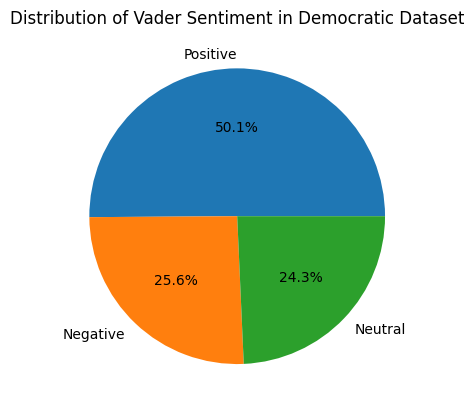

In [ ]:
import matplotlib.pyplot as plt
# Pie chart for Vader sentiment
vader_counts = df_democratic['Vader_Sentiment'].value_counts()
plt.pie(vader_counts.values, labels=vader_counts.index, autopct='%1.1f%%')
plt.title('Distribution of Vader Sentiment in Democratic Dataset')
plt.show()


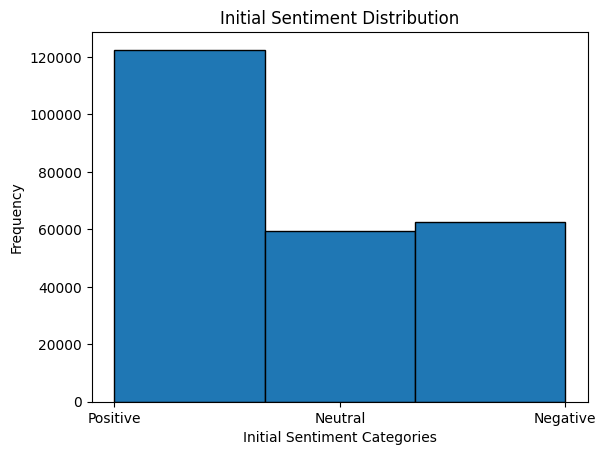

In [ ]:
# Plot initial sentiment distribution

plt.hist(df_democratic['Vader_Sentiment'], bins=3, edgecolor='k')
plt.xlabel('Initial Sentiment Categories')
plt.ylabel('Frequency')
plt.title('Initial Sentiment Distribution')
plt.show()

## Define thresholds for extremely sentiments

In [ ]:
from transformers import pipeline

time: 911 ms (started: 2024-07-19 21:10:16 +00:00)


## 1.1 Apply BERT Sentiment Analysis Pipline

In [ ]:
# Initialize BERT sentiment analysis pipeline

sentiment_pipeline = pipeline("sentiment-analysis")

No model was supplied, defaulted to distilbert/distilbert-base-uncased-finetuned-sst-2-english and revision af0f99b (https://huggingface.co/distilbert/distilbert-base-uncased-finetuned-sst-2-english).
Using a pipeline without specifying a model name and revision in production is not recommended.
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/629 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

Hardware accelerator e.g. GPU is available in the environment, but no `device` argument is passed to the `Pipeline` object. Model will be on CPU.


time: 4.32 s (started: 2024-07-19 21:10:17 +00:00)


In [ ]:
# Convert all entries in 'text_clean' to strings

df_democratic['text_clean'] = df_democratic['text_clean'].astype(str)

time: 9.44 ms (started: 2024-07-19 21:10:21 +00:00)


In [ ]:
# Define function to calculate sentiment score by using BERT

def bert_sentiment(text):
    result = sentiment_pipeline(text)[0]
    if result['label'] == 'NEGATIVE':
        return -result['score']
    else:
        return result['score']

time: 500 µs (started: 2024-07-19 21:14:35 +00:00)


In [ ]:
# Apply the function to the 'text_clean' column

df_democratic['bert_sentiment_score'] = df_democratic['text_clean'].apply(bert_sentiment)

print(df_democratic['bert_sentiment_score'])

# Save Democratic file
save_path = '/content/drive/MyDrive/US_D_BERT_updated.csv'
df_democratic.to_csv(save_path, index=False)

0         0.999454
1         0.999513
2         0.634101
3        -0.984247
4         0.998071
            ...   
244598   -0.898586
244599   -0.999302
244600   -0.997147
244601   -0.663381
244602   -0.997171
Name: bert_sentiment_score, Length: 244603, dtype: float64
time: 1h 6min 33s (started: 2024-07-19 21:15:13 +00:00)


In [ ]:
# Save Democratic file
save_path = '/content/drive/MyDrive/US_D_BERT_updated.csv'
df_democratic.to_csv(save_path, index=False)

time: 1.61 s (started: 2024-07-19 22:21:48 +00:00)


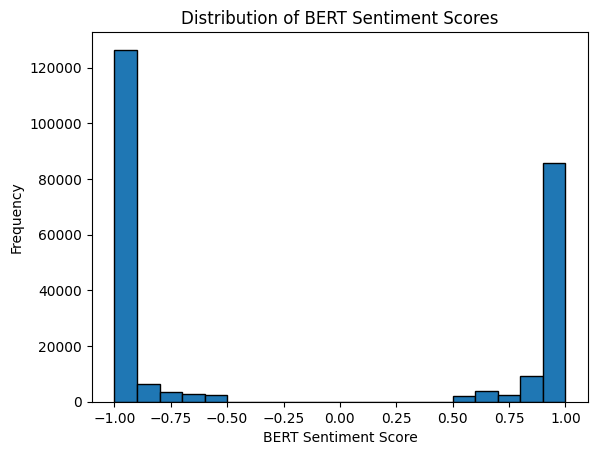

time: 242 ms (started: 2024-07-19 22:21:50 +00:00)


In [ ]:
# Inspect the distribution of sentiment scores
plt.hist(df_democratic['bert_sentiment_score'], bins=20, edgecolor='k')
plt.xlabel('BERT Sentiment Score')
plt.ylabel('Frequency')
plt.title('Distribution of BERT Sentiment Scores')
plt.show()

tokenizer_config.json:   0%|          | 0.00/39.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/872k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/953 [00:00<?, ?B/s]

                                          text_clean  token_count
0  let elect ten woman congress please follow gre...           10
1  india welcome noble cause nation every country...           11
2                               poll frontrunner run            4
3             important new paper evaluation availab            7
4                       youth experience allow build            4


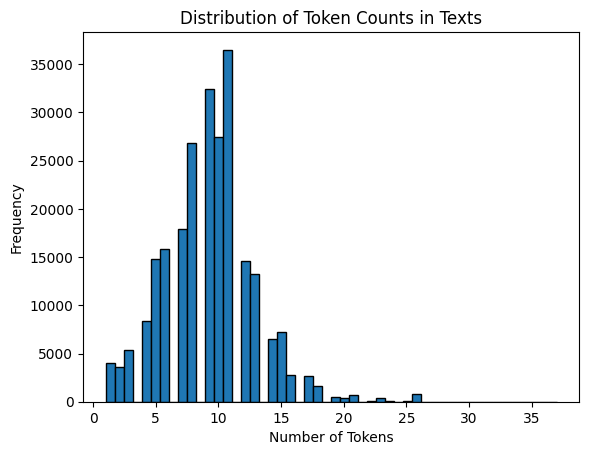

count    244603.000000
mean          9.266967
std           3.615029
min           1.000000
25%           7.000000
50%           9.000000
75%          11.000000
max          37.000000
Name: token_count, dtype: float64


<Figure size 640x480 with 0 Axes>

time: 54.6 s (started: 2024-07-19 22:21:50 +00:00)


In [ ]:
# Initialize the BERT tokenizer
model_name = "nlptown/bert-base-multilingual-uncased-sentiment"
tokenizer = BertTokenizer.from_pretrained(model_name)

# Tokenize the texts and count the number of tokens
df_democratic['token_count'] = df_democratic['text_clean'].apply(lambda x: len(tokenizer.tokenize(x)))

# Display the first few rows to check the token counts
print(df_democratic[['text_clean', 'token_count']].head())

# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_D_BERT_updated.csv'
df_democratic.to_csv(output_file_path, index=False)

# Plot the distribution of token counts
import matplotlib.pyplot as plt

plt.hist(df_democratic['token_count'], bins=50, edgecolor='k')
plt.xlabel('Number of Tokens')
plt.ylabel('Frequency')
plt.title('Distribution of Token Counts in Texts')
plt.show()
plt.savefig('Democratic_token_count_bert_distribution.png')

# Print basic statistics
print(df_democratic['token_count'].describe())


In [ ]:
# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_D_BERT_updated.csv'
df_democratic.to_csv(output_file_path, index=False)

time: 1.55 s (started: 2024-07-23 15:26:19 +00:00)


In [ ]:
# Initialize the BERT tokenizer
model_name = "nlptown/bert-base-multilingual-uncased-sentiment"
tokenizer = BertTokenizer.from_pretrained(model_name)

sentiment_pipeline = pipeline("sentiment-analysis", model=model_name, tokenizer=tokenizer)

pytorch_model.bin:   0%|          | 0.00/669M [00:00<?, ?B/s]

Hardware accelerator e.g. GPU is available in the environment, but no `device` argument is passed to the `Pipeline` object. Model will be on CPU.


time: 6.46 s (started: 2024-07-19 22:23:23 +00:00)


In [ ]:
def bert_sentiment(text):
    inputs = tokenizer(text, max_length=256, truncation=True, return_tensors='pt') # pytorch
    tokens = tokenizer.convert_ids_to_tokens(inputs['input_ids'][0])
    truncated_text = tokenizer.convert_tokens_to_string(tokens)
    result = sentiment_pipeline(truncated_text)[0]

    if result['label'] == '1 star':
        score = -1.0
        label = 'Extremely Negative'
    elif result['label'] == '2 stars':
        score = -0.5
        label = 'Negative'
    elif result['label'] == '3 stars':
        score = 0.0
        label = 'Neutral'
    elif result['label'] == '4 stars':
        score = 0.5
        label = 'Positive'
    else:
        score = 1.0
        label = 'Extremely Positive'

    return score, label

df_democratic[['bert_sentiment_score', 'bert_sentiment_label']] = df_democratic['text_clean'].apply(bert_sentiment).apply(pd.Series)
print(df_democratic[['text_clean', 'bert_sentiment_score', 'bert_sentiment_label']].head(5))

# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_D_BERT_updated.csv'
df_democratic.to_csv(output_file_path, index=False)


                                          text_clean  bert_sentiment_score  \
0  let elect ten woman congress please follow gre...                   1.0   
1  india welcome noble cause nation every country...                   1.0   
2                               poll frontrunner run                   1.0   
3             important new paper evaluation availab                   0.0   
4                       youth experience allow build                   0.5   

  bert_sentiment_label  
0   Extremely Positive  
1   Extremely Positive  
2   Extremely Positive  
3              Neutral  
4             Positive  
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
time: 2h 17min 2s (started: 2024-07-19 22:34:00 +00:00)


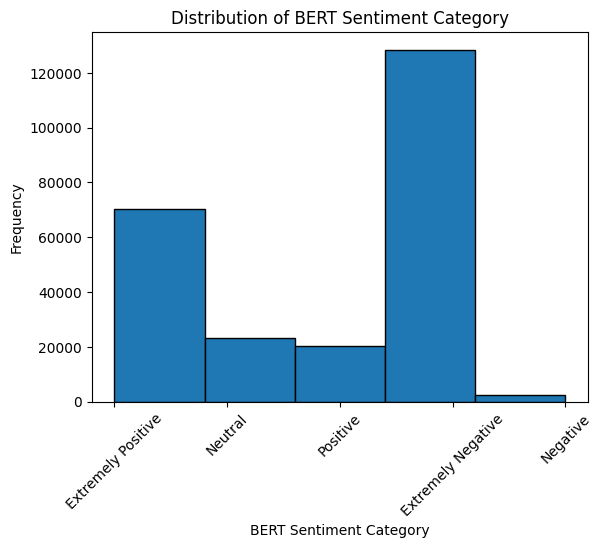

time: 292 ms (started: 2024-07-20 00:51:03 +00:00)


In [ ]:
# Inspect the distribution of sentiment labels
plt.hist(df_democratic['bert_sentiment_label'], bins=5, edgecolor='k')
plt.xlabel('BERT Sentiment Category')
plt.xticks(rotation=45)
plt.ylabel('Frequency')
plt.title('Distribution of BERT Sentiment Category')
plt.savefig('Democratic_bert_sentiment_category_distribution3.png')
plt.show()

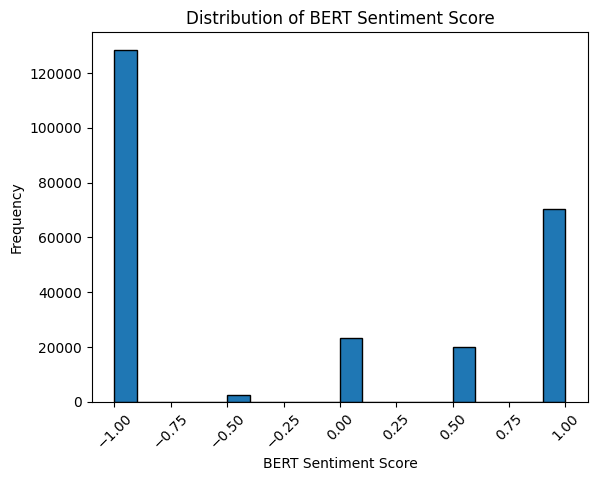

time: 303 ms (started: 2024-07-20 00:51:04 +00:00)


In [ ]:
# The distribution of sentiment scores
plt.hist(df_democratic['bert_sentiment_score'], bins=20, edgecolor='k')
plt.xlabel('BERT Sentiment Score')
plt.ylabel('Frequency')
plt.title('Distribution of BERT Sentiment Score')
plt.xticks(rotation=45)
plt.savefig('republican_bert_sentiment_score_distribution2.png')
plt.show()

In [ ]:
# Print the updated dataset
#print(df_democratic[['text_clean', 'bert_sentiment_score', 'bert_sentiment_category']].head(5))

# Save Democratic file
#save_path = '/content/drive/MyDrive/US_D_BERT_updated.csv'
#df_democratic.to_csv(save_path, index=False)

                                          text_clean  bert_sentiment_score  \
0  let elect ten woman congress please follow gre...              0.999454   
1  india welcome noble cause nation every country...              0.999513   
2                               poll frontrunner run              0.634101   
3             important new paper evaluation availab             -0.984247   
4                       youth experience allow build              0.998071   
5                       youth experience allow build              0.998071   
6     late polling via one five people sorry nominee             -0.998326   
7     need help letter request address one back mult             -0.999461   
8    dead campaign wave cadaverous hand hopeful know             -0.991934   
9               happy time help think shitload shove              0.996568   

   bert_sentiment_category  
0                        5  
1                        5  
2                        4  
3                        

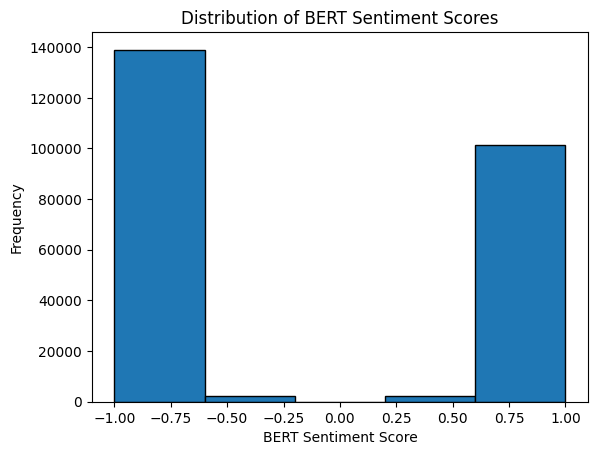

In [ ]:
# Apply BERT Sentiment Analysis
#plt.hist(df_democratic['bert_sentiment_score'], bins=5, edgecolor='k')
#plt.xlabel('BERT Sentiment Score')
#plt.ylabel('Frequency')
#plt.title('Distribution of BERT Sentiment Scores')
#plt.show()

# Prepare for data

In [ ]:
# Read Brexit dataset
df_democratic = pd.read_csv('/content/drive/MyDrive/US_D_BERT_updated.csv')
pd.set_option('display.max_columns',None)
df_democratic.head(5)

,Unnamed: 0,text_clean,Vader_Sentiment,bert_sentiment_score,token_count,bert_sentiment_label,label
0,0,let elect ten woman congress please follow gre...,Positive,1.0,10,Extremely Positive,4
1,1,india welcome noble cause nation every country...,Positive,1.0,11,Extremely Positive,4
2,2,poll frontrunner run,Neutral,1.0,4,Extremely Positive,4
3,3,important new paper evaluation availab,Positive,0.0,7,Neutral,2
4,4,youth experience allow build,Positive,0.5,4,Positive,3


time: 821 ms (started: 2024-07-23 15:35:39 +00:00)


In [ ]:
df_democratic.shape

(244603, 6)

time: 2.5 ms (started: 2024-07-20 07:56:48 +00:00)


In [ ]:
df_democratic.value_counts(['bert_sentiment_label'])

bert_sentiment_label
Extremely Negative      128451
Extremely Positive       70463
Neutral                  23207
Positive                 20132
Negative                  2350
Name: count, dtype: int64

time: 35.7 ms (started: 2024-07-20 07:56:51 +00:00)


In [ ]:
# Encode the labels (convert sentiment scores to categories)
label_dict = {-1.0: 0, -0.5: 1, 0: 2, 0.5: 3, 1.0: 4}
df_democratic['label'] = df_democratic['bert_sentiment_score'].map(label_dict)

# Save Democratic file
save_path = '/content/drive/MyDrive/US_D_BERT_updated.csv'
df_democratic.to_csv(save_path, index=False)

# Split data into training and validation sets
train_texts, val_texts, train_labels, val_labels = train_test_split(
    df_democratic['text_clean'], df_democratic['label'], test_size=0.1, random_state=42)

time: 894 ms (started: 2024-07-20 07:57:11 +00:00)


In [ ]:
df_democratic.value_counts(['label'])

label
0        128451
4         70463
2         23207
3         20132
1          2350
Name: count, dtype: int64

time: 11.1 ms (started: 2024-07-20 07:57:16 +00:00)


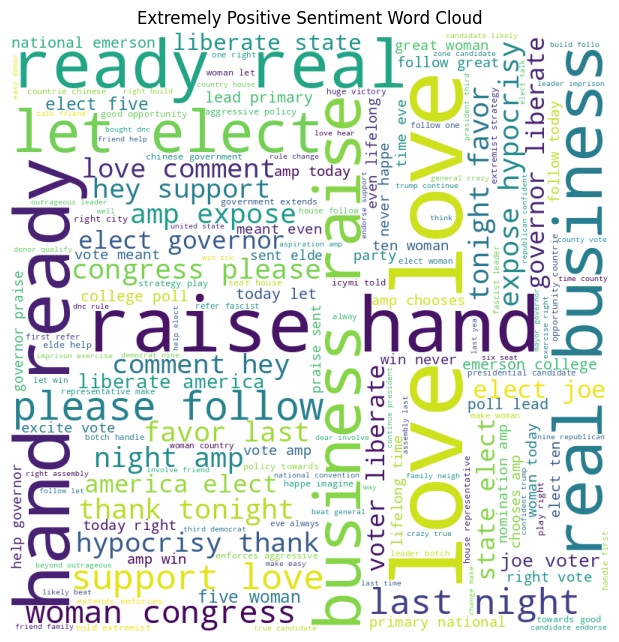

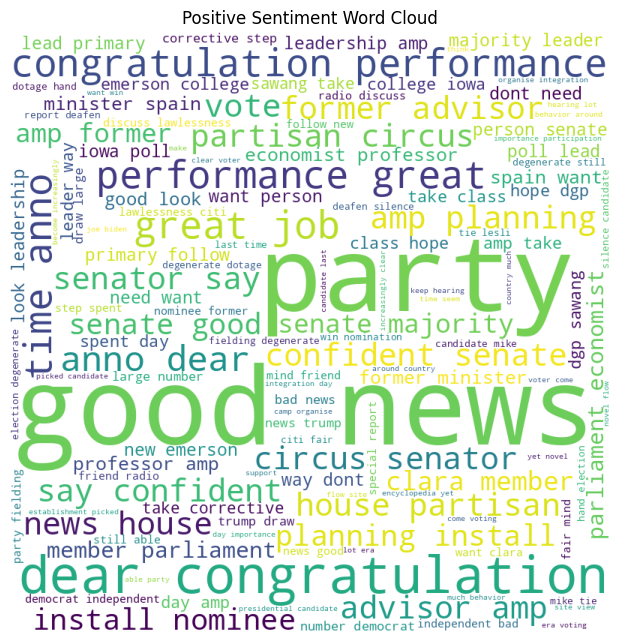

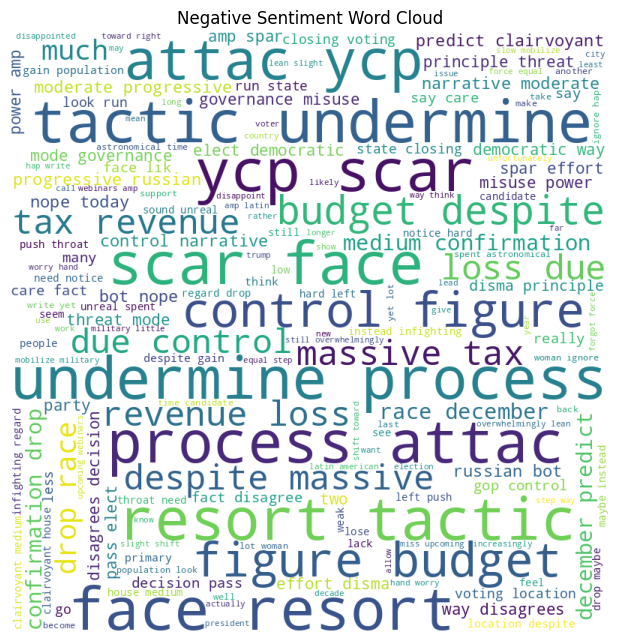

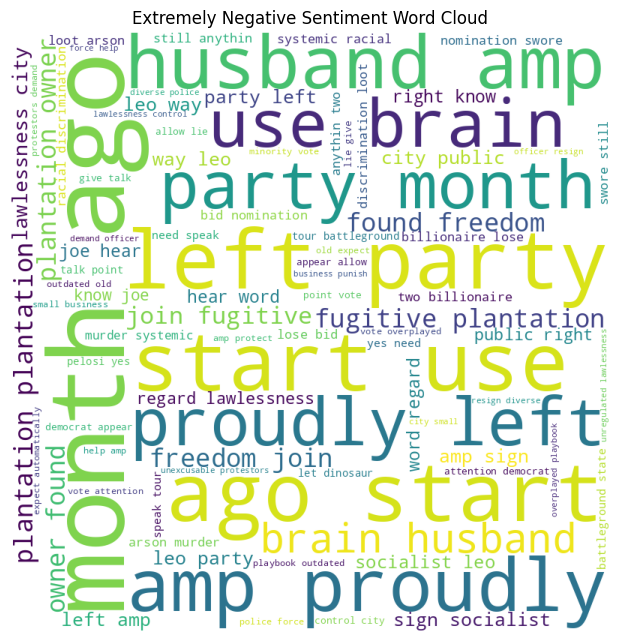

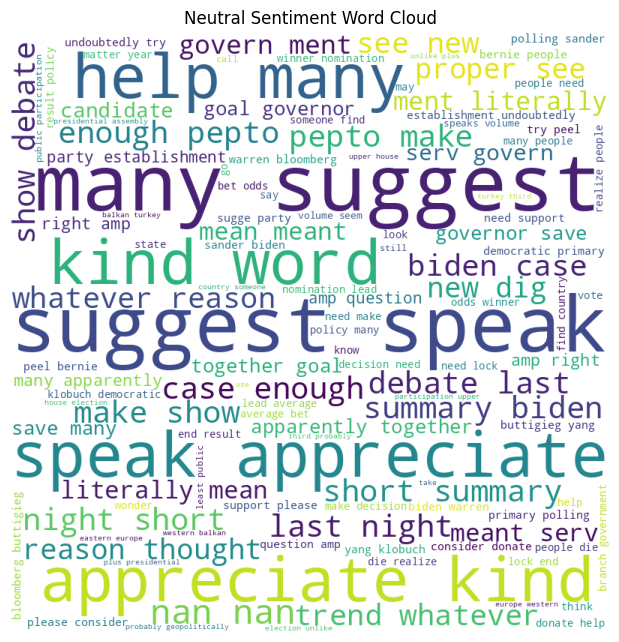

time: 12.4 s (started: 2024-07-23 16:44:05 +00:00)


In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

# Filter the DataFrame for each sentiment label
extremely_positive_df = df_democratic[df_democratic['bert_sentiment_label'] == 'Extremely Positive']
positive_df = df_democratic[df_democratic['bert_sentiment_label'] == 'Positive']
negative_df = df_democratic[df_democratic['bert_sentiment_label'] == 'Negative']
extremely_negative_df = df_democratic[df_democratic['bert_sentiment_label'] == 'Extremely Negative']
neutral_df = df_democratic[df_democratic['bert_sentiment_label'] == 'Neutral']

# Combine text for each sentiment
extremely_positive_text = " ".join(extremely_positive_df['text_clean'])
positive_text = " ".join(positive_df['text_clean'])
negative_text = " ".join(negative_df['text_clean'])
extremely_negative_text = " ".join(extremely_negative_df['text_clean'])
neutral_text = " ".join(str(text) for text in neutral_df['text_clean'])

# Create WordCloud objects
stopwords = set(STOPWORDS)
wordcloud_ep = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_positive_text)
wordcloud_p = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(positive_text)
wordcloud_n = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(negative_text)
wordcloud_en = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_negative_text)

wordcloud_ne = WordCloud(width = 800, height = 800,
                background_color = 'white',
                stopwords = stopwords,
                min_font_size = 10).generate(neutral_text)

# Plot the WordClouds
plt.figure(figsize = (6, 8), facecolor = None)
plt.imshow(wordcloud_ep)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 8), facecolor = None)
plt.imshow(wordcloud_p)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 8), facecolor = None)
plt.imshow(wordcloud_n)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 8), facecolor = None)
plt.imshow(wordcloud_en)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 8), facecolor = None)
plt.imshow(wordcloud_ne)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Neutral Sentiment Word Cloud")
plt.show()


# 1.1 BERT Model via Pre-Trained BERT

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:591: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g.

Epoch 1/3 - Training loss: 0.2291036724866958
Training Accuracy: 0.9182845617828492
Training F1 Score: 0.917057835701325
Training Recall: 0.9182845617828492
Training Precision: 0.9167003713550947


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 1/3 - Validation loss: 0.13699673483372216
Validation Accuracy: 0.9511058419524958
Validation F1 Score: 0.9506910726688055
Validation Recall: 0.9511058419524958
Validation Precision: 0.9508967022320258


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 2/3 - Training loss: 0.09209501916284021
Training Accuracy: 0.9674164857228517
Training F1 Score: 0.9672873740708956
Training Recall: 0.9674164857228517
Training Precision: 0.9672038484252202


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 2/3 - Validation loss: 0.12394039160344149
Validation Accuracy: 0.9572380524099587
Validation F1 Score: 0.9572742723188321
Validation Recall: 0.9572380524099587
Validation Precision: 0.9574282856851714


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 3/3 - Training loss: 0.03652512019131216
Training Accuracy: 0.9876443386541414
Training F1 Score: 0.9876294655356271
Training Recall: 0.9876443386541414
Training Precision: 0.9876199807958533


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 3/3 - Validation loss: 0.1479917523352208
Validation Accuracy: 0.9603041576386901
Validation F1 Score: 0.960266113273822
Validation Recall: 0.9603041576386901
Validation Precision: 0.9603316781723973


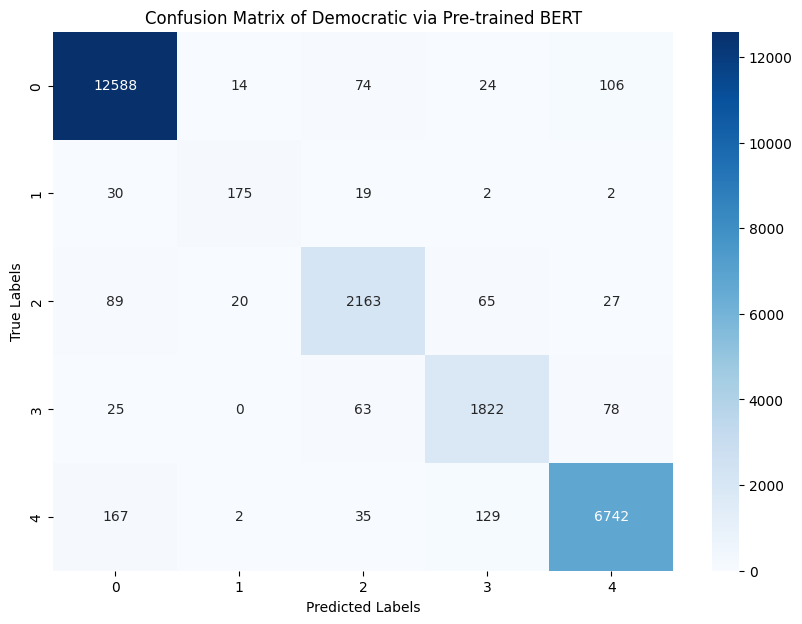

time: 1h 55min 20s (started: 2024-07-20 07:57:47 +00:00)


In [ ]:
from torch.utils.data import Dataset, DataLoader
from transformers import BertTokenizer, BertForSequenceClassification, AdamW, get_linear_schedule_with_warmup
from torch.nn import CrossEntropyLoss
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
import torch
import json
import matplotlib.pyplot as plt
import seaborn as sns

# Define custom dataset class
class SentimentDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = str(self.texts[idx])
        label = self.labels[idx]
        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            pad_to_max_length=True,
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )
        return {
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Initialize BERT tokenizer and datasets
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
train_dataset = SentimentDataset(train_texts.values, train_labels.values, tokenizer, max_len=256)
val_dataset = SentimentDataset(val_texts.values, val_labels.values, tokenizer, max_len=256)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# Load a pre-trained BERT model for sequence classification
model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=5)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Define optimizer and loss function
optimizer = AdamW(model.parameters(), lr=2e-5)
loss_fn = CrossEntropyLoss().to(device)

# Set up learning rate scheduler
total_steps = len(train_loader) * 3  # Assuming 3 epochs
scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=0, num_training_steps=total_steps)

# Training loop
epochs = 3
metrics = []

for epoch in range(epochs):
    model.train()
    total_loss = 0
    all_train_labels = []
    all_train_preds = []

    for batch in train_loader:
        optimizer.zero_grad()

        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['label'].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        total_loss += loss.item()

        loss.backward()
        optimizer.step()
        scheduler.step()

        logits = outputs.logits
        preds = torch.argmax(logits, dim=1).flatten()
        all_train_labels.extend(labels.cpu().numpy())
        all_train_preds.extend(preds.cpu().numpy())

    avg_train_loss = total_loss / len(train_loader)
    train_accuracy = accuracy_score(all_train_labels, all_train_preds)
    train_f1 = f1_score(all_train_labels, all_train_preds, average='weighted')
    train_recall = recall_score(all_train_labels, all_train_preds, average='weighted')
    train_precision = precision_score(all_train_labels, all_train_preds, average='weighted')
    print(f"Epoch {epoch+1}/{epochs} - Training loss: {avg_train_loss}")
    print(f"Training Accuracy: {train_accuracy}")
    print(f"Training F1 Score: {train_f1}")
    print(f"Training Recall: {train_recall}")
    print(f"Training Precision: {train_precision}")

    # Validation
    model.eval()
    val_loss = 0
    all_val_labels = []
    all_val_preds = []

    with torch.no_grad():
        for batch in val_loader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['label'].to(device)

            outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
            loss = outputs.loss
            val_loss += loss.item()

            logits = outputs.logits
            preds = torch.argmax(logits, dim=1).flatten()

            all_val_labels.extend(labels.cpu().numpy())
            all_val_preds.extend(preds.cpu().numpy())

    avg_val_loss = val_loss / len(val_loader)
    val_accuracy = accuracy_score(all_val_labels, all_val_preds)
    val_f1 = f1_score(all_val_labels, all_val_preds, average='weighted')
    val_recall = recall_score(all_val_labels, all_val_preds, average='weighted')
    val_precision = precision_score(all_val_labels, all_val_preds, average='weighted')

    print(f"Epoch {epoch+1}/{epochs} - Validation loss: {avg_val_loss}")
    print(f"Validation Accuracy: {val_accuracy}")
    print(f"Validation F1 Score: {val_f1}")
    print(f"Validation Recall: {val_recall}")
    print(f"Validation Precision: {val_precision}")

    # Save the model and tokenizer after each epoch
    model_save_path = f'/content/drive/MyDrive/results/Democratic_bert_sentiment_model_epoch_{epoch+1}'
    tokenizer.save_pretrained(model_save_path)
    model.save_pretrained(model_save_path)

    # Save the metrics for each epoch
    metrics.append({
        'epoch': epoch+1,
        'train_loss': avg_train_loss,
        'train_accuracy': train_accuracy,
        'train_f1': train_f1,
        'train_recall': train_recall,
        'train_precision': train_precision,
        'val_loss': avg_val_loss,
        'val_accuracy': val_accuracy,
        'val_f1': val_f1,
        'val_recall': val_recall,
        'val_precision': val_precision
    })

    # Clear memory except for the last epoch's labels and predictions
    if epoch < epochs - 1:
        del val_loss, avg_train_loss, avg_val_loss, train_accuracy, train_f1, train_recall, train_precision
        del val_accuracy, val_f1, val_recall, val_precision
        torch.cuda.empty_cache()

# Save the metrics for all epochs
with open('/content/drive/MyDrive/results/Democratic_bert_sentiment_metrics.json', 'w') as f:
    json.dump(metrics, f)

# Calculate confusion matrix for the last epoch
cm = confusion_matrix(all_val_labels, all_val_preds)

# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix of Democratic via Pre-trained BERT')

# Save the figure
plt.savefig('Democratic_bert_confusion_matrix.png')
plt.show()

In [ ]:
print("BERT Confusion Matrix:")
print(cm)

Confusion Matrix:
[[12588    14    74    24   106]
 [   30   175    19     2     2]
 [   89    20  2163    65    27]
 [   25     0    63  1822    78]
 [  167     2    35   129  6742]]
time: 934 µs (started: 2024-07-20 10:03:11 +00:00)


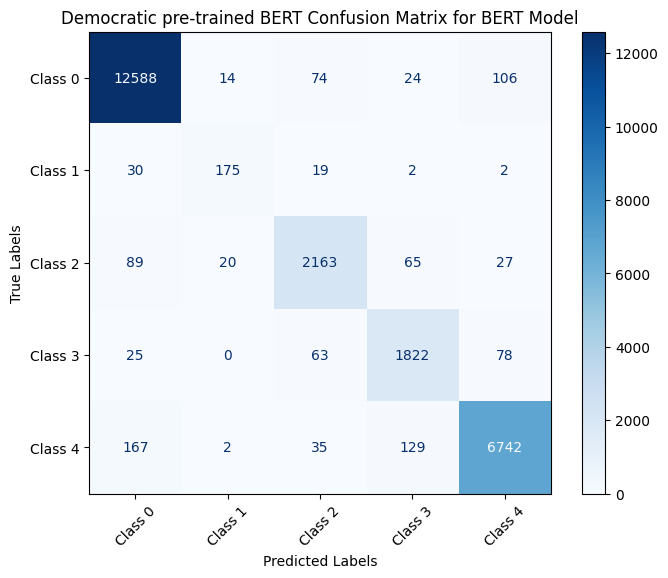

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 12588,14,74,24,106],
 [ 30,175,19,2,2],
 [ 89,20,2163,65,27],
 [ 25,0,63,1822,78],
 [ 167,2,35,129,6742]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('Democratic pre-trained BERT Confusion Matrix for BERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# 1.2 DistilBERT via Pre-trained BERT

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/483 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:591: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this 

Epoch 1/3 - Training loss: 0.22626666404704288
Training Accuracy: 0.9194747026918989
Training F1 Score: 0.9182341572587867
Training Recall: 0.9194747026918989
Training Precision: 0.917884057027815


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 1/3 - Validation loss: 0.13726523794258771
Validation Accuracy: 0.9501655696823516
Validation F1 Score: 0.9496525427374634
Validation Recall: 0.9501655696823516
Validation Precision: 0.9496111212555319


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 2/3 - Training loss: 0.09495174831648495
Training Accuracy: 0.9662853976069992
Training F1 Score: 0.9661327703822812
Training Recall: 0.9662853976069992
Training Precision: 0.966046290283205


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 2/3 - Validation loss: 0.1238522549895358
Validation Accuracy: 0.9587915457258493
Validation F1 Score: 0.9587396084567705
Validation Recall: 0.9587915457258493
Validation Precision: 0.9590094173158809


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 3/3 - Training loss: 0.04167297673813403
Training Accuracy: 0.9857001390011901
Training F1 Score: 0.9856727417196502
Training Recall: 0.9857001390011901
Training Precision: 0.9856575697731481


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 3/3 - Validation loss: 0.13896845190759957
Validation Accuracy: 0.9602223948325906
Validation F1 Score: 0.9602181596196714
Validation Recall: 0.9602223948325906
Validation Precision: 0.9602473246415331


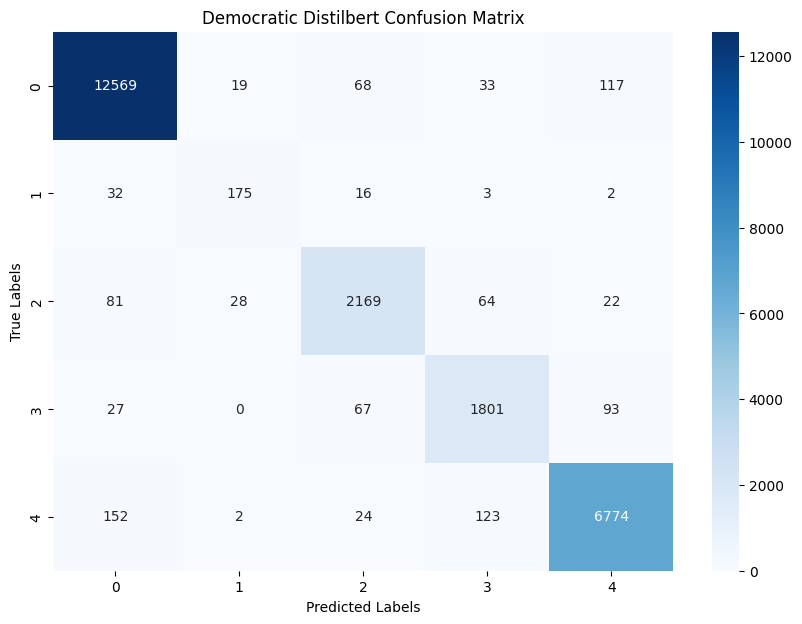

time: 1h 6min 34s (started: 2024-07-20 10:05:11 +00:00)


In [ ]:
from torch.utils.data import Dataset, DataLoader
from transformers import DistilBertTokenizer, DistilBertForSequenceClassification, AdamW, get_linear_schedule_with_warmup
from torch.nn import CrossEntropyLoss
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
import torch
import json
import matplotlib.pyplot as plt
import seaborn as sns

# Define custom dataset class
class SentimentDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = str(self.texts[idx])
        label = self.labels[idx]
        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            pad_to_max_length=True,
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )
        return {
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Initialize DistilBERT tokenizer and datasets
tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
train_dataset = SentimentDataset(train_texts.values, train_labels.values, tokenizer, max_len=256)
val_dataset = SentimentDataset(val_texts.values, val_labels.values, tokenizer, max_len=256)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# Load a pre-trained DistilBERT model for sequence classification
model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=5)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Define optimizer and loss function
optimizer = AdamW(model.parameters(), lr=2e-5)
loss_fn = CrossEntropyLoss().to(device)

# Set up learning rate scheduler
total_steps = len(train_loader) * 3  # Assuming 3 epochs
scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=0, num_training_steps=total_steps)

# Training loop
epochs = 3
metrics = []

for epoch in range(epochs):
    model.train()
    total_loss = 0
    all_train_labels = []
    all_train_preds = []

    for batch in train_loader:
        optimizer.zero_grad()

        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['label'].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        total_loss += loss.item()

        loss.backward()
        optimizer.step()
        scheduler.step()

        logits = outputs.logits
        preds = torch.argmax(logits, dim=1).flatten()
        all_train_labels.extend(labels.cpu().numpy())
        all_train_preds.extend(preds.cpu().numpy())

    avg_train_loss = total_loss / len(train_loader)
    train_accuracy = accuracy_score(all_train_labels, all_train_preds)
    train_f1 = f1_score(all_train_labels, all_train_preds, average='weighted')
    train_recall = recall_score(all_train_labels, all_train_preds, average='weighted')
    train_precision = precision_score(all_train_labels, all_train_preds, average='weighted')
    print(f"Epoch {epoch+1}/{epochs} - Training loss: {avg_train_loss}")
    print(f"Training Accuracy: {train_accuracy}")
    print(f"Training F1 Score: {train_f1}")
    print(f"Training Recall: {train_recall}")
    print(f"Training Precision: {train_precision}")

    # Validation
    model.eval()
    val_loss = 0
    all_val_labels = []
    all_val_preds = []

    with torch.no_grad():
        for batch in val_loader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['label'].to(device)

            outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
            loss = outputs.loss
            val_loss += loss.item()

            logits = outputs.logits
            preds = torch.argmax(logits, dim=1).flatten()

            all_val_labels.extend(labels.cpu().numpy())
            all_val_preds.extend(preds.cpu().numpy())

    avg_val_loss = val_loss / len(val_loader)
    val_accuracy = accuracy_score(all_val_labels, all_val_preds)
    val_f1 = f1_score(all_val_labels, all_val_preds, average='weighted')
    val_recall = recall_score(all_val_labels, all_val_preds, average='weighted')
    val_precision = precision_score(all_val_labels, all_val_preds, average='weighted')

    print(f"Epoch {epoch+1}/{epochs} - Validation loss: {avg_val_loss}")
    print(f"Validation Accuracy: {val_accuracy}")
    print(f"Validation F1 Score: {val_f1}")
    print(f"Validation Recall: {val_recall}")
    print(f"Validation Precision: {val_precision}")

    # Save the model and tokenizer after each epoch
    model_save_path = f'/content/drive/MyDrive/results/Democratic_distilbert_sentiment_model_epoch_{epoch+1}'
    tokenizer.save_pretrained(model_save_path)
    model.save_pretrained(model_save_path)

    # Save the metrics for each epoch
    metrics.append({
        'epoch': epoch+1,
        'train_loss': avg_train_loss,
        'train_accuracy': train_accuracy,
        'train_f1': train_f1,
        'train_recall': train_recall,
        'train_precision': train_precision,
        'val_loss': avg_val_loss,
        'val_accuracy': val_accuracy,
        'val_f1': val_f1,
        'val_recall': val_recall,
        'val_precision': val_precision
    })

    # Clear memory except for the last epoch's labels and predictions
    if epoch < epochs - 1:
        del val_loss, avg_train_loss, avg_val_loss, train_accuracy, train_f1, train_recall, train_precision
        del val_accuracy, val_f1, val_recall, val_precision
        torch.cuda.empty_cache()

# Save the metrics for all epochs
with open('/content/drive/MyDrive/results/Democratic_distilbert_sentiment_metrics.json', 'w') as f:
    json.dump(metrics, f)

# Calculate confusion matrix for the last epoch
cm = confusion_matrix(all_val_labels, all_val_preds)

# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Democratic Distilbert Confusion Matrix')

# Save the figure
plt.savefig('Democratic_distilbert_confusion_matrix.png')
plt.show()


In [ ]:
print('Democratic Distilbert Confusion Matrix:')
print(cm)

Democratic Distilbert Confusion Matrix:
[[12569    19    68    33   117]
 [   32   175    16     3     2]
 [   81    28  2169    64    22]
 [   27     0    67  1801    93]
 [  152     2    24   123  6774]]
time: 734 µs (started: 2024-07-20 11:11:46 +00:00)


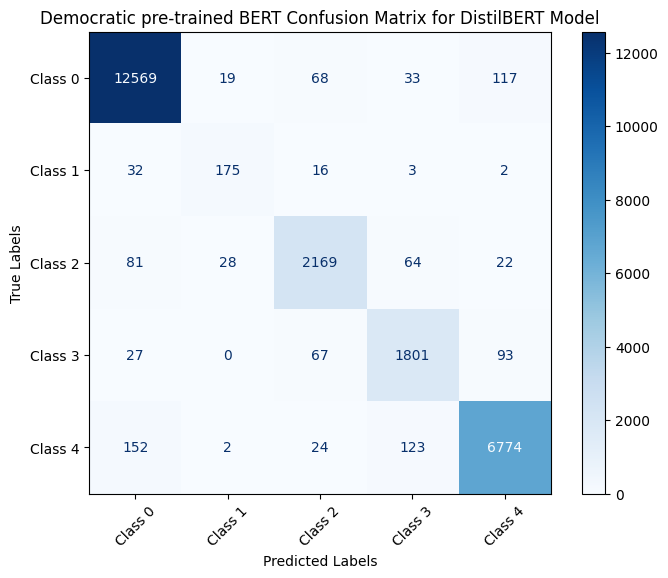

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 12569,19,68,33,117],
 [ 32,175,16,3,2],
 [ 81,28,2169,64,22],
 [ 27,0,67,1801,93],
 [ 152,2,24,123,6774]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('Democratic pre-trained BERT Confusion Matrix for DistilBERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# 1.1 (OLD)BERT SA via BERT Model

In [ ]:
# Define function to categorize sentiment scores

#def categorize_sentiment(score):
#    if score >= 0.7:
#        return 5  # Extremely Positive
#    elif score > 0.2:
#        return 4  # Positive
#    elif -0.7 <= score <= 0.2:
#        return 3  # Neutral
#    elif score >= -0.7:
#        return 2  # Negative
#    else:
#        return 1  # Extremely Negative

time: 467 µs (started: 2024-07-19 22:25:54 +00:00)


In [ ]:
import torch
from transformers import BertTokenizer, BertForSequenceClassification, DistilBertTokenizer, DistilBertForSequenceClassification, Trainer, TrainingArguments
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score
from torch.utils.data import DataLoader, Dataset

# Define a custom Dataset class
class TextDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]

        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            padding='max_length',
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )

        return {
            'text': text,
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }



In [ ]:
# Prepare the data for BERT and DistilBERT
def prepare_data(df, tokenizer, max_len, batch_size):
    le = LabelEncoder()
    df['label'] = le.fit_transform(df['bert_sentiment_category'])

    train_texts, val_texts, train_labels, val_labels = train_test_split(
        df['text_clean'].values,
        df['label'].values,
        test_size=0.1,
        random_state=42
    )

    train_dataset = TextDataset(
        texts=train_texts,
        labels=train_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    val_dataset = TextDataset(
        texts=val_texts,
        labels=val_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size)

    return train_loader, val_loader, le, val_labels

# Define evaluation metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    acc = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    recall = recall_score(labels, preds, average='weighted')
    precision = precision_score(labels, preds, average='weighted')
    return {
        'accuracy': acc,
        'f1': f1,
        'recall': recall,
        'precision': precision
    }


In [ ]:
# Set parameters
MAX_LEN = 128
BATCH_SIZE = 16

# Prepare data for BERT
bert_tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
train_loader, val_loader, label_encoder, _ = prepare_data(df_democratic, bert_tokenizer, MAX_LEN, BATCH_SIZE) # Assign the fourth return value to _ to ignore it.

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

In [ ]:
# Initialize BERT model
bert_model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=5)

# Train BERT model
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    evaluation_strategy="epoch"
)

trainer = Trainer(
    model=bert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

# Print BERT evaluation results
for key, value in results.items():
    print(f"{key}: {value}")


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.241500,0.180096,0.953518,0.951728,0.953518,0.953942
2,0.125600,0.178254,0.963084,0.961519,0.963084,0.963414
3,0.045400,0.155688,0.965006,0.964046,0.965006,0.964272


eval_loss: 0.15568825602531433
eval_accuracy: 0.9650055189894117
eval_f1: 0.9640456117428752
eval_recall: 0.9650055189894117
eval_precision: 0.9642723528739858
eval_runtime: 50.9925
eval_samples_per_second: 479.698
eval_steps_per_second: 29.985
epoch: 3.0


In [ ]:
from sklearn.metrics import confusion_matrix

# Print Validation Accuracy
print(f"Validation Accuracy: {results['eval_accuracy']}")

# Confusion Matrix for BERT
bert_preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
bert_cm = confusion_matrix(val_labels, bert_preds)
print("Confusion Matrix for BERT:")
print(bert_cm)

Validation Accuracy: 0.9650055189894117


Confusion Matrix for BERT:
[[  277     1     0    39     0]
 [  398    11     8   922     0]
 [ 1565     1    31    88     0]
 [10255   308   268  6115     0]
 [ 1226    71   159  2718     0]]


# 1.2 (OLD) BERT SA via DistilBERT Model

In [ ]:
# Prepare data for DistilBERT
distilbert_tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
train_loader, val_loader, label_encoder, val_labels = prepare_data(df_democratic, distilbert_tokenizer, MAX_LEN, BATCH_SIZE) # Store val_labels

# Initialize DistilBERT model
distilbert_model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=5)

training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    evaluation_strategy="epoch"
)

# Train DistilBERT model
trainer = Trainer(
    model=distilbert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
DistilBERT_results = trainer.evaluate()

# Print DistilBERT evaluation results
for key, value in DistilBERT_results.items():
    print(f"{key}: {value}")


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.199000,0.145218,0.960100,0.958736,0.960100,0.959259
2,0.159300,0.148701,0.967499,0.966327,0.967499,0.967134
3,0.034700,0.153226,0.966845,0.966888,0.966845,0.967049


eval_loss: 0.15322622656822205
eval_accuracy: 0.9668451821266506
eval_f1: 0.9668881819466474
eval_recall: 0.9668451821266506
eval_precision: 0.9670494861973945
eval_runtime: 31.5994
eval_samples_per_second: 774.096
eval_steps_per_second: 48.387
epoch: 3.0


In [ ]:
# Confusion Matrix for DistilBERT
from sklearn.metrics import confusion_matrix

DistilBERT_preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
Distilbert_cm = confusion_matrix(val_labels, DistilBERT_preds)
print("Confusion Matrix for DistilBERT:")
print(Distilbert_cm)

Confusion Matrix for DistilBERT:
[[13400    92    38   155]
 [   77   375    14    51]
 [   51    24   453    56]
 [  161    64    28  9422]]


# 1.3 VADER Sentiment Analyzer

In [ ]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

# Remove previous BERT sentiment score and category columns
df_democratic = df_democratic.drop(columns=['bert_sentiment_score', 'bert_sentiment_category'], errors='ignore')

# Initialize VADER
analyzer = SentimentIntensityAnalyzer()


# Function to calculate sentiment score using VADER
def vader_sentiment(text):
    scores = analyzer.polarity_scores(text)
    return scores['compound']


In [ ]:
# Apply VADER sentiment function
df_democratic['vader_sentiment_score'] = df_democratic['text_clean'].apply(vader_sentiment)

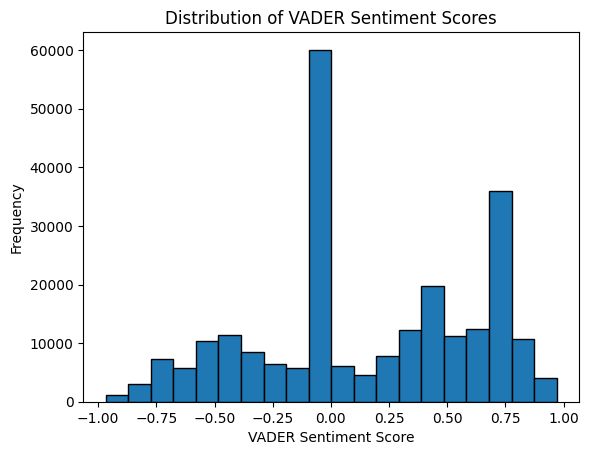

In [ ]:
# Inspect the distribution of VADER sentiment scores

plt.hist(df_democratic['vader_sentiment_score'], bins=20, edgecolor='k')
plt.xlabel('VADER Sentiment Score')
plt.ylabel('Frequency')
plt.title('Distribution of VADER Sentiment Scores')
plt.show()

In [ ]:
# Read Brexit dataset
df_democratic = pd.read_csv('/content/drive/MyDrive/US_D_VADER_updated.csv')
pd.set_option('display.max_columns',None)
df_democratic.head(5)

,Unnamed: 0,text_clean,Vader_Sentiment,label,vader_sentiment_score,vader_sentiment_category,token_count
0,0,let elect ten woman congress please follow gre...,Positive,1,0.7506,Extremely Positive,10
1,1,india welcome noble cause nation every country...,Positive,1,0.8225,Extremely Positive,11
2,2,poll frontrunner run,Neutral,3,0.0000,Neutral,4
3,3,important new paper evaluation availab,Positive,4,0.2023,Positive,7
4,4,youth experience allow build,Positive,4,0.2263,Positive,4


time: 301 ms (started: 2024-07-23 18:12:25 +00:00)


In [ ]:
# prompt: tokenise text_clean by using VADER and token counts

from nltk.tokenize import word_tokenize

# Ensure 'text_clean' column contains strings
df_democratic['text_clean'] = df_democratic['text_clean'].astype(str)

# Tokenize the text
df_democratic['tokens'] = df_democratic['text_clean'].apply(word_tokenize)

# Calculate token counts
df_democratic['vader_token_counts'] = df_democratic['tokens'].apply(len)

# Display the DataFrame with token counts
df_democratic.head()

# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_D_VADER_updated.csv'
df_democratic.to_csv(output_file_path, index=False)


time: 22 s (started: 2024-07-23 18:16:08 +00:00)


In [ ]:
df_democratic.head()

,Unnamed: 0,text_clean,Vader_Sentiment,label,vader_sentiment_score,vader_sentiment_category,token_count,tokens,token_counts,vader_token_counts
0,0,let elect ten woman congress please follow gre...,Positive,1,0.7506,Extremely Positive,10,"[let, elect, ten, woman, congress, please, fol...",10,10
1,1,india welcome noble cause nation every country...,Positive,1,0.8225,Extremely Positive,11,"[india, welcome, noble, cause, nation, every, ...",10,10
2,2,poll frontrunner run,Neutral,3,0.0000,Neutral,4,"[poll, frontrunner, run]",3,3
3,3,important new paper evaluation availab,Positive,4,0.2023,Positive,7,"[important, new, paper, evaluation, availab]",5,5
4,4,youth experience allow build,Positive,4,0.2263,Positive,4,"[youth, experience, allow, build]",4,4


time: 11.1 ms (started: 2024-07-23 18:16:47 +00:00)


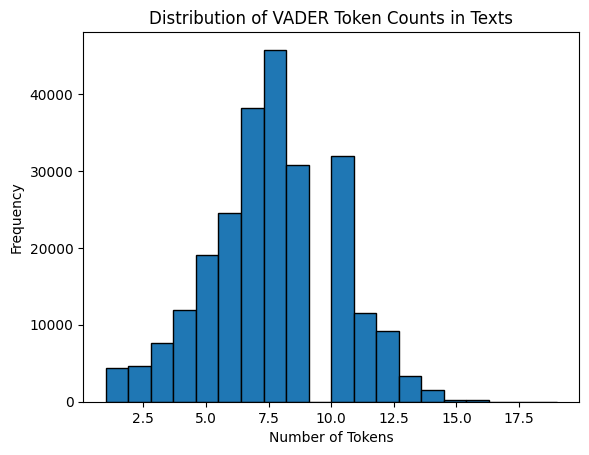

count    244603.000000
mean          7.614878
std           2.560252
min           1.000000
25%           6.000000
50%           8.000000
75%           9.000000
max          19.000000
Name: vader_token_counts, dtype: float64


<Figure size 640x480 with 0 Axes>

time: 215 ms (started: 2024-07-23 18:17:09 +00:00)


In [ ]:
import matplotlib.pyplot as plt

plt.hist(df_democratic['vader_token_counts'], bins=20, edgecolor='k')
plt.xlabel('Number of Tokens')
plt.ylabel('Frequency')
plt.title('Distribution of VADER Token Counts in Texts')
plt.show()
plt.savefig('Democratic_token_count_VADER_distribution.png')

# Print basic statistics
print(df_democratic['vader_token_counts'].describe())


                                          text_clean  token_count
0  let elect ten woman congress please follow gre...           10
1  india welcome noble cause nation every country...           11
2                               poll frontrunner run            4
3             important new paper evaluation availab            7
4                       youth experience allow build            4


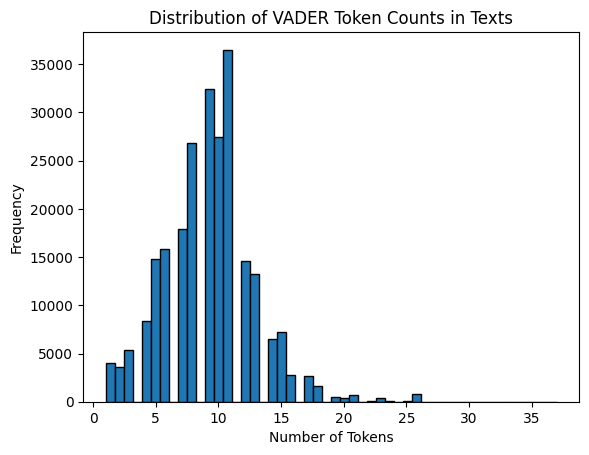

count    244603.000000
mean          9.266967
std           3.615029
min           1.000000
25%           7.000000
50%           9.000000
75%          11.000000
max          37.000000
Name: token_count, dtype: float64


<Figure size 640x480 with 0 Axes>

time: 53.5 s (started: 2024-07-23 17:06:18 +00:00)


In [ ]:
# Initialize the BERT tokenizer
model_name = "nlptown/bert-base-multilingual-uncased-sentiment"
tokenizer = BertTokenizer.from_pretrained(model_name)

# Ensure 'text_clean' column contains strings
df_democratic['text_clean'] = df_democratic['text_clean'].astype(str)

# Tokenize the texts and count the number of tokens
df_democratic['token_count'] = df_democratic['text_clean'].apply(lambda x: len(tokenizer.tokenize(x)))

# Display the first few rows to check the token counts
print(df_democratic[['text_clean', 'token_count']].head())

# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_D_VADER_updated.csv'
df_democratic.to_csv(output_file_path, index=False)

# Plot the distribution of token counts
import matplotlib.pyplot as plt

plt.hist(df_democratic['token_count'], bins=50, edgecolor='k')
plt.xlabel('Number of Tokens')
plt.ylabel('Frequency')
plt.title('Distribution of VADER Token Counts in Texts')
plt.show()
plt.savefig('Democratic_token_count_VADER_distribution.png')

# Print basic statistics
print(df_democratic['token_count'].describe())


In [ ]:
# Apply VADER sentiment function
df_democratic['vader_sentiment_score'] = df_democratic['text_clean'].apply(vader_sentiment)

# Refine categorization based on VADER scores
def categorize_sentiment(score):
    if score >= 0.7:
        return 'Extremely Positive'  # 5
    elif score > 0.2:
        return 'Positive'  # 4
    elif -0.2 <= score <= 0.2:
        return 'Neutral'  # 3
    elif score >= -0.7:
        return 'Negative'  # 2
    else:
        return 'Extremely Negative'  # 1

In [ ]:
# Apply refined categorization to VADER scores
df_democratic['vader_sentiment_category'] = df_democratic['vader_sentiment_score'].apply(categorize_sentiment)

# Map categories to numerical labels for model training
label_dict = {'Extremely Negative': 0, 'Negative': 1, 'Neutral': 2, 'Positive': 3, 'Extremely Positive': 4}
df_democratic['label'] = df_democratic['vader_sentiment_category'].map(label_dict)

print(df_democratic[['text_clean', 'vader_sentiment_score', 'vader_sentiment_category', 'label']].head())

                                          text_clean  vader_sentiment_score  \
0  let elect ten woman congress please follow gre...                 0.7506   
1  india welcome noble cause nation every country...                 0.8225   
2                               poll frontrunner run                 0.0000   
3             important new paper evaluation availab                 0.2023   
4                       youth experience allow build                 0.2263   

  vader_sentiment_category  label  
0       Extremely Positive      4  
1       Extremely Positive      4  
2                  Neutral      2  
3                 Positive      3  
4                 Positive      3  


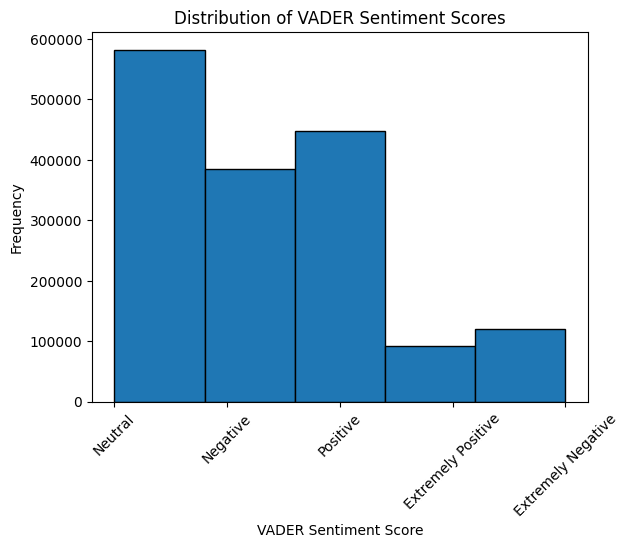

In [ ]:
# After applying self-define VADER sentimentic categories the distribution of VADER sentiment scores

plt.hist(df_democratic['vader_sentiment_category'], bins=5, edgecolor='k')
plt.xlabel('VADER Sentiment Score')
plt.xticks(rotation=45)
plt.ylabel('Frequency')
plt.title('Distribution of VADER Sentiment Scores')
plt.show()

In [ ]:
# Read Democratic dataset
df_democratic = pd.read_csv('/content/drive/MyDrive/US_D_VADER_updated.csv')
pd.set_option('display.max_columns',None)
df_democratic.head(5)

,Unnamed: 0,text_clean,Vader_Sentiment,vader_sentiment_score,vader_sentiment_category,label,tokens,vader_token_counts
0,0,must intel comms kremlin putin know member hou...,Neutral,0.0000,Neutral,2,"['must', 'intel', 'comms', 'kremlin', 'putin',...",9
1,1,pre,Neutral,0.0000,Neutral,2,['pre'],1
2,2,sad doj truth know filter government,Negative,-0.2023,Negative,1,"['sad', 'doj', 'truth', 'know', 'filter', 'gov...",6
3,3,every watch clip turn,Neutral,0.0000,Neutral,2,"['every', 'watch', 'clip', 'turn']",4
4,4,former congresspersons today republican party,Positive,0.4019,Positive,3,"['former', 'congresspersons', 'today', 'republ...",5


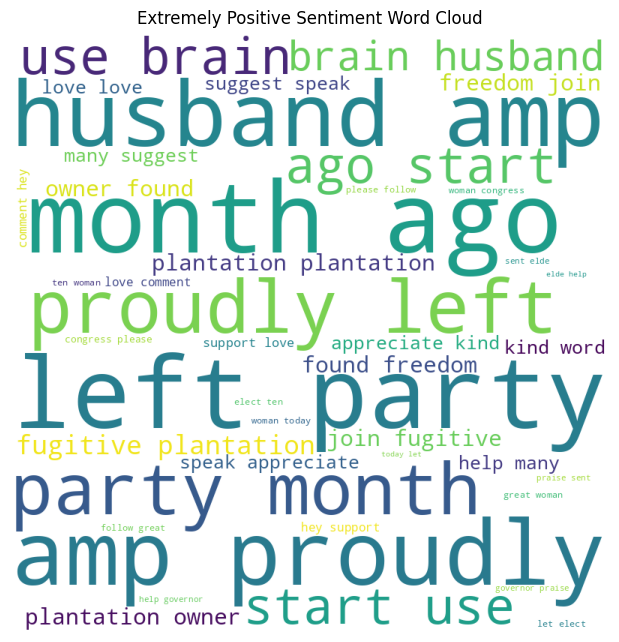

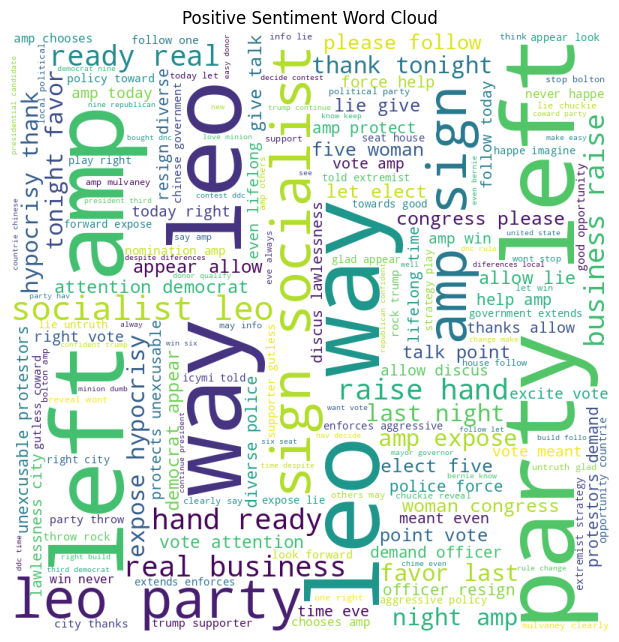

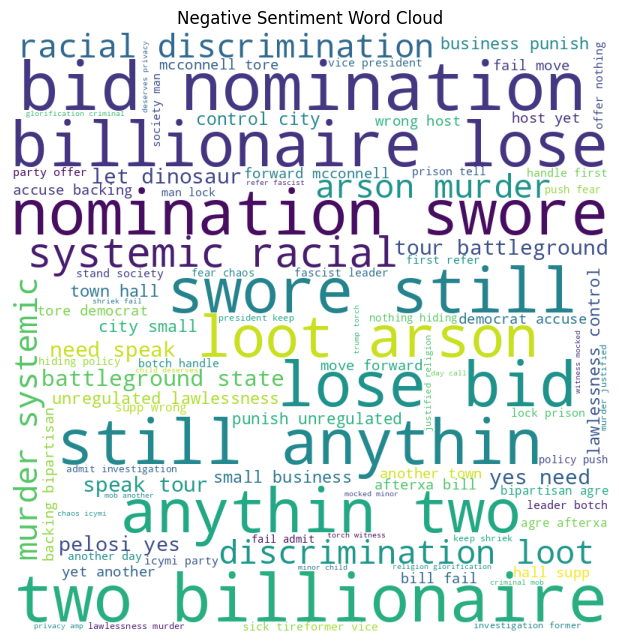

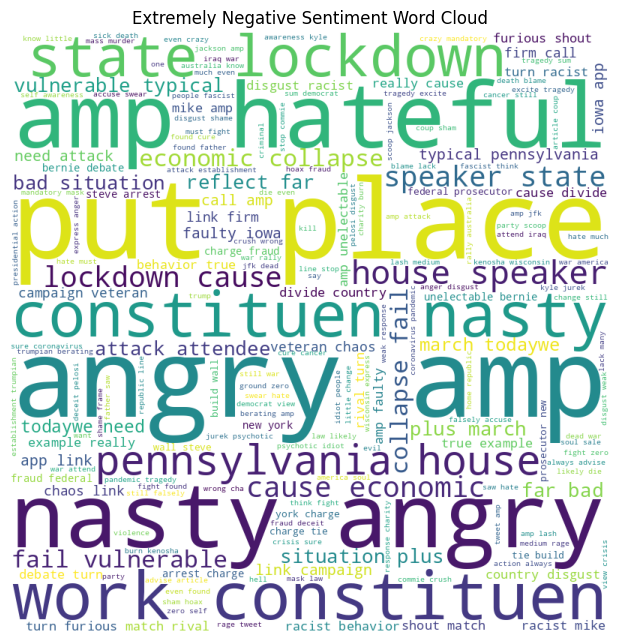

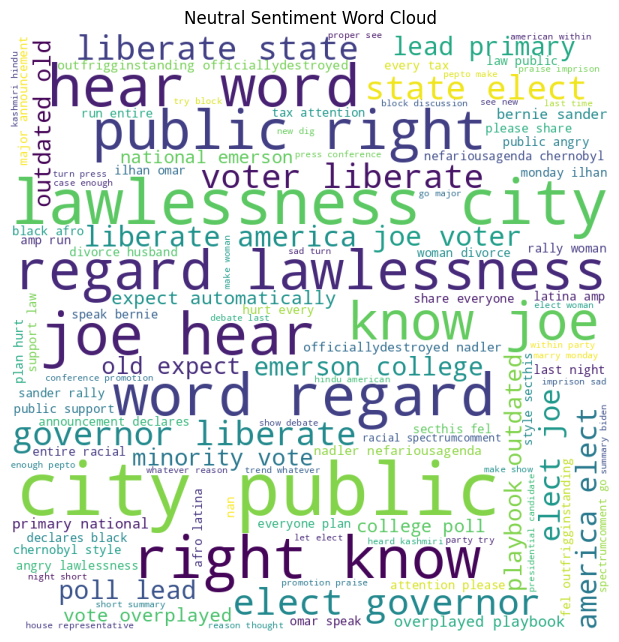

time: 12.3 s (started: 2024-07-23 17:19:05 +00:00)


In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

# Filter the DataFrame for each sentiment label
extremely_positive_df = df_democratic[df_democratic['vader_sentiment_category'] == 'Extremely Positive']
positive_df = df_democratic[df_democratic['vader_sentiment_category'] == 'Positive']
negative_df = df_democratic[df_democratic['vader_sentiment_category'] == 'Negative']
extremely_negative_df = df_democratic[df_democratic['vader_sentiment_category'] == 'Extremely Negative']
neutral_df = df_democratic[df_democratic['vader_sentiment_category'] == 'Neutral']

# Combine text for each sentiment
extremely_positive_text = " ".join(extremely_positive_df['text_clean'])
positive_text = " ".join(positive_df['text_clean'])
negative_text = " ".join(negative_df['text_clean'])
extremely_negative_text = " ".join(extremely_negative_df['text_clean'])
neutral_text = " ".join(str(text) for text in neutral_df['text_clean'])

# Create WordCloud objects
stopwords = set(STOPWORDS)
wordcloud_ep = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_positive_text)
wordcloud_p = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(positive_text)
wordcloud_n = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(negative_text)
wordcloud_en = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_negative_text)

wordcloud_ne = WordCloud(width = 800, height = 800,
                background_color = 'white',
                stopwords = stopwords,
                min_font_size = 10).generate(neutral_text)

# Plot the WordClouds
plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ep)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_p)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_n)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_en)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ne)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Neutral Sentiment Word Cloud")
plt.show()


# 1.3 BERT Model by VADER sentimentic analyzer
## Fine-tune a pre-trained BERT model using the labeled data.

In [ ]:
from sklearn.model_selection import train_test_split
from transformers import BertTokenizer, BertForSequenceClassification, Trainer, TrainingArguments
from torch.utils.data import Dataset, DataLoader
import torch

# Split data into training and test sets
train_texts, val_texts, train_labels, val_labels = train_test_split(
    df_democratic['text_clean'], df_democratic['label'], test_size=0.2, random_state=42)

In [ ]:
# Initialize BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

In [ ]:
# Define a custom dataset class for BERT
class SentimentDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]
        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            pad_to_max_length=True,
            return_attention_mask=True,
            return_tensors='pt',
        )
        return {
            'text': text,
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Create datasets and dataloaders
train_dataset = SentimentDataset(train_texts.values, train_labels.values, tokenizer, max_len=128)
val_dataset = SentimentDataset(val_texts.values, val_labels.values, tokenizer, max_len=128)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)


In [ ]:
# Define Model
from transformers import BertForSequenceClassification

# Load a pre-trained BERT model for sequence classification
model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=len(label_dict))

# Move model to GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


BertForSequenceClassification(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSdpaSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e

## Set up training loop

In [ ]:
from torch.optim import AdamW
from torch.nn import CrossEntropyLoss
from sklearn.metrics import accuracy_score

# Define optimizer and loss function
optimizer = AdamW(model.parameters(), lr=2e-5)
loss_fn = CrossEntropyLoss()

# Training loop
epochs = 3
for epoch in range(epochs):
    model.train()
    total_loss = 0
    correct_predictions = 0
    total_predictions = 0

    for batch in train_loader:
        optimizer.zero_grad()

        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['label'].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        logits = outputs.logits

        _, preds = torch.max(logits, dim=1)
        correct_predictions += torch.sum(preds == labels)
        total_predictions += labels.size(0)

        total_loss += loss.item()
        loss.backward()
        optimizer.step()

    avg_train_loss = total_loss / len(train_loader)
    train_accuracy = correct_predictions.double() / total_predictions

    print(f"Epoch {epoch+1}/{epochs}")
    print(f"Train loss: {avg_train_loss}, Train accuracy: {train_accuracy}")

Truncation was not explicitly activated but `max_length` is provided a specific value, please use `truncation=True` to explicitly truncate examples to max length. Defaulting to 'longest_first' truncation strategy. If you encode pairs of sequences (GLUE-style) with the tokenizer you can select this strategy more precisely by providing a specific strategy to `truncation`.
/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2699: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 1/3
Train loss: 0.1646691172898995, Train accuracy: 0.9426109708608865
Epoch 2/3
Train loss: 0.053239346188606054, Train accuracy: 0.9812501916374526
Epoch 3/3
Train loss: 0.032028198695764426, Train accuracy: 0.9887112764587443


In [ ]:
# Evaluate on validation set
model.eval()
val_loss = 0
val_correct_predictions = 0
val_total_predictions = 0

all_preds = []
all_labels = []

with torch.no_grad():
    for batch in val_loader:
        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['label'].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        logits = outputs.logits

        _, preds = torch.max(logits, dim=1)

        val_correct_predictions += torch.sum(preds == labels)
        val_total_predictions += labels.size(0)

        val_loss += loss.item()

        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(labels.cpu().numpy())

avg_val_loss = val_loss / len(val_loader)
val_accuracy = val_correct_predictions.double() / val_total_predictions

In [ ]:
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score

# Calculate additional metrics
accuracy = accuracy_score(all_labels, all_preds)
f1 = f1_score(all_labels, all_preds, average='weighted')
recall = recall_score(all_labels, all_preds, average='weighted')
precision = precision_score(all_labels, all_preds, average='weighted')

print(f"Validation loss: {avg_val_loss}")
print(f"Validation accuracy: {val_accuracy}")
print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1}")
print(f"Recall: {recall}")
print(f"Precision: {precision}")


Validation loss: 0.06786075957764204
Validation accuracy: 0.9798859385539953
Accuracy: 0.9798859385539952
F1 Score: 0.9800075634328038
Recall: 0.9798859385539952
Precision: 0.980446603631743


In [ ]:
from sklearn.metrics import confusion_matrix

# Calculate confusion matrix
cm_bert = confusion_matrix(all_labels, all_preds)

# Print confusion matrix
print(cm_bert)


[[ 1591     0    10     0     0]
 [    0  8958     0     0    38]
 [  221     0  8835    31     6]
 [    5     0   303 15109    52]
 [    2   138     9   169 13444]]


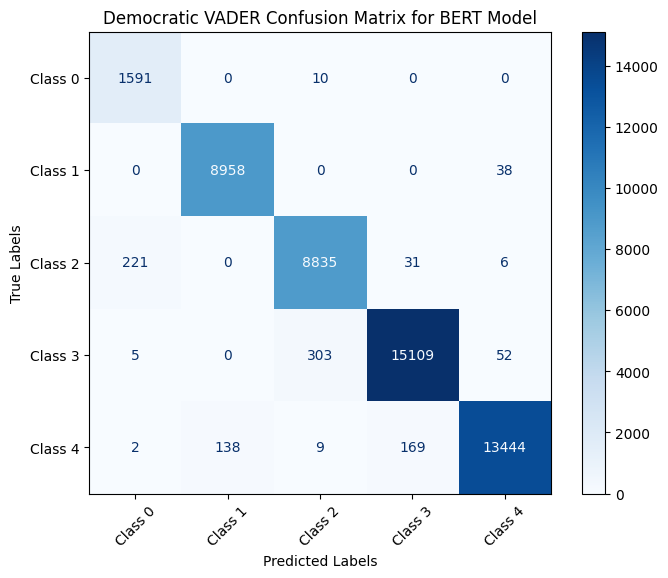

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 1591,0,10,0,0],
 [ 0,8958,0,0,38],
 [ 221,0,8835,31,6],
 [ 5,0,303,15109,52],
 [ 2,138,9,169,13444]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('Democratic VADER Confusion Matrix for BERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()


# 1.4 DistilBERT by VADER Sentiment Analyzer

In [ ]:
import torch
from transformers import DistilBertTokenizer, DistilBertForSequenceClassification, Trainer, TrainingArguments
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
from torch.utils.data import DataLoader, Dataset
import numpy as np

# Define a custom Dataset class
class TextDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]

        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            padding='max_length',
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )

        return {
            'text': text,
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }



In [ ]:
# Prepare the data for DistilBERT
def prepare_data(df, tokenizer, max_len, batch_size):
    le = LabelEncoder()
    df['label'] = le.fit_transform(df['vader_sentiment_category'])

    train_texts, val_texts, train_labels, val_labels = train_test_split(
        df['text_clean'].values,
        df['label'].values,
        test_size=0.1,
        random_state=42
    )

    train_dataset = TextDataset(
        texts=train_texts,
        labels=train_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    val_dataset = TextDataset(
        texts=val_texts,
        labels=val_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size)

    return train_loader, val_loader, val_labels, le

# Define evaluation metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    acc = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    recall = recall_score(labels, preds, average='weighted')
    precision = precision_score(labels, preds, average='weighted')
    return {
        'accuracy': acc,
        'f1': f1,
        'recall': recall,
        'precision': precision
    }


In [ ]:
# Set parameters
MAX_LEN = 128
BATCH_SIZE = 16

# Prepare data for DistilBERT
distilbert_tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
train_loader, val_loader, val_labels, label_encoder = prepare_data(df_democratic, distilbert_tokenizer, MAX_LEN, BATCH_SIZE)

# Initialize DistilBERT model
distilbert_model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=5)

# Train DistilBERT model
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    evaluation_strategy="epoch"
)

trainer = Trainer(
    model=distilbert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

# Print DistilBERT evaluation results
for key, value in results.items():
    print(f"{key}: {value}")


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.108800,0.100280,0.972609,0.972595,0.972609,0.972872
2,0.006700,0.062328,0.985569,0.985576,0.985569,0.985592
3,0.008500,0.060815,0.988308,0.988316,0.988308,0.988334


eval_loss: 0.06081485003232956
eval_accuracy: 0.9883079187277707
eval_f1: 0.9883162019209133
eval_recall: 0.9883079187277707
eval_precision: 0.9883340885014122
eval_runtime: 31.6346
eval_samples_per_second: 773.236
eval_steps_per_second: 48.333
epoch: 3.0


In [ ]:
# Print Validation Accuracy
print(f"Validation Accuracy: {results['eval_accuracy']}")

# Confusion Matrix for DistilBERT
preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
cm_distilbert = confusion_matrix(val_labels, preds)
print("Confusion Matrix for DistilBERT:")
print(cm_distilbert)

Validation Accuracy: 0.9883079187277707


Confusion Matrix for DistilBERT:
[[ 805    0   23    0    0]
 [   0 4459    0    0   29]
 [  40    0 4444   40    2]
 [   1    2   47 7579   37]
 [   0   37    1   27 6888]]


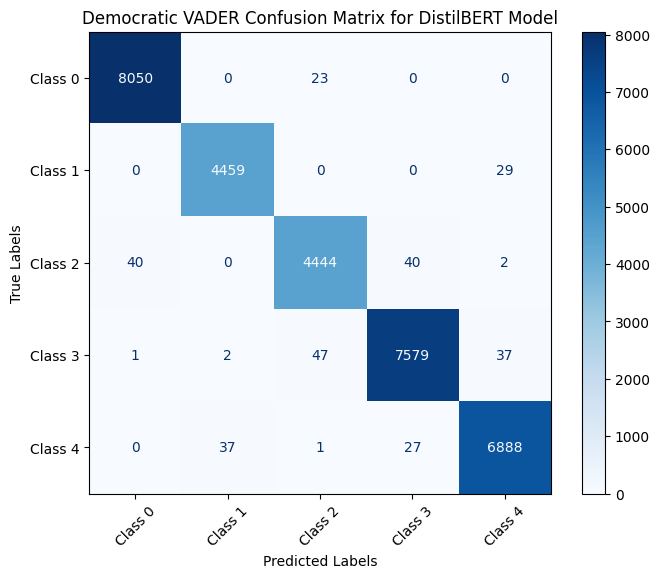

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for DistilBERT
cm = np.array([
 [ 8050,0,23,0,0],
 [ 0,4459,0,0,29],
 [ 40,0,4444,40,2],
 [ 1,2,47,7579,37],
 [ 0,37,1,27,6888]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('Democratic VADER Confusion Matrix for DistilBERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()


# 1.5 TextBlob

In [ ]:
from textblob import TextBlob

# Function to get sentiment score using TextBlob
def get_textblob_sentiment(text):
    return TextBlob(text).sentiment.polarity

# Function to categorize the sentiment score
def categorize_textblob_sentiment(score):
    if score >= 0.7:
        return 'Extremely Positive'
    elif score > 0.2:
        return 'Positive'
    elif -0.2 <= score <= 0.2:
        return 'Neutral'
    elif score >= -0.7:
        return 'Negative'
    else:
        return 'Extremely Negative'

time: 597 µs (started: 2024-07-20 11:46:42 +00:00)


In [ ]:
# Apply TextBlob sentiment analysis
df_democratic['TextBlob_Score'] = df_democratic['text_clean'].astype(str).apply(get_textblob_sentiment)
df_democratic['Sentiment_Category'] = df_democratic['TextBlob_Score'].apply(categorize_textblob_sentiment)

# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_D_TextBlob_updated.csv'
df_democratic.to_csv(output_file_path, index=False)

pd.set_option('display.max_rows', 5)  # To display all rows
print(df_democratic)

        Unnamed: 0                                         text_clean  \
0                0  let elect ten woman congress please follow gre...   
1                1  india welcome noble cause nation every country...   
...            ...                                                ...   
244601      244601  get much do great protective wall donald rest ...   
244602      244602  long suppose inauguration fake president elect...   

       Vader_Sentiment  TextBlob_Score  Sentiment_Category  
0             Positive        0.533333            Positive  
1             Positive        0.561905            Positive  
...                ...             ...                 ...  
244601        Positive        0.800000  Extremely Positive  
244602        Negative        0.083333             Neutral  

[244603 rows x 5 columns]
time: 35.3 s (started: 2024-07-20 11:48:35 +00:00)


In [ ]:
pd.set_option('display.max_rows', 5)  # To display all rows
print(df_democratic)

        Unnamed: 0                                         text_clean  \
0                0  let elect ten woman congress please follow gre...   
1                1  india welcome noble cause nation every country...   
...            ...                                                ...   
244601      244601  get much do great protective wall donald rest ...   
244602      244602  long suppose inauguration fake president elect...   

       Vader_Sentiment  TextBlob_Score  Sentiment_Category  
0             Positive        0.533333            Positive  
1             Positive        0.561905            Positive  
...                ...             ...                 ...  
244601        Positive        0.800000  Extremely Positive  
244602        Negative        0.083333             Neutral  

[244603 rows x 5 columns]


In [ ]:
# Apply refined categorization to TextBlob scores
df_democratic['Sentiment_Category'] = df_democratic['TextBlob_Score'].apply(categorize_textblob_sentiment) # Use the categorization function instead

# Map categories to numerical labels for model training
label_dict = {'Extremely Negative': 0, 'Negative': 1, 'Neutral': 2, 'Positive': 3, 'Extremely Positive': 4}
df_democratic['label'] = df_democratic['Sentiment_Category'].map(label_dict)

print(df_democratic[['text_clean', 'TextBlob_Score', 'Sentiment_Category', 'label']].head())

# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_D_TextBlob_updated.csv'
df_democratic.to_csv(output_file_path, index=False)


                                          text_clean  TextBlob_Score  \
0  let elect ten woman congress please follow gre...        0.533333   
1  india welcome noble cause nation every country...        0.561905   
2                               poll frontrunner run        0.000000   
3             important new paper evaluation availab        0.268182   
4                       youth experience allow build        0.000000   

  Sentiment_Category  label  
0           Positive      3  
1           Positive      3  
2            Neutral      2  
3           Positive      3  
4            Neutral      2  
time: 880 ms (started: 2024-07-20 11:50:34 +00:00)


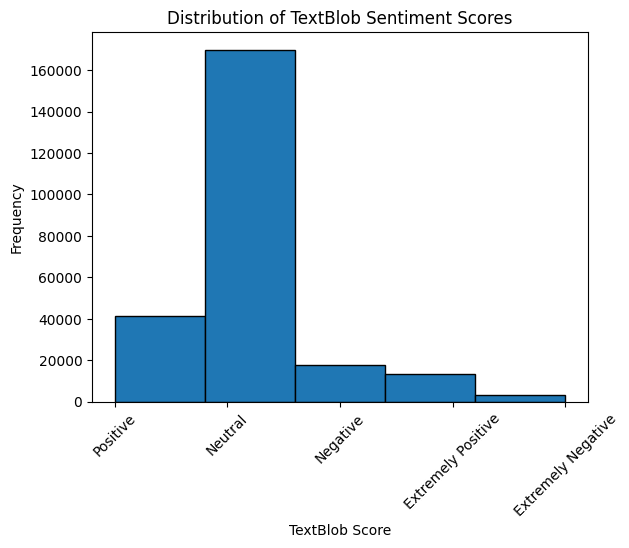

time: 216 ms (started: 2024-07-20 11:52:51 +00:00)


In [ ]:
# After applying self-define TextBlob sentimentic categories the distribution of TextBlob sentiment scores

plt.hist(df_democratic['Sentiment_Category'], bins=5, edgecolor='k')
plt.xlabel('TextBlob Score')
plt.ylabel('Frequency')
plt.title('Distribution of TextBlob Sentiment Scores')
plt.xticks(rotation=45)
plt.show()

In [ ]:
# Read Democratic dataset
df_democratic = pd.read_csv('/content/drive/MyDrive/US_D_TextBlob_updated.csv')
pd.set_option('display.max_columns',None)
df_democratic.head(5)

,Unnamed: 0,text_clean,Vader_Sentiment,TextBlob_Score,Sentiment_Category,label,tokenized_text,token_counts
0,0,let elect ten woman congress please follow gre...,Positive,0.533333,Positive,3,"['let', 'elect', 'ten', 'woman', 'congress', '...",10
1,1,india welcome noble cause nation every country...,Positive,0.561905,Positive,3,"['india', 'welcome', 'noble', 'cause', 'nation...",10
2,2,poll frontrunner run,Neutral,0.000000,Neutral,2,"['poll', 'frontrunner', 'run']",3
3,3,important new paper evaluation availab,Positive,0.268182,Positive,3,"['important', 'new', 'paper', 'evaluation', 'a...",5
4,4,youth experience allow build,Positive,0.000000,Neutral,2,"['youth', 'experience', 'allow', 'build']",4


time: 462 ms (started: 2024-07-23 18:20:38 +00:00)


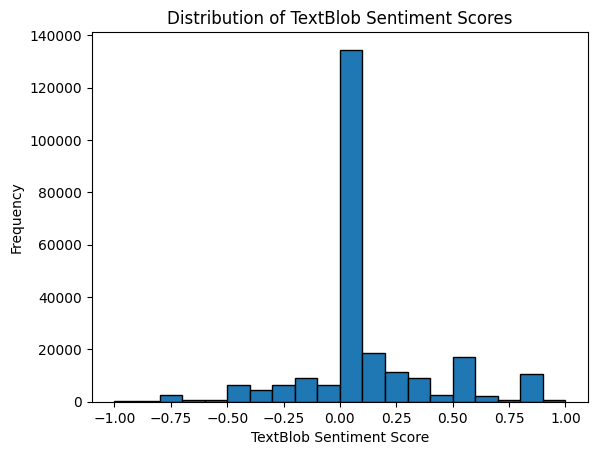

time: 209 ms (started: 2024-07-23 18:21:36 +00:00)


In [ ]:
import matplotlib.pyplot as plt

# Assuming 'df_democratic' is your DataFrame and 'TextBlob_Score' is the column with TextBlob scores
plt.hist(df_democratic['TextBlob_Score'], bins=20, edgecolor='black')
plt.xlabel('TextBlob Sentiment Score')
plt.ylabel('Frequency')
plt.title('Distribution of TextBlob Sentiment Scores')
plt.show()


In [ ]:
# Tokenize 'text_clean' using TextBlob and count tokens
df_democratic['tokenized_text'] = df_democratic['text_clean'].apply(lambda x: TextBlob(str(x)).words)
df_democratic['token_counts'] = df_democratic['tokenized_text'].apply(len)

# Display the results
print(df_democratic[['text_clean', 'tokenized_text', 'token_counts']].head())

# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_D_TextBlob_updated.csv'
df_democratic.to_csv(output_file_path, index=False)

                                          text_clean  \
0  let elect ten woman congress please follow gre...   
1  india welcome noble cause nation every country...   
2                               poll frontrunner run   
3             important new paper evaluation availab   
4                       youth experience allow build   

                                      tokenized_text  token_counts  
0  [let, elect, ten, woman, congress, please, fol...            10  
1  [india, welcome, noble, cause, nation, every, ...            10  
2                           [poll, frontrunner, run]             3  
3       [important, new, paper, evaluation, availab]             5  
4                  [youth, experience, allow, build]             4  
time: 35.7 s (started: 2024-07-23 17:50:17 +00:00)


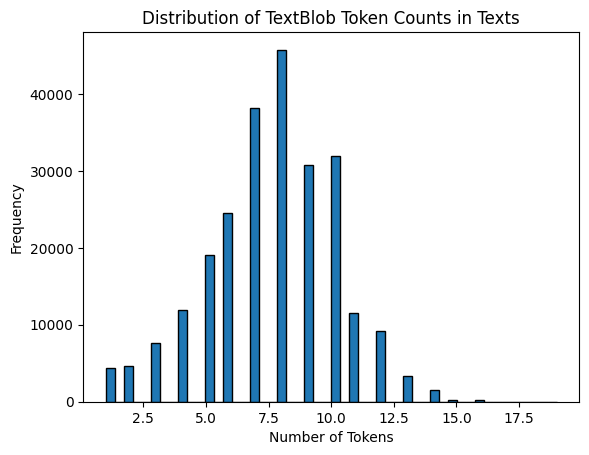

count    244603.000000
mean          7.614878
std           2.560252
min           1.000000
25%           6.000000
50%           8.000000
75%           9.000000
max          19.000000
Name: token_counts, dtype: float64


<Figure size 640x480 with 0 Axes>

time: 281 ms (started: 2024-07-23 17:51:24 +00:00)


In [ ]:
# Plot the distribution of token counts
import matplotlib.pyplot as plt

plt.hist(df_democratic['token_counts'], bins=50, edgecolor='k')
plt.xlabel('Number of Tokens')
plt.ylabel('Frequency')
plt.title('Distribution of TextBlob Token Counts in Texts')
plt.show()
plt.savefig('/content/drive/MyDrive/Democratic_token_count_TextBlob_distribution.png')

# Print basic statistics
print(df_democratic['token_counts'].describe())


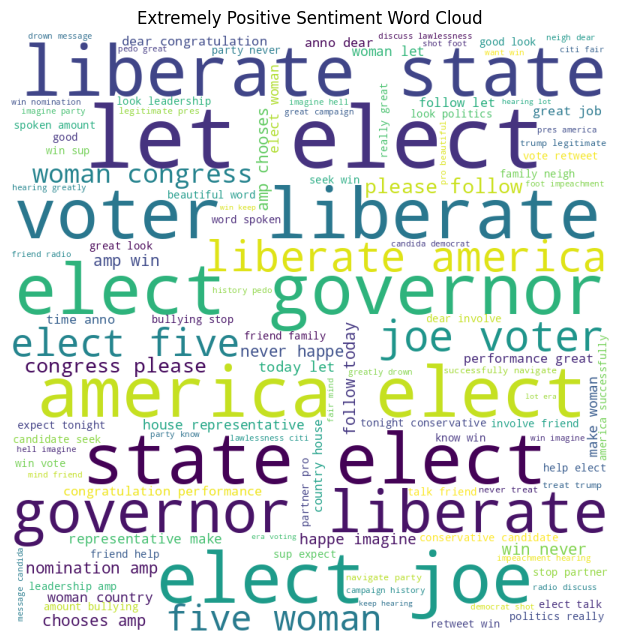

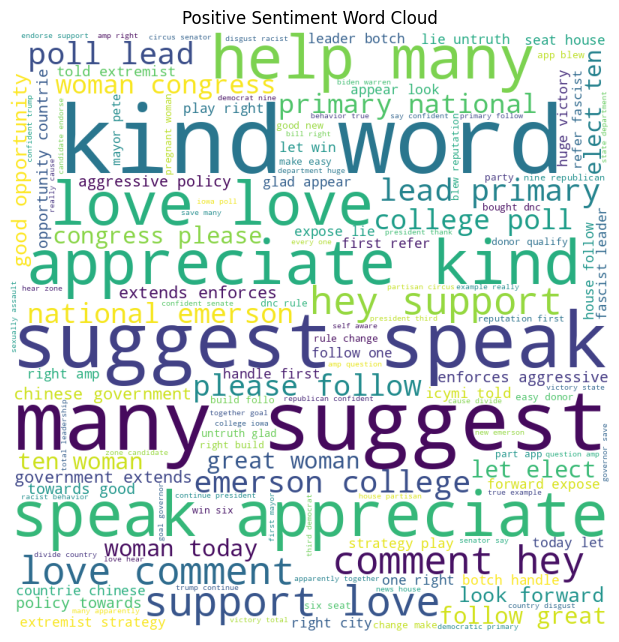

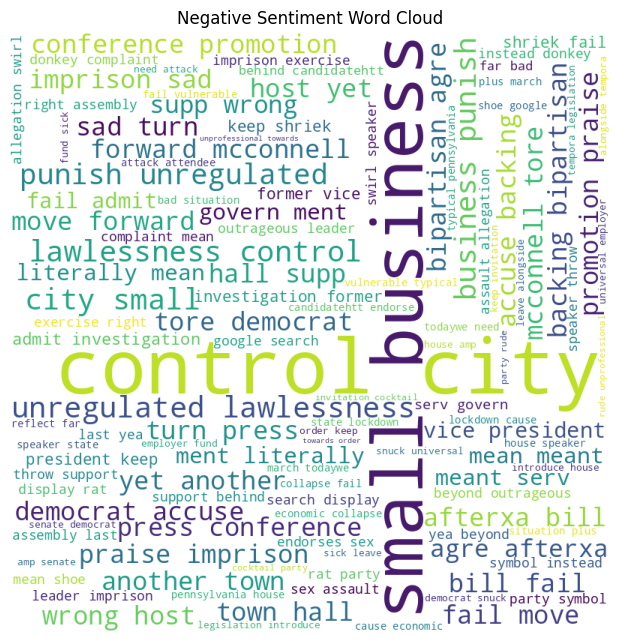

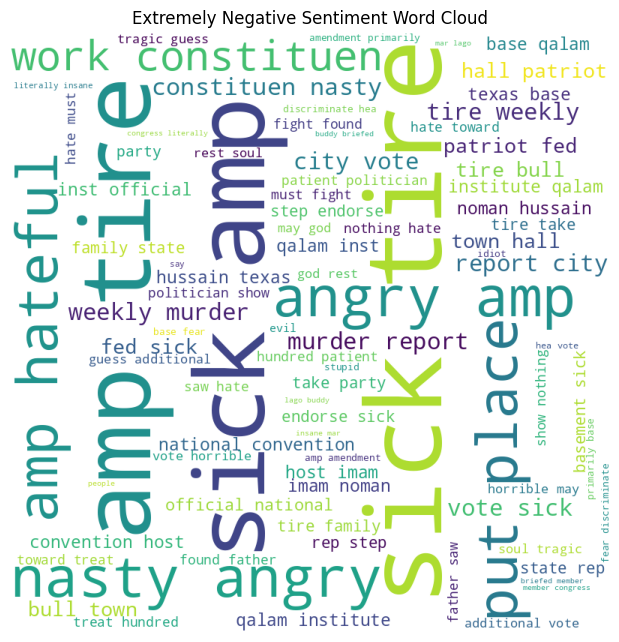

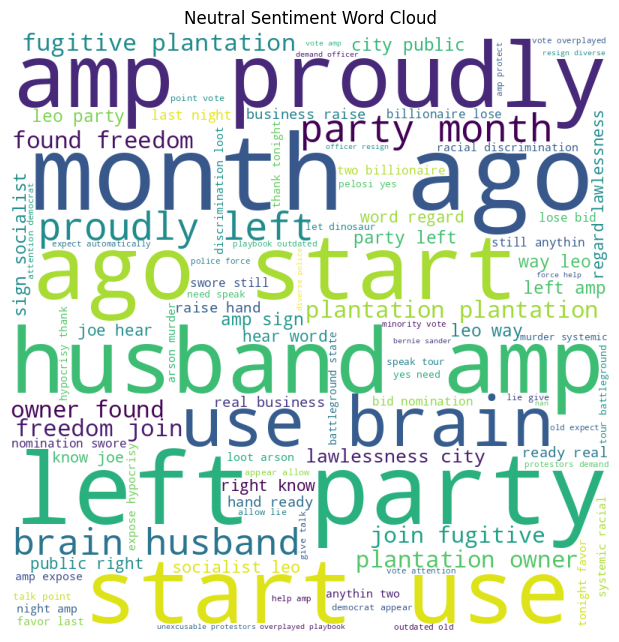

time: 11.7 s (started: 2024-07-23 17:55:39 +00:00)


In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

# Filter the DataFrame for each sentiment label
extremely_positive_df = df_democratic[df_democratic['Sentiment_Category'] == 'Extremely Positive']
positive_df = df_democratic[df_democratic['Sentiment_Category'] == 'Positive']
negative_df = df_democratic[df_democratic['Sentiment_Category'] == 'Negative']
extremely_negative_df = df_democratic[df_democratic['Sentiment_Category'] == 'Extremely Negative']
neutral_df = df_democratic[df_democratic['Sentiment_Category'] == 'Neutral']

# Combine text for each sentiment
extremely_positive_text = " ".join(extremely_positive_df['text_clean'])
positive_text = " ".join(positive_df['text_clean'])
negative_text = " ".join(negative_df['text_clean'])
extremely_negative_text = " ".join(extremely_negative_df['text_clean'])
neutral_text = " ".join(str(text) for text in neutral_df['text_clean'])

# Create WordCloud objects
stopwords = set(STOPWORDS)
wordcloud_ep = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_positive_text)
wordcloud_p = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(positive_text)
wordcloud_n = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(negative_text)
wordcloud_en = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_negative_text)

wordcloud_ne = WordCloud(width = 800, height = 800,
                background_color = 'white',
                stopwords = stopwords,
                min_font_size = 10).generate(neutral_text)

# Plot the WordClouds
plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ep)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_p)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_n)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_en)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ne)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Neutral Sentiment Word Cloud")
plt.show()


# 1.5 BERT Model via TextBlob

In [ ]:
import torch
from transformers import BertTokenizer, BertForSequenceClassification, DistilBertTokenizer, DistilBertForSequenceClassification, Trainer, TrainingArguments
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
from torch.utils.data import DataLoader, Dataset

# Define a custom Dataset class
class TextDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]

        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            padding='max_length',
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )

        return {
            'text': text,
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }



In [ ]:
# Prepare the data for BERT and DistilBERT
def prepare_data(df, tokenizer, max_len, batch_size):
    le = LabelEncoder()
    df['label'] = le.fit_transform(df['Sentiment_Category'])

    train_texts, val_texts, train_labels, val_labels = train_test_split(
        df['text_clean'].values,
        df['label'].values,
        test_size=0.1,
        random_state=42
    )

    train_dataset = TextDataset(
        texts=train_texts,
        labels=train_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    val_dataset = TextDataset(
        texts=val_texts,
        labels=val_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size)

    return train_loader, val_loader, le, val_labels


In [ ]:
# Set parameters
MAX_LEN = 128
BATCH_SIZE = 16

# Prepare data for BERT
bert_tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
train_loader, val_loader, label_encoder = prepare_data(df_democratic, bert_tokenizer, MAX_LEN, BATCH_SIZE)

# Initialize BERT model
bert_model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=5)

# Define evaluation metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    acc = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    recall = recall_score(labels, preds, average='weighted')
    precision = precision_score(labels, preds, average='weighted')
    return {
        'accuracy': acc,
        'f1': f1,
        'recall': recall,
        'precision': precision
    }

# Train BERT model
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    evaluation_strategy="epoch"
)

trainer = Trainer(
    model=bert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

# Print BERT evaluation results
for key, value in results.items():
    print(f"{key}: {value}")


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.023100,0.064819,0.987204,0.987205,0.987204,0.987219
2,0.000700,0.040169,0.992314,0.992320,0.992314,0.992333
3,0.000200,0.035941,0.993868,0.993873,0.993868,0.993882


eval_loss: 0.035941362380981445
eval_accuracy: 0.9938677895425371
eval_f1: 0.9938728940427181
eval_recall: 0.9938677895425371
eval_precision: 0.9938820057627691
eval_runtime: 51.5499
eval_samples_per_second: 474.511
eval_steps_per_second: 29.661
epoch: 3.0


In [ ]:
from sklearn.metrics import confusion_matrix

# Confusion Matrix for BERT
preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
cm_bert = confusion_matrix(val_labels, preds)
print("Confusion Matrix for BERT:")
print(cm_bert)

Confusion Matrix for BERT:
[[  273     1     3    40     0]
 [  405    14    10   910     0]
 [ 1575     4    30    76     0]
 [10220   396   313  6017     0]
 [ 1235    85   170  2684     0]]


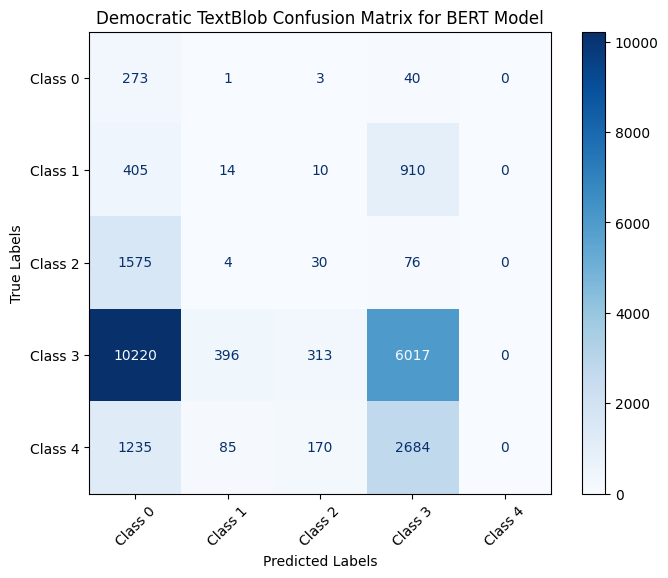

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 273,1,3,40,0],
 [ 405,14,10,910,0],
 [ 1575,4,30,76,0],
 [ 10220,396,313,6017,0],
 [ 1235,85,170,2684,0]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('Democratic TextBlob Confusion Matrix for BERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

Summary
* The high validation accuracy (99.46%) suggests that the BERT model is very effective at predicting sentiment categories.
* The confusion matrix shows a detailed breakdown of the correct and incorrect predictions, with most categories having a high number of correct predictions.
* There are some misclassifications, particularly between categories like Neutral and Positive or Positive and Extremely Positive, but these are relatively few compared to the total number of predictions.
* The results indicate that the BERT model is performing very well on this sentiment analysis task.

# 1.6 DistilBERT Model via TextBlob

In [ ]:
# Prepare data for DistilBERT
distilbert_tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
train_loader, val_loader, label_encoder = prepare_data(df_democratic, distilbert_tokenizer, MAX_LEN, BATCH_SIZE)

# Initialize DistilBERT model
distilbert_model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=5)

# Train DistilBERT model
trainer = Trainer(
    model=distilbert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

# Print DistilBERT evaluation results
for key, value in results.items():
    print(f"{key}: {value}")


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


config.json:   0%|          | 0.00/483 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.001100,0.054336,0.988758,0.988770,0.988758,0.988792
2,0.000300,0.035172,0.993459,0.993457,0.993459,0.993458
3,0.000100,0.030990,0.994563,0.994565,0.994563,0.994571


eval_loss: 0.030989939346909523
eval_accuracy: 0.9945627733943829
eval_f1: 0.9945653261973534
eval_recall: 0.9945627733943829
eval_precision: 0.9945708318656417
eval_runtime: 32.6234
eval_samples_per_second: 749.8
eval_steps_per_second: 46.868
epoch: 3.0


In [ ]:
# Print Validation Accuracy
print(f"Validation Accuracy: {results['eval_accuracy']}")

# Extract validation labels
val_labels = val_loader.dataset.labels  # Add this line to get labels from the validation dataset

# Confusion Matrix for DistilBERT
preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
cm_distilbert = confusion_matrix(val_labels, preds)
print("Confusion Matrix for DistilBERT:")
print(cm_distilbert)

Validation Accuracy: 0.9945627733943829


Confusion Matrix for DistilBERT:
[[  312     0     5     0     0]
 [    0  1329     0     0    10]
 [    1     0  1663    21     0]
 [    0     2    21 16883    40]
 [    0     6     0    27  4141]]


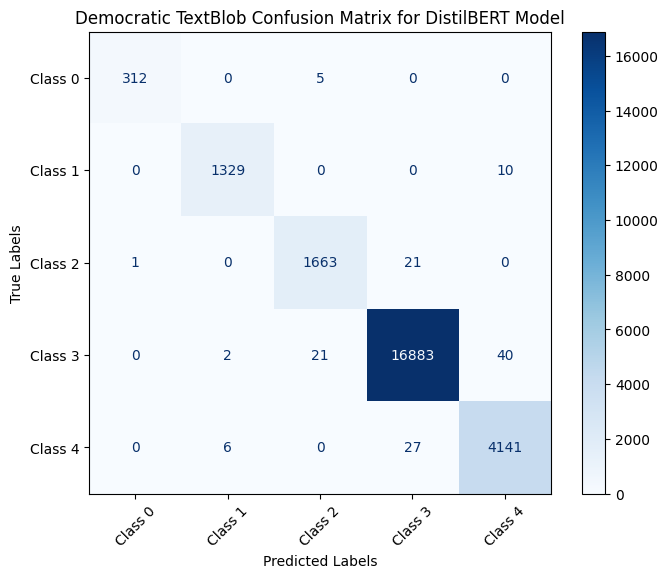

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for DistilBERT
cm = np.array([
 [ 312,0,5,0,0],
 [ 0,1329,0,0,10],
 [ 1,0,1663,21,0],
 [ 0,2,21,16883,40],
 [ 0,6,0,27,4141]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('Democratic TextBlob Confusion Matrix for DistilBERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# **Dataset 2: US Republican**

In [ ]:
# Read republican dataset

df_republican = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/US_Presidential_Election_2020_Dem_Rep /republican.csv')
df_republican.head(5)

,Unnamed: 0,text_clean,Vader_Sentiment
0,0,must intel comms kremlin putin know member hou...,Neutral
1,1,pre,Neutral
2,2,sad doj truth know filter government,Negative
3,3,every watch clip turn,Neutral
4,4,former congresspersons today republican party,Positive


In [ ]:
df_republican.shape

(1626990, 3)

In [ ]:
df_republican['Vader_Sentiment'].value_counts()

Vader_Sentiment
Positive    614505
Negative    575609
Neutral     436876
Name: count, dtype: int64

In [ ]:
df_republican.isnull().all()

Unnamed: 0         False
text_clean         False
Vader_Sentiment    False
dtype: bool

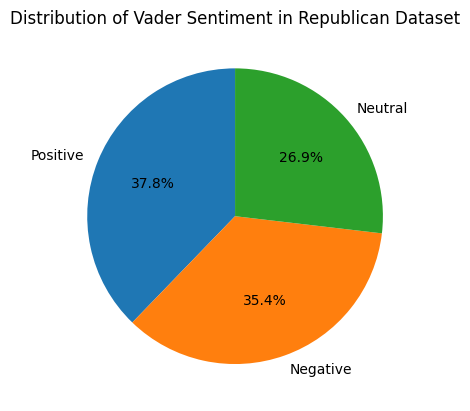

In [ ]:
import matplotlib.pyplot as plt
# Count the occurrences of each sentiment
sentiment_counts = df_republican['Vader_Sentiment'].value_counts()

# Create a pie chart
plt.pie(sentiment_counts, labels=sentiment_counts.index, autopct='%1.1f%%', startangle=90)
plt.title('Distribution of Vader Sentiment in Republican Dataset')
plt.show()


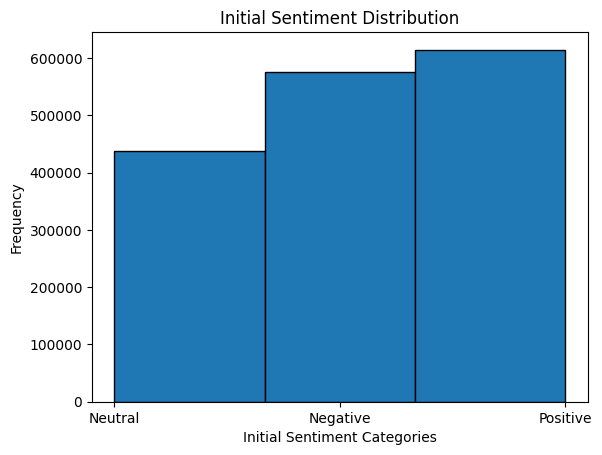

In [ ]:
# Plot initial sentiment distribution
plt.hist(df_republican['Vader_Sentiment'], bins=3, edgecolor='k')
plt.xlabel('Initial Sentiment Categories')
plt.ylabel('Frequency')
plt.title('Initial Sentiment Distribution')
plt.show()

# **2.1 BERT Sentiment Pipline**

## Apply BERT Sentiment Analysis Pipline

In [ ]:
from transformers import pipeline

In [ ]:
# Initialize BERT sentiment analysis pipeline

sentiment_pipeline = pipeline("sentiment-analysis")

No model was supplied, defaulted to distilbert/distilbert-base-uncased-finetuned-sst-2-english and revision af0f99b (https://huggingface.co/distilbert/distilbert-base-uncased-finetuned-sst-2-english).
Using a pipeline without specifying a model name and revision in production is not recommended.
/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


config.json:   0%|          | 0.00/629 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

In [ ]:
# Convert all entries in 'text_clean' to strings
df_republican['text_clean'] = df_republican['text_clean'].astype(str)

# Define function to calculate sentiment score by using BERT
def bert_sentiment(text):
    result = sentiment_pipeline(text)[0]
    if result['label'] == 'NEGATIVE':
        return -result['score']
    else:
        return result['score']

In [ ]:
# Apply the function to the 'text_clean' column
df_republican['bert_sentiment_score'] = df_republican['text_clean'].apply(bert_sentiment)

# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_R_BERT_updated.csv'
df_republican.to_csv(output_file_path, index=False)

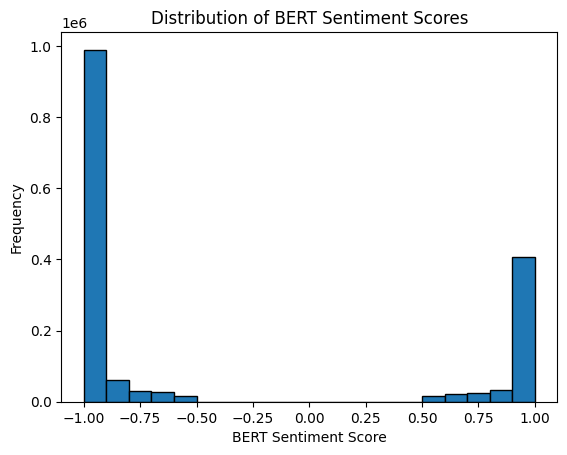

In [ ]:
# Inspect the distribution of sentiment scores
plt.hist(df_republican['bert_sentiment_score'], bins=20, edgecolor='k')
plt.xlabel('BERT Sentiment Score')
plt.ylabel('Frequency')
plt.title('Distribution of BERT Sentiment Scores')
plt.show()

tokenizer_config.json:   0%|          | 0.00/39.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/872k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


config.json:   0%|          | 0.00/953 [00:00<?, ?B/s]

                                          text_clean  token_count
0  must intel comms kremlin putin know member hou...           12
1                                                pre            1
2               sad doj truth know filter government            7
3                              every watch clip turn            4
4      former congresspersons today republican party            7


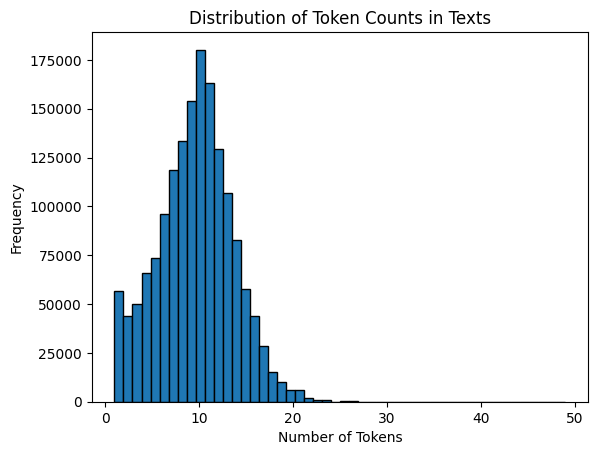

count    1.626990e+06
mean     9.437918e+00
std      4.154773e+00
min      1.000000e+00
25%      7.000000e+00
50%      1.000000e+01
75%      1.200000e+01
max      4.900000e+01
Name: token_count, dtype: float64


<Figure size 640x480 with 0 Axes>

In [ ]:
# Initialize the BERT tokenizer
model_name = "nlptown/bert-base-multilingual-uncased-sentiment"
tokenizer = BertTokenizer.from_pretrained(model_name)

# Tokenize the texts and count the number of tokens
df_republican['token_count'] = df_republican['text_clean'].apply(lambda x: len(tokenizer.tokenize(x)))

# Display the first few rows to check the token counts
print(df_republican[['text_clean', 'token_count']].head())

# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_R_BERT_updated.csv'
df_republican.to_csv(output_file_path, index=False)

# Plot the distribution of token counts
import matplotlib.pyplot as plt

plt.hist(df_republican['token_count'], bins=50, edgecolor='k')
plt.xlabel('Number of Tokens')
plt.ylabel('Frequency')
plt.title('Distribution of Token Counts in Texts')
plt.show()
plt.savefig('republican_token_count_bert_distribution.png')

# Print basic statistics
print(df_republican['token_count'].describe())


In [ ]:
# Initialize the BERT tokenizer
model_name = "nlptown/bert-base-multilingual-uncased-sentiment"
tokenizer = BertTokenizer.from_pretrained(model_name)

sentiment_pipeline = pipeline("sentiment-analysis", model=model_name, tokenizer=tokenizer)

tokenizer_config.json:   0%|          | 0.00/39.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/872k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


config.json:   0%|          | 0.00/953 [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/669M [00:00<?, ?B/s]

In [ ]:
df_republican['text_clean'] = df_republican['text_clean'].astype(str)

In [ ]:
def bert_sentiment(text):
    inputs = tokenizer(text, max_length=256, truncation=True, return_tensors='pt') # pytorch
    tokens = tokenizer.convert_ids_to_tokens(inputs['input_ids'][0])
    truncated_text = tokenizer.convert_tokens_to_string(tokens)
    result = sentiment_pipeline(truncated_text)[0]

    if result['label'] == '1 star':
        score = -1.0
        label = 'Extremely Negative'
    elif result['label'] == '2 stars':
        score = -0.5
        label = 'Negative'
    elif result['label'] == '3 stars':
        score = 0.0
        label = 'Neutral'
    elif result['label'] == '4 stars':
        score = 0.5
        label = 'Positive'
    else:
        score = 1.0
        label = 'Extremely Positive'

    return score, label

df_republican[['bert_sentiment_score', 'bert_sentiment_label']] = df_republican['text_clean'].apply(bert_sentiment).apply(pd.Series)
print(df_republican[['text_clean', 'bert_sentiment_score', 'bert_sentiment_label']].head(5))

# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_R_BERT_updated2.csv'
df_republican.to_csv(output_file_path, index=False)


                                          text_clean  bert_sentiment_score  \
0  must intel comms kremlin putin know member hou...                   1.0   
1                                                pre                   0.5   
2               sad doj truth know filter government                  -1.0   
3                              every watch clip turn                   1.0   
4      former congresspersons today republican party                   0.5   

  bert_sentiment_label  
0   Extremely Positive  
1             Positive  
2   Extremely Negative  
3   Extremely Positive  
4             Positive  
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_R_BERT_updated2.csv'
df_republican.to_csv(output_file_path, index=False)


time: 8.25 s (started: 2024-07-17 16:17:08 +00:00)


In [ ]:
!pip install ipython-autotime
%load_ext autotime


Execution completed!


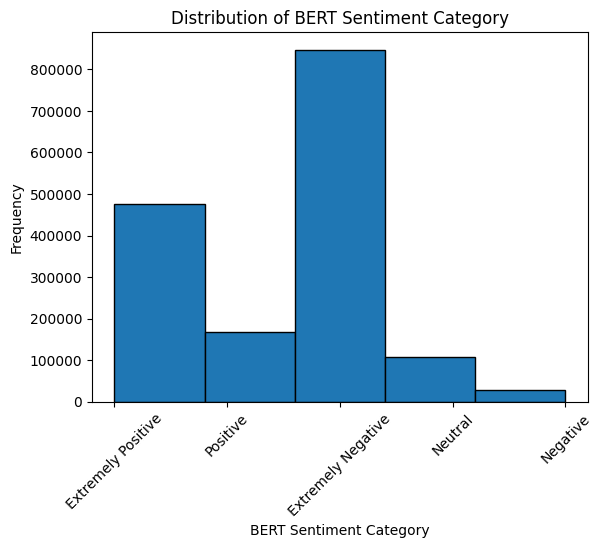

time: 614 ms (started: 2024-07-17 16:18:38 +00:00)


In [ ]:
# Inspect the distribution of sentiment labels
plt.hist(df_republican['bert_sentiment_label'], bins=5, edgecolor='k')
plt.xlabel('BERT Sentiment Category')
plt.xticks(rotation=45)
plt.ylabel('Frequency')
plt.title('Distribution of BERT Sentiment Category')
plt.savefig('republican_bert_sentiment_category_distribution2.png')
plt.show()

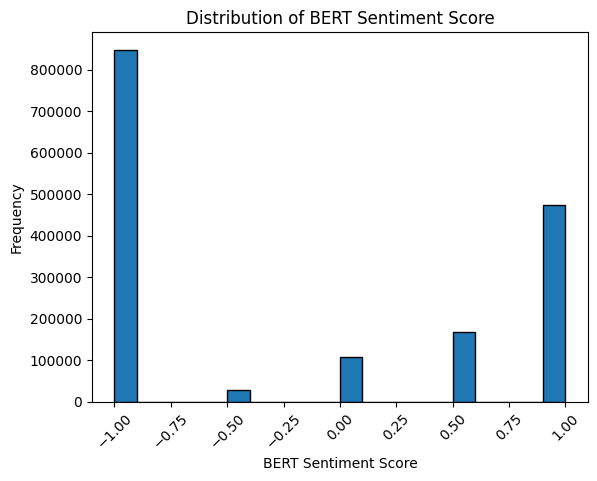

time: 354 ms (started: 2024-07-17 16:14:34 +00:00)


In [ ]:
# The distribution of sentiment scores
plt.hist(df_republican['bert_sentiment_score'], bins=20, edgecolor='k')
plt.xlabel('BERT Sentiment Score')
plt.ylabel('Frequency')
plt.title('Distribution of BERT Sentiment Score')
plt.xticks(rotation=45)
plt.savefig('republican_bert_sentiment_score_distribution2.png')
plt.show()

In [ ]:
# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_R_BERT_updated.csv'
df_republican.to_csv(output_file_path, index=False)

## Repare for data

# NEW Data

In [ ]:
# Read Brexit dataset
df_republican = pd.read_csv('/content/drive/MyDrive/US_R_BERT_updated.csv')
pd.set_option('display.max_columns',None)
df_republican.head(5)

,Unnamed: 0,text_clean,Vader_Sentiment,bert_sentiment_score_original,token_count,bert_sentiment_category,bert_sentiment_label,label,bert_sentiment_score
0,0,must intel comms kremlin putin know member hou...,Neutral,-0.972142,12,1,Extremely Positive,0,1.0
1,1,pre,Neutral,0.976392,1,5,Positive,3,0.5
2,2,sad doj truth know filter government,Negative,-0.994647,7,1,Extremely Negative,0,-1.0
3,3,every watch clip turn,Neutral,-0.884822,4,1,Extremely Positive,0,1.0
4,4,former congresspersons today republican party,Positive,0.988910,7,5,Positive,3,0.5


time: 4.24 s (started: 2024-07-23 20:59:42 +00:00)


In [ ]:
df_republican.shape

(1626990, 9)

time: 2.21 ms (started: 2024-07-18 15:31:54 +00:00)


In [ ]:
df_republican.value_counts(['label'])

label
0        1081177
3         465559
1          43970
2          36284
Name: count, dtype: int64

time: 28.7 ms (started: 2024-07-18 15:31:57 +00:00)


In [ ]:
df_republican.value_counts('bert_sentiment_label')

bert_sentiment_label
Extremely Negative    847714
Extremely Positive    474746
Positive              168657
Neutral               108224
Negative               27649
Name: count, dtype: int64

time: 109 ms (started: 2024-07-18 15:32:00 +00:00)


In [ ]:
# Encode the labels (convert sentiment scores to categories)
label_dict = {-1.0: 0, -0.5: 1, 0: 2, 0.5: 3, 1.0: 4}
df_republican['label'] = df_republican['bert_sentiment_score'].map(label_dict)

# Split data into training and validation sets
train_texts, val_texts, train_labels, val_labels = train_test_split(
    df_republican['text_clean'], df_republican['label'], test_size=0.1, random_state=42)

time: 363 ms (started: 2024-07-19 09:59:14 +00:00)


In [ ]:
df_republican.value_counts(['label'])

label
0        847714
4        474746
3        168657
2        108224
1         27649
Name: count, dtype: int64

time: 34.7 ms (started: 2024-07-19 09:59:19 +00:00)


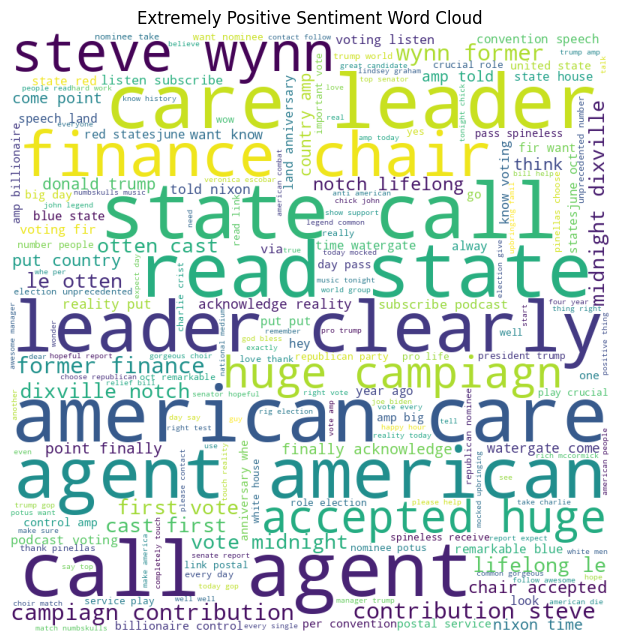

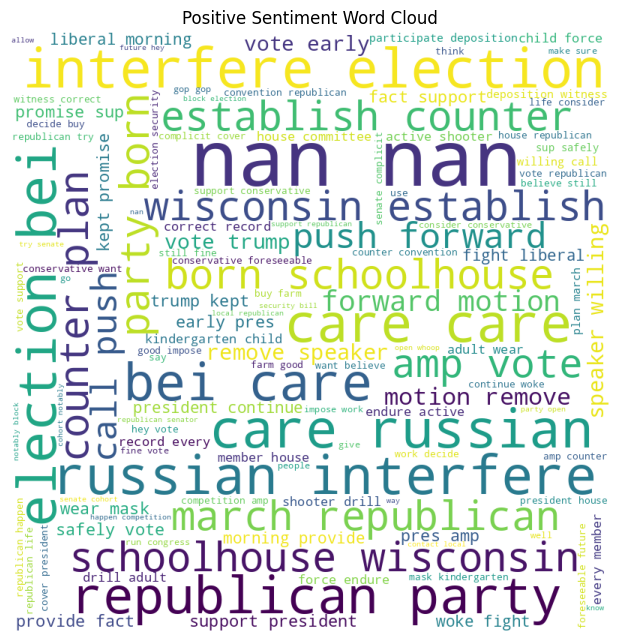

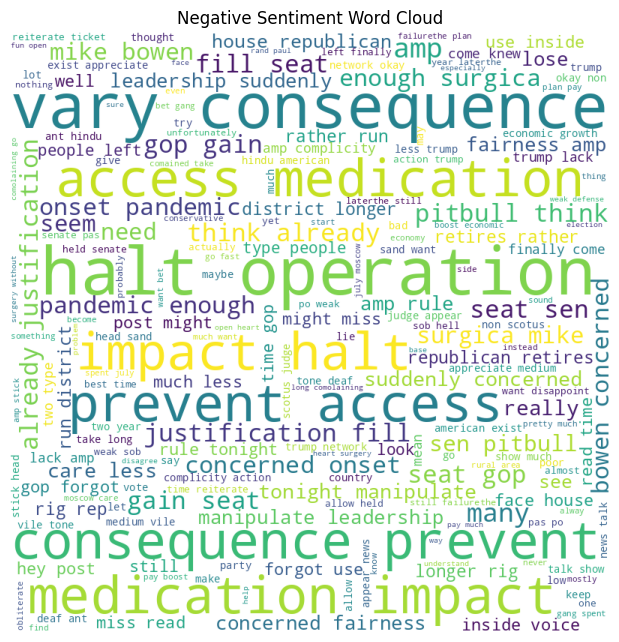

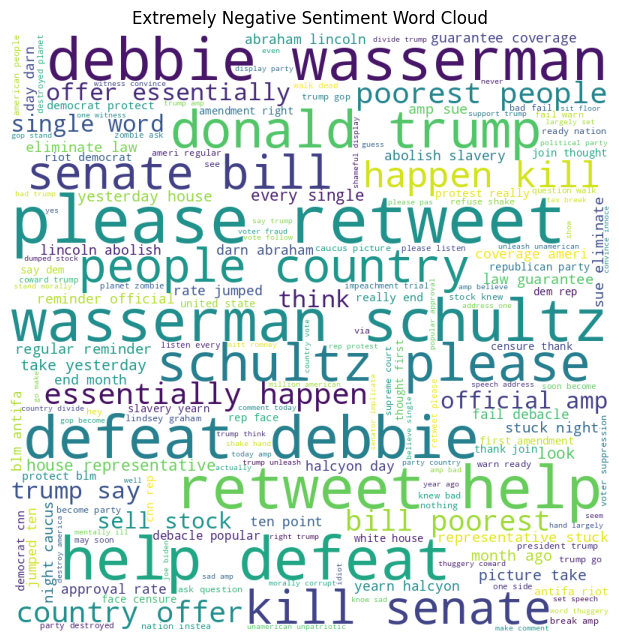

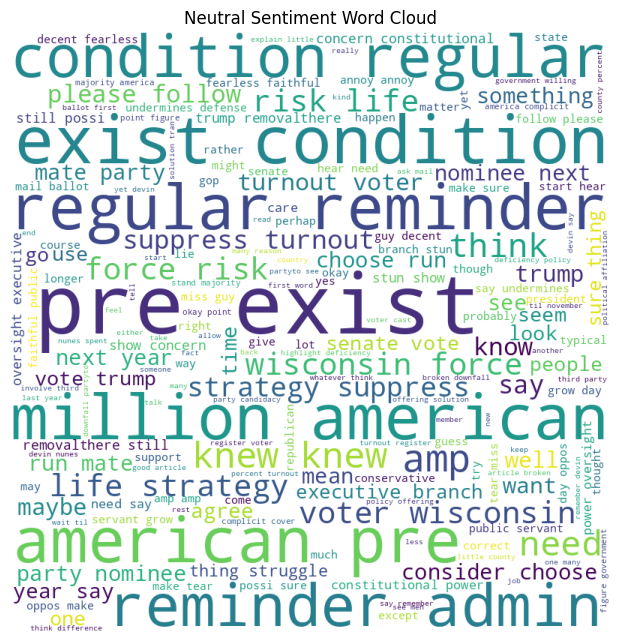

time: 54.9 s (started: 2024-07-23 21:03:09 +00:00)


In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

# Filter the DataFrame for each sentiment label
extremely_positive_df = df_republican[df_republican['bert_sentiment_label'] == 'Extremely Positive']
positive_df = df_republican[df_republican['bert_sentiment_label'] == 'Positive']
negative_df = df_republican[df_republican['bert_sentiment_label'] == 'Negative']
extremely_negative_df = df_republican[df_republican['bert_sentiment_label'] == 'Extremely Negative']
neutral_df = df_republican[df_republican['bert_sentiment_label'] == 'Neutral']

# Combine text for each sentiment
extremely_positive_text = " ".join(extremely_positive_df['text_clean'])
positive_text = " ".join(str(text) for text in positive_df['text_clean']) # Convert each item to string
negative_text = " ".join(negative_df['text_clean'])
extremely_negative_text = " ".join(extremely_negative_df['text_clean'])
neutral_text = " ".join(str(text) for text in neutral_df['text_clean'])

# Create WordCloud objects
stopwords = set(STOPWORDS)
wordcloud_ep = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_positive_text)
wordcloud_p = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(positive_text)
wordcloud_n = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(negative_text)
wordcloud_en = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_negative_text)

wordcloud_ne = WordCloud(width = 800, height = 800,
                background_color = 'white',
                stopwords = stopwords,
                min_font_size = 10).generate(neutral_text)

# Plot the WordClouds
plt.figure(figsize = (6, 8), facecolor = None)
plt.imshow(wordcloud_ep)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 8), facecolor = None)
plt.imshow(wordcloud_p)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 8), facecolor = None)
plt.imshow(wordcloud_n)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 8), facecolor = None)
plt.imshow(wordcloud_en)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 8), facecolor = None)
plt.imshow(wordcloud_ne)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Neutral Sentiment Word Cloud")
plt.show()


# **2.1 BERT model via Pre-trained BERT**

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:591: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g.

Epoch 1/3 - Training loss: 0.24449897898043593
Training Accuracy: 0.9094059855588814
Training F1 Score: 0.9083553055784412
Training Recall: 0.9094059855588814
Training Precision: 0.9079688252015072


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 1/3 - Validation loss: 0.1793868002901479
Validation Accuracy: 0.9343757490826619
Validation F1 Score: 0.9341681358700261
Validation Recall: 0.9343757490826619
Validation Precision: 0.9346716266910063


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 2/3 - Training loss: 0.12189202581225372
Training Accuracy: 0.9550273818523777
Training F1 Score: 0.9548497832228034
Training Recall: 0.9550273818523777
Training Precision: 0.9547414461400862


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 2/3 - Validation loss: 0.15249164315647853
Validation Accuracy: 0.9473752143528847
Validation F1 Score: 0.9471017958521875
Validation Recall: 0.9473752143528847
Validation Precision: 0.9470795699952768


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 3/3 - Training loss: 0.057195598312441004
Training Accuracy: 0.979355879398289
Training F1 Score: 0.9793309505920983
Training Recall: 0.979355879398289
Training Precision: 0.9793126383628602


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 3/3 - Validation loss: 0.16715465213254832
Validation Accuracy: 0.9522000749850952
Validation F1 Score: 0.9520798423671349
Validation Recall: 0.9522000749850952
Validation Precision: 0.9519956936010684


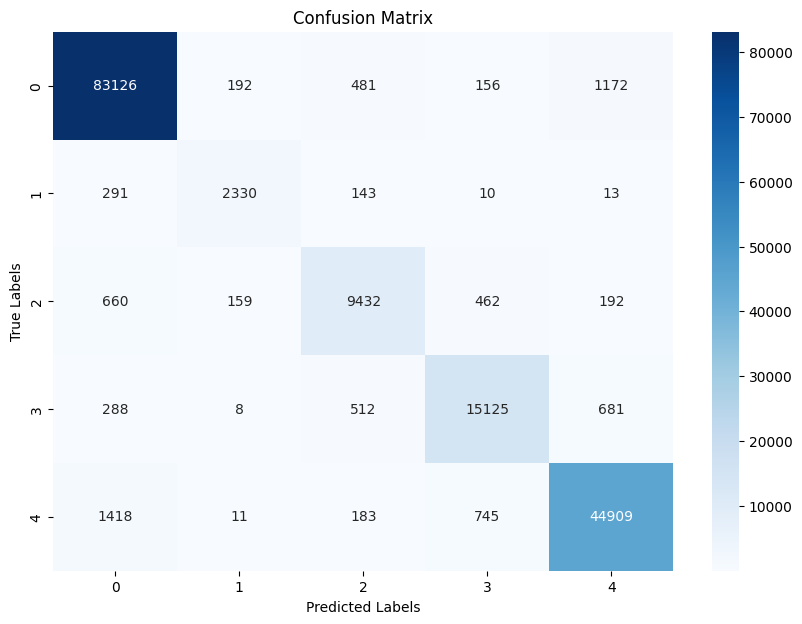

time: 12h 52min 24s (started: 2024-07-18 15:33:56 +00:00)


In [ ]:
from torch.utils.data import Dataset, DataLoader
from transformers import BertTokenizer, BertForSequenceClassification, AdamW, get_linear_schedule_with_warmup
from torch.nn import CrossEntropyLoss
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
import torch
import json
import matplotlib.pyplot as plt
import seaborn as sns

# Define custom dataset class
class SentimentDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = str(self.texts[idx])
        label = self.labels[idx]
        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            pad_to_max_length=True,
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )
        return {
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Initialize BERT tokenizer and datasets
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
train_dataset = SentimentDataset(train_texts.values, train_labels.values, tokenizer, max_len=256)
val_dataset = SentimentDataset(val_texts.values, val_labels.values, tokenizer, max_len=256)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# Load a pre-trained BERT model for sequence classification
model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=5)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Define optimizer and loss function
optimizer = AdamW(model.parameters(), lr=2e-5)
loss_fn = CrossEntropyLoss().to(device)

# Set up learning rate scheduler
total_steps = len(train_loader) * 3  # Assuming 3 epochs
scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=0, num_training_steps=total_steps)

# Training loop
epochs = 3
metrics = []

for epoch in range(epochs):
    model.train()
    total_loss = 0
    all_train_labels = []
    all_train_preds = []

    for batch in train_loader:
        optimizer.zero_grad()

        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['label'].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        total_loss += loss.item()

        loss.backward()
        optimizer.step()
        scheduler.step()

        logits = outputs.logits
        preds = torch.argmax(logits, dim=1).flatten()
        all_train_labels.extend(labels.cpu().numpy())
        all_train_preds.extend(preds.cpu().numpy())

    avg_train_loss = total_loss / len(train_loader)
    train_accuracy = accuracy_score(all_train_labels, all_train_preds)
    train_f1 = f1_score(all_train_labels, all_train_preds, average='weighted')
    train_recall = recall_score(all_train_labels, all_train_preds, average='weighted')
    train_precision = precision_score(all_train_labels, all_train_preds, average='weighted')
    print(f"Epoch {epoch+1}/{epochs} - Training loss: {avg_train_loss}")
    print(f"Training Accuracy: {train_accuracy}")
    print(f"Training F1 Score: {train_f1}")
    print(f"Training Recall: {train_recall}")
    print(f"Training Precision: {train_precision}")

    # Validation
    model.eval()
    val_loss = 0
    all_val_labels = []
    all_val_preds = []

    with torch.no_grad():
        for batch in val_loader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['label'].to(device)

            outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
            loss = outputs.loss
            val_loss += loss.item()

            logits = outputs.logits
            preds = torch.argmax(logits, dim=1).flatten()

            all_val_labels.extend(labels.cpu().numpy())
            all_val_preds.extend(preds.cpu().numpy())

    avg_val_loss = val_loss / len(val_loader)
    val_accuracy = accuracy_score(all_val_labels, all_val_preds)
    val_f1 = f1_score(all_val_labels, all_val_preds, average='weighted')
    val_recall = recall_score(all_val_labels, all_val_preds, average='weighted')
    val_precision = precision_score(all_val_labels, all_val_preds, average='weighted')

    print(f"Epoch {epoch+1}/{epochs} - Validation loss: {avg_val_loss}")
    print(f"Validation Accuracy: {val_accuracy}")
    print(f"Validation F1 Score: {val_f1}")
    print(f"Validation Recall: {val_recall}")
    print(f"Validation Precision: {val_precision}")

    # Save the model and tokenizer after each epoch
    model_save_path = f'/content/drive/MyDrive/results/bert_sentiment_model_epoch_{epoch+1}'
    tokenizer.save_pretrained(model_save_path)
    model.save_pretrained(model_save_path)

    # Save the metrics for each epoch
    metrics.append({
        'epoch': epoch+1,
        'train_loss': avg_train_loss,
        'train_accuracy': train_accuracy,
        'train_f1': train_f1,
        'train_recall': train_recall,
        'train_precision': train_precision,
        'val_loss': avg_val_loss,
        'val_accuracy': val_accuracy,
        'val_f1': val_f1,
        'val_recall': val_recall,
        'val_precision': val_precision
    })

    # Clear memory except for the last epoch's labels and predictions
    if epoch < epochs - 1:
        del val_loss, avg_train_loss, avg_val_loss, train_accuracy, train_f1, train_recall, train_precision
        del val_accuracy, val_f1, val_recall, val_precision
        torch.cuda.empty_cache()

# Save the metrics for all epochs
with open('/content/drive/MyDrive/results/bert_sentiment_metrics.json', 'w') as f:
    json.dump(metrics, f)

# Calculate confusion matrix for the last epoch
cm = confusion_matrix(all_val_labels, all_val_preds)

# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix of Republican via Pre-trained BERT')

# Save the figure
plt.savefig('Republican_bert_confusion_matrix.png')
plt.show()

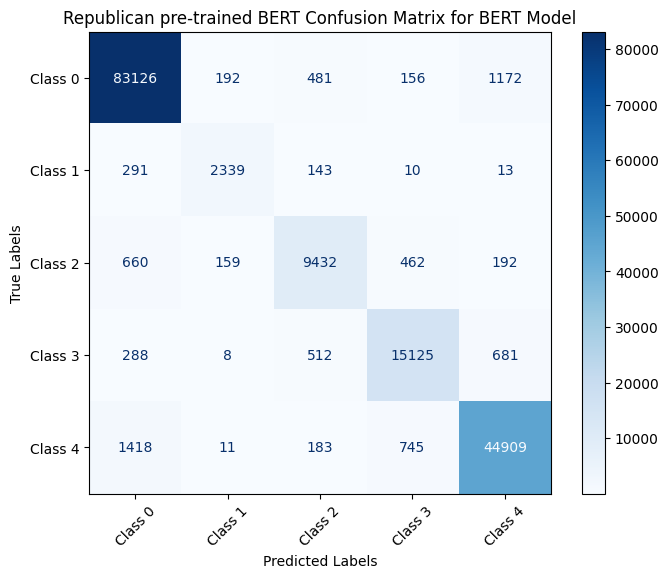

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for DistilBERT
cm = np.array([
 [ 83126,192,481,156,1172],
 [ 291,2339,143,10,13],
 [ 660,159,9432,462,192],
 [ 288,8,512,15125,681],
 [ 1418,11,183,745,44909]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('Republican pre-trained BERT Confusion Matrix for BERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# **2.2 DistlBERT via Pre-trained BERT**  

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/483 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:591: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this 

Epoch 1/3 - Training loss: 0.24406277159892087
Training Accuracy: 0.909332229727561
Training F1 Score: 0.908263461344488
Training Recall: 0.909332229727561
Training Precision: 0.907894896959301


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 1/3 - Validation loss: 0.17363260674967237
Validation Accuracy: 0.9346277481730066
Validation F1 Score: 0.9338122371917192
Validation Recall: 0.9346277481730066
Validation Precision: 0.9340239099131408


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 2/3 - Training loss: 0.12796072239693973
Training Accuracy: 0.9524821227474594
Training F1 Score: 0.9522822134708002
Training Recall: 0.9524821227474594
Training Precision: 0.9521667685917125


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 2/3 - Validation loss: 0.14858418147239438
Validation Accuracy: 0.9470310204733895
Validation F1 Score: 0.946777297951642
Validation Recall: 0.9470310204733895
Validation Precision: 0.946738880403759


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 3/3 - Training loss: 0.06902235744648949
Training Accuracy: 0.974674432882535
Training F1 Score: 0.9746329469900791
Training Recall: 0.974674432882535
Training Precision: 0.9746023754795825


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 3/3 - Validation loss: 0.15907096561156422
Validation Accuracy: 0.9510630059189055
Validation F1 Score: 0.9509526450417173
Validation Recall: 0.9510630059189055
Validation Precision: 0.9508755402342851


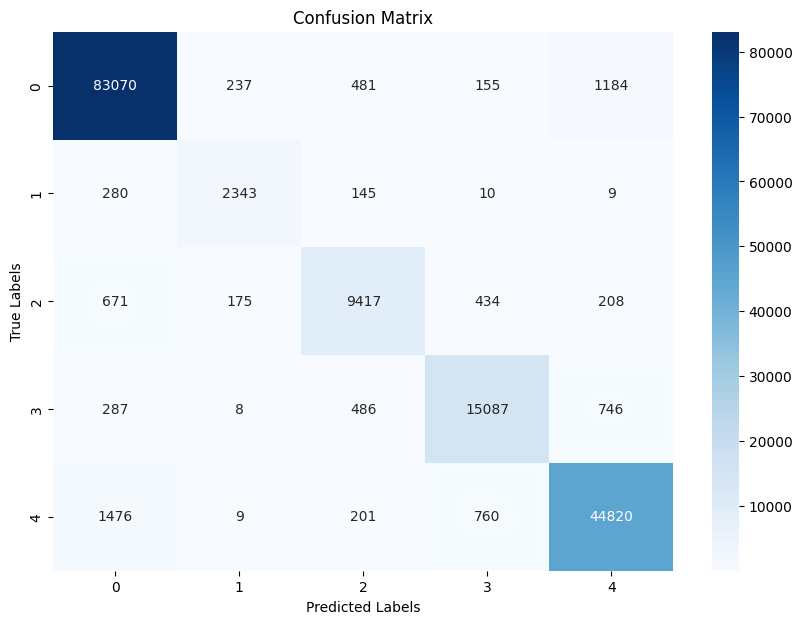

time: 7h 23min 50s (started: 2024-07-19 09:59:34 +00:00)


In [ ]:
from torch.utils.data import Dataset, DataLoader
from transformers import DistilBertTokenizer, DistilBertForSequenceClassification, AdamW, get_linear_schedule_with_warmup
from torch.nn import CrossEntropyLoss
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
import torch
import json
import matplotlib.pyplot as plt
import seaborn as sns

# Define custom dataset class
class SentimentDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = str(self.texts[idx])
        label = self.labels[idx]
        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            pad_to_max_length=True,
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )
        return {
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Initialize DistilBERT tokenizer and datasets
tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
train_dataset = SentimentDataset(train_texts.values, train_labels.values, tokenizer, max_len=256)
val_dataset = SentimentDataset(val_texts.values, val_labels.values, tokenizer, max_len=256)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# Load a pre-trained DistilBERT model for sequence classification
model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=5)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Define optimizer and loss function
optimizer = AdamW(model.parameters(), lr=2e-5)
loss_fn = CrossEntropyLoss().to(device)

# Set up learning rate scheduler
total_steps = len(train_loader) * 3  # Assuming 3 epochs
scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=0, num_training_steps=total_steps)

# Training loop
epochs = 3
metrics = []

for epoch in range(epochs):
    model.train()
    total_loss = 0
    all_train_labels = []
    all_train_preds = []

    for batch in train_loader:
        optimizer.zero_grad()

        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['label'].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        total_loss += loss.item()

        loss.backward()
        optimizer.step()
        scheduler.step()

        logits = outputs.logits
        preds = torch.argmax(logits, dim=1).flatten()
        all_train_labels.extend(labels.cpu().numpy())
        all_train_preds.extend(preds.cpu().numpy())

    avg_train_loss = total_loss / len(train_loader)
    train_accuracy = accuracy_score(all_train_labels, all_train_preds)
    train_f1 = f1_score(all_train_labels, all_train_preds, average='weighted')
    train_recall = recall_score(all_train_labels, all_train_preds, average='weighted')
    train_precision = precision_score(all_train_labels, all_train_preds, average='weighted')
    print(f"Epoch {epoch+1}/{epochs} - Training loss: {avg_train_loss}")
    print(f"Training Accuracy: {train_accuracy}")
    print(f"Training F1 Score: {train_f1}")
    print(f"Training Recall: {train_recall}")
    print(f"Training Precision: {train_precision}")

    # Validation
    model.eval()
    val_loss = 0
    all_val_labels = []
    all_val_preds = []

    with torch.no_grad():
        for batch in val_loader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['label'].to(device)

            outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
            loss = outputs.loss
            val_loss += loss.item()

            logits = outputs.logits
            preds = torch.argmax(logits, dim=1).flatten()

            all_val_labels.extend(labels.cpu().numpy())
            all_val_preds.extend(preds.cpu().numpy())

    avg_val_loss = val_loss / len(val_loader)
    val_accuracy = accuracy_score(all_val_labels, all_val_preds)
    val_f1 = f1_score(all_val_labels, all_val_preds, average='weighted')
    val_recall = recall_score(all_val_labels, all_val_preds, average='weighted')
    val_precision = precision_score(all_val_labels, all_val_preds, average='weighted')

    print(f"Epoch {epoch+1}/{epochs} - Validation loss: {avg_val_loss}")
    print(f"Validation Accuracy: {val_accuracy}")
    print(f"Validation F1 Score: {val_f1}")
    print(f"Validation Recall: {val_recall}")
    print(f"Validation Precision: {val_precision}")

    # Save the model and tokenizer after each epoch
    model_save_path = f'/content/drive/MyDrive/results/distilbert_sentiment_model_epoch_{epoch+1}'
    tokenizer.save_pretrained(model_save_path)
    model.save_pretrained(model_save_path)

    # Save the metrics for each epoch
    metrics.append({
        'epoch': epoch+1,
        'train_loss': avg_train_loss,
        'train_accuracy': train_accuracy,
        'train_f1': train_f1,
        'train_recall': train_recall,
        'train_precision': train_precision,
        'val_loss': avg_val_loss,
        'val_accuracy': val_accuracy,
        'val_f1': val_f1,
        'val_recall': val_recall,
        'val_precision': val_precision
    })

    # Clear memory except for the last epoch's labels and predictions
    if epoch < epochs - 1:
        del val_loss, avg_train_loss, avg_val_loss, train_accuracy, train_f1, train_recall, train_precision
        del val_accuracy, val_f1, val_recall, val_precision
        torch.cuda.empty_cache()

# Save the metrics for all epochs
with open('/content/drive/MyDrive/results/distilbert_sentiment_metrics.json', 'w') as f:
    json.dump(metrics, f)

# Calculate confusion matrix for the last epoch
cm = confusion_matrix(all_val_labels, all_val_preds)

# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Republican Distilbert Confusion Matrix')

# Save the figure
plt.savefig('Republican_distilbert_confusion_matrix.png')
plt.show()


In [ ]:
print('Republican Distilbert Confusion Matrix:')
print(cm)

Republican Distilbert Confusion Matrix:
[[83070   237   481   155  1184]
 [  280  2343   145    10     9]
 [  671   175  9417   434   208]
 [  287     8   486 15087   746]
 [ 1476     9   201   760 44820]]
time: 778 µs (started: 2024-07-19 17:23:28 +00:00)


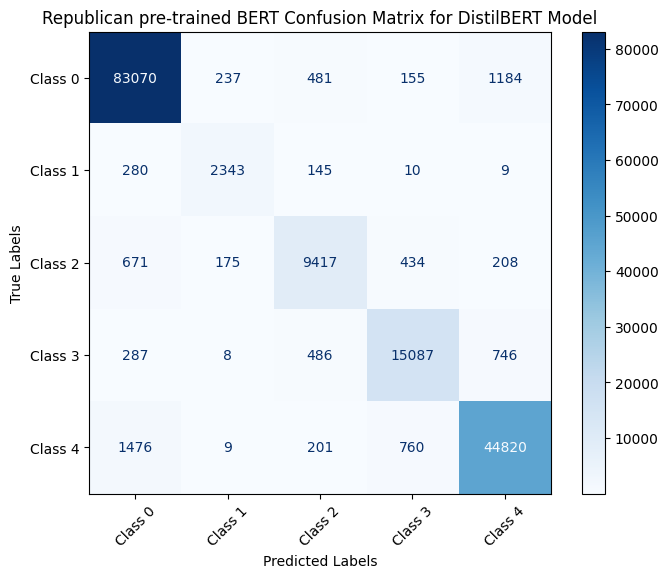

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for DistilBERT
cm = np.array([
 [ 83070,237,481,155,1184],
 [ 280,2343,145,10,9],
 [ 671,175,9417,434,208],
 [ 287,8,486,15087,746],
 [ 1476,9,201,760,44820]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('Republican pre-trained BERT Confusion Matrix for DistilBERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# 10000 Sample Test

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:591: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g.

Epoch 1/3 - Training loss: 0.7916128792623008
Training Accuracy: 0.7118888888888889
Training F1 Score: 0.6881012408640096
Training Recall: 0.7118888888888889
Training Precision: 0.688704995475322


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 1/3 - Validation loss: 0.5835063866679631
Validation Accuracy: 0.793
Validation F1 Score: 0.779792259443749
Validation Recall: 0.793
Validation Precision: 0.7884417343546104


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 2/3 - Training loss: 0.4017423805226547
Training Accuracy: 0.8614444444444445
Training F1 Score: 0.8566898691144411
Training Recall: 0.8614444444444445
Training Precision: 0.8564141813903464


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 2/3 - Validation loss: 0.5649575387674665
Validation Accuracy: 0.813
Validation F1 Score: 0.8084751147726379
Validation Recall: 0.813
Validation Precision: 0.8085473466845893


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 3/3 - Training loss: 0.22884161626096305
Training Accuracy: 0.9296666666666666
Training F1 Score: 0.9283491008690645
Training Recall: 0.9296666666666666
Training Precision: 0.928119718847685


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 3/3 - Validation loss: 0.6150515417730997
Validation Accuracy: 0.814
Validation F1 Score: 0.8089772161349459
Validation Recall: 0.814
Validation Precision: 0.8071074203126957


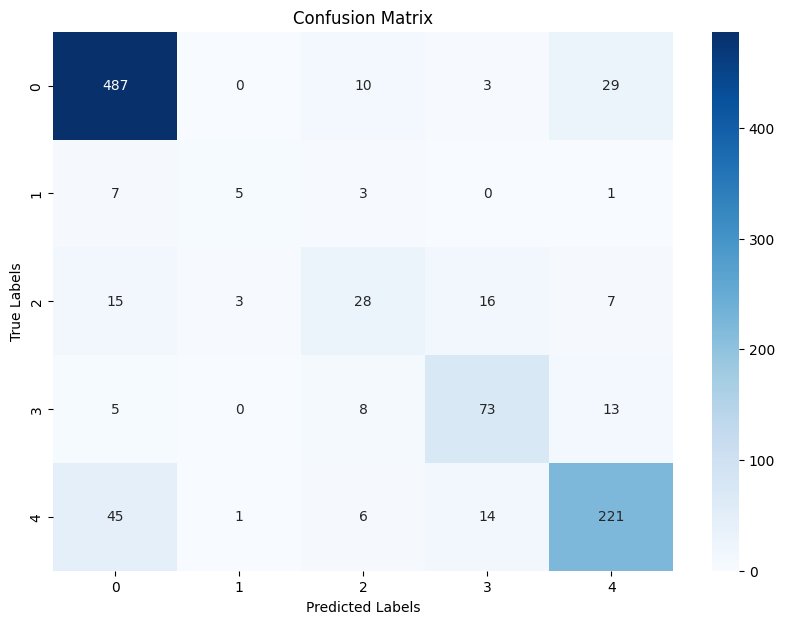

time: 4min 50s (started: 2024-07-18 15:25:01 +00:00)


In [ ]:
from torch.utils.data import Dataset, DataLoader
from transformers import BertTokenizer, BertForSequenceClassification, AdamW, get_linear_schedule_with_warmup
from torch.nn import CrossEntropyLoss
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
import torch
import json
import matplotlib.pyplot as plt
import seaborn as sns

# Define custom dataset class
class SentimentDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = str(self.texts[idx])
        label = self.labels[idx]
        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            pad_to_max_length=True,
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )
        return {
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Initialize BERT tokenizer and datasets
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
train_dataset = SentimentDataset(train_texts.values, train_labels.values, tokenizer, max_len=256)
val_dataset = SentimentDataset(val_texts.values, val_labels.values, tokenizer, max_len=256)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# Load a pre-trained BERT model for sequence classification
model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=5)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Define optimizer and loss function
optimizer = AdamW(model.parameters(), lr=2e-5)
loss_fn = CrossEntropyLoss().to(device)

# Set up learning rate scheduler
total_steps = len(train_loader) * 3  # Assuming 3 epochs
scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=0, num_training_steps=total_steps)

# Training loop
epochs = 3
metrics = []

for epoch in range(epochs):
    model.train()
    total_loss = 0
    all_train_labels = []
    all_train_preds = []

    for batch in train_loader:
        optimizer.zero_grad()

        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['label'].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        total_loss += loss.item()

        loss.backward()
        optimizer.step()
        scheduler.step()

        logits = outputs.logits
        preds = torch.argmax(logits, dim=1).flatten()
        all_train_labels.extend(labels.cpu().numpy())
        all_train_preds.extend(preds.cpu().numpy())

    avg_train_loss = total_loss / len(train_loader)
    train_accuracy = accuracy_score(all_train_labels, all_train_preds)
    train_f1 = f1_score(all_train_labels, all_train_preds, average='weighted')
    train_recall = recall_score(all_train_labels, all_train_preds, average='weighted')
    train_precision = precision_score(all_train_labels, all_train_preds, average='weighted')
    print(f"Epoch {epoch+1}/{epochs} - Training loss: {avg_train_loss}")
    print(f"Training Accuracy: {train_accuracy}")
    print(f"Training F1 Score: {train_f1}")
    print(f"Training Recall: {train_recall}")
    print(f"Training Precision: {train_precision}")

    # Validation
    model.eval()
    val_loss = 0
    all_val_labels = []
    all_val_preds = []

    with torch.no_grad():
        for batch in val_loader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['label'].to(device)

            outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
            loss = outputs.loss
            val_loss += loss.item()

            logits = outputs.logits
            preds = torch.argmax(logits, dim=1).flatten()

            all_val_labels.extend(labels.cpu().numpy())
            all_val_preds.extend(preds.cpu().numpy())

    avg_val_loss = val_loss / len(val_loader)
    val_accuracy = accuracy_score(all_val_labels, all_val_preds)
    val_f1 = f1_score(all_val_labels, all_val_preds, average='weighted')
    val_recall = recall_score(all_val_labels, all_val_preds, average='weighted')
    val_precision = precision_score(all_val_labels, all_val_preds, average='weighted')

    print(f"Epoch {epoch+1}/{epochs} - Validation loss: {avg_val_loss}")
    print(f"Validation Accuracy: {val_accuracy}")
    print(f"Validation F1 Score: {val_f1}")
    print(f"Validation Recall: {val_recall}")
    print(f"Validation Precision: {val_precision}")

    # Save the model and tokenizer after each epoch
    model_save_path = f'/content/drive/MyDrive/results/bert_sentiment_model_epoch_{epoch+1}'
    tokenizer.save_pretrained(model_save_path)
    model.save_pretrained(model_save_path)

    # Save the metrics for each epoch
    metrics.append({
        'epoch': epoch+1,
        'train_loss': avg_train_loss,
        'train_accuracy': train_accuracy,
        'train_f1': train_f1,
        'train_recall': train_recall,
        'train_precision': train_precision,
        'val_loss': avg_val_loss,
        'val_accuracy': val_accuracy,
        'val_f1': val_f1,
        'val_recall': val_recall,
        'val_precision': val_precision
    })

    # Clear memory except for the last epoch's labels and predictions
    if epoch < epochs - 1:
        del val_loss, avg_train_loss, avg_val_loss, train_accuracy, train_f1, train_recall, train_precision
        del val_accuracy, val_f1, val_recall, val_precision
        torch.cuda.empty_cache()

# Save the metrics for all epochs
with open('/content/drive/MyDrive/results/bert_sentiment_metrics.json', 'w') as f:
    json.dump(metrics, f)

# Calculate confusion matrix for the last epoch
cm = confusion_matrix(all_val_labels, all_val_preds)

# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')

# Save the figure
plt.savefig('Republican_bert_confusion_matrix.png')
plt.show()


# **2.3 VADER**

In [ ]:
# Read republican dataset

df_republican = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/US_Presidential_Election_2020_Dem_Rep /republican.csv')
df_republican.head(5)

,Unnamed: 0,text_clean,Vader_Sentiment
0,0,must intel comms kremlin putin know member hou...,Neutral
1,1,pre,Neutral
2,2,sad doj truth know filter government,Negative
3,3,every watch clip turn,Neutral
4,4,former congresspersons today republican party,Positive


In [ ]:
# Convert republican text into string
df_republican['text_clean']=df_republican['text_clean'].astype(str)

time: 64.3 ms (started: 2024-07-23 21:54:23 +00:00)


In [ ]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

# Initialize VADER
analyzer = SentimentIntensityAnalyzer()

# Function to calculate sentiment score using VADER
def vader_sentiment(text):
    scores = analyzer.polarity_scores(text)
    return scores['compound']

time: 11.3 ms (started: 2024-07-23 21:54:27 +00:00)


In [ ]:
# Apply VADER sentiment function
df_republican['vader_sentiment_score'] = df_republican['text_clean'].apply(vader_sentiment)

# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_R_VADER_updated.csv'
df_republican.to_csv(output_file_path, index=False)

NameError: name 'vader_sentiment' is not defined

In [ ]:
# Refine categorization based on VADER scores (Same as democratic)
def categorize_sentiment(score):
    if score >= 0.7:
        return 'Extremely Positive'  # 5
    elif score > 0.2:
        return 'Positive'  # 4
    elif -0.2 <= score <= 0.2:
        return 'Neutral'  # 3
    elif score >= -0.7:
        return 'Negative'  # 2
    else:
        return 'Extremely Negative'  # 1

time: 503 µs (started: 2024-07-23 21:58:29 +00:00)


In [ ]:
# Apply refined categorization to VADER scores
df_republican['vader_sentiment_category'] = df_republican['vader_sentiment_score'].apply(categorize_sentiment)

# Map categories to numerical labels for model training
label_dict = {'Extremely Negative': 0, 'Negative': 1, 'Neutral': 2, 'Positive': 3, 'Extremely Positive': 4}
df_republican['label'] = df_republican['vader_sentiment_category'].map(label_dict)

print(df_republican[['text_clean', 'vader_sentiment_score', 'vader_sentiment_category', 'label']].head())

# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_R_VADER_updated.csv'
df_republican.to_csv(output_file_path, index=False)

                                          text_clean  vader_sentiment_score  \
0  must intel comms kremlin putin know member hou...                 0.0000   
1                                                pre                 0.0000   
2               sad doj truth know filter government                -0.2023   
3                              every watch clip turn                 0.0000   
4      former congresspersons today republican party                 0.4019   

  vader_sentiment_category  label  
0                  Neutral      2  
1                  Neutral      2  
2                 Negative      1  
3                  Neutral      2  
4                 Positive      3  
time: 5.96 s (started: 2024-07-23 21:58:48 +00:00)


# **VADER NEW Data**

In [ ]:
# Read Brexit dataset
df_republican = pd.read_csv('/content/drive/MyDrive/US_R_VADER_updated.csv')
pd.set_option('display.max_columns',None)
df_republican.head(5)

,Unnamed: 0,text_clean,Vader_Sentiment,vader_sentiment_score,vader_sentiment_category,label
0,0,must intel comms kremlin putin know member hou...,Neutral,0.0000,Neutral,2
1,1,pre,Neutral,0.0000,Neutral,2
2,2,sad doj truth know filter government,Negative,-0.2023,Negative,1
3,3,every watch clip turn,Neutral,0.0000,Neutral,2
4,4,former congresspersons today republican party,Positive,0.4019,Positive,3


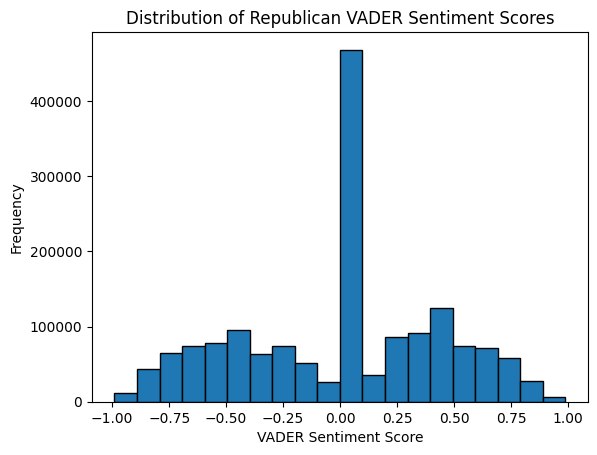

In [ ]:
# Inspect the distribution of VADER sentiment scores

plt.hist(df_republican['vader_sentiment_score'], bins=20, edgecolor='k')
plt.xlabel('VADER Sentiment Score')
plt.ylabel('Frequency')
plt.title('Distribution of Republican VADER Sentiment Scores')
plt.show()

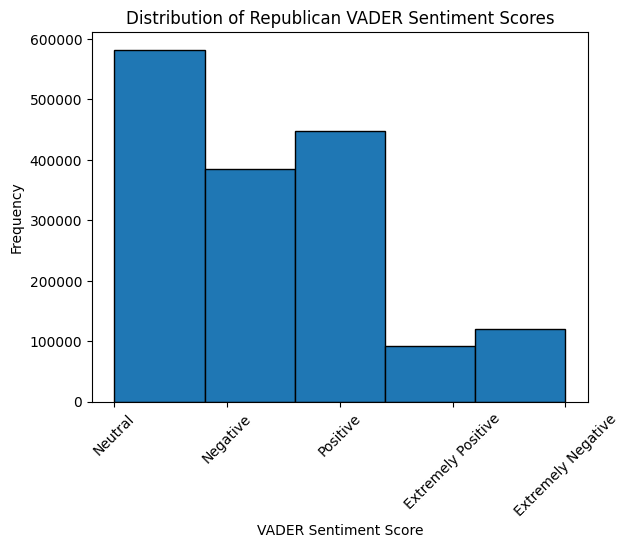

In [ ]:
# After applying self-define sentimentic categories the distribution of VADER sentiment scores

plt.hist(df_republican['vader_sentiment_category'], bins=5, edgecolor='k')
plt.xlabel('VADER Sentiment Score')
plt.xticks(rotation=45)
plt.ylabel('Frequency')
plt.title('Distribution of Republican VADER Sentiment Scores')
plt.show()

In [ ]:
df_republican['label'].value_counts()

label
2    582506
3    448240
1    384485
0    119820
4     91939
Name: count, dtype: int64

time: 24.2 ms (started: 2024-07-24 09:58:25 +00:00)


In [ ]:
from nltk.tokenize import word_tokenize

# Ensure 'text_clean' column contains strings
df_republican['text_clean'] = df_republican['text_clean'].astype(str)

# Tokenize the text
df_republican['tokens'] = df_republican['text_clean'].apply(word_tokenize)

# Calculate token counts
df_republican['vader_token_counts'] = df_republican['tokens'].apply(len)

time: 2min 14s (started: 2024-07-23 22:21:02 +00:00)


In [ ]:
# Display the DataFrame with token counts
df_republican.head()
# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_D_VADER_updated.csv'
df_republican.to_csv(output_file_path, index=False)

time: 12.6 s (started: 2024-07-23 22:11:25 +00:00)


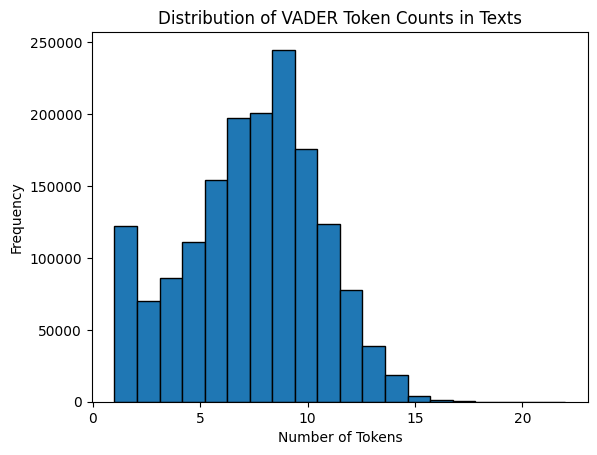

count    1.626990e+06
mean     7.565540e+00
std      3.049440e+00
min      1.000000e+00
25%      6.000000e+00
50%      8.000000e+00
75%      1.000000e+01
max      2.200000e+01
Name: vader_token_counts, dtype: float64


<Figure size 640x480 with 0 Axes>

time: 278 ms (started: 2024-07-23 22:12:40 +00:00)


In [ ]:
import matplotlib.pyplot as plt

plt.hist(df_republican['vader_token_counts'], bins=20, edgecolor='k')
plt.xlabel('Number of Tokens')
plt.ylabel('Frequency')
plt.title('Distribution of VADER Token Counts in Texts')
plt.show()
plt.savefig('Republican_token_count_VADER_distribution.png')

# Print basic statistics
print(df_republican['vader_token_counts'].describe())


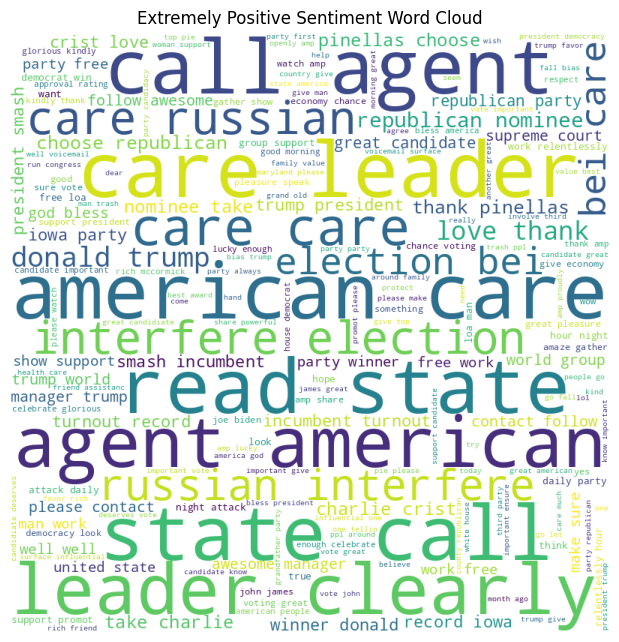

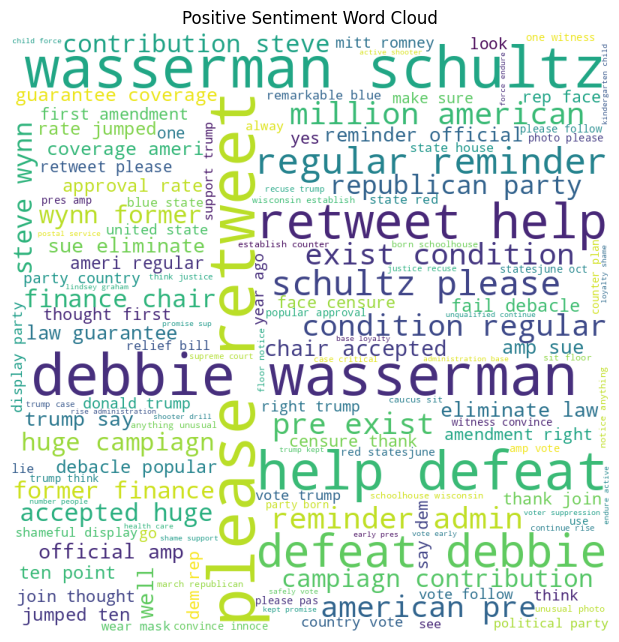

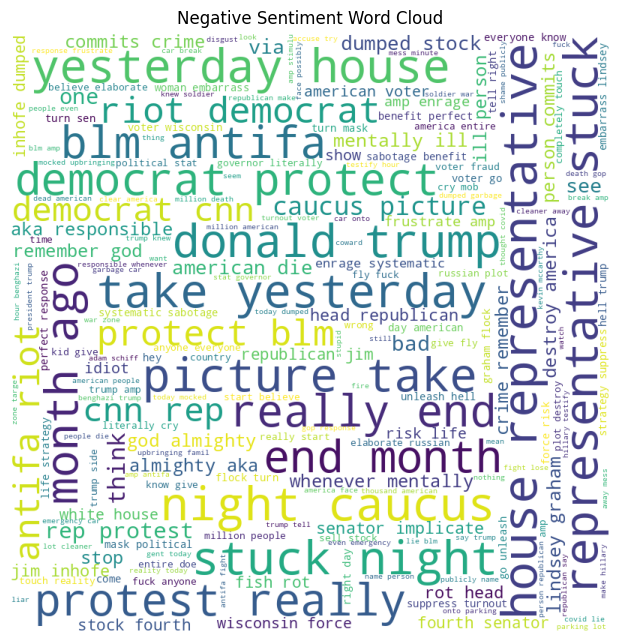

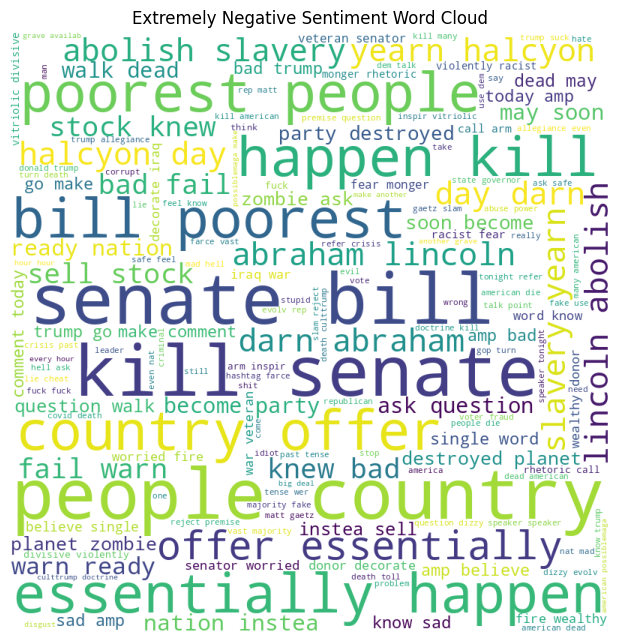

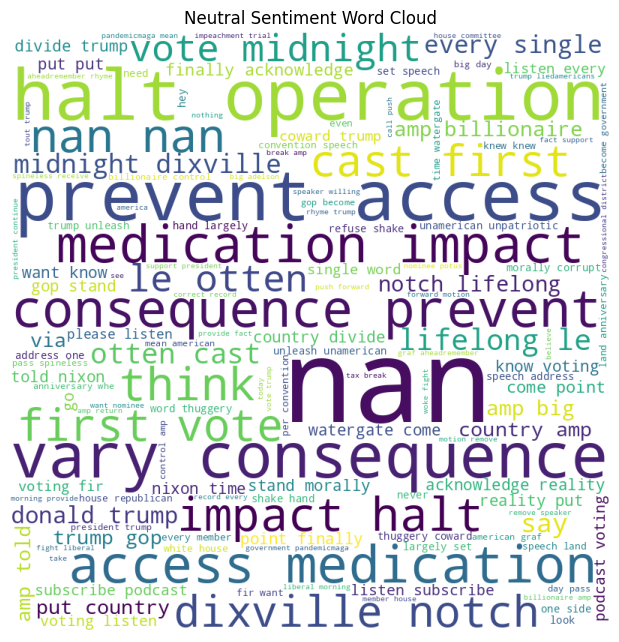

time: 54.6 s (started: 2024-07-23 22:17:27 +00:00)


In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

# Filter the DataFrame for each sentiment label
extremely_positive_df = df_republican[df_republican['vader_sentiment_category'] == 'Extremely Positive']
positive_df = df_republican[df_republican['vader_sentiment_category'] == 'Positive']
negative_df = df_republican[df_republican['vader_sentiment_category'] == 'Negative']
extremely_negative_df = df_republican[df_republican['vader_sentiment_category'] == 'Extremely Negative']
neutral_df = df_republican[df_republican['vader_sentiment_category'] == 'Neutral']

# Combine text for each sentiment
extremely_positive_text = " ".join(extremely_positive_df['text_clean'])
positive_text = " ".join(positive_df['text_clean'])
negative_text = " ".join(negative_df['text_clean'])
extremely_negative_text = " ".join(extremely_negative_df['text_clean'])
neutral_text = " ".join(str(text) for text in neutral_df['text_clean'])

# Create WordCloud objects
stopwords = set(STOPWORDS)
wordcloud_ep = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_positive_text)
wordcloud_p = WordCloud(width = 800, height = 800,
                        background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(positive_text)
wordcloud_n = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(negative_text)
wordcloud_en = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_negative_text)

wordcloud_ne = WordCloud(width = 800, height = 800,
                background_color = 'white',
                stopwords = stopwords,
                min_font_size = 10).generate(neutral_text)

# Plot the WordClouds
plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ep)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_p)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_n)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_en)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ne)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Neutral Sentiment Word Cloud")
plt.show()

# 2.4 (NEW) BERT Model via VADER

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:591: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g.

Epoch 1/3 - Training loss: 0.09786781059838941
Training Accuracy: 0.9637144358600852
Training F1 Score: 0.9636932736999285
Training Recall: 0.9637144358600852
Training Precision: 0.9636880223372937


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 1/3 - Validation loss: 0.04190519951883272
Validation Accuracy: 0.984729469757036
Validation F1 Score: 0.9847722445549892
Validation Recall: 0.984729469757036
Validation Precision: 0.9849608084104398


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 2/3 - Training loss: 0.028756263541729776
Training Accuracy: 0.9895527938094272
Training F1 Score: 0.9895524335278691
Training Recall: 0.9895527938094272
Training Precision: 0.9895521389653209


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 2/3 - Validation loss: 0.02086733810311925
Validation Accuracy: 0.992768855370961
Validation F1 Score: 0.9927706025986975
Validation Recall: 0.992768855370961
Validation Precision: 0.9927744574223752


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 3/3 - Training loss: 0.010813732954144242
Training Accuracy: 0.9962130990356425
Training F1 Score: 0.9962130335752748
Training Recall: 0.9962130990356425
Training Precision: 0.9962129901361425


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2760: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 3/3 - Validation loss: 0.017830877387743298
Validation Accuracy: 0.994477532129884
Validation F1 Score: 0.9944796816351202
Validation Recall: 0.994477532129884
Validation Precision: 0.9944875096688195


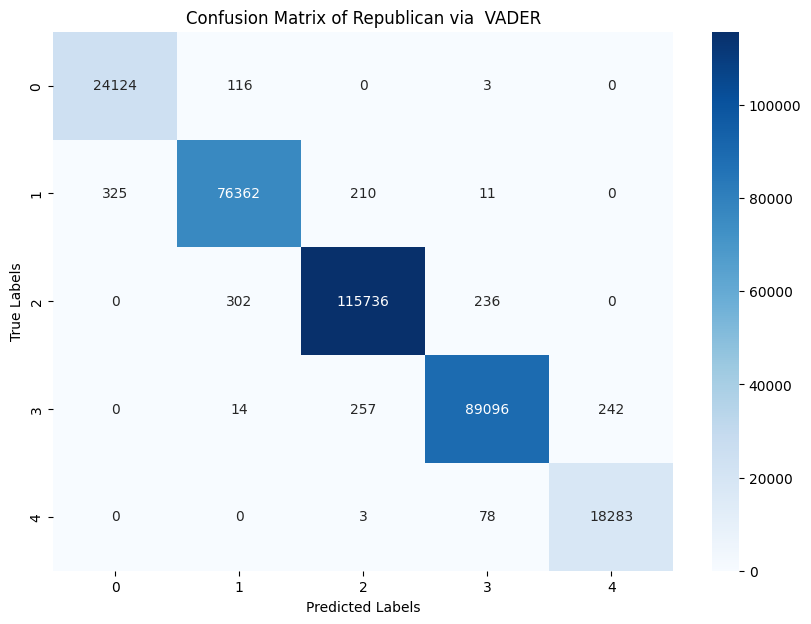

time: 11h 52min 4s (started: 2024-07-24 10:10:14 +00:00)


In [ ]:
from torch.utils.data import Dataset, DataLoader
from transformers import BertTokenizer, BertForSequenceClassification, AdamW, get_linear_schedule_with_warmup
from torch.nn import CrossEntropyLoss
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
import torch
import json
import matplotlib.pyplot as plt
import seaborn as sns

# Define custom dataset class
class SentimentDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = str(self.texts[idx])
        label = self.labels[idx]
        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            pad_to_max_length=True,
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )
        return {
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Initialize BERT tokenizer and datasets
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
train_dataset = SentimentDataset(train_texts.values, train_labels.values, tokenizer, max_len=256)
val_dataset = SentimentDataset(val_texts.values, val_labels.values, tokenizer, max_len=256)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# Load a pre-trained BERT model for sequence classification
model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=5)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Define optimizer and loss function
optimizer = AdamW(model.parameters(), lr=2e-5)
loss_fn = CrossEntropyLoss().to(device)

# Set up learning rate scheduler
total_steps = len(train_loader) * 3  # Assuming 3 epochs
scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=0, num_training_steps=total_steps)

# Training loop
epochs = 3
metrics = []

for epoch in range(epochs):
    model.train()
    total_loss = 0
    all_train_labels = []
    all_train_preds = []

    for batch in train_loader:
        optimizer.zero_grad()

        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['label'].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        total_loss += loss.item()

        loss.backward()
        optimizer.step()
        scheduler.step()

        logits = outputs.logits
        preds = torch.argmax(logits, dim=1).flatten()
        all_train_labels.extend(labels.cpu().numpy())
        all_train_preds.extend(preds.cpu().numpy())

    avg_train_loss = total_loss / len(train_loader)
    train_accuracy = accuracy_score(all_train_labels, all_train_preds)
    train_f1 = f1_score(all_train_labels, all_train_preds, average='weighted')
    train_recall = recall_score(all_train_labels, all_train_preds, average='weighted')
    train_precision = precision_score(all_train_labels, all_train_preds, average='weighted')
    print(f"Epoch {epoch+1}/{epochs} - Training loss: {avg_train_loss}")
    print(f"Training Accuracy: {train_accuracy}")
    print(f"Training F1 Score: {train_f1}")
    print(f"Training Recall: {train_recall}")
    print(f"Training Precision: {train_precision}")

    # Validation
    model.eval()
    val_loss = 0
    all_val_labels = []
    all_val_preds = []

    with torch.no_grad():
        for batch in val_loader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['label'].to(device)

            outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
            loss = outputs.loss
            val_loss += loss.item()

            logits = outputs.logits
            preds = torch.argmax(logits, dim=1).flatten()

            all_val_labels.extend(labels.cpu().numpy())
            all_val_preds.extend(preds.cpu().numpy())

    avg_val_loss = val_loss / len(val_loader)
    val_accuracy = accuracy_score(all_val_labels, all_val_preds)
    val_f1 = f1_score(all_val_labels, all_val_preds, average='weighted')
    val_recall = recall_score(all_val_labels, all_val_preds, average='weighted')
    val_precision = precision_score(all_val_labels, all_val_preds, average='weighted')

    print(f"Epoch {epoch+1}/{epochs} - Validation loss: {avg_val_loss}")
    print(f"Validation Accuracy: {val_accuracy}")
    print(f"Validation F1 Score: {val_f1}")
    print(f"Validation Recall: {val_recall}")
    print(f"Validation Precision: {val_precision}")

    # Save the model and tokenizer after each epoch
    model_save_path = f'/content/drive/MyDrive/results/Republican_VADER_BERT_sentiment_model_epoch_{epoch+1}'
    tokenizer.save_pretrained(model_save_path)
    model.save_pretrained(model_save_path)

    # Save the metrics for each epoch
    metrics.append({
        'epoch': epoch+1,
        'train_loss': avg_train_loss,
        'train_accuracy': train_accuracy,
        'train_f1': train_f1,
        'train_recall': train_recall,
        'train_precision': train_precision,
        'val_loss': avg_val_loss,
        'val_accuracy': val_accuracy,
        'val_f1': val_f1,
        'val_recall': val_recall,
        'val_precision': val_precision
    })

    # Clear memory except for the last epoch's labels and predictions
    if epoch < epochs - 1:
        del val_loss, avg_train_loss, avg_val_loss, train_accuracy, train_f1, train_recall, train_precision
        del val_accuracy, val_f1, val_recall, val_precision
        torch.cuda.empty_cache()

# Save the metrics for all epochs
with open('/content/drive/MyDrive/results/Republican_VADER_BERT_sentiment_metrics.json', 'w') as f:
    json.dump(metrics, f)

# Calculate confusion matrix for the last epoch
cm = confusion_matrix(all_val_labels, all_val_preds)

# Plot confusion matrix
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix of Republican via  VADER')

# Save the figure
plt.savefig('/content/drive/MyDrive/Republican_VADER_confusion_matrix.png')
plt.show()

In [ ]:
print("BERT Confusion Matrix:")
print(cm)

BERT Confusion Matrix:
[[ 24124    116      0      3      0]
 [   325  76362    210     11      0]
 [     0    302 115736    236      0]
 [     0     14    257  89096    242]
 [     0      0      3     78  18283]]
time: 849 µs (started: 2024-07-24 22:19:40 +00:00)


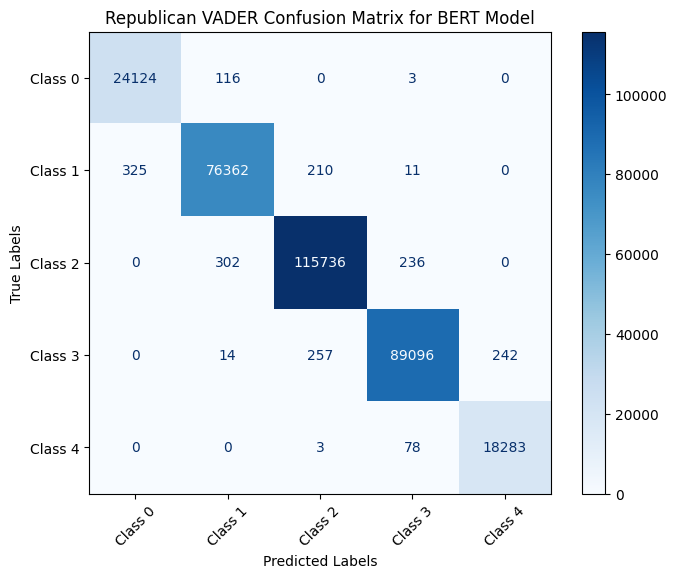

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 24124,116,0,3,0],
 [ 325,76362,210,11,0],
 [ 0,302,115736,236,0],
 [ 0,14,257,89096,242],
 [ 0,0,3,78,18283]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('Republican VADER Confusion Matrix for BERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# 2.5 DistilBERT Model Can Use Old Version

# (OLD)Split the Republican data into training and test sets

In [ ]:
# Split data into training and test sets
train_texts, val_texts, train_labels, val_labels = train_test_split(
    df_republican['text_clean'], df_republican['label'], test_size=0.2, random_state=42)

time: 324 ms (started: 2024-07-24 09:55:06 +00:00)


In [ ]:
# Initialize BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

# Define a custom dataset class for BERT
class SentimentDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]
        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            pad_to_max_length=True,
            return_attention_mask=True,
            return_tensors='pt',
        )
        return {
            'text': text,
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Create datasets and dataloaders
train_dataset = SentimentDataset(train_texts.values, train_labels.values, tokenizer, max_len=128)
val_dataset = SentimentDataset(val_texts.values, val_labels.values, tokenizer, max_len=128)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

time: 4.51 s (started: 2024-07-24 09:55:49 +00:00)


# 2.3 (OLD)VADER via BERT Model

In [ ]:
# Load a pre-trained BERT model for sequence classification
model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=len(label_dict))

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

NameError: name 'label' is not defined

time: 28 ms (started: 2024-07-24 09:58:46 +00:00)


# Set Training Loop

In [ ]:
# Define optimizer and loss function
optimizer = AdamW(model.parameters(), lr=2e-5)
loss_fn = CrossEntropyLoss()

# Training loop
epochs = 3
for epoch in range(epochs):
    model.train()
    total_loss = 0
    correct_predictions = 0
    total_predictions = 0

    for batch in train_loader:
        optimizer.zero_grad()

        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['label'].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        logits = outputs.logits

        _, preds = torch.max(logits, dim=1)
        correct_predictions += torch.sum(preds == labels)
        total_predictions += labels.size(0)

        total_loss += loss.item()
        loss.backward()
        optimizer.step()

    avg_train_loss = total_loss / len(train_loader)
    train_accuracy = correct_predictions.double() / total_predictions

    print(f"Epoch {epoch+1}/{epochs}")
    print(f"Train loss: {avg_train_loss}, Train accuracy: {train_accuracy}")

Truncation was not explicitly activated but `max_length` is provided a specific value, please use `truncation=True` to explicitly truncate examples to max length. Defaulting to 'longest_first' truncation strategy. If you encode pairs of sequences (GLUE-style) with the tokenizer you can select this strategy more precisely by providing a specific strategy to `truncation`.
/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2699: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 1/3
Train loss: 0.10236716906030538, Train accuracy: 0.962393745505504
Epoch 2/3
Train loss: 0.040477914603639524, Train accuracy: 0.9857036613623932
Epoch 3/3
Train loss: 0.028350669746010797, Train accuracy: 0.990238876698689


In [ ]:
# Evaluate on validation set
model.eval()
val_loss = 0
val_correct_predictions = 0
val_total_predictions = 0

with torch.no_grad():
    for batch in val_loader:
        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['label'].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        logits = outputs.logits

        _, preds = torch.max(logits, dim=1)
        val_correct_predictions += torch.sum(preds == labels)
        val_total_predictions += labels.size(0)

        val_loss += loss.item()

avg_val_loss = val_loss / len(val_loader)
al_accuracy = val_correct_predictions.double() / val_total_predictions

# Calculate additional metrics
accuracy = accuracy_score(all_labels, all_preds)
f1 = f1_score(all_labels, all_preds, average='weighted')
recall = recall_score(all_labels, all_preds, average='weighted')
precision = precision_score(all_labels, all_preds, average='weighted')

print(f"Validation loss: {avg_val_loss}")
print(f"Validation accuracy: {val_accuracy}")
print(f"Accuracy: {accuracy}"
print(f"F1 Score: {f1}")
print(f"Recall: {recall})
print(f"Precision: {precision}")


Validation loss: 0.02867564307141915, Validation accuracy: 0.9840968091412686
Accuracy: 0.9840968091412686, F1 Score: 0.984098988396424, Recall: 0.9840968091412686, Precision: 0.984158434347632


# 2.4 (OLD)VADER via DistilBERT Model

In [ ]:
import torch
from transformers import DistilBertTokenizer, DistilBertForSequenceClassification, Trainer, TrainingArguments
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
from torch.utils.data import DataLoader, Dataset

# Define a custom Dataset class
class TextDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]

        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            padding='max_length',
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )

        return {
            'text': text,
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }


In [ ]:
# Prepare the data for DistilBERT
def prepare_data(df, tokenizer, max_len, batch_size):
    le = LabelEncoder()
    df['label'] = le.fit_transform(df['vader_sentiment_category'])

    train_texts, val_texts, train_labels, val_labels = train_test_split(
        df['text_clean'].values,
        df['label'].values,
        test_size=0.1,
        random_state=42
    )

    train_dataset = TextDataset(
        texts=train_texts,
        labels=train_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    val_dataset = TextDataset(
        texts=val_texts,
        labels=val_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size)

    return train_loader, val_loader, val_labels, le

# Define evaluation metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    acc = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    recall = recall_score(labels, preds, average='weighted')
    precision = precision_score(labels, preds, average='weighted')
    return {
        'accuracy': acc,
        'f1': f1,
        'recall': recall,
        'precision': precision
    }


In [ ]:
# Set parameters
MAX_LEN = 128
BATCH_SIZE = 16

# Prepare data for DistilBERT
distilbert_tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
train_loader, val_loader, val_labels, label_encoder = prepare_data(df_republican, distilbert_tokenizer, MAX_LEN, BATCH_SIZE)

# Initialize DistilBERT model
distilbert_model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=5)

# Train DistilBERT model
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    evaluation_strategy="epoch",
    save_total_limit = 1 # limit the number of saved checkpoints to 1
)

trainer = Trainer(
    model=distilbert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

# Print DistilBERT evaluation results
for key, value in results.items():
    print(f"{key}: {value}")



/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


config.json:   0%|          | 0.00/483 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.004700,0.084230,0.979963,0.979971,0.979963,0.980097
2,0.067900,0.040314,0.990424,0.990419,0.990424,0.990428


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.004700,0.084230,0.979963,0.979971,0.979963,0.980097
2,0.067900,0.040314,0.990424,0.990419,0.990424,0.990428
3,0.021800,0.032387,0.993841,0.993842,0.993841,0.993846


eval_loss: 0.03238745033740997
eval_accuracy: 0.9938413880847454
eval_f1: 0.9938421952036534
eval_recall: 0.9938413880847454
eval_precision: 0.9938461330496609
eval_runtime: 209.5755
eval_samples_per_second: 776.326
eval_steps_per_second: 48.522
epoch: 3.0


In [ ]:
# Print additional metrics
val_accuracy = results['eval_accuracy']
print(f"Validation loss: {results['eval_loss']}")
print(f"Validation accuracy: {val_accuracy}")

# Confusion Matrix for DistilBERT
preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
cm_distilbert = confusion_matrix(val_labels, preds)

# Compute additional metrics
accuracy = accuracy_score(val_labels, preds)
f1 = f1_score(val_labels, preds, average='weighted')
recall = recall_score(val_labels, preds, average='weighted')
precision = precision_score(val_labels, preds, average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1}")
print(f"Recall: {recall}")
print(f"Precision: {precision}")

# Print confusion matrix
print("Confusion Matrix for DistilBERT:")
print(cm_distilbert)


Validation loss: 0.03238745033740997
Validation accuracy: 0.9938413880847454


Accuracy: 0.9938413880847454
F1 Score: 0.9938421952036534
Recall: 0.9938413880847454
Precision: 0.9938461330496609
Confusion Matrix for DistilBERT:
[[12095     0    81     1     2]
 [    0  9147     0     3    63]
 [  170     0 37995   166    12]
 [    1     2   142 57922   123]
 [    0    87    17   132 44538]]


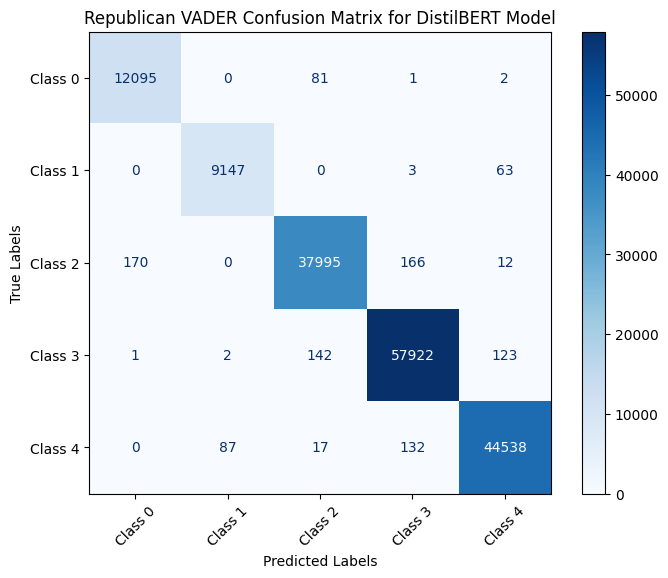

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 12095,0,81,1,2],
 [ 0,9147,0,3,63],
 [ 170,0,37995,166,12],
 [ 1,2,142,57922,123],
 [ 0,87,17,132,44538]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('Republican VADER Confusion Matrix for DistilBERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# 2.6 TextBlob

In [ ]:
from textblob import TextBlob
import pandas as pd

# Convert republican text into string
df_republican['text_clean']=df_republican['text_clean'].astype(str)

# Function to get sentiment score using TextBlob
def get_textblob_sentiment(text):
    return TextBlob(text).sentiment.polarity

# Function to categorize the sentiment score
def categorize_sentiment(score):
    if score >= 0.7:
        return 'Extremely Positive'
    elif score > 0.2:
        return 'Positive'
    elif -0.2 <= score <= 0.2:
        return 'Neutral'
    elif score >= -0.7:
        return 'Negative'
    else:
        return 'Extremely Negative'

# Apply TextBlob sentiment analysis
df_republican['textblob_sentiment_score'] = df_republican['text_clean'].astype(str).apply(get_textblob_sentiment)
df_republican['textblob_sentiment_category'] = df_republican['textblob_sentiment_score'].apply(categorize_sentiment)

# Print the results
print(df_republican[['text_clean','textblob_sentiment_score','textblob_sentiment_category']].head())

                                          text_clean  \
0  must intel comms kremlin putin know member hou...   
1                                                pre   
2               sad doj truth know filter government   
3                              every watch clip turn   
4      former congresspersons today republican party   

   textblob_sentiment_score textblob_sentiment_category  
0                       0.0                     Neutral  
1                       0.0                     Neutral  
2                      -0.5                    Negative  
3                       0.0                     Neutral  
4                       0.0                     Neutral  


In [ ]:
# Map categories to numerical labels for model training
label_dict = {'Extremely Negative': 0, 'Negative': 1, 'Neutral': 2, 'Positive': 3, 'Extremely Positive': 4}
df_republican['label'] = df_republican['textblob_sentiment_category'].map(label_dict)

print(df_republican[['text_clean','textblob_sentiment_score','textblob_sentiment_category','label']].head())

                                          text_clean  \
0  must intel comms kremlin putin know member hou...   
1                                                pre   
2               sad doj truth know filter government   
3                              every watch clip turn   
4      former congresspersons today republican party   

   textblob_sentiment_score textblob_sentiment_category  label  
0                       0.0                     Neutral      2  
1                       0.0                     Neutral      2  
2                      -0.5                    Negative      1  
3                       0.0                     Neutral      2  
4                       0.0                     Neutral      2  


In [ ]:
# Read Brexit dataset
df_republican = pd.read_csv('/content/drive/MyDrive/US_R_TextBlob_updated.csv')
pd.set_option('display.max_columns',None)
df_republican.head(5)

,Unnamed: 0.1,Unnamed: 0,text_clean,Vader_Sentiment,textblob_sentiment_score,textblob_sentiment_category,label
0,0,0,must intel comms kremlin putin know member hou...,Neutral,0.0,Neutral,3
1,1,1,pre,Neutral,0.0,Neutral,3
2,2,2,sad doj truth know filter government,Negative,-0.5,Negative,2
3,3,3,every watch clip turn,Neutral,0.0,Neutral,3
4,4,4,former congresspersons today republican party,Positive,0.0,Neutral,3


In [ ]:
# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_D_VADER_updated.csv'
df_republican.to_csv(output_file_path, index=False)

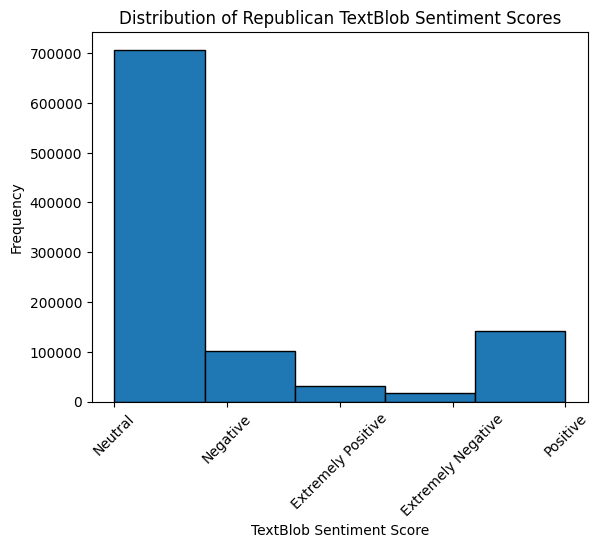

In [ ]:
# Get the sentiment scores
sentiment_scores = df_republican['textblob_sentiment_category']

# Plot the histogram
plt.hist(sentiment_scores, bins=5, edgecolor='k')
plt.xlabel('TextBlob Sentiment Score')
plt.xticks(rotation=45)
plt.ylabel('Frequency')
plt.title('Distribution of Republican TextBlob Sentiment Scores')
plt.show()


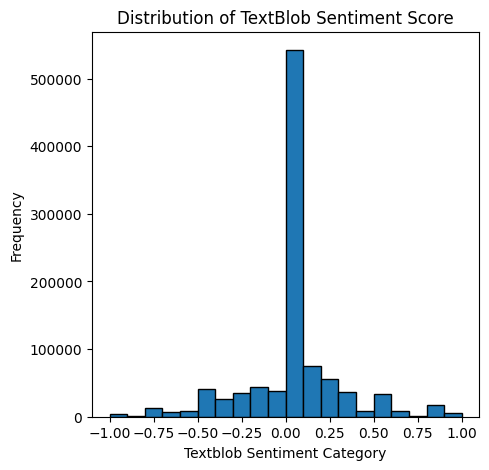

In [ ]:
# Plot the distribution of Textblob sentiment categories
plt.figure(figsize=(5,5))
plt.hist(df_republican['textblob_sentiment_score'], bins=20, edgecolor='k')
plt.xlabel('Textblob Sentiment Category')
plt.ylabel('Frequency')
plt.title('Distribution of TextBlob Sentiment Score')
plt.show()

In [ ]:
# Tokenize 'text_clean' using TextBlob and count tokens
df_republican['textblob_tokenized_text'] = df_republican['text_clean'].apply(lambda x: TextBlob(str(x)).words)
df_republican['textblob_token_counts'] = df_republican['textblob_tokenized_text'].apply(len)
df_republican.head(5)

,Unnamed: 0.1,Unnamed: 0,text_clean,Vader_Sentiment,textblob_sentiment_score,textblob_sentiment_category,label,textblob_tokenized_text,textblob_token_counts
0,0,0,must intel comms kremlin putin know member hou...,Neutral,0.0,Neutral,3,"[must, intel, comms, kremlin, putin, know, mem...",9
1,1,1,pre,Neutral,0.0,Neutral,3,[pre],1
2,2,2,sad doj truth know filter government,Negative,-0.5,Negative,2,"[sad, doj, truth, know, filter, government]",6
3,3,3,every watch clip turn,Neutral,0.0,Neutral,3,"[every, watch, clip, turn]",4
4,4,4,former congresspersons today republican party,Positive,0.0,Neutral,3,"[former, congresspersons, today, republican, p...",5


In [ ]:
# Display the results
print(df_republican[['textblob_token_counts', 'textblob_tokenized_text']].head())

# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/US_R_TextBlob_updated.csv'
df_republican.to_csv(output_file_path, index=False)

   textblob_token_counts                            textblob_tokenized_text
0                      9  [must, intel, comms, kremlin, putin, know, mem...
1                      1                                              [pre]
2                      6        [sad, doj, truth, know, filter, government]
3                      4                         [every, watch, clip, turn]
4                      5  [former, congresspersons, today, republican, p...


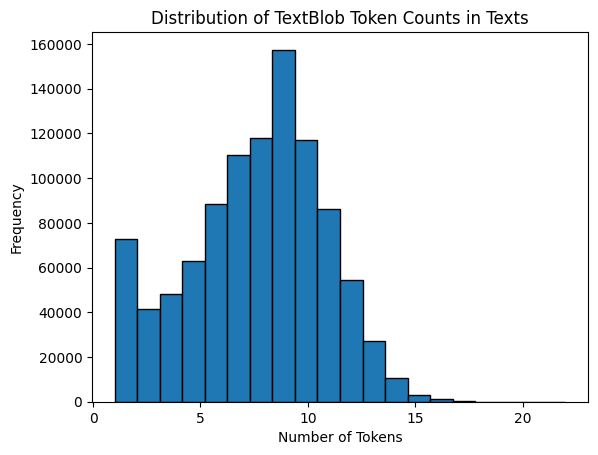

count    999999.000000
mean          7.743261
std           3.083687
min           1.000000
25%           6.000000
50%           8.000000
75%          10.000000
max          22.000000
Name: textblob_token_counts, dtype: float64


<Figure size 640x480 with 0 Axes>

In [ ]:
# Plot the distribution of token counts
import matplotlib.pyplot as plt

plt.hist(df_republican['textblob_token_counts'], bins=20, edgecolor='k')
plt.xlabel('Number of Tokens')
plt.ylabel('Frequency')
plt.title('Distribution of TextBlob Token Counts in Texts')
plt.show()
plt.savefig('/content/drive/MyDrive/Republican_token_count_TextBlob_distribution.png')

# Print basic statistics
print(df_republican['textblob_token_counts'].describe())

# WordCloud

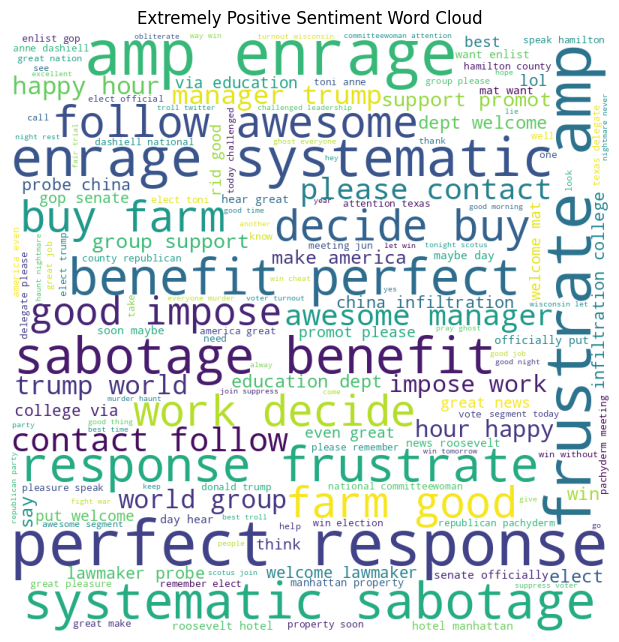

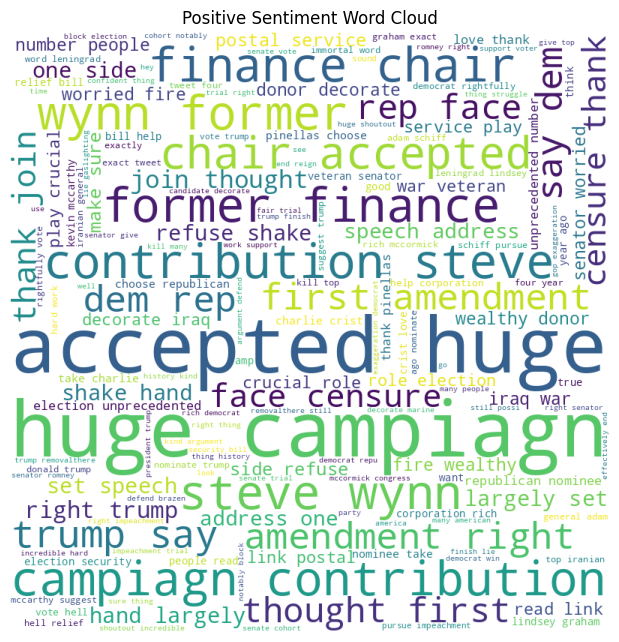

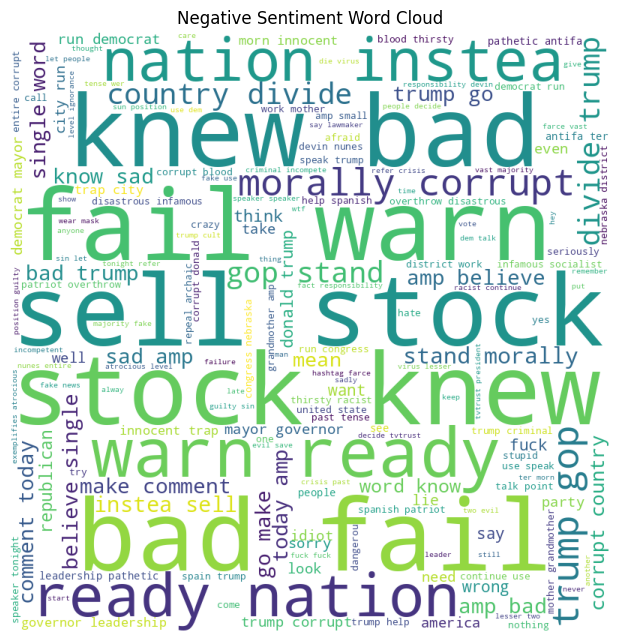

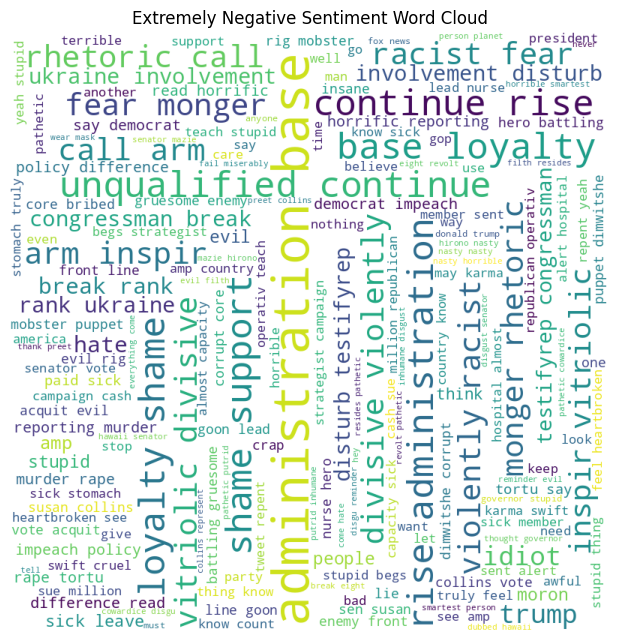

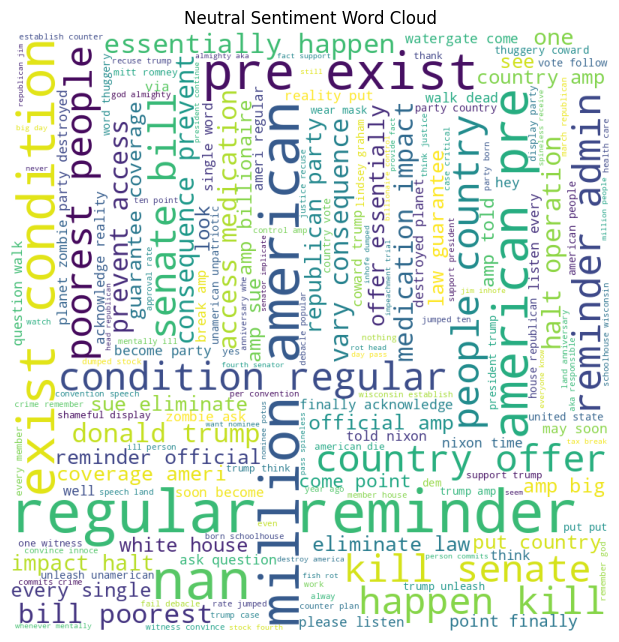

In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

# Filter the DataFrame for each sentiment label
extremely_positive_df = df_republican[df_republican['textblob_sentiment_category'] == 'Extremely Positive']
positive_df = df_republican[df_republican['textblob_sentiment_category'] == 'Positive']
negative_df = df_republican[df_republican['textblob_sentiment_category'] == 'Negative']
extremely_negative_df = df_republican[df_republican['textblob_sentiment_category'] == 'Extremely Negative']
neutral_df = df_republican[df_republican['textblob_sentiment_category'] == 'Neutral']

# Combine text for each sentiment
extremely_positive_text = " ".join(extremely_positive_df['text_clean'])
positive_text = " ".join(str(text) for text in positive_df['text_clean'])
negative_text = " ".join(str(text) for text in negative_df['text_clean'])
extremely_negative_text = " ".join(str(text) for text in extremely_negative_df['text_clean'])
neutral_text = " ".join(str(text) for text in neutral_df['text_clean'])

# Create WordCloud objects
stopwords = set(STOPWORDS)
wordcloud_ep = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_positive_text)
wordcloud_p = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(positive_text)
wordcloud_n = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(negative_text)
wordcloud_en = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_negative_text)

wordcloud_ne = WordCloud(width = 800, height = 800,
                background_color = 'white',
                stopwords = stopwords,
                min_font_size = 10).generate(neutral_text)

# Plot the WordClouds
plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ep)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_p)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_n)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_en)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ne)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Neutral Sentiment Word Cloud")
plt.show()


# 2.7 BERT Model via TextBlob

In [ ]:
import torch
from transformers import BertTokenizer, BertForSequenceClassification, Trainer, TrainingArguments
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
from torch.utils.data import DataLoader, Dataset

# Define a custom Dataset class
class TextDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]

        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            padding='max_length',
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )

        return {
            'text': text,
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }


In [ ]:
# Prepare the data for BERT
def prepare_data(df, tokenizer, max_len, batch_size):
    le = LabelEncoder()
    df['label'] = le.fit_transform(df['textblob_sentiment_category'])

    train_texts, val_texts, train_labels, val_labels = train_test_split(
        df['text_clean'].values,
        df['label'].values,
        test_size=0.1,
        random_state=42
    )

    train_dataset = TextDataset(
        texts=train_texts,
        labels=train_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    val_dataset = TextDataset(
        texts=val_texts,
        labels=val_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size)

    return train_loader, val_loader, val_labels, le

# Define evaluation metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    acc = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    recall = recall_score(labels, preds, average='weighted')
    precision = precision_score(labels, preds, average='weighted')
    return {
        'accuracy': acc,
        'f1': f1,
        'recall': recall,
        'precision': precision
    }

In [ ]:
# Set parameters
MAX_LEN = 128
BATCH_SIZE = 16

# Prepare data for BERT
bert_tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
train_loader, val_loader, val_labels, label_encoder = prepare_data(df_republican, bert_tokenizer, MAX_LEN, BATCH_SIZE)

# Initialize BERT model
bert_model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=5)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
# Train BERT model
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    evaluation_strategy="epoch",
    save_steps=500, # every 500 checkpoins are saved
    save_total_limit = 1 #  only the most recent checkpoint is kept
)

trainer = Trainer(
    model=bert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

# Print BERT evaluation results
val_accuracy = results['eval_accuracy']
print(f"Validation loss: {results['eval_loss']}")
print(f"Validation accuracy: {val_accuracy}")

# Confusion Matrix for BERT
preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
cm_bert = confusion_matrix(val_labels, preds)

# Compute additional metrics
accuracy = accuracy_score(val_labels, preds)
f1 = f1_score(val_labels, preds, average='weighted')
recall = recall_score(val_labels, preds, average='weighted')
precision = precision_score(val_labels, preds, average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1}")
print(f"Recall: {recall}")
print(f"Precision: {precision}")

# Print confusion matrix
print("Confusion Matrix for BERT:")
print(cm_bert)


/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.002400,0.037807,0.992268,0.992258,0.992268,0.992263
2,0.000700,0.021670,0.996085,0.996085,0.996085,0.996085


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.002400,0.037807,0.992268,0.992258,0.992268,0.992263
2,0.000700,0.021670,0.996085,0.996085,0.996085,0.996085
3,0.000100,0.013346,0.997658,0.997658,0.997658,0.997658


Validation loss: 0.01334583479911089
Validation accuracy: 0.9976582523555768
Accuracy: 0.9976582523555768
F1 Score: 0.9976582896134608
Recall: 0.9976582523555768
Precision: 0.9976584454699443
Confusion Matrix for BERT:
[[  2537     13      4      0      0]
 [     8  15544     73      3      0]
 [     1     67 115721     96      0]
 [     0      1     79  23136     17]
 [     0      1      3     15   5380]]


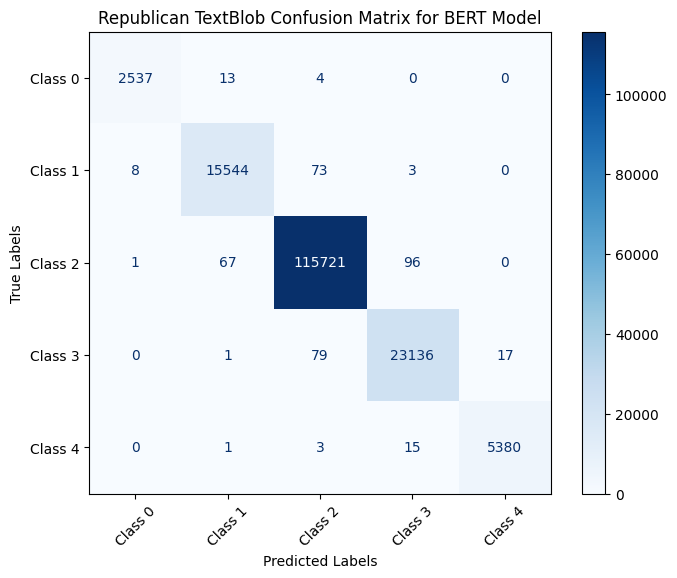

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 2537,13,4,0,0],
 [ 8,15544,73,3,0],
 [ 1,67,115721,96,0],
 [ 0,1,79,23136,17],
 [ 0,1,3,15,5380]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('Republican TextBlob Confusion Matrix for BERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# 2.6 DistilBERT Model via TextBlob

In [ ]:
import torch
from transformers import DistilBertTokenizer, DistilBertForSequenceClassification, Trainer, TrainingArguments
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
from torch.utils.data import DataLoader, Dataset

# Define a custom Dataset class
class TextDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]

        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            padding='max_length',
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )

        return {
            'text': text,
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }


In [ ]:
# Prepare the data for DistilBERT
def prepare_data(df, tokenizer, max_len, batch_size):
    le = LabelEncoder()
    df['label'] = le.fit_transform(df['textblob_sentiment_category'])

    train_texts, val_texts, train_labels, val_labels = train_test_split(
        df['text_clean'].values,
        df['label'].values,
        test_size=0.1,
        random_state=42
    )

    train_dataset = TextDataset(
        texts=train_texts,
        labels=train_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    val_dataset = TextDataset(
        texts=val_texts,
        labels=val_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size)

    return train_loader, val_loader, val_labels, le

# Define evaluation metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    acc = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    recall = recall_score(labels, preds, average='weighted')
    precision = precision_score(labels, preds, average='weighted')
    return {
        'accuracy': acc,
        'f1': f1,
        'recall': recall,
        'precision': precision
    }


In [ ]:
# Set parameters
MAX_LEN = 128
BATCH_SIZE = 16

# Prepare data for DistilBERT
distilbert_tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
train_loader, val_loader, val_labels, label_encoder = prepare_data(df_republican, distilbert_tokenizer, MAX_LEN, BATCH_SIZE)

# Initialize DistilBERT model
distilbert_model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=5)

# Train DistilBERT model
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    evaluation_strategy="epoch",
    save_steps = 500,
    save_total_limit = 1
)

trainer = Trainer(
    model=distilbert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


config.json:   0%|          | 0.00/483 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.079400,0.025129,0.993829,0.993827,0.993829,0.993826
2,0.000200,0.018690,0.996509,0.996509,0.996509,0.996511


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.079400,0.025129,0.993829,0.993827,0.993829,0.993826
2,0.000200,0.018690,0.996509,0.996509,0.996509,0.996511
3,0.000000,0.011131,0.998045,0.998045,0.998045,0.998045


In [ ]:
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix

# Print DistilBERT evaluation results
val_accuracy = results['eval_accuracy']
print(f"Validation loss: {results['eval_loss']}")
print(f"Validation accuracy: {val_accuracy}")

# Confusion Matrix for DistilBERT
preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
cm_distilbert = confusion_matrix(val_labels, preds)

# Compute additional metrics
accuracy = accuracy_score(val_labels, preds)
f1 = f1_score(val_labels, preds, average='weighted')
recall = recall_score(val_labels, preds, average='weighted')
precision = precision_score(val_labels, preds, average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1}")
print(f"Recall: {recall}")
print(f"Precision: {precision}")

# Print confusion matrix
print("Confusion Matrix for DistilBERT:")
print(cm_distilbert)

# saving data
import pandas as pd
df_republican.to_csv('/content/drive/My Drive/US_R_TextBlob_updated.csv')

Validation loss: 0.011131205596029758
Validation accuracy: 0.998045470470009


Accuracy: 0.998045470470009
F1 Score: 0.9980453658043176
Recall: 0.998045470470009
Precision: 0.998045471838608
Confusion Matrix for DistilBERT:
[[  2535      0     16      3      0]
 [     0   5386      0      2     11]
 [     4      0  15553     71      0]
 [     2      0     60 115752     71]
 [     0     11      1     66  23155]]


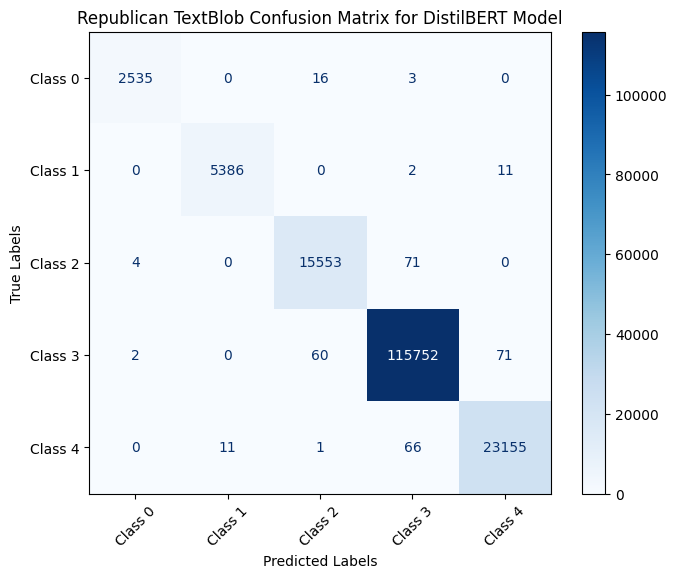

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 2535,0,16,3,0],
 [ 0,5386,0,2,11],
 [ 4,0,15553,71,0],
 [ 2,0,60,115752,71],
 [ 0,11,1,66,23155]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('Republican TextBlob Confusion Matrix for DistilBERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# **Dataset 3: Brexit Anti**

### total 358,205 rows and 38 columns

In [ ]:
# Read Brexit dataset
df_anti = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Brexit Polarity Tweets/TweetDataset_AntiBrexit_Jan-Mar2022.csv')
pd.set_option('display.max_columns',None)
df_anti.head(5)

,Unnamed: 0,Date,Headline,URL,Opening Text,Hit Sentence,Source,Influencer,Country,Subregion,Language,Reach,Desktop Reach,Mobile Reach,Twitter Social Echo,Facebook Social Echo,Reddit Social Echo,National Viewership,Engagement,AVE,Sentiment,Key Phrases,Input Name,Keywords,Twitter Authority,Tweet Id,Twitter Id,Twitter Client,Twitter Screen Name,User Profile Url,Twitter Bio,Twitter Followers,Twitter Following,Alternate Date Format,Time,State,City,Document Tags
0,0,09-Jan-2022 11:58PM,NaN,https://twitter.com/nickynicky77551/statuses/1...,NaN,"RT @cnapan: #JohnsonOut is now running at 218,...",Twitter,@nickynicky77551,Unknown,NaN,English,1697,0,0,NaN,NaN,NaN,0,NaN,15.70,Neutral,"electoral liability,tweets",Adhoc Search Export,Brexit,6.0,'1480328159618732033',1315126719007789057,Twitter for Android,nicky@nicky7755,https://twitter.com/nickynicky77551,"Ardent Remainer; Rejoiner now, Support NHS 💙 #...",1697.0,2576.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN
1,1,09-Jan-2022 11:58PM,NaN,https://twitter.com/lines12345/statuses/148032...,NaN,RT @Femi_Sorry: My point: Any Labour leader wh...,Twitter,@lines12345,Unknown,NaN,English,11,0,0,NaN,NaN,NaN,0,NaN,0.10,Negative,"Labour leader,commitment,out the consequences,...",Adhoc Search Export,Brexit,1.0,'1480328147304337409',147229309,Twitter for iPhone,Helen,https://twitter.com/lines12345,Tory hating Remainer,11.0,92.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN
2,2,09-Jan-2022 11:58PM,NaN,https://twitter.com/millymoo97/statuses/148032...,NaN,RT @andy_murray: QT @Nigel_Farage: Please reco...,Twitter,@millymoo97,Unknown,NaN,English,2129,0,0,NaN,NaN,NaN,0,NaN,19.69,Neutral,"awkward moment,career",Adhoc Search Export,Europe,6.0,'1480328144678699012',19862216,Twitter Web App,seonaid mcgill,https://twitter.com/millymoo97,"Scottish, European, anti-Brexit, pro-EU, freel...",2129.0,3880.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN
3,3,09-Jan-2022 11:58PM,NaN,https://twitter.com/ValueSurplus/statuses/1480...,NaN,RT @mikegalsworthy: We’re the first country in...,Twitter,@valuesurplus,United Kingdom,NaN,English,2420,0,0,NaN,NaN,NaN,0,NaN,22.39,Negative,"Covid deaths,Plus failures,death rates,first c...",Adhoc Search Export,Europe,6.0,'1480328085421629444',1172871351083950081,Twitter Web App,Rightwing politics is a social virus #BLM 🇵🇸🌈,https://twitter.com/ValueSurplus,Classical Cultural Marxist.\nAnti Brexit estab...,2420.0,4952.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN
4,4,09-Jan-2022 11:57PM,NaN,https://twitter.com/Jackcdawes/statuses/148032...,NaN,"RT @StevePeers: QT @andy_murray: Game, set and...",Twitter,@jackcdawes,United Kingdom,NaN,English,18304,0,0,NaN,NaN,NaN,0,NaN,169.31,Neutral,NaN,Adhoc Search Export,Europe,8.0,'1480327958631960577',3065680671,Twitter Web App,Jack Dawes #FBPEGlobal #JohnsonOut #RejoinEU,https://twitter.com/Jackcdawes,"Lover of crime & horror fiction, history, & Me...",18304.0,19889.0,"Jan 9, 2022",11:57 PM,England,London,NaN


In [ ]:
# 210574 rows and 38 columns

df_anti.shape

(210574, 38)

In [ ]:
df_anti['Sentiment'].value_counts()

Sentiment
Neutral      118081
Negative      73933
Positive      15149
Not Rated      3411
Name: count, dtype: int64

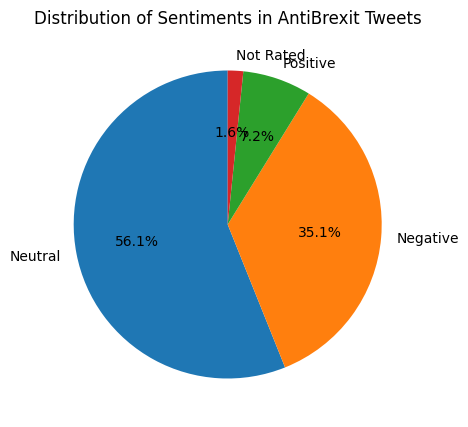

In [ ]:


import matplotlib.pyplot as plt
# Count the occurrences of each sentiment
sentiment_counts = df_anti['Sentiment'].value_counts()

# Create a pie chart
plt.figure(figsize=(5, 5))
plt.pie(sentiment_counts, labels=sentiment_counts.index, autopct='%1.1f%%', startangle=90)
plt.title('Distribution of Sentiments in AntiBrexit Tweets')
plt.show()


Neural occupied 56.1% ; Negative

In [ ]:
df_anti.isnull().all()

Unnamed: 0               False
Date                     False
Headline                  True
URL                      False
Opening Text              True
Hit Sentence             False
Source                   False
Influencer               False
Country                  False
Subregion                 True
Language                 False
Reach                    False
Desktop Reach            False
Mobile Reach             False
Twitter Social Echo       True
Facebook Social Echo      True
Reddit Social Echo        True
National Viewership      False
Engagement               False
AVE                      False
Sentiment                False
Key Phrases              False
Input Name               False
Keywords                 False
Twitter Authority        False
Tweet Id                 False
Twitter Id               False
Twitter Client           False
Twitter Screen Name      False
User Profile Url         False
Twitter Bio              False
Twitter Followers        False
Twitter 

# First, we need to remove contractions, hashtag, emojis, lowercase, punctuation, html

In [ ]:
import pandas as pd
import re
import string
import nltk
from nltk.corpus import stopwords
from bs4 import BeautifulSoup
from transformers import BertTokenizer, BertForSequenceClassification, pipeline

nltk.download('stopwords')


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

# Clean text in Hit Sentence

In [ ]:
# Function to clean text
def clean_text(text):
    # Remove HTML
    text = BeautifulSoup(text, "html.parser").get_text()
    # Remove contractions
    contractions = {
        "can't": "cannot",
        "won't": "will not",
        "n't": " not",
        "'re": " are",
        "'s": " is",
        "'d": " would",
        "'ll": " will",
        "'t": " not",
        "'ve": " have",
        "'m": " am"
    }
    for contraction, expanded in contractions.items():
        text = re.sub(contraction, expanded, text)
    # Remove hashtags
    text = re.sub(r'#\w+', '', text)
    # Remove emojis
    text = re.sub(r'[^\x00-\x7F]+', '', text)
    # Lowercase
    text = text.lower()
    # Remove punctuation
    text = text.translate(str.maketrans('', '', string.punctuation))
    # Remove extra whitespace
    text = re.sub(r'\s+', ' ', text).strip()
    return text

# Apply the cleaning function to the 'Hit Sentence' column
df_anti['cleaned_text'] = df_anti['Hit Sentence'].apply(clean_text)

# Ensure the cleaned text is of string type
df_anti['cleaned_text'] = df_anti['cleaned_text'].astype(str)

# Display the first few rows of the cleaned dataset
df_anti[['Hit Sentence', 'cleaned_text']].head()

<ipython-input-15-eeb9ad691385>:4: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  text = BeautifulSoup(text, "html.parser").get_text()


,Hit Sentence,cleaned_text
0,"RT @cnapan: #JohnsonOut is now running at 218,...",rt cnapan is now running at 218000 tweets he i...
1,RT @Femi_Sorry: My point: Any Labour leader wh...,rt femisorry my point any labour leader who re...
2,RT @andy_murray: QT @Nigel_Farage: Please reco...,rt andymurray qt nigelfarage please record the...
3,RT @mikegalsworthy: We’re the first country in...,rt mikegalsworthy were the first country in eu...
4,"RT @StevePeers: QT @andy_murray: Game, set and...",rt stevepeers qt andymurray game set and match...


# Let's determine the sentence is longer or short texts

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/39.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/872k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


config.json:   0%|          | 0.00/953 [00:00<?, ?B/s]

                                        cleaned_text  token_count
0  rt cnapan is now running at 218000 tweets he i...           25
1  rt femisorry my point any labour leader who re...           55
2  rt andymurray qt nigelfarage please record the...           58
3  rt mikegalsworthy were the first country in eu...           70
4  rt stevepeers qt andymurray game set and match...           41


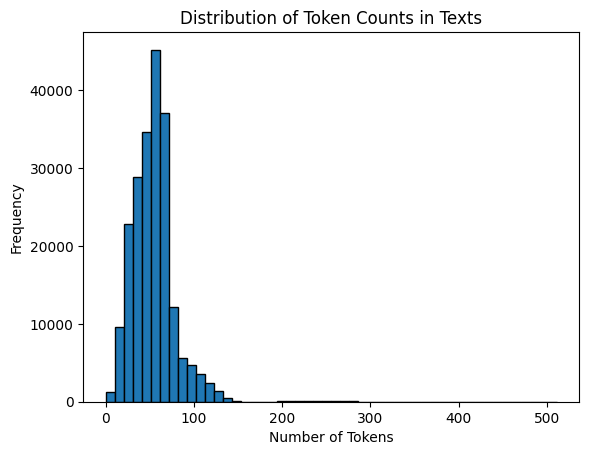

count    210574.000000
mean         54.023844
std          25.505149
min           0.000000
25%          37.000000
50%          54.000000
75%          65.000000
max         511.000000
Name: token_count, dtype: float64


In [ ]:
# Initialize the BERT tokenizer
model_name = "nlptown/bert-base-multilingual-uncased-sentiment"
tokenizer = BertTokenizer.from_pretrained(model_name)

# Tokenize the texts and count the number of tokens
df_anti['token_count'] = df_anti['cleaned_text'].apply(lambda x: len(tokenizer.tokenize(x)))

# Display the first few rows to check the token counts
print(df_anti[['cleaned_text', 'token_count']].head())

# Plot the distribution of token counts
import matplotlib.pyplot as plt
plt.hist(df_anti['token_count'], bins=50, edgecolor='k')
plt.xlabel('Number of Tokens')
plt.ylabel('Frequency')
plt.title('Distribution of Token Counts in Texts')
plt.show()

# Print basic statistics
print(df_anti['token_count'].describe())


In [ ]:
print(df_anti['cleaned_text'])

0         rt cnapan is now running at 218000 tweets he i...
1         rt femisorry my point any labour leader who re...
2         rt andymurray qt nigelfarage please record the...
3         rt mikegalsworthy were the first country in eu...
4         rt stevepeers qt andymurray game set and match...
                                ...                        
210569    rt prfchrispainter johnson delayed and dithere...
210570    rt jbkennedy bizarrely because of an irish per...
210571    rt sillyshib brexit was supposed to split the ...
210572    mitsyarty going well in terms of uk industry 1...
210573    rt archerrs so for all those brexiters who con...
Name: cleaned_text, Length: 210574, dtype: object


In [ ]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Save dataframe to CSV
df_anti.to_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv', index=False)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# 3.1 BERT Sentiment Analysis Pipline

 Initializing the tokenizer and pipeline ensures that we use the same pre-trained model for both tokenizing the text and performing sentiment analysis

In [ ]:
sentiment_pipeline = pipeline("sentiment-analysis", model=model_name, tokenizer=tokenizer)

In [ ]:
df_anti['cleaned_text'] = df_anti['cleaned_text'].astype(str)

In [ ]:
def bert_sentiment(text):
    inputs = tokenizer(text, max_length=256, truncation=True, return_tensors='pt') # pytorch
    tokens = tokenizer.convert_ids_to_tokens(inputs['input_ids'][0])
    truncated_text = tokenizer.convert_tokens_to_string(tokens)
    result = sentiment_pipeline(truncated_text)[0]

    if result['label'] == '1 star':
        score = -1.0
        label = 'Extremely Negative'
    elif result['label'] == '2 stars':
        score = -0.5
        label = 'Negative'
    elif result['label'] == '3 stars':
        score = 0.0
        label = 'Neutral'
    elif result['label'] == '4 stars':
        score = 0.5
        label = 'Positive'
    else:
        score = 1.0
        label = 'Extremely Positive'

    return score, label


In [ ]:
df_anti[['bert_sentiment_score', 'bert_sentiment_label']] = df_anti['cleaned_text'].apply(bert_sentiment).apply(pd.Series)
print(df_anti[['cleaned_text', 'bert_sentiment_score', 'bert_sentiment_label']].head(5))

# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Save dataframe to CSV
df_anti.to_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv', index=False)

                                        cleaned_text  bert_sentiment_score  \
0  rt cnapan is now running at 218000 tweets he i...                  -1.0   
1  rt femisorry my point any labour leader who re...                  -1.0   
2  rt andymurray qt nigelfarage please record the...                  -1.0   
3  rt mikegalsworthy were the first country in eu...                  -1.0   
4  rt stevepeers qt andymurray game set and match...                  -1.0   

  bert_sentiment_label  
0   Extremely Negative  
1   Extremely Negative  
2   Extremely Negative  
3   Extremely Negative  
4   Extremely Negative  
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [5]:
df_anti = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv')
pd.set_option('display.max_columns',None)
df_anti.head(5)

,Unnamed: 0.1,Unnamed: 0,Date,Headline,URL,Opening Text,Hit Sentence,Source,Influencer,Country,Subregion,Language,Reach,Desktop Reach,Mobile Reach,Twitter Social Echo,Facebook Social Echo,Reddit Social Echo,National Viewership,Engagement,AVE,Sentiment,Key Phrases,Input Name,Keywords,Twitter Authority,Tweet Id,Twitter Id,Twitter Client,Twitter Screen Name,User Profile Url,Twitter Bio,Twitter Followers,Twitter Following,Alternate Date Format,Time,State,City,Document Tags,cleaned_text,token_count,bert_sentiment_score,bert_sentiment_label,label,vader_sentiment_score,vader_sentiment_category,textblob_sentiment_score,textblob_sentiment_numeric,textblob_sentiment_category,vader_cleaned_text,vader_token_counts
0,0,0,09-Jan-2022 11:58PM,NaN,https://twitter.com/nickynicky77551/statuses/1...,NaN,"RT @cnapan: #JohnsonOut is now running at 218,...",Twitter,@nickynicky77551,Unknown,NaN,English,1697,0,0,NaN,NaN,NaN,0,NaN,15.70,Neutral,"electoral liability,tweets",Adhoc Search Export,Brexit,6.0,'1480328159618732033',1315126719007789057,Twitter for Android,nicky@nicky7755,https://twitter.com/nickynicky77551,"Ardent Remainer; Rejoiner now, Support NHS 💙 #...",1697.0,2576.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt cnapan is now running at 218000 tweets he i...,25,-1.0,Extremely Negative,3,-0.3818,Negative,0.000000,2,Neutral,"['rt', 'cnapan', 'is', 'now', 'running', 'at',...",18
1,1,1,09-Jan-2022 11:58PM,NaN,https://twitter.com/lines12345/statuses/148032...,NaN,RT @Femi_Sorry: My point: Any Labour leader wh...,Twitter,@lines12345,Unknown,NaN,English,11,0,0,NaN,NaN,NaN,0,NaN,0.10,Negative,"Labour leader,commitment,out the consequences,...",Adhoc Search Export,Brexit,1.0,'1480328147304337409',147229309,Twitter for iPhone,Helen,https://twitter.com/lines12345,Tory hating Remainer,11.0,92.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt femisorry my point any labour leader who re...,55,-1.0,Extremely Negative,2,-0.5423,Negative,-0.350000,1,Negative,"['rt', 'femisorry', 'my', 'point', 'any', 'lab...",33
2,2,2,09-Jan-2022 11:58PM,NaN,https://twitter.com/millymoo97/statuses/148032...,NaN,RT @andy_murray: QT @Nigel_Farage: Please reco...,Twitter,@millymoo97,Unknown,NaN,English,2129,0,0,NaN,NaN,NaN,0,NaN,19.69,Neutral,"awkward moment,career",Adhoc Search Export,Europe,6.0,'1480328144678699012',19862216,Twitter Web App,seonaid mcgill,https://twitter.com/millymoo97,"Scottish, European, anti-Brexit, pro-EU, freel...",2129.0,3880.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt andymurray qt nigelfarage please record the...,58,-1.0,Extremely Negative,3,0.5423,Positive,-0.066667,2,Neutral,"['rt', 'andymurray', 'qt', 'nigelfarage', 'ple...",37
3,3,3,09-Jan-2022 11:58PM,NaN,https://twitter.com/ValueSurplus/statuses/1480...,NaN,RT @mikegalsworthy: We’re the first country in...,Twitter,@valuesurplus,United Kingdom,NaN,English,2420,0,0,NaN,NaN,NaN,0,NaN,22.39,Negative,"Covid deaths,Plus failures,death rates,first c...",Adhoc Search Export,Europe,6.0,'1480328085421629444',1172871351083950081,Twitter Web App,Rightwing politics is a social virus #BLM 🇵🇸🌈,https://twitter.com/ValueSurplus,Classical Cultural Marxist.\nAnti Brexit estab...,2420.0,4952.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt mikegalsworthy were the first country in eu...,70,-1.0,Extremely Negative,3,-0.8720,Extremely Negative,-0.106667,2,Neutral,"['rt', 'mikegalsworthy', 'were', 'the', 'first...",48
4,4,4,09-Jan-2022 11:57PM,NaN,https://twitter.com/Jackcdawes/statuses/148032...,NaN,"RT @StevePeers: QT @andy_murray: Game, set and...",Twitter,@jackcdawes,United Kingdom,NaN,English,18304,0,0,NaN,NaN,NaN,0,NaN,169.31,Neutral,NaN,Adhoc Search Export,Europe,8.0,'1480327958631960577',3065680671,Twitter Web App,Jack Dawes #FBPEGlobal #JohnsonOut #RejoinEU,https://twitter.com/Jackcdawes,"Lover of crime & horror fiction, history, & Me...",18304.0,19889.0,"Jan 9, 2022",11:57 PM,England,London,NaN,rt stevepeers qt andymurray game set and match...,41,-1.0,Extremely Negative,3,0.5423,Positive,-0.150000,2,Neutral,"['rt', 'stevepeers', 'qt', '

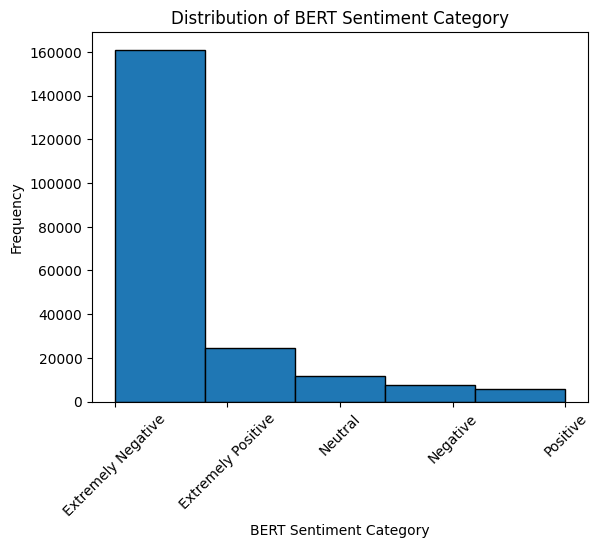

In [ ]:
# Inspect the distribution of sentiment labels
plt.hist(df_anti['bert_sentiment_label'], bins=5, edgecolor='k')
plt.xlabel('BERT Sentiment Category')
plt.xticks(rotation=45)
plt.ylabel('Frequency')
plt.title('Distribution of BERT Sentiment Category')
plt.show()

In [ ]:
# Check if the column was created successfully
print(df_anti[['cleaned_text', 'bert_sentiment_score']].head())


                                        cleaned_text  bert_sentiment_score
0  rt cnapan is now running at 218000 tweets he i...                  -1.0
1  rt femisorry my point any labour leader who re...                  -1.0
2  rt andymurray qt nigelfarage please record the...                  -1.0
3  rt mikegalsworthy were the first country in eu...                  -1.0
4  rt stevepeers qt andymurray game set and match...                  -1.0


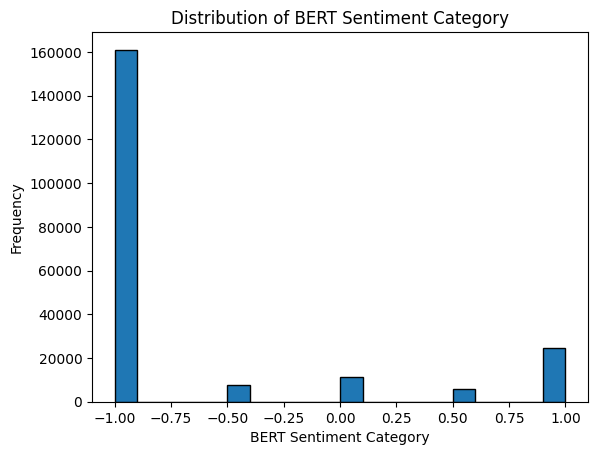

In [ ]:
# The distribution of sentiment scores
plt.hist(df_anti['bert_sentiment_score'], bins=20, edgecolor='k')
plt.xlabel('BERT Sentiment Category')
plt.ylabel('Frequency')
plt.title('Distribution of BERT Sentiment Category')
plt.show()

# WordCloud

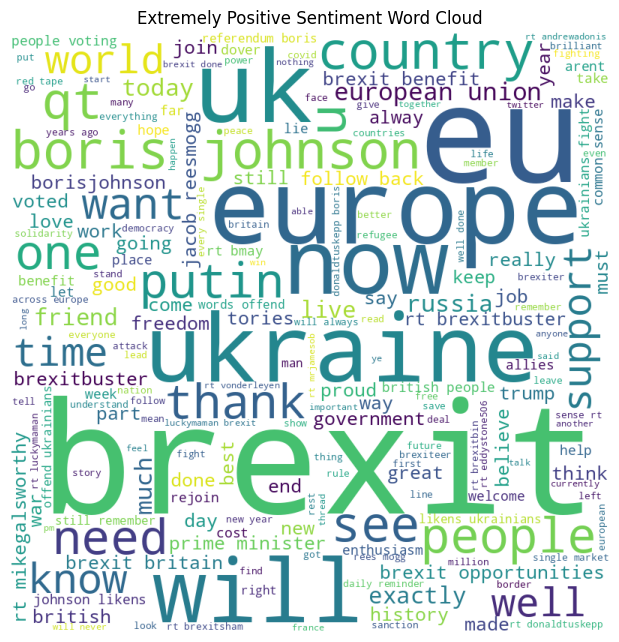

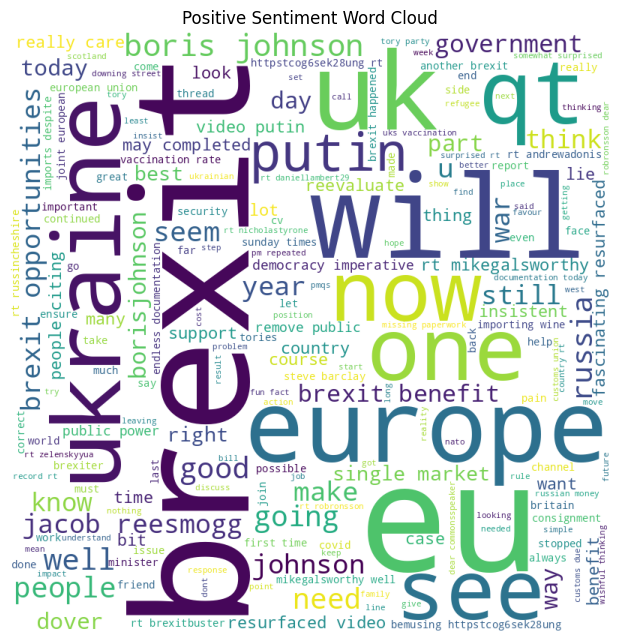

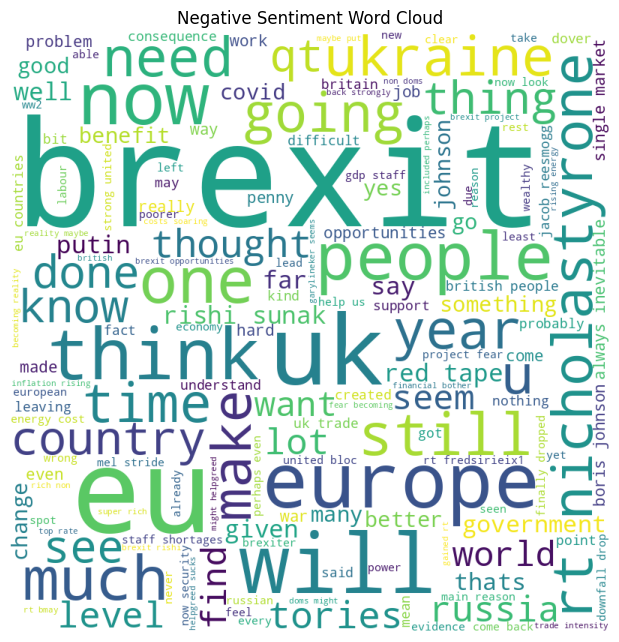

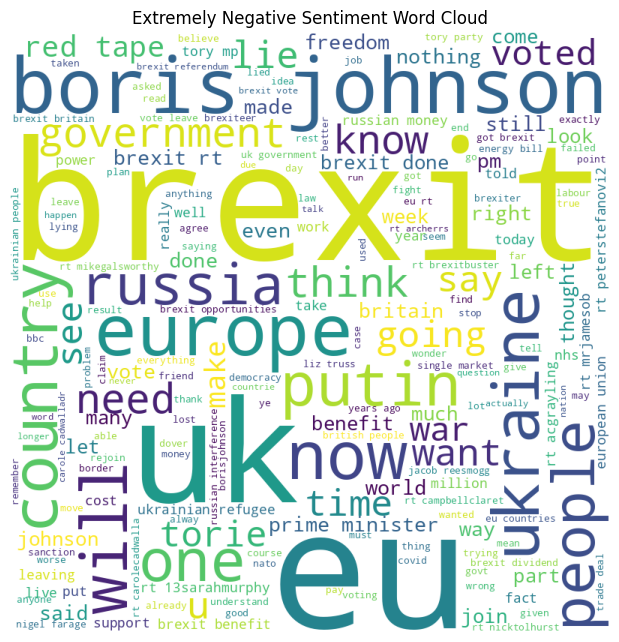

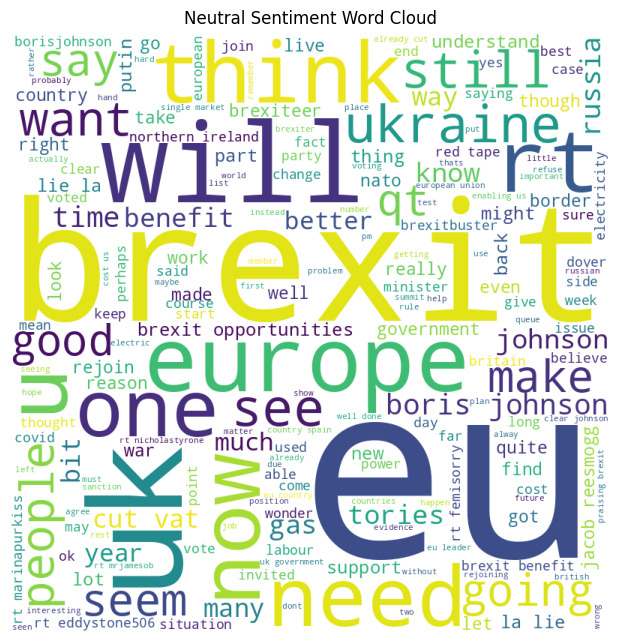

In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

# Filter the DataFrame for each sentiment label
extremely_positive_df = df_anti[df_anti['bert_sentiment_label'] == 'Extremely Positive']
positive_df = df_anti[df_anti['bert_sentiment_label'] == 'Positive']
negative_df = df_anti[df_anti['bert_sentiment_label'] == 'Negative']
extremely_negative_df = df_anti[df_anti['bert_sentiment_label'] == 'Extremely Negative']
neutral_df = df_anti[df_anti['bert_sentiment_label'] == 'Neutral']

# Combine text for each sentiment
extremely_positive_text = " ".join(extremely_positive_df['cleaned_text'])
positive_text = " ".join(str(text) for text in positive_df['cleaned_text'])
negative_text = " ".join(str(text) for text in negative_df['cleaned_text'])
extremely_negative_text = " ".join(str(text) for text in extremely_negative_df['cleaned_text'])
neutral_text = " ".join(str(text) for text in neutral_df['cleaned_text'])

# Create WordCloud objects
stopwords = set(STOPWORDS)
wordcloud_ep = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_positive_text)
wordcloud_p = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(positive_text)
wordcloud_n = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(negative_text)
wordcloud_en = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_negative_text)

wordcloud_ne = WordCloud(width = 800, height = 800,
                background_color = 'white',
                stopwords = stopwords,
                min_font_size = 10).generate(neutral_text)

# Plot the WordClouds
plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ep)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_p)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_n)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_en)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ne)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Neutral Sentiment Word Cloud")
plt.show()


# (NEW)Prepare for the data

In [24]:
# Read Brexit dataset
df_anti = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv')
pd.set_option('display.max_columns',None)
df_anti.head(5)

,Unnamed: 0.1,Unnamed: 0,Date,Headline,URL,Opening Text,Hit Sentence,Source,Influencer,Country,Subregion,Language,Reach,Desktop Reach,Mobile Reach,Twitter Social Echo,Facebook Social Echo,Reddit Social Echo,National Viewership,Engagement,AVE,Sentiment,Key Phrases,Input Name,Keywords,Twitter Authority,Tweet Id,Twitter Id,Twitter Client,Twitter Screen Name,User Profile Url,Twitter Bio,Twitter Followers,Twitter Following,Alternate Date Format,Time,State,City,Document Tags,cleaned_text,token_count,bert_sentiment_score,bert_sentiment_label,label,vader_sentiment_score,vader_sentiment_category,textblob_sentiment_score,textblob_sentiment_numeric,textblob_sentiment_category,vader_cleaned_text,vader_token_counts
0,0,0,09-Jan-2022 11:58PM,NaN,https://twitter.com/nickynicky77551/statuses/1...,NaN,"RT @cnapan: #JohnsonOut is now running at 218,...",Twitter,@nickynicky77551,Unknown,NaN,English,1697,0,0,NaN,NaN,NaN,0,NaN,15.70,Neutral,"electoral liability,tweets",Adhoc Search Export,Brexit,6.0,'1480328159618732033',1315126719007789057,Twitter for Android,nicky@nicky7755,https://twitter.com/nickynicky77551,"Ardent Remainer; Rejoiner now, Support NHS 💙 #...",1697.0,2576.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt cnapan is now running at 218000 tweets he i...,25,-1.0,Extremely Negative,3,-0.3818,Negative,0.000000,2,Neutral,"['rt', 'cnapan', 'is', 'now', 'running', 'at',...",18
1,1,1,09-Jan-2022 11:58PM,NaN,https://twitter.com/lines12345/statuses/148032...,NaN,RT @Femi_Sorry: My point: Any Labour leader wh...,Twitter,@lines12345,Unknown,NaN,English,11,0,0,NaN,NaN,NaN,0,NaN,0.10,Negative,"Labour leader,commitment,out the consequences,...",Adhoc Search Export,Brexit,1.0,'1480328147304337409',147229309,Twitter for iPhone,Helen,https://twitter.com/lines12345,Tory hating Remainer,11.0,92.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt femisorry my point any labour leader who re...,55,-1.0,Extremely Negative,2,-0.5423,Negative,-0.350000,1,Negative,"['rt', 'femisorry', 'my', 'point', 'any', 'lab...",33
2,2,2,09-Jan-2022 11:58PM,NaN,https://twitter.com/millymoo97/statuses/148032...,NaN,RT @andy_murray: QT @Nigel_Farage: Please reco...,Twitter,@millymoo97,Unknown,NaN,English,2129,0,0,NaN,NaN,NaN,0,NaN,19.69,Neutral,"awkward moment,career",Adhoc Search Export,Europe,6.0,'1480328144678699012',19862216,Twitter Web App,seonaid mcgill,https://twitter.com/millymoo97,"Scottish, European, anti-Brexit, pro-EU, freel...",2129.0,3880.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt andymurray qt nigelfarage please record the...,58,-1.0,Extremely Negative,3,0.5423,Positive,-0.066667,2,Neutral,"['rt', 'andymurray', 'qt', 'nigelfarage', 'ple...",37
3,3,3,09-Jan-2022 11:58PM,NaN,https://twitter.com/ValueSurplus/statuses/1480...,NaN,RT @mikegalsworthy: We’re the first country in...,Twitter,@valuesurplus,United Kingdom,NaN,English,2420,0,0,NaN,NaN,NaN,0,NaN,22.39,Negative,"Covid deaths,Plus failures,death rates,first c...",Adhoc Search Export,Europe,6.0,'1480328085421629444',1172871351083950081,Twitter Web App,Rightwing politics is a social virus #BLM 🇵🇸🌈,https://twitter.com/ValueSurplus,Classical Cultural Marxist.\nAnti Brexit estab...,2420.0,4952.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt mikegalsworthy were the first country in eu...,70,-1.0,Extremely Negative,3,-0.8720,Extremely Negative,-0.106667,2,Neutral,"['rt', 'mikegalsworthy', 'were', 'the', 'first...",48
4,4,4,09-Jan-2022 11:57PM,NaN,https://twitter.com/Jackcdawes/statuses/148032...,NaN,"RT @StevePeers: QT @andy_murray: Game, set and...",Twitter,@jackcdawes,United Kingdom,NaN,English,18304,0,0,NaN,NaN,NaN,0,NaN,169.31,Neutral,NaN,Adhoc Search Export,Europe,8.0,'1480327958631960577',3065680671,Twitter Web App,Jack Dawes #FBPEGlobal #JohnsonOut #RejoinEU,https://twitter.com/Jackcdawes,"Lover of crime & horror fiction, history, & Me...",18304.0,19889.0,"Jan 9, 2022",11:57 PM,England,London,NaN,rt stevepeers qt andymurray game set and match...,41,-1.0,Extremely Negative,3,0.5423,Positive,-0.150000,2,Neutral,"['rt', 'stevepeers', 'qt', '

In [25]:
# Check for NaN values and handle them
df_anti = df_anti.dropna(subset=['cleaned_text'])  # Remove rows with NaN in 'cleaned_text'

# Ensure all text is string type
df_anti['cleaned_text'] = df_anti['cleaned_text'].astype(str)

<ipython-input-25-8bbd1d5b079a>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_anti['cleaned_text'] = df_anti['cleaned_text'].astype(str)


In [26]:
# Assume df_anti is already loaded and cleaned
# Encode the labels (convert sentiment scores to categories)
label_dict = {-1.0: 0, -0.5: 1, 0: 2, 0.5: 3, 1.0: 4}
df_anti['label'] = df_anti['bert_sentiment_score'].map(label_dict)

# Split data into training and validation sets
train_texts, val_texts, train_labels, val_labels = train_test_split(
    df_anti['cleaned_text'], df_anti['label'], test_size=0.2, random_state=42)


# Tokenise the text

In [27]:
from torch.utils.data import Dataset, DataLoader
from transformers import BertTokenizer

# Initialize BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

In [28]:
# Define a custom dataset class for BERT
class SentimentDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]
        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            padding='max_length',
            truncation=True,
            return_attention_mask=True,
            return_tensors='pt',
        )
        return {
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Create datasets and dataloaders
train_dataset = SentimentDataset(train_texts.values, train_labels.values, tokenizer, max_len=256)
val_dataset = SentimentDataset(val_texts.values, val_labels.values, tokenizer, max_len=256)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# Load a pre-trained BERT model for sequence classification
model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=5)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


BertForSequenceClassification(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSdpaSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e

# 3.1 BERT Model for df_anti

# BERT Revise with Early stopping


In [29]:
# Define optimizer and loss function
optimizer = AdamW(model.parameters(), lr=2e-5)
loss_fn = CrossEntropyLoss().to(device)

# Set up learning rate scheduler
total_steps = len(train_loader) * 3  # Assuming 3 epochs
scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=0, num_training_steps=total_steps)

# Parameters for early stopping
patience = 2  # Number of epochs to wait for improvement
best_val_loss = float('inf')
epochs_without_improvement = 0

# Training loop
epochs = 3
for epoch in range(epochs):
    model.train()
    total_loss = 0
    train_labels = []
    train_preds = []

    for batch in train_loader:
        optimizer.zero_grad()

        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['label'].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        total_loss += loss.item()

        # Collect predictions for training metrics
        logits = outputs.logits
        preds = torch.argmax(logits, dim=1).flatten()

        train_labels.extend(labels.cpu().numpy())
        train_preds.extend(preds.cpu().numpy())

        loss.backward()
        optimizer.step()
        scheduler.step()

    avg_train_loss = total_loss / len(train_loader)

    # Convert to numpy arrays
    train_labels = np.array(train_labels)
    train_preds = np.array(train_preds)

    # Ensure train_labels and train_preds are valid
    if len(train_labels) > 0 and len(train_preds) > 0 and not np.any(np.isnan(train_labels)) and not np.any(np.isnan(train_preds)):
        train_accuracy = accuracy_score(train_labels, train_preds)
        train_f1 = f1_score(train_labels, train_preds, average='weighted', zero_division=0)
        train_recall = recall_score(train_labels, train_preds, average='weighted', zero_division=0)
        train_precision = precision_score(train_labels, train_preds, average='weighted', zero_division=0)

        print(f"Epoch {epoch+1}/{epochs} - Training loss: {avg_train_loss}")
        print(f"Training Accuracy: {train_accuracy}")
        print(f"Training F1 Score: {train_f1}")
        print(f"Training Recall: {train_recall}")
        print(f"Training Precision: {train_precision}")
    else:
        print("Invalid training predictions or labels. Skipping training metrics calculation.")

    # Validation
    model.eval()
    val_loss = 0
    val_labels = []
    val_preds = []

    with torch.no_grad():
        for batch in val_loader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['label'].to(device)

            outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
            loss = outputs.loss
            val_loss += loss.item()

            logits = outputs.logits
            preds = torch.argmax(logits, dim=1).flatten()

            val_labels.extend(labels.cpu().numpy())
            val_preds.extend(preds.cpu().numpy())

    avg_val_loss = val_loss / len(val_loader)

    # Convert to numpy arrays
    val_labels = np.array(val_labels)
    val_preds = np.array(val_preds)

    # Ensure val_labels and val_preds are valid
    if len(val_labels) > 0 and len(val_preds) > 0 and not np.any(np.isnan(val_labels)) and not np.any(np.isnan(val_preds)):
        val_accuracy = accuracy_score(val_labels, val_preds)
        val_f1 = f1_score(val_labels, val_preds, average='weighted', zero_division=0)
        val_recall = recall_score(val_labels, val_preds, average='weighted', zero_division=0)
        val_precision = precision_score(val_labels, val_preds, average='weighted', zero_division=0)

        print(f"Epoch {epoch+1}/{epochs} - Validation loss: {avg_val_loss}")
        print(f"Validation Accuracy: {val_accuracy}")
        print(f"Validation F1 Score: {val_f1}")
        print(f"Validation Recall: {val_recall}")
        print(f"Validation Precision: {val_precision}")

        # Print the confusion matrix
        cm = confusion_matrix(val_labels, val_preds)
        print(f"Confusion Matrix:\n{cm}")
    else:
        print("Invalid validation predictions or labels. Skipping validation metrics calculation.")

    # Early stopping check
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        epochs_without_improvement = 0
        print("Validation loss improved. Saving model...")
        # Save the best model (optional)
        # torch.save(model.state_dict(), 'best_model.pt')
    else:
        epochs_without_improvement += 1
        print(f"No improvement for {epochs_without_improvement} epoch(s).")

    if epochs_without_improvement >= patience:
        print("Early stopping triggered.")
        break

/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:591: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Epoch 1/3 - Training loss: 0.28300631331964365
Training Accuracy: 0.9016639656165221
Training F1 Score: 0.8975129373647286
Training Recall: 0.9016639656165221
Training Precision: 0.8960332794574918
Epoch 1/3 - Validation loss: 0.20089031589516193
Validation Accuracy: 0.9268414304031913
Validation F1 Score: 0.9270073249367525
Validation Recall: 0.9268414304031913
Validation Precision: 0.9285237799980307
Confusion Matrix:
[[31323   446   189    35   273]
 [  212  1218   104     2     2]
 [  283   241  1593   100    40]
 [  125    28   133   777    70]
 [  575    22    34   167  4122]]
Validation loss improved. Saving model...
Epoch 2/3 - Training loss: 0.10894307728475469
Training Accuracy: 0.961466996729058
Training F1 Score: 0.9610885655529255
Training Recall: 0.961466996729058
Training Precision: 0.9608591425738844
Epoch 2/3 - Validation loss: 0.18517870716569565
Validation Accuracy: 0.9403523768817971
Validation F1 Score: 0.939487495259186
Validation Recall: 0.9403523768817971
Valida

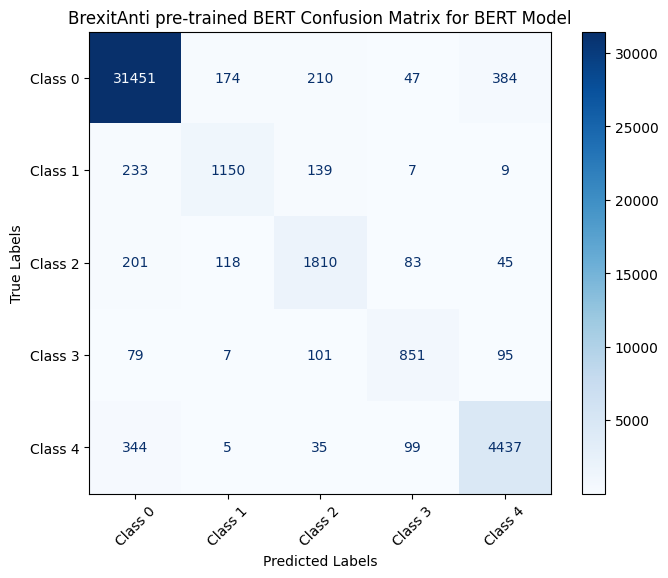

In [30]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 31451,174,210,47,384],
 [ 233,1150,139,7,9],
 [ 201,118,1810,83,45],
 [ 79,7,101,851,95],
 [ 344,5,35,99,4437]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('BrexitAnti pre-trained BERT Confusion Matrix for BERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# (NEW) Pre-trained BERT for DistilBERT Model

In [4]:
# Read Brexit dataset
df_anti = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv')
pd.set_option('display.max_columns',None)
df_anti.head(5)

,Unnamed: 0.1,Unnamed: 0,Date,Headline,URL,Opening Text,Hit Sentence,Source,Influencer,Country,Subregion,Language,Reach,Desktop Reach,Mobile Reach,Twitter Social Echo,Facebook Social Echo,Reddit Social Echo,National Viewership,Engagement,AVE,Sentiment,Key Phrases,Input Name,Keywords,Twitter Authority,Tweet Id,Twitter Id,Twitter Client,Twitter Screen Name,User Profile Url,Twitter Bio,Twitter Followers,Twitter Following,Alternate Date Format,Time,State,City,Document Tags,cleaned_text,token_count,bert_sentiment_score,bert_sentiment_label,label,vader_sentiment_score,vader_sentiment_category,textblob_sentiment_score,textblob_sentiment_numeric,textblob_sentiment_category,vader_cleaned_text,vader_token_counts
0,0,0,09-Jan-2022 11:58PM,NaN,https://twitter.com/nickynicky77551/statuses/1...,NaN,"RT @cnapan: #JohnsonOut is now running at 218,...",Twitter,@nickynicky77551,Unknown,NaN,English,1697,0,0,NaN,NaN,NaN,0,NaN,15.70,Neutral,"electoral liability,tweets",Adhoc Search Export,Brexit,6.0,'1480328159618732033',1315126719007789057,Twitter for Android,nicky@nicky7755,https://twitter.com/nickynicky77551,"Ardent Remainer; Rejoiner now, Support NHS 💙 #...",1697.0,2576.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt cnapan is now running at 218000 tweets he i...,25,-1.0,Extremely Negative,3,-0.3818,Negative,0.000000,2,Neutral,"['rt', 'cnapan', 'is', 'now', 'running', 'at',...",18
1,1,1,09-Jan-2022 11:58PM,NaN,https://twitter.com/lines12345/statuses/148032...,NaN,RT @Femi_Sorry: My point: Any Labour leader wh...,Twitter,@lines12345,Unknown,NaN,English,11,0,0,NaN,NaN,NaN,0,NaN,0.10,Negative,"Labour leader,commitment,out the consequences,...",Adhoc Search Export,Brexit,1.0,'1480328147304337409',147229309,Twitter for iPhone,Helen,https://twitter.com/lines12345,Tory hating Remainer,11.0,92.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt femisorry my point any labour leader who re...,55,-1.0,Extremely Negative,2,-0.5423,Negative,-0.350000,1,Negative,"['rt', 'femisorry', 'my', 'point', 'any', 'lab...",33
2,2,2,09-Jan-2022 11:58PM,NaN,https://twitter.com/millymoo97/statuses/148032...,NaN,RT @andy_murray: QT @Nigel_Farage: Please reco...,Twitter,@millymoo97,Unknown,NaN,English,2129,0,0,NaN,NaN,NaN,0,NaN,19.69,Neutral,"awkward moment,career",Adhoc Search Export,Europe,6.0,'1480328144678699012',19862216,Twitter Web App,seonaid mcgill,https://twitter.com/millymoo97,"Scottish, European, anti-Brexit, pro-EU, freel...",2129.0,3880.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt andymurray qt nigelfarage please record the...,58,-1.0,Extremely Negative,3,0.5423,Positive,-0.066667,2,Neutral,"['rt', 'andymurray', 'qt', 'nigelfarage', 'ple...",37
3,3,3,09-Jan-2022 11:58PM,NaN,https://twitter.com/ValueSurplus/statuses/1480...,NaN,RT @mikegalsworthy: We’re the first country in...,Twitter,@valuesurplus,United Kingdom,NaN,English,2420,0,0,NaN,NaN,NaN,0,NaN,22.39,Negative,"Covid deaths,Plus failures,death rates,first c...",Adhoc Search Export,Europe,6.0,'1480328085421629444',1172871351083950081,Twitter Web App,Rightwing politics is a social virus #BLM 🇵🇸🌈,https://twitter.com/ValueSurplus,Classical Cultural Marxist.\nAnti Brexit estab...,2420.0,4952.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt mikegalsworthy were the first country in eu...,70,-1.0,Extremely Negative,3,-0.8720,Extremely Negative,-0.106667,2,Neutral,"['rt', 'mikegalsworthy', 'were', 'the', 'first...",48
4,4,4,09-Jan-2022 11:57PM,NaN,https://twitter.com/Jackcdawes/statuses/148032...,NaN,"RT @StevePeers: QT @andy_murray: Game, set and...",Twitter,@jackcdawes,United Kingdom,NaN,English,18304,0,0,NaN,NaN,NaN,0,NaN,169.31,Neutral,NaN,Adhoc Search Export,Europe,8.0,'1480327958631960577',3065680671,Twitter Web App,Jack Dawes #FBPEGlobal #JohnsonOut #RejoinEU,https://twitter.com/Jackcdawes,"Lover of crime & horror fiction, history, & Me...",18304.0,19889.0,"Jan 9, 2022",11:57 PM,England,London,NaN,rt stevepeers qt andymurray game set and match...,41,-1.0,Extremely Negative,3,0.5423,Positive,-0.150000,2,Neutral,"['rt', 'stevepeers', 'qt', '

In [5]:
import pandas as pd
from sklearn.model_selection import train_test_split
from torch.utils.data import Dataset, DataLoader
from transformers import DistilBertTokenizer, DistilBertForSequenceClassification
from transformers import AdamW, get_linear_schedule_with_warmup
from torch.nn import CrossEntropyLoss
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
import torch
import numpy as np


# Check for NaN values and handle them
df_anti = df_anti.dropna(subset=['cleaned_text'])  # Remove rows with NaN in 'cleaned_text'

# Ensure all text is string type
df_anti['cleaned_text'] = df_anti['cleaned_text'].astype(str)

# Assume df_anti is already loaded and cleaned
# Encode the labels (convert sentiment scores to categories)
label_dict = {-1.0: 0, -0.5: 1, 0: 2, 0.5: 3, 1.0: 4}
df_anti['label'] = df_anti['bert_sentiment_score'].map(label_dict)

# Split data into training and validation sets
train_texts, val_texts, train_labels, val_labels = train_test_split(
    df_anti['cleaned_text'], df_anti['label'], test_size=0.2, random_state=42)


# Initialize DistilBERT tokenizer
tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')

# Define a custom dataset class for DistilBERT
class SentimentDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]
        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            padding='max_length',
            truncation=True,
            return_attention_mask=True,
            return_tensors='pt',
        )
        return {
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Create datasets and dataloaders
train_dataset = SentimentDataset(train_texts.values, train_labels.values, tokenizer, max_len=256)
val_dataset = SentimentDataset(val_texts.values, val_labels.values, tokenizer, max_len=256)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# Load a pre-trained DistilBERT model for sequence classification
model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=5)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Define optimizer and loss function
optimizer = AdamW(model.parameters(), lr=2e-5)
loss_fn = CrossEntropyLoss().to(device)

# Set up learning rate scheduler
total_steps = len(train_loader) * 3  # Assuming 3 epochs
scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=0, num_training_steps=total_steps)

# Parameters for early stopping
patience = 2  # Number of epochs to wait for improvement
best_val_loss = float('inf')
epochs_without_improvement = 0

# Training loop
epochs = 3
for epoch in range(epochs):
    model.train()
    total_loss = 0
    train_labels = []
    train_preds = []

    for batch in train_loader:
        optimizer.zero_grad()

        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['label'].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        total_loss += loss.item()

        # Collect predictions for training metrics
        logits = outputs.logits
        preds = torch.argmax(logits, dim=1).flatten()

        train_labels.extend(labels.cpu().numpy())
        train_preds.extend(preds.cpu().numpy())

        loss.backward()
        optimizer.step()
        scheduler.step()

    avg_train_loss = total_loss / len(train_loader)

    # Convert to numpy arrays
    train_labels = np.array(train_labels)
    train_preds = np.array(train_preds)

    # Ensure train_labels and train_preds are valid
    if len(train_labels) > 0 and len(train_preds) > 0 and not np.any(np.isnan(train_labels)) and not np.any(np.isnan(train_preds)):
        train_accuracy = accuracy_score(train_labels, train_preds)
        train_f1 = f1_score(train_labels, train_preds, average='weighted', zero_division=0)
        train_recall = recall_score(train_labels, train_preds, average='weighted', zero_division=0)
        train_precision = precision_score(train_labels, train_preds, average='weighted', zero_division=0)

        print(f"Epoch {epoch+1}/{epochs} - Training loss: {avg_train_loss}")
        print(f"Training Accuracy: {train_accuracy}")
        print(f"Training F1 Score: {train_f1}")
        print(f"Training Recall: {train_recall}")
        print(f"Training Precision: {train_precision}")
    else:
        print("Invalid training predictions or labels. Skipping training metrics calculation.")

    # Validation
    model.eval()
    val_loss = 0
    val_labels = []
    val_preds = []

    with torch.no_grad():
        for batch in val_loader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['label'].to(device)

            outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
            loss = outputs.loss
            val_loss += loss.item()

            logits = outputs.logits
            preds = torch.argmax(logits, dim=1).flatten()

            val_labels.extend(labels.cpu().numpy())
            val_preds.extend(preds.cpu().numpy())

    avg_val_loss = val_loss / len(val_loader)

    # Convert to numpy arrays
    val_labels = np.array(val_labels)
    val_preds = np.array(val_preds)

    # Ensure val_labels and val_preds are valid
    if len(val_labels) > 0 and len(val_preds) > 0 and not np.any(np.isnan(val_labels)) and not np.any(np.isnan(val_preds)):
        val_accuracy = accuracy_score(val_labels, val_preds)
        val_f1 = f1_score(val_labels, val_preds, average='weighted', zero_division=0)
        val_recall = recall_score(val_labels, val_preds, average='weighted', zero_division=0)
        val_precision = precision_score(val_labels, val_preds, average='weighted', zero_division=0)

        print(f"Epoch {epoch+1}/{epochs} - Validation loss: {avg_val_loss}")
        print(f"Validation Accuracy: {val_accuracy}")
        print(f"Validation F1 Score: {val_f1}")
        print(f"Validation Recall: {val_recall}")
        print(f"Validation Precision: {val_precision}")

        # Print the confusion matrix
        cm = confusion_matrix(val_labels, val_preds)
        print(f"Confusion Matrix:\n{cm}")
    else:
        print("Invalid validation predictions or labels. Skipping validation metrics calculation.")

    # Early stopping check
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        epochs_without_improvement = 0
        print("Validation loss improved. Saving model...")
        # Save the best model (optional)
        # torch.save(model.state_dict(), 'best_model.pt')
    else:
        epochs_without_improvement += 1
        print(f"No improvement for {epochs_without_improvement} epoch(s).")

    if epochs_without_improvement >= patience:
        print("Early stopping triggered.")
        break


<ipython-input-5-132dbdf01a1c>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_anti['cleaned_text'] = df_anti['cleaned_text'].astype(str)
<ipython-input-5-132dbdf01a1c>:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_anti['label'] = df_anti['bert_sentiment_score'].map(label_dict)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your setti

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/483 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:591: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Epoch 1/3 - Training loss: 0.2868340761244065
Training Accuracy: 0.9012009284488849
Training F1 Score: 0.8967594763448775
Training Recall: 0.9012009284488849
Training Precision: 0.8952682962112486
Epoch 1/3 - Validation loss: 0.20080472925834236
Validation Accuracy: 0.9286698010162892
Validation F1 Score: 0.9286760729208773
Validation Recall: 0.9286698010162892
Validation Precision: 0.9294477794649326
Confusion Matrix:
[[31322   289   317    32   306]
 [  226  1119   182     5     6]
 [  240   116  1791    69    41]
 [   94    10   189   764    76]
 [  576    10    77   143  4114]]
Validation loss improved. Saving model...
Epoch 2/3 - Training loss: 0.11945150112637716
Training Accuracy: 0.9576617810309107
Training F1 Score: 0.9572118524534904
Training Recall: 0.9576617810309107
Training Precision: 0.9569434899326389
Epoch 2/3 - Validation loss: 0.19027357306711748
Validation Accuracy: 0.9357695778126038
Validation F1 Score: 0.9363371681606081
Validation Recall: 0.9357695778126038
Vali

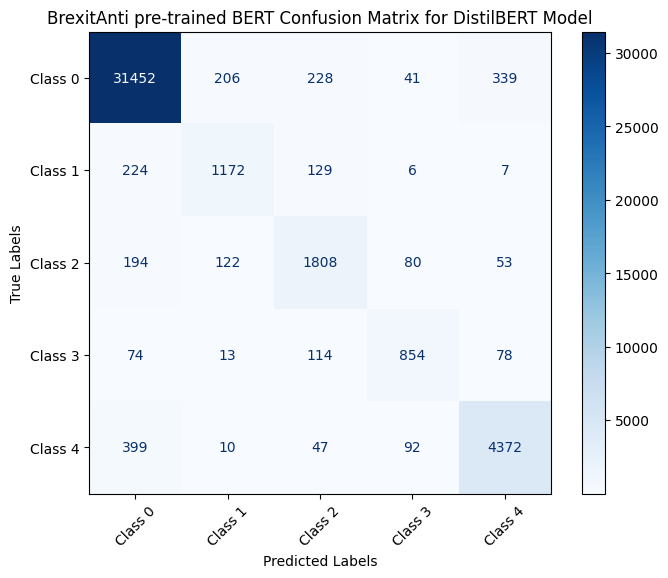

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [31452,206,228,41,339],
 [ 224,1172,129,6,7],
 [ 194,122,1808,80,53],
 [ 74,13,114,854,78],
 [ 399,10,47,92,4372]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('BrexitAnti pre-trained BERT Confusion Matrix for DistilBERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# (OLD)BERT model

In [10]:
from transformers import BertForSequenceClassification

# Load a pre-trained BERT model for sequence classification
model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=5)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


BertForSequenceClassification(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSdpaSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e

# Train and evaluate the model

In [ ]:
from transformers import AdamW, get_linear_schedule_with_warmup
from torch.nn import CrossEntropyLoss
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score

# Define optimizer and loss function
optimizer = AdamW(model.parameters(), lr=2e-5)
loss_fn = CrossEntropyLoss().to(device)

# Set up learning rate scheduler
total_steps = len(train_loader) * 3  # Assuming 3 epochs
scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=0, num_training_steps=total_steps)

/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:588: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Set up the training loop, define the optimizer, loss function, and learning rate scheduler, and train the model for a specified number of epochs.

In [ ]:
# Training loop
epochs = 3
for epoch in range(epochs):
    model.train()
    total_loss = 0

    for batch in train_loader:
        optimizer.zero_grad()

        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['label'].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        total_loss += loss.item()

        loss.backward()
        optimizer.step()
        scheduler.step()


    avg_train_loss = total_loss / len(train_loader)
    print(f"Epoch {epoch+1}/{epochs} - Training loss: {avg_train_loss}")

    # Validation
    model.eval()
    val_loss = 0
    all_labels = []
    all_preds = []

    with torch.no_grad():
        for batch in val_loader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['label'].to(device)

            outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
            loss = outputs.loss
            val_loss += loss.item()

            logits = outputs.logits
            preds = torch.argmax(logits, dim=1).flatten()

            all_labels.extend(labels.cpu().numpy())
            all_preds.extend(preds.cpu().numpy())

    avg_val_loss = val_loss / len(val_loader)
    val_accuracy = accuracy_score(all_labels, all_preds)
    val_f1 = f1_score(all_labels, all_preds, average='weighted')
    val_recall = recall_score(all_labels, all_preds, average='weighted')
    val_precision = precision_score(all_labels, all_preds, average='weighted')

    print(f"Epoch {epoch+1}/{epochs} - Validation loss: {avg_val_loss}")
    print(f"Validation Accuracy: {val_accuracy}")
    print(f"Validation F1 Score: {val_f1}")
    print(f"Validation Recall: {val_recall}")
    print(f"Validation Precision: {val_precision}")

from sklearn.metrics import confusion_matrix
# Confusion Matrix for DistilBERT
preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
cm_distilbert = confusion_matrix(val_labels, preds)

print(cm_distilbert)


Truncation was not explicitly activated but `max_length` is provided a specific value, please use `truncation=True` to explicitly truncate examples to max length. Defaulting to 'longest_first' truncation strategy. If you encode pairs of sequences (GLUE-style) with the tokenizer you can select this strategy more precisely by providing a specific strategy to `truncation`.
/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2699: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 1/3 - Training loss: 0.2791912965045304
Epoch 1/3 - Validation loss: 0.18251479347028648
Validation Accuracy: 0.9334916300605485
Validation F1 Score: 0.9311436526657727
Validation Recall: 0.9334916300605485
Validation Precision: 0.9309125854875708


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2699: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 2/3 - Training loss: 0.1101642369605148
Epoch 2/3 - Validation loss: 0.19863588419519426
Validation Accuracy: 0.9320194704974475
Validation F1 Score: 0.933300658420979
Validation Recall: 0.9320194704974475
Validation Precision: 0.9354425886450666


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:2699: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


Epoch 3/3 - Training loss: 0.041279247031852075
Epoch 3/3 - Validation loss: 0.2202649789925721
Validation Accuracy: 0.9418022082393447
Validation F1 Score: 0.941973514008982
Validation Recall: 0.9418022082393447
Validation Precision: 0.9421687835076855


In [ ]:
# saving data
df_anti.to_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv)

# 3.2 BERT via DistilModel

In [ ]:
import torch
from transformers import DistilBertTokenizer, DistilBertForSequenceClassification, Trainer, TrainingArguments
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
from torch.utils.data import DataLoader, Dataset

# Define a custom Dataset class
class TextDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]

        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            padding='max_length',
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )

        return {
            'text': text,
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Prepare the data for DistilBERT
def prepare_data(df, tokenizer, max_len, batch_size):
    le = LabelEncoder()
    df['label'] = le.fit_transform(df['bert_sentiment_label'])

    train_texts, val_texts, train_labels, val_labels = train_test_split(
        df['cleaned_text'].values,
        df['label'].values,
        test_size=0.1,
        random_state=42
    )

    train_dataset = TextDataset(
        texts=train_texts,
        labels=train_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    val_dataset = TextDataset(
        texts=val_texts,
        labels=val_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size)

    return train_loader, val_loader, val_labels, le

# Define evaluation metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    acc = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    recall = recall_score(labels, preds, average='weighted')
    precision = precision_score(labels, preds, average='weighted')
    return {
        'accuracy': acc,
        'f1': f1,
        'recall': recall,
        'precision': precision
    }


In [ ]:
# Handle missing values in 'cleaned_text'
df_anti.fillna({'cleaned_text': ''}, inplace=True)

# Set parameters
MAX_LEN = 128
BATCH_SIZE = 16

# Prepare data for DistilBERT
distilbert_tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
train_loader, val_loader, val_labels, label_encoder = prepare_data(df_anti, distilbert_tokenizer, MAX_LEN, BATCH_SIZE)

# Initialize DistilBERT model
distilbert_model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=5)

# Train DistilBERT model with modified training arguments
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    evaluation_strategy="epoch",
    save_steps=500,
    save_total_limit=1
)

trainer = Trainer(
    model=distilbert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

# saving data
df_anti.to_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv')

# Print DistilBERT evaluation results
val_accuracy = results['eval_accuracy']
print(f"Validation loss: {results['eval_loss']}")
print(f"Validation accuracy: {val_accuracy}")

# Confusion Matrix for DistilBERT
preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
cm_distilbert = confusion_matrix(val_labels, preds)

# Compute additional metrics
accuracy = accuracy_score(val_labels, preds)
f1 = f1_score(val_labels, preds, average='weighted')
recall = recall_score(val_labels, preds, average='weighted')
precision = precision_score(val_labels, preds, average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1}")
print(f"Recall: {recall}")
print(f"Precision: {precision}")

# Print confusion matrix
print("Confusion Matrix for DistilBERT:")
print(cm_distilbert)

# saving data
df_anti.to_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv')

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.246500,0.235623,0.925349,0.921398,0.925349,0.922240
2,0.090000,0.217967,0.936271,0.935523,0.936271,0.935304
3,0.044800,0.309854,0.939310,0.938651,0.939310,0.938359


Validation loss: 0.30985352396965027
Validation accuracy: 0.9393104758286637
Accuracy: 0.9393104758286637
F1 Score: 0.9386512153128693
Recall: 0.9393104758286637
Precision: 0.9383593999252077
Confusion Matrix for DistilBERT:
[[15817   159   106    92    17]
 [  218  2088     5    20    33]
 [  137     2   580    43     5]
 [  132    20    85   895    32]
 [   54    44     5    69   400]]


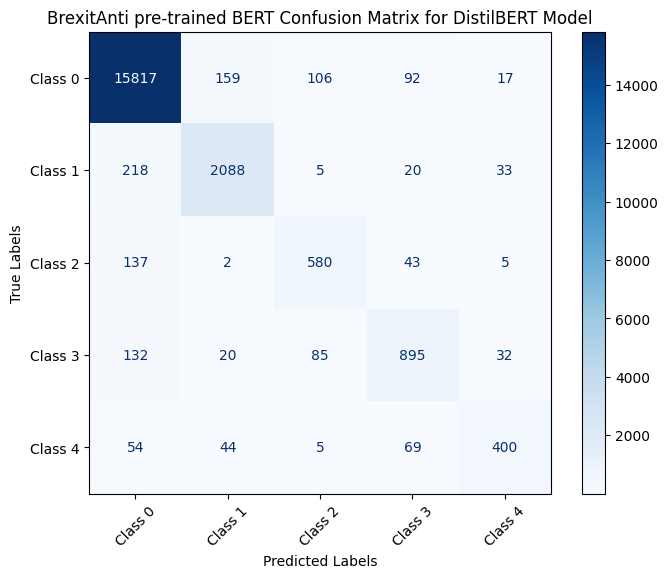

In [12]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 15817,159,106,92,17],
 [ 218,2088,5,20,33],
 [ 137,2,580,43,5],
 [ 132,20,85,895,32],
 [ 54,44,5,69,400]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('BrexitAnti pre-trained BERT Confusion Matrix for DistilBERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# 3.3 VADER Sentimentic Analyzer

In [ ]:
# Read Brexit dataset
df_anti = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv')
pd.set_option('display.max_columns',None)
df_anti.head(5)

,Unnamed: 0.1,Unnamed: 0,Date,Headline,URL,Opening Text,Hit Sentence,Source,Influencer,Country,Subregion,Language,Reach,Desktop Reach,Mobile Reach,Twitter Social Echo,Facebook Social Echo,Reddit Social Echo,National Viewership,Engagement,AVE,Sentiment,Key Phrases,Input Name,Keywords,Twitter Authority,Tweet Id,Twitter Id,Twitter Client,Twitter Screen Name,User Profile Url,Twitter Bio,Twitter Followers,Twitter Following,Alternate Date Format,Time,State,City,Document Tags,cleaned_text,token_count,bert_sentiment_score,bert_sentiment_label,label,vader_sentiment_score,vader_sentiment_category,textblob_sentiment_score,textblob_sentiment_numeric,textblob_sentiment_category
0,0,0,09-Jan-2022 11:58PM,NaN,https://twitter.com/nickynicky77551/statuses/1...,NaN,"RT @cnapan: #JohnsonOut is now running at 218,...",Twitter,@nickynicky77551,Unknown,NaN,English,1697,0,0,NaN,NaN,NaN,0,NaN,15.70,Neutral,"electoral liability,tweets",Adhoc Search Export,Brexit,6.0,'1480328159618732033',1315126719007789057,Twitter for Android,nicky@nicky7755,https://twitter.com/nickynicky77551,"Ardent Remainer; Rejoiner now, Support NHS 💙 #...",1697.0,2576.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt cnapan is now running at 218000 tweets he i...,25,-1.0,Extremely Negative,3,-0.3818,Negative,0.000000,2,Neutral
1,1,1,09-Jan-2022 11:58PM,NaN,https://twitter.com/lines12345/statuses/148032...,NaN,RT @Femi_Sorry: My point: Any Labour leader wh...,Twitter,@lines12345,Unknown,NaN,English,11,0,0,NaN,NaN,NaN,0,NaN,0.10,Negative,"Labour leader,commitment,out the consequences,...",Adhoc Search Export,Brexit,1.0,'1480328147304337409',147229309,Twitter for iPhone,Helen,https://twitter.com/lines12345,Tory hating Remainer,11.0,92.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt femisorry my point any labour leader who re...,55,-1.0,Extremely Negative,2,-0.5423,Negative,-0.350000,1,Negative
2,2,2,09-Jan-2022 11:58PM,NaN,https://twitter.com/millymoo97/statuses/148032...,NaN,RT @andy_murray: QT @Nigel_Farage: Please reco...,Twitter,@millymoo97,Unknown,NaN,English,2129,0,0,NaN,NaN,NaN,0,NaN,19.69,Neutral,"awkward moment,career",Adhoc Search Export,Europe,6.0,'1480328144678699012',19862216,Twitter Web App,seonaid mcgill,https://twitter.com/millymoo97,"Scottish, European, anti-Brexit, pro-EU, freel...",2129.0,3880.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt andymurray qt nigelfarage please record the...,58,-1.0,Extremely Negative,3,0.5423,Positive,-0.066667,2,Neutral
3,3,3,09-Jan-2022 11:58PM,NaN,https://twitter.com/ValueSurplus/statuses/1480...,NaN,RT @mikegalsworthy: We’re the first country in...,Twitter,@valuesurplus,United Kingdom,NaN,English,2420,0,0,NaN,NaN,NaN,0,NaN,22.39,Negative,"Covid deaths,Plus failures,death rates,first c...",Adhoc Search Export,Europe,6.0,'1480328085421629444',1172871351083950081,Twitter Web App,Rightwing politics is a social virus #BLM 🇵🇸🌈,https://twitter.com/ValueSurplus,Classical Cultural Marxist.\nAnti Brexit estab...,2420.0,4952.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt mikegalsworthy were the first country in eu...,70,-1.0,Extremely Negative,3,-0.8720,Extremely Negative,-0.106667,2,Neutral
4,4,4,09-Jan-2022 11:57PM,NaN,https://twitter.com/Jackcdawes/statuses/148032...,NaN,"RT @StevePeers: QT @andy_murray: Game, set and...",Twitter,@jackcdawes,United Kingdom,NaN,English,18304,0,0,NaN,NaN,NaN,0,NaN,169.31,Neutral,NaN,Adhoc Search Export,Europe,8.0,'1480327958631960577',3065680671,Twitter Web App,Jack Dawes #FBPEGlobal #JohnsonOut #RejoinEU,https://twitter.com/Jackcdawes,"Lover of crime & horror fiction, history, & Me...",18304.0,19889.0,"Jan 9, 2022",11:57 PM,England,London,NaN,rt stevepeers qt andymurray game set and match...,41,-1.0,Extremely Negative,3,0.5423,Positive,-0.150000,2,Neutral


time: 5.06 s (started: 2024-07-25 16:20:40 +00:00)


# 3.3 VADER via BERT Model

In [ ]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import pandas as pd
import matplotlib.pyplot as plt

# Initialize VADER sentiment analyzer
analyzer = SentimentIntensityAnalyzer()

# Function to get sentiment score using VADER
def get_vader_sentiment(text):
    score = analyzer.polarity_scores(text)['compound']
    return score

# Function to categorize the sentiment score
def categorize_sentiment(score):
    if score >= 0.7:
        return 'Extremely Positive'
    elif score > 0.2:
        return 'Positive'
    elif -0.2 <= score <= 0.2:
        return 'Neutral'
    elif score >= -0.7:
        return 'Negative'
    else:
        return 'Extremely Negative'

# Apply VADER sentiment analysis
df_anti['vader_sentiment_score'] = df_anti['cleaned_text'].apply(get_vader_sentiment)
df_anti['vader_sentiment_category'] = df_anti['vader_sentiment_score'].apply(categorize_sentiment)

# Save df_anti dataset
df_anti.to_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv')

In [ ]:
print(df_anti[['vader_sentiment_score','vader_sentiment_category']].head())

   vader_sentiment_score vader_sentiment_category
0                -0.3818                 Negative
1                -0.5423                 Negative
2                 0.5423                 Positive
3                -0.8720       Extremely Negative
4                 0.5423                 Positive


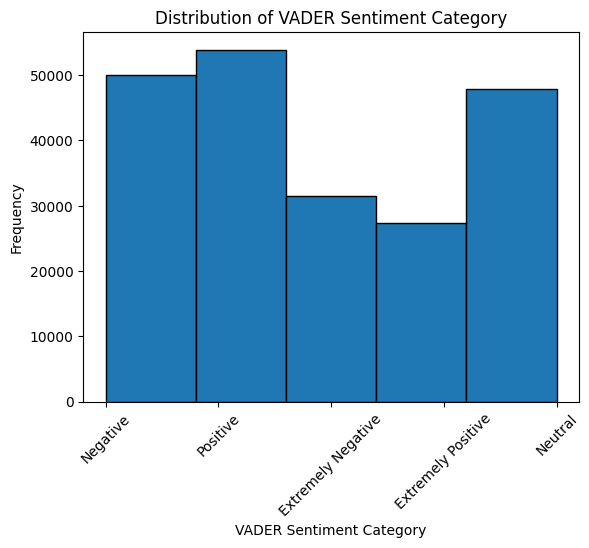

time: 207 ms (started: 2024-07-25 16:22:02 +00:00)


In [ ]:
plt.hist(df_anti['vader_sentiment_category'], bins=5, edgecolor='k')
plt.xlabel('VADER Sentiment Category')
plt.xticks(rotation=45)
plt.ylabel('Frequency')
plt.title('Distribution of VADER Sentiment Category')
#plt.xticks(rotation=45)
plt.show()

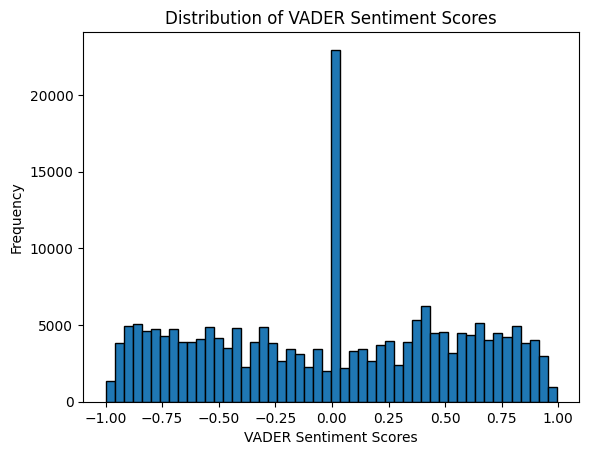

time: 226 ms (started: 2024-07-25 16:27:37 +00:00)


In [ ]:
plt.hist(df_anti['vader_sentiment_score'], bins=50, edgecolor='k')
plt.xlabel('VADER Sentiment Scores')
plt.ylabel('Frequency')
plt.title('Distribution of VADER Sentiment Scores')
plt.show()

In [ ]:
# Read Brexit dataset
df_anti = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_ALL_updated.csv')
pd.set_option('display.max_columns',None)
df_anti.head(5)

,Unnamed: 0.1,Unnamed: 0,Date,Headline,URL,Opening Text,Hit Sentence,Source,Influencer,Country,Subregion,Language,Reach,Desktop Reach,Mobile Reach,Twitter Social Echo,Facebook Social Echo,Reddit Social Echo,National Viewership,Engagement,AVE,Sentiment,Key Phrases,Input Name,Keywords,Twitter Authority,Tweet Id,Twitter Id,Twitter Client,Twitter Screen Name,User Profile Url,Twitter Bio,Twitter Followers,Twitter Following,Alternate Date Format,Time,State,City,Document Tags,cleaned_text,token_count,bert_sentiment_score,bert_sentiment_label,label,vader_sentiment_score,vader_sentiment_category,textblob_sentiment_score,textblob_sentiment_numeric,textblob_sentiment_category
0,0,0,09-Jan-2022 11:58PM,NaN,https://twitter.com/nickynicky77551/statuses/1...,NaN,"RT @cnapan: #JohnsonOut is now running at 218,...",Twitter,@nickynicky77551,Unknown,NaN,English,1697,0,0,NaN,NaN,NaN,0,NaN,15.70,Neutral,"electoral liability,tweets",Adhoc Search Export,Brexit,6.0,'1480328159618732033',1315126719007789057,Twitter for Android,nicky@nicky7755,https://twitter.com/nickynicky77551,"Ardent Remainer; Rejoiner now, Support NHS 💙 #...",1697.0,2576.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt cnapan is now running at 218000 tweets he i...,25,-1.0,Extremely Negative,3,-0.3818,Negative,0.000000,2,Neutral
1,1,1,09-Jan-2022 11:58PM,NaN,https://twitter.com/lines12345/statuses/148032...,NaN,RT @Femi_Sorry: My point: Any Labour leader wh...,Twitter,@lines12345,Unknown,NaN,English,11,0,0,NaN,NaN,NaN,0,NaN,0.10,Negative,"Labour leader,commitment,out the consequences,...",Adhoc Search Export,Brexit,1.0,'1480328147304337409',147229309,Twitter for iPhone,Helen,https://twitter.com/lines12345,Tory hating Remainer,11.0,92.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt femisorry my point any labour leader who re...,55,-1.0,Extremely Negative,2,-0.5423,Negative,-0.350000,1,Negative
2,2,2,09-Jan-2022 11:58PM,NaN,https://twitter.com/millymoo97/statuses/148032...,NaN,RT @andy_murray: QT @Nigel_Farage: Please reco...,Twitter,@millymoo97,Unknown,NaN,English,2129,0,0,NaN,NaN,NaN,0,NaN,19.69,Neutral,"awkward moment,career",Adhoc Search Export,Europe,6.0,'1480328144678699012',19862216,Twitter Web App,seonaid mcgill,https://twitter.com/millymoo97,"Scottish, European, anti-Brexit, pro-EU, freel...",2129.0,3880.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt andymurray qt nigelfarage please record the...,58,-1.0,Extremely Negative,3,0.5423,Positive,-0.066667,2,Neutral
3,3,3,09-Jan-2022 11:58PM,NaN,https://twitter.com/ValueSurplus/statuses/1480...,NaN,RT @mikegalsworthy: We’re the first country in...,Twitter,@valuesurplus,United Kingdom,NaN,English,2420,0,0,NaN,NaN,NaN,0,NaN,22.39,Negative,"Covid deaths,Plus failures,death rates,first c...",Adhoc Search Export,Europe,6.0,'1480328085421629444',1172871351083950081,Twitter Web App,Rightwing politics is a social virus #BLM 🇵🇸🌈,https://twitter.com/ValueSurplus,Classical Cultural Marxist.\nAnti Brexit estab...,2420.0,4952.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt mikegalsworthy were the first country in eu...,70,-1.0,Extremely Negative,3,-0.8720,Extremely Negative,-0.106667,2,Neutral
4,4,4,09-Jan-2022 11:57PM,NaN,https://twitter.com/Jackcdawes/statuses/148032...,NaN,"RT @StevePeers: QT @andy_murray: Game, set and...",Twitter,@jackcdawes,United Kingdom,NaN,English,18304,0,0,NaN,NaN,NaN,0,NaN,169.31,Neutral,NaN,Adhoc Search Export,Europe,8.0,'1480327958631960577',3065680671,Twitter Web App,Jack Dawes #FBPEGlobal #JohnsonOut #RejoinEU,https://twitter.com/Jackcdawes,"Lover of crime & horror fiction, history, & Me...",18304.0,19889.0,"Jan 9, 2022",11:57 PM,England,London,NaN,rt stevepeers qt andymurray game set and match...,41,-1.0,Extremely Negative,3,0.5423,Positive,-0.150000,2,Neutral


time: 14.3 s (started: 2024-07-25 17:58:44 +00:00)


In [ ]:
from nltk.tokenize import word_tokenize

# Ensure 'text_clean' column contains strings
df_anti['vader_cleaned_text'] = df_anti['cleaned_text'].astype(str)

# Tokenize the text
df_anti['vader_cleaned_text'] = df_anti['vader_cleaned_text'].apply(word_tokenize)

# Calculate token counts
df_anti['vader_token_counts'] = df_anti['vader_cleaned_text'].apply(len)

time: 38.1 s (started: 2024-07-25 17:59:23 +00:00)


In [ ]:
df_anti.head(5)

,Unnamed: 0.1,Unnamed: 0,Date,Headline,URL,Opening Text,Hit Sentence,Source,Influencer,Country,Subregion,Language,Reach,Desktop Reach,Mobile Reach,Twitter Social Echo,Facebook Social Echo,Reddit Social Echo,National Viewership,Engagement,AVE,Sentiment,Key Phrases,Input Name,Keywords,Twitter Authority,Tweet Id,Twitter Id,Twitter Client,Twitter Screen Name,User Profile Url,Twitter Bio,Twitter Followers,Twitter Following,Alternate Date Format,Time,State,City,Document Tags,cleaned_text,token_count,bert_sentiment_score,bert_sentiment_label,label,vader_sentiment_score,vader_sentiment_category,textblob_sentiment_score,textblob_sentiment_numeric,textblob_sentiment_category,vader_cleaned_text,vader_token_counts
0,0,0,09-Jan-2022 11:58PM,NaN,https://twitter.com/nickynicky77551/statuses/1...,NaN,"RT @cnapan: #JohnsonOut is now running at 218,...",Twitter,@nickynicky77551,Unknown,NaN,English,1697,0,0,NaN,NaN,NaN,0,NaN,15.70,Neutral,"electoral liability,tweets",Adhoc Search Export,Brexit,6.0,'1480328159618732033',1315126719007789057,Twitter for Android,nicky@nicky7755,https://twitter.com/nickynicky77551,"Ardent Remainer; Rejoiner now, Support NHS 💙 #...",1697.0,2576.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt cnapan is now running at 218000 tweets he i...,25,-1.0,Extremely Negative,3,-0.3818,Negative,0.000000,2,Neutral,"[rt, cnapan, is, now, running, at, 218000, twe...",18
1,1,1,09-Jan-2022 11:58PM,NaN,https://twitter.com/lines12345/statuses/148032...,NaN,RT @Femi_Sorry: My point: Any Labour leader wh...,Twitter,@lines12345,Unknown,NaN,English,11,0,0,NaN,NaN,NaN,0,NaN,0.10,Negative,"Labour leader,commitment,out the consequences,...",Adhoc Search Export,Brexit,1.0,'1480328147304337409',147229309,Twitter for iPhone,Helen,https://twitter.com/lines12345,Tory hating Remainer,11.0,92.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt femisorry my point any labour leader who re...,55,-1.0,Extremely Negative,2,-0.5423,Negative,-0.350000,1,Negative,"[rt, femisorry, my, point, any, labour, leader...",33
2,2,2,09-Jan-2022 11:58PM,NaN,https://twitter.com/millymoo97/statuses/148032...,NaN,RT @andy_murray: QT @Nigel_Farage: Please reco...,Twitter,@millymoo97,Unknown,NaN,English,2129,0,0,NaN,NaN,NaN,0,NaN,19.69,Neutral,"awkward moment,career",Adhoc Search Export,Europe,6.0,'1480328144678699012',19862216,Twitter Web App,seonaid mcgill,https://twitter.com/millymoo97,"Scottish, European, anti-Brexit, pro-EU, freel...",2129.0,3880.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt andymurray qt nigelfarage please record the...,58,-1.0,Extremely Negative,3,0.5423,Positive,-0.066667,2,Neutral,"[rt, andymurray, qt, nigelfarage, please, reco...",37
3,3,3,09-Jan-2022 11:58PM,NaN,https://twitter.com/ValueSurplus/statuses/1480...,NaN,RT @mikegalsworthy: We’re the first country in...,Twitter,@valuesurplus,United Kingdom,NaN,English,2420,0,0,NaN,NaN,NaN,0,NaN,22.39,Negative,"Covid deaths,Plus failures,death rates,first c...",Adhoc Search Export,Europe,6.0,'1480328085421629444',1172871351083950081,Twitter Web App,Rightwing politics is a social virus #BLM 🇵🇸🌈,https://twitter.com/ValueSurplus,Classical Cultural Marxist.\nAnti Brexit estab...,2420.0,4952.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt mikegalsworthy were the first country in eu...,70,-1.0,Extremely Negative,3,-0.8720,Extremely Negative,-0.106667,2,Neutral,"[rt, mikegalsworthy, were, the, first, country...",48
4,4,4,09-Jan-2022 11:57PM,NaN,https://twitter.com/Jackcdawes/statuses/148032...,NaN,"RT @StevePeers: QT @andy_murray: Game, set and...",Twitter,@jackcdawes,United Kingdom,NaN,English,18304,0,0,NaN,NaN,NaN,0,NaN,169.31,Neutral,NaN,Adhoc Search Export,Europe,8.0,'1480327958631960577',3065680671,Twitter Web App,Jack Dawes #FBPEGlobal #JohnsonOut #RejoinEU,https://twitter.com/Jackcdawes,"Lover of crime & horror fiction, history, & Me...",18304.0,19889.0,"Jan 9, 2022",11:57 PM,England,London,NaN,rt stevepeers qt andymurray game set and match...,41,-1.0,Extremely Negative,3,0.5423,Positive,-0.150000,2,Neutral,"[rt, stevepeers, qt, andymur

time: 35 ms (started: 2024-07-25 18:00:29 +00:00)


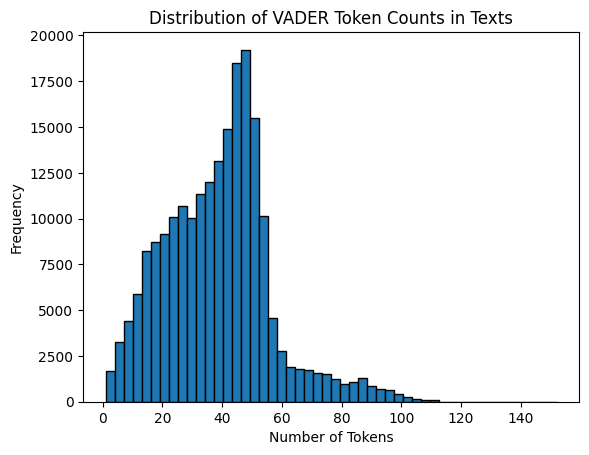

count    210574.000000
mean         38.859232
std          17.867004
min           1.000000
25%          26.000000
50%          40.000000
75%          49.000000
max         152.000000
Name: vader_token_counts, dtype: float64


<Figure size 640x480 with 0 Axes>

time: 11.8 s (started: 2024-07-25 18:00:57 +00:00)


In [ ]:
# Display the DataFrame with token counts
df_anti.head()
# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv'
df_anti.to_csv(output_file_path, index=False)

import matplotlib.pyplot as plt
plt.hist(df_anti['vader_token_counts'], bins=50, edgecolor='k')
plt.xlabel('Number of Tokens')
plt.ylabel('Frequency')
plt.title('Distribution of VADER Token Counts in Texts')
plt.show()
plt.savefig('/content/drive/MyDrive/Colab Notebooks/Brexit_Anti_token_count_VADER_distribution.png')

# Print basic statistics
print(df_anti['vader_token_counts'].describe())


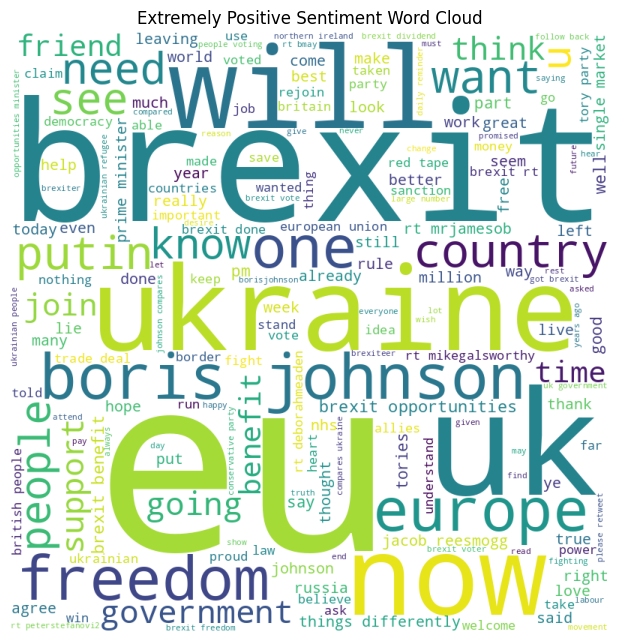

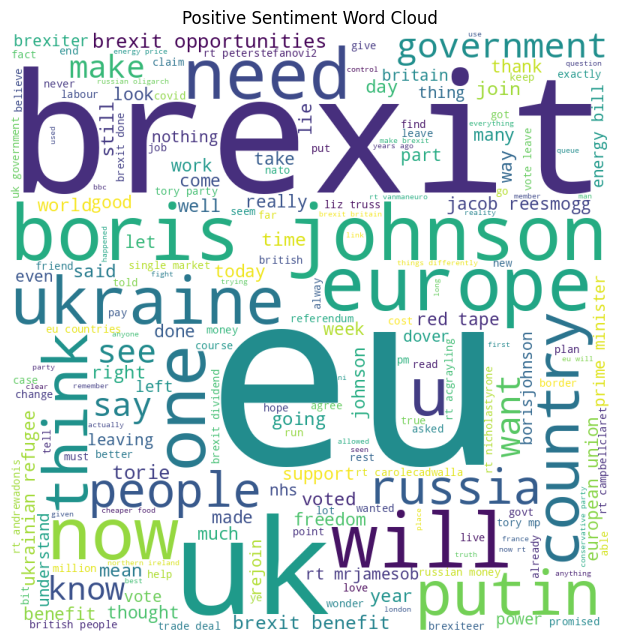

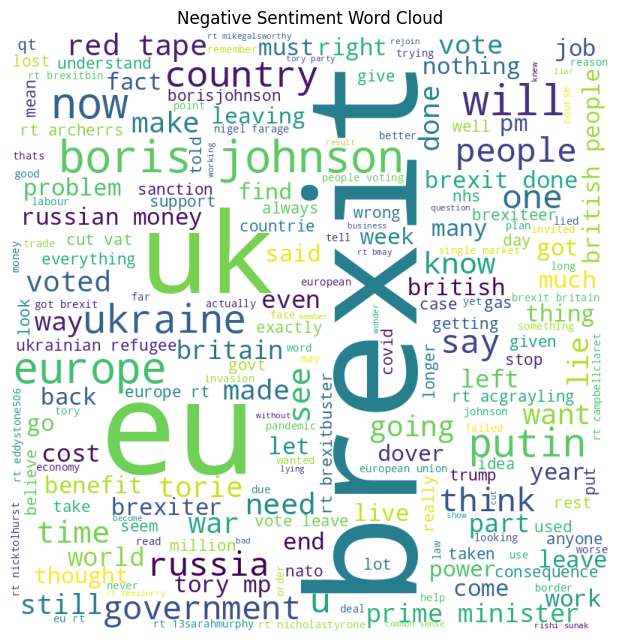

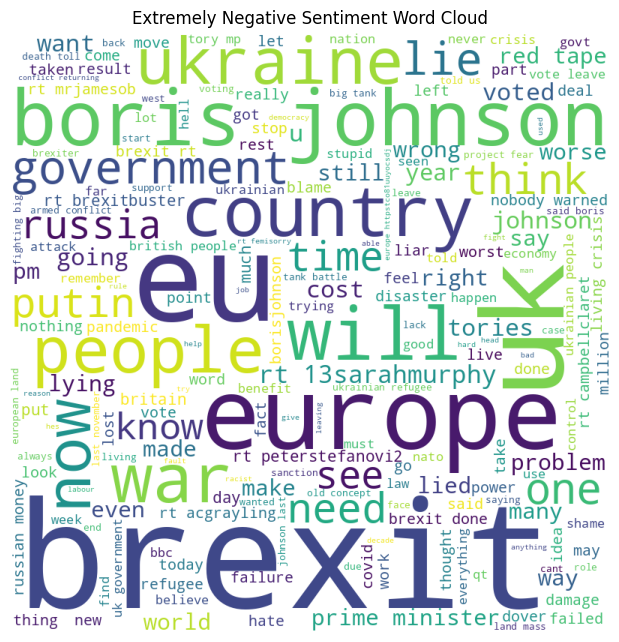

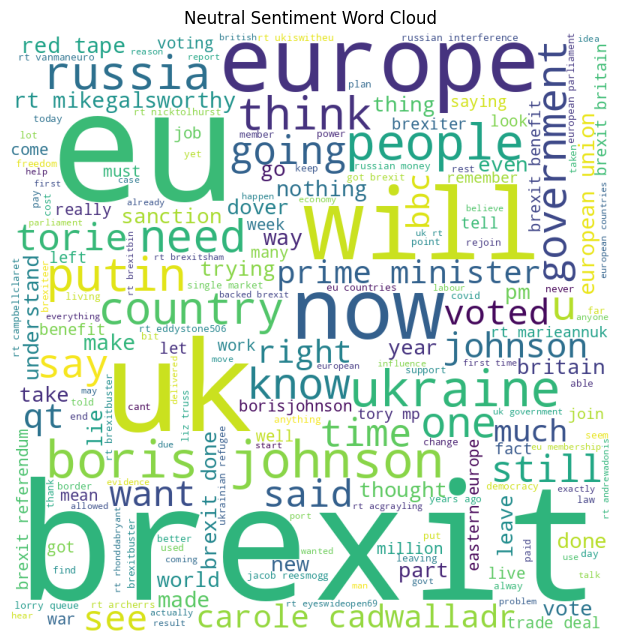

time: 28.7 s (started: 2024-07-25 18:02:31 +00:00)


In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

# Filter the DataFrame for each sentiment label
extremely_positive_df = df_anti[df_anti['vader_sentiment_category'] == 'Extremely Positive']
positive_df = df_anti[df_anti['vader_sentiment_category'] == 'Positive']
negative_df = df_anti[df_anti['vader_sentiment_category'] == 'Negative']
extremely_negative_df = df_anti[df_anti['vader_sentiment_category'] == 'Extremely Negative']
neutral_df = df_anti[df_anti['vader_sentiment_category'] == 'Neutral']

# Combine text for each sentiment
extremely_positive_text = " ".join(str(text) for text in extremely_positive_df['cleaned_text'])
positive_text = " ".join(str(text) for text in positive_df['cleaned_text'])
negative_text = " ".join(str(text) for text in negative_df['cleaned_text'])
extremely_negative_text = " ".join(str(text) for text in extremely_negative_df['cleaned_text'])
neutral_text = " ".join(str(text) for text in neutral_df['cleaned_text'])

# Create WordCloud objects
stopwords = set(STOPWORDS)
wordcloud_ep = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_positive_text)
wordcloud_p = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(positive_text)
wordcloud_n = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(negative_text)
wordcloud_en = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_negative_text)

wordcloud_ne = WordCloud(width = 800, height = 800,
                background_color = 'white',
                stopwords = stopwords,
                min_font_size = 10).generate(neutral_text)

# Plot the WordClouds
plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ep)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_p)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_n)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_en)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ne)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Neutral Sentiment Word Cloud")
plt.show()


In [ ]:
import torch
from transformers import BertTokenizer, BertForSequenceClassification, DistilBertTokenizer, DistilBertForSequenceClassification, Trainer, TrainingArguments
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
from torch.utils.data import DataLoader, Dataset

# Define a custom Dataset class
class TextDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]

        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            padding='max_length',
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )

        return {
            'text': text,
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Prepare the data for BERT and DistilBERT
def prepare_data(df, tokenizer, max_len, batch_size):
    le = LabelEncoder()
    df['label'] = le.fit_transform(df['vader_sentiment_category'])

    train_texts, val_texts, train_labels, val_labels = train_test_split(
        df['cleaned_text'].values,
        df['label'].values,
        test_size=0.1,
        random_state=42
    )

    train_dataset = TextDataset(
        texts=train_texts,
        labels=train_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    val_dataset = TextDataset(
        texts=val_texts,
        labels=val_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size)

    return train_loader, val_loader, val_labels, le

# Define evaluation metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    acc = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    recall = recall_score(labels, preds, average='weighted')
    precision = precision_score(labels, preds, average='weighted')
    return {
        'accuracy': acc,
        'f1': f1,
        'recall': recall,
        'precision': precision
    }


In [ ]:
# Set parameters
MAX_LEN = 128
BATCH_SIZE = 16

# Prepare data for BERT
bert_tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
train_loader, val_loader, val_labels, label_encoder = prepare_data(df_anti, bert_tokenizer, MAX_LEN, BATCH_SIZE)

# Initialize BERT model
bert_model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=5)

# Train BERT model with modified training arguments
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    evaluation_strategy="epoch",
    save_steps=500,
    save_total_limit=1
)

trainer = Trainer(
    model=bert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

# Save df_anti dataset
df_anti.to_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv')

# Print BERT evaluation results
val_accuracy = results['eval_accuracy']
print(f"Validation loss: {results['eval_loss']}")
print(f"Validation accuracy: {val_accuracy}")

# Confusion Matrix for BERT
preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
cm_bert = confusion_matrix(val_labels, preds)

# Compute additional metrics
accuracy = accuracy_score(val_labels, preds)
f1 = f1_score(val_labels, preds, average='weighted')
recall = recall_score(val_labels, preds, average='weighted')
precision = precision_score(val_labels, preds, average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1}")
print(f"Recall: {recall}")
print(f"Precision: {precision}")

# Print confusion matrix
print("Confusion Matrix for BERT:")
print(cm_bert)

# Save df_anti dataset
df_anti.to_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv')


model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.198300,0.202949,0.929480,0.929577,0.929480,0.929950
2,0.103500,0.218168,0.940925,0.940810,0.940925,0.941780
3,0.036400,0.176594,0.960822,0.960804,0.960822,0.960907


Validation loss: 0.17659355700016022
Validation accuracy: 0.9608224902649825
Accuracy: 0.9608224902649825
F1 Score: 0.9608037546034885
Recall: 0.9608224902649825
Precision: 0.9609072330195928
Confusion Matrix for BERT:
[[3137    0   52    5    4]
 [   0 2551    1    3   56]
 [ 126    0 4768  122   14]
 [   0    1  107 4599   93]
 [   1   98   11  131 5178]]


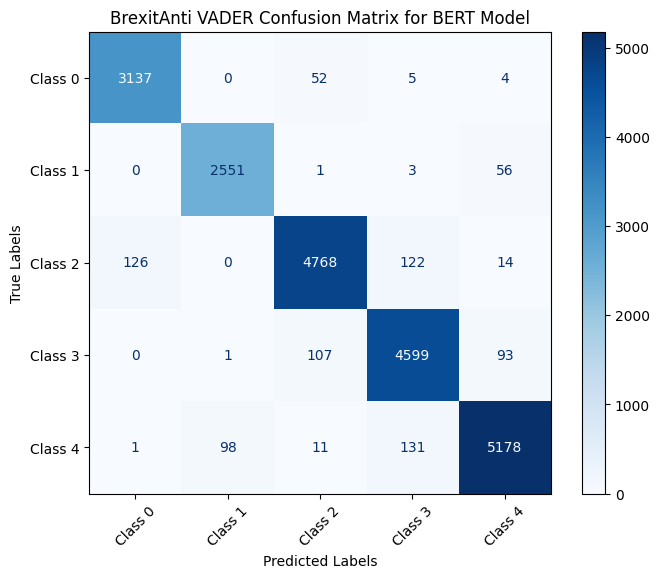

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 3137,0,52,5,4],
 [  0,2551,1,3,56],
 [ 126,0,4768,122,14],
 [ 0,1,107,4599,93],
 [ 1,98,11,131,5178]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('BrexitAnti VADER Confusion Matrix for BERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# 3.4 VADER via DistilBERT Model

In [ ]:
# Prepare data for DistilBERT
distilbert_tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
train_loader, val_loader, val_labels, label_encoder = prepare_data(df_anti, distilbert_tokenizer, MAX_LEN, BATCH_SIZE)

# Initialize DistilBERT model
distilbert_model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=5)

# Train DistilBERT model with modified training arguments
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    evaluation_strategy="epoch",
    save_steps=500,
    save_total_limit=1
)

trainer = Trainer(
    model=distilbert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

# Save df_anti dataset
df_anti.to_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv')

# Print DistilBERT evaluation results
val_accuracy = results['eval_accuracy']
print(f"Validation loss: {results['eval_loss']}")
print(f"Validation accuracy: {val_accuracy}")

# Confusion Matrix for DistilBERT
preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
cm_distilbert = confusion_matrix(val_labels, preds)

# Compute additional metrics
accuracy = accuracy_score(val_labels, preds)
f1 = f1_score(val_labels, preds, average='weighted')
recall = recall_score(val_labels, preds, average='weighted')
precision = precision_score(val_labels, preds, average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1}")
print(f"Recall: {recall}")
print(f"Precision: {precision}")

# Print confusion matrix
print("Confusion Matrix for DistilBERT:")
print(cm_distilbert)

# Save df_anti dataset
df_anti.to_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv')


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.206800,0.213019,0.922120,0.922079,0.922120,0.922422
2,0.144900,0.215949,0.942255,0.942146,0.942255,0.942653
3,0.058800,0.185334,0.957593,0.957554,0.957593,0.957709


Validation loss: 0.18533435463905334
Validation accuracy: 0.9575933137050052
Accuracy: 0.9575933137050052
F1 Score: 0.9575540309041981
Recall: 0.9575933137050052
Precision: 0.9577086364945144
Confusion Matrix for DistilBERT:
[[3135    0   54    5    4]
 [   0 2559    0    2   50]
 [ 142    0 4737  130   21]
 [   2    1  113 4576  108]
 [   3  126    8  124 5158]]


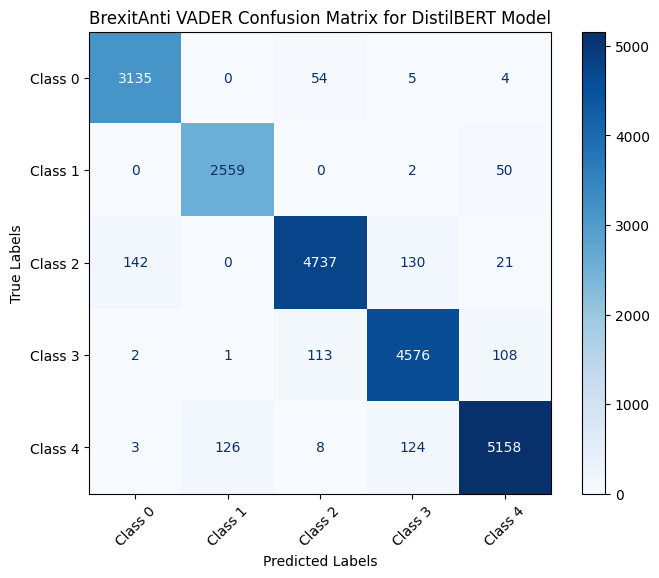

In [13]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 3135,0,54,5,4],
 [ 0,2559,0,2,50],
 [ 142,0,4737,130,21],
 [ 2,1,113,4576,108],
 [ 3,126,8,124,5158]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('BrexitAnti VADER Confusion Matrix for DistilBERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# 3.5 TextBlob Sentimentic Analyzer

# 3.5 TextBlob via BERT Model

In [ ]:
# Load the updated dataset
file_path_anti = '/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv'
df_anti = pd.read_csv(file_path_anti)

# Preprocess the 'clean_text' column
df_anti['cleaned_text'] = df_anti['cleaned_text'].astype(str).fillna('')

# Function to get sentiment score using TextBlob
def get_textblob_sentiment(text):
    return TextBlob(text).sentiment.polarity

# Function to categorize the sentiment score
def categorize_sentiment(score):
    if score >= 0.7:
        return 4, 'Extremely Positive'  # Extremely Positive
    elif score > 0.2:
        return 3, 'Positive'  # Positive
    elif -0.2 <= score <= 0.2:
        return 2, 'Neutral'  # Neutral
    elif score >= -0.7:
        return 1, 'Negative'  # Negative
    else:
        return 0, 'Extremely Negative'  # Extremely Negative

# Apply TextBlob sentiment analysis
df_anti['textblob_sentiment_score'] = df_anti['cleaned_text'].apply(get_textblob_sentiment)

# Apply categorize_sentiment and create two new columns
df_anti[['textblob_sentiment_numeric', 'textblob_sentiment_category']] = df_anti['textblob_sentiment_score'].apply(categorize_sentiment).apply(pd.Series)

# Save dataframe to CSV
df_anti.to_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv', index=False)

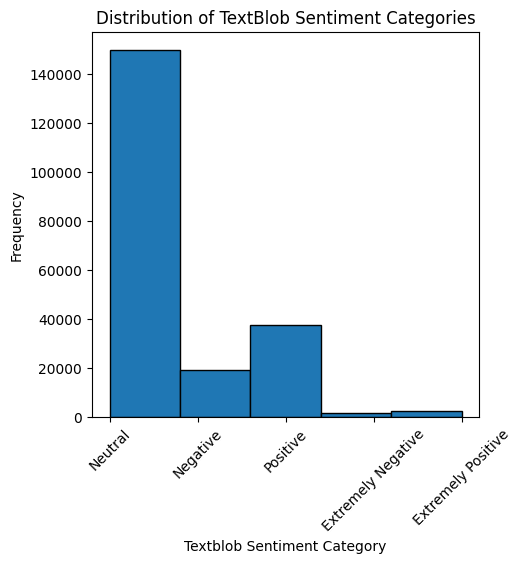

In [ ]:
# Plot the distribution of Textblob sentiment categories
plt.figure(figsize=(5,5))
plt.hist(df_anti['textblob_sentiment_category'], bins=5, edgecolor='k')
plt.xlabel('Textblob Sentiment Category')
plt.ylabel('Frequency')
plt.title('Distribution of TextBlob Sentiment Categories')
plt.xticks(rotation=45)
plt.show()

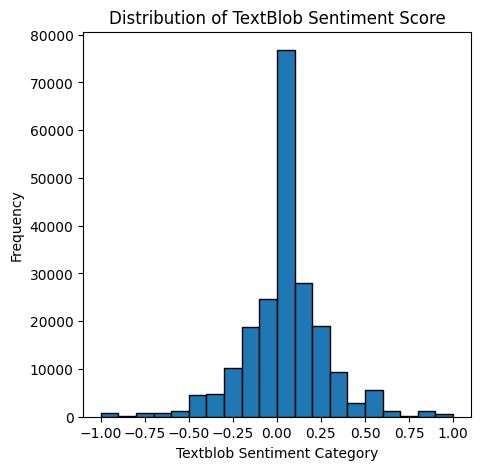

In [ ]:
# Plot the distribution of Textblob sentiment categories
plt.figure(figsize=(5,5))
plt.hist(df_anti['textblob_sentiment_score'], bins=20, edgecolor='k')
plt.xlabel('Textblob Sentiment Category')
plt.ylabel('Frequency')
plt.title('Distribution of TextBlob Sentiment Score')
#plt.xticks(rotation=45)
plt.show()

In [ ]:
# Tokenize 'text_clean' using TextBlob and count tokens
df_anti['textblob_tokenized_text'] = df_anti['cleaned_text'].apply(lambda x: TextBlob(str(x)).words)
df_anti['textblob_token_counts'] = df_anti['textblob_tokenized_text'].apply(len)
df_anti.head(5)

,Unnamed: 0.1,Unnamed: 0,Date,Headline,URL,Opening Text,Hit Sentence,Source,Influencer,Country,Subregion,Language,Reach,Desktop Reach,Mobile Reach,Twitter Social Echo,Facebook Social Echo,Reddit Social Echo,National Viewership,Engagement,AVE,Sentiment,Key Phrases,Input Name,Keywords,Twitter Authority,Tweet Id,Twitter Id,Twitter Client,Twitter Screen Name,User Profile Url,Twitter Bio,Twitter Followers,Twitter Following,Alternate Date Format,Time,State,City,Document Tags,cleaned_text,token_count,bert_sentiment_score,bert_sentiment_label,label,vader_sentiment_score,vader_sentiment_category,textblob_sentiment_score,textblob_sentiment_numeric,textblob_sentiment_category,vader_cleaned_text,vader_token_counts,textblob_tokenized_text,textblob_token_counts
0,0,0,09-Jan-2022 11:58PM,NaN,https://twitter.com/nickynicky77551/statuses/1...,NaN,"RT @cnapan: #JohnsonOut is now running at 218,...",Twitter,@nickynicky77551,Unknown,NaN,English,1697,0,0,NaN,NaN,NaN,0,NaN,15.70,Neutral,"electoral liability,tweets",Adhoc Search Export,Brexit,6.0,'1480328159618732033',1315126719007789057,Twitter for Android,nicky@nicky7755,https://twitter.com/nickynicky77551,"Ardent Remainer; Rejoiner now, Support NHS 💙 #...",1697.0,2576.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt cnapan is now running at 218000 tweets he i...,25,-1.0,Extremely Negative,3,-0.3818,Negative,0.000000,2,Neutral,"[rt, cnapan, is, now, running, at, 218000, twe...",18,"[rt, cnapan, is, now, running, at, 218000, twe...",18
1,1,1,09-Jan-2022 11:58PM,NaN,https://twitter.com/lines12345/statuses/148032...,NaN,RT @Femi_Sorry: My point: Any Labour leader wh...,Twitter,@lines12345,Unknown,NaN,English,11,0,0,NaN,NaN,NaN,0,NaN,0.10,Negative,"Labour leader,commitment,out the consequences,...",Adhoc Search Export,Brexit,1.0,'1480328147304337409',147229309,Twitter for iPhone,Helen,https://twitter.com/lines12345,Tory hating Remainer,11.0,92.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt femisorry my point any labour leader who re...,55,-1.0,Extremely Negative,2,-0.5423,Negative,-0.350000,1,Negative,"[rt, femisorry, my, point, any, labour, leader...",33,"[rt, femisorry, my, point, any, labour, leader...",33
2,2,2,09-Jan-2022 11:58PM,NaN,https://twitter.com/millymoo97/statuses/148032...,NaN,RT @andy_murray: QT @Nigel_Farage: Please reco...,Twitter,@millymoo97,Unknown,NaN,English,2129,0,0,NaN,NaN,NaN,0,NaN,19.69,Neutral,"awkward moment,career",Adhoc Search Export,Europe,6.0,'1480328144678699012',19862216,Twitter Web App,seonaid mcgill,https://twitter.com/millymoo97,"Scottish, European, anti-Brexit, pro-EU, freel...",2129.0,3880.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt andymurray qt nigelfarage please record the...,58,-1.0,Extremely Negative,3,0.5423,Positive,-0.066667,2,Neutral,"[rt, andymurray, qt, nigelfarage, please, reco...",37,"[rt, andymurray, qt, nigelfarage, please, reco...",37
3,3,3,09-Jan-2022 11:58PM,NaN,https://twitter.com/ValueSurplus/statuses/1480...,NaN,RT @mikegalsworthy: We’re the first country in...,Twitter,@valuesurplus,United Kingdom,NaN,English,2420,0,0,NaN,NaN,NaN,0,NaN,22.39,Negative,"Covid deaths,Plus failures,death rates,first c...",Adhoc Search Export,Europe,6.0,'1480328085421629444',1172871351083950081,Twitter Web App,Rightwing politics is a social virus #BLM 🇵🇸🌈,https://twitter.com/ValueSurplus,Classical Cultural Marxist.\nAnti Brexit estab...,2420.0,4952.0,"Jan 9, 2022",11:58 PM,NaN,NaN,NaN,rt mikegalsworthy were the first country in eu...,70,-1.0,Extremely Negative,3,-0.8720,Extremely Negative,-0.106667,2,Neutral,"[rt, mikegalsworthy, were, the, first, country...",48,"[rt, mikegalsworthy, were, the, first, country...",48
4,4,4,09-Jan-2022 11:57PM,NaN,https://twitter.com/Jackcdawes/statuses/148032...,NaN,"RT @StevePeers: QT @andy_murray: Game, set and...",Twitter,@jackcdawes,United Kingdom,NaN,English,18304,0,0,NaN,NaN,NaN,0,NaN,169.31,Neutral,NaN,Adhoc Search Export,Europe,8.0,'1480327958631960577',3065680671,Twitter Web App,Jack Dawes #FBPEGlobal #JohnsonOut #RejoinEU,https://twitter.com

time: 1min 6s (started: 2024-07-25 18:18:59 +00:00)


In [ ]:
# Display the results
print(df_anti[['cleaned_text', 'textblob_token_counts', 'textblob_tokenized_text']].head())

# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/df_anti_updated.csv'
df_anti.to_csv(output_file_path, index=False)

                                        cleaned_text  textblob_token_counts  \
0  rt cnapan is now running at 218000 tweets he i...                     18   
1  rt femisorry my point any labour leader who re...                     33   
2  rt andymurray qt nigelfarage please record the...                     37   
3  rt mikegalsworthy were the first country in eu...                     48   
4  rt stevepeers qt andymurray game set and match...                     31   

                             textblob_tokenized_text  
0  [rt, cnapan, is, now, running, at, 218000, twe...  
1  [rt, femisorry, my, point, any, labour, leader...  
2  [rt, andymurray, qt, nigelfarage, please, reco...  
3  [rt, mikegalsworthy, were, the, first, country...  
4  [rt, stevepeers, qt, andymurray, game, set, an...  
time: 16.4 s (started: 2024-07-25 18:20:35 +00:00)


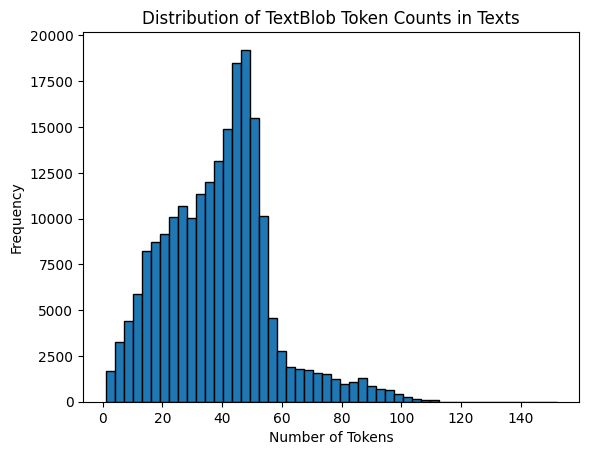

count    210574.000000
mean         38.859232
std          17.867004
min           1.000000
25%          26.000000
50%          40.000000
75%          49.000000
max         152.000000
Name: textblob_token_counts, dtype: float64


<Figure size 640x480 with 0 Axes>

time: 284 ms (started: 2024-07-25 18:20:57 +00:00)


In [ ]:
# Plot the distribution of token counts
import matplotlib.pyplot as plt

plt.hist(df_anti['textblob_token_counts'], bins=50, edgecolor='k')
plt.xlabel('Number of Tokens')
plt.ylabel('Frequency')
plt.title('Distribution of TextBlob Token Counts in Texts')
plt.show()
plt.savefig('/content/drive/MyDrive/DF_ANTI_token_count_TextBlob_distribution.png')

# Print basic statistics
print(df_anti['textblob_token_counts'].describe())


# WordCloud

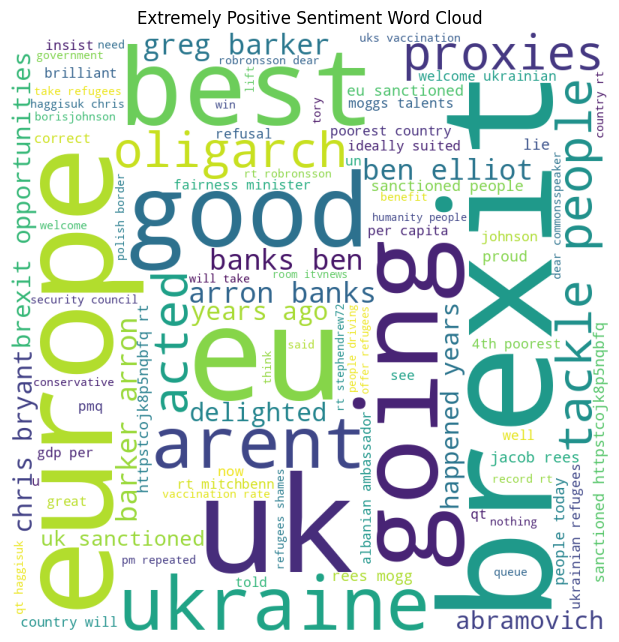

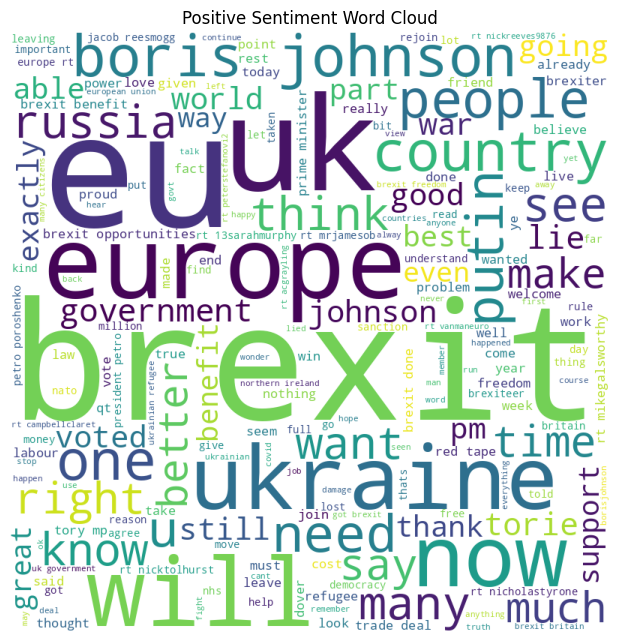

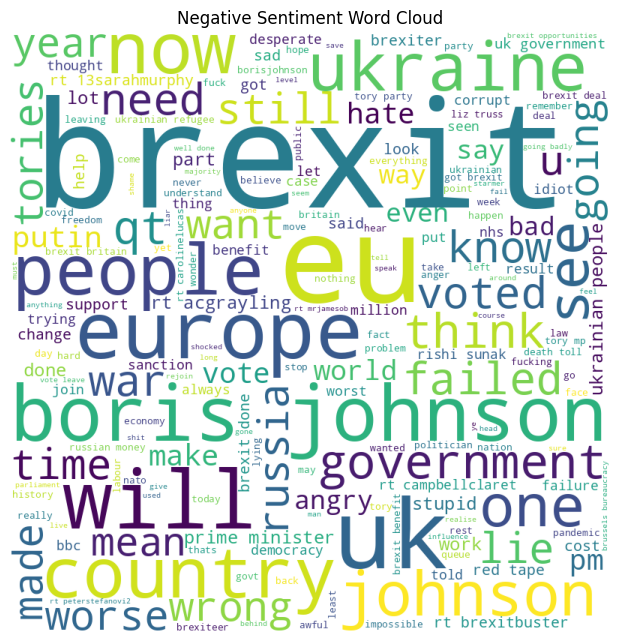

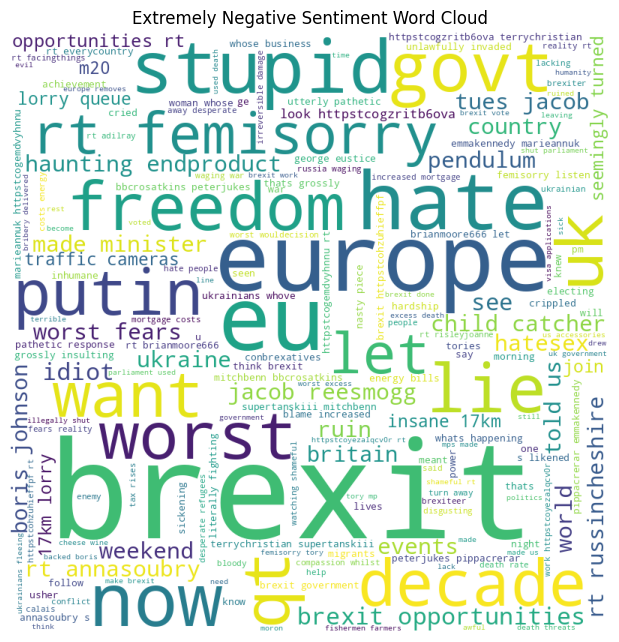

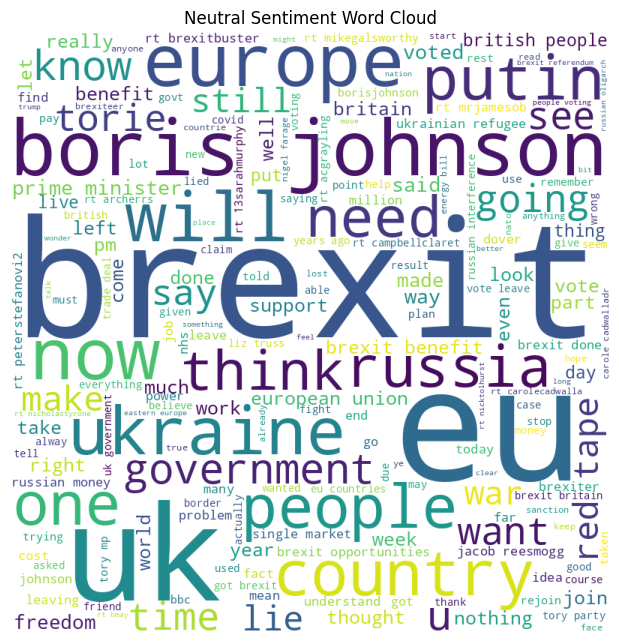

time: 27 s (started: 2024-07-25 18:22:25 +00:00)


In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

# Filter the DataFrame for each sentiment label
extremely_positive_df = df_anti[df_anti['textblob_sentiment_category'] == 'Extremely Positive']
positive_df = df_anti[df_anti['textblob_sentiment_category'] == 'Positive']
negative_df = df_anti[df_anti['textblob_sentiment_category'] == 'Negative']
extremely_negative_df = df_anti[df_anti['textblob_sentiment_category'] == 'Extremely Negative']
neutral_df = df_anti[df_anti['textblob_sentiment_category'] == 'Neutral']

# Combine text for each sentiment
extremely_positive_text = " ".join(extremely_positive_df['cleaned_text'])
positive_text = " ".join(str(text) for text in positive_df['cleaned_text'])
negative_text = " ".join(str(text) for text in negative_df['cleaned_text'])
extremely_negative_text = " ".join(str(text) for text in extremely_negative_df['cleaned_text'])
neutral_text = " ".join(str(text) for text in neutral_df['cleaned_text'])

# Create WordCloud objects
stopwords = set(STOPWORDS)
wordcloud_ep = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_positive_text)
wordcloud_p = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(positive_text)
wordcloud_n = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(negative_text)
wordcloud_en = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_negative_text)

wordcloud_ne = WordCloud(width = 800, height = 800,
                background_color = 'white',
                stopwords = stopwords,
                min_font_size = 10).generate(neutral_text)

# Plot the WordClouds
plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ep)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_p)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_n)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_en)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ne)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Neutral Sentiment Word Cloud")
plt.show()


In [ ]:
import torch
from transformers import BertTokenizer, BertForSequenceClassification, DistilBertTokenizer, DistilBertForSequenceClassification, Trainer, TrainingArguments
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
from torch.utils.data import DataLoader, Dataset

# Define a custom Dataset class
class TextDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]

        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            padding='max_length',
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )

        return {
            'text': text,
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Prepare the data for BERT and DistilBERT
def prepare_data(df, tokenizer, max_len, batch_size):
    le = LabelEncoder()
    df['label'] = le.fit_transform(df['textblob_sentiment_category'])

    train_texts, val_texts, train_labels, val_labels = train_test_split(
        df['cleaned_text'].values,
        df['label'].values,
        test_size=0.1,
        random_state=42
    )

    train_dataset = TextDataset(
        texts=train_texts,
        labels=train_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    val_dataset = TextDataset(
        texts=val_texts,
        labels=val_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size)

    return train_loader, val_loader, val_labels, le

# Define evaluation metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    acc = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    recall = recall_score(labels, preds, average='weighted')
    precision = precision_score(labels, preds, average='weighted')
    return {
        'accuracy': acc,
        'f1': f1,
        'recall': recall,
        'precision': precision
    }


In [ ]:
# Set parameters
MAX_LEN = 128
BATCH_SIZE = 16

# Prepare data for BERT
bert_tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
train_loader, val_loader, val_labels, label_encoder = prepare_data(df_anti, bert_tokenizer, MAX_LEN, BATCH_SIZE)

# Initialize BERT model
bert_model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=5)

# Train BERT model with modified training arguments
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    evaluation_strategy="epoch",
    save_steps=500,
    save_total_limit=1
)

trainer = Trainer(
    model=bert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

# Save df_anti dataset
df_anti.to_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv')

# Print BERT evaluation results
val_accuracy = results['eval_accuracy']
print(f"Validation loss: {results['eval_loss']}")
print(f"Validation accuracy: {val_accuracy}")

# Confusion Matrix for BERT
preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
cm_bert = confusion_matrix(val_labels, preds)

# Compute additional metrics
accuracy = accuracy_score(val_labels, preds)
f1 = f1_score(val_labels, preds, average='weighted')
recall = recall_score(val_labels, preds, average='weighted')
precision = precision_score(val_labels, preds, average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1}")
print(f"Recall: {recall}")
print(f"Precision: {precision}")

# Print confusion matrix
print("Confusion Matrix for BERT:")
print(cm_bert)


# Save df_anti dataset
df_anti.to_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv')

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.271700,0.117107,0.967946,0.967960,0.967946,0.968255
2,0.027000,0.099850,0.976921,0.976935,0.976921,0.977211


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.271700,0.117107,0.967946,0.967960,0.967946,0.968255
2,0.027000,0.099850,0.976921,0.976935,0.976921,0.977211
3,0.000500,0.076573,0.983712,0.983716,0.983712,0.983753


Validation loss: 0.07657252997159958
Validation accuracy: 0.9837116535283502
Accuracy: 0.9837116535283502
F1 Score: 0.9837162787597329
Recall: 0.9837116535283502
Precision: 0.9837530147553051
Confusion Matrix for BERT:
[[  148     0     2     0     0]
 [    0   209     0     3    16]
 [    5     0  1845    53     0]
 [    1     0    80 15007    84]
 [    0     5     3    91  3506]]


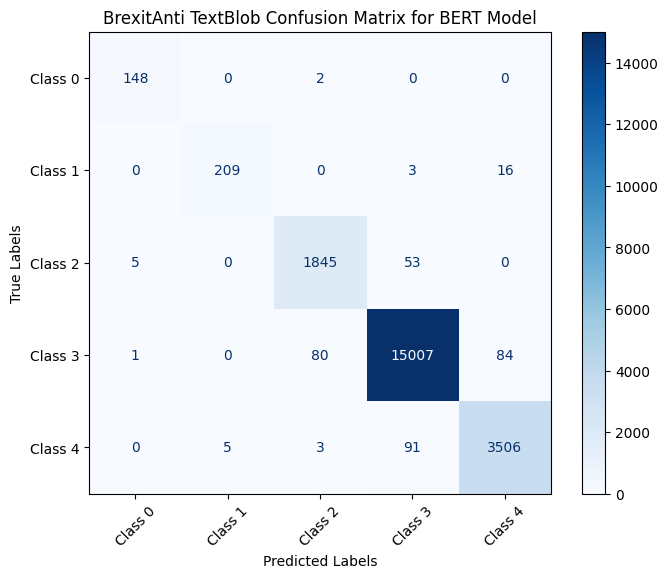

In [14]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 148,0,2,0,0],
 [ 0,209,0,3,16],
 [ 5,0,1845,53,0],
 [ 1,0,80,15007,84],
 [ 0,5,3,91,3506]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('BrexitAnti TextBlob Confusion Matrix for BERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# 3.6 TextBlob via DistilBERT Model

In [ ]:
# Prepare data for DistilBERT
distilbert_tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
train_loader, val_loader, val_labels, label_encoder = prepare_data(df_anti, distilbert_tokenizer, MAX_LEN, BATCH_SIZE)

# Initialize DistilBERT model
distilbert_model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=5)

# Train DistilBERT model with modified training arguments
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    evaluation_strategy="epoch",
    save_steps=500,
    save_total_limit=1
)

trainer = Trainer(
    model=distilbert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

df_anti.to_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv')

# Print DistilBERT evaluation results
val_accuracy = results['eval_accuracy']
print(f"Validation loss: {results['eval_loss']}")
print(f"Validation accuracy: {val_accuracy}")

# Confusion Matrix for DistilBERT
preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
cm_distilbert = confusion_matrix(val_labels, preds)

# Compute additional metrics
accuracy = accuracy_score(val_labels, preds)
f1 = f1_score(val_labels, preds, average='weighted')
recall = recall_score(val_labels, preds, average='weighted')
precision = precision_score(val_labels, preds, average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1}")
print(f"Recall: {recall}")
print(f"Precision: {precision}")

# Print confusion matrix
print("Confusion Matrix for DistilBERT:")
print(cm_distilbert)

# Save dataframe to CSV
df_anti.to_csv('/content/drive/MyDrive/Colab Notebooks/df_anti_updated.csv', index=False)

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


config.json:   0%|          | 0.00/483 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.195300,0.107438,0.966046,0.966245,0.966046,0.966858
2,0.020300,0.085317,0.979105,0.979098,0.979105,0.979174
3,0.029500,0.080029,0.982524,0.982533,0.982524,0.982557


Validation loss: 0.08002899587154388
Validation accuracy: 0.9825244562636528
Accuracy: 0.9825244562636528
F1 Score: 0.9825330398940991
Recall: 0.9825244562636528
Precision: 0.9825565283659765
Confusion Matrix for DistilBERT:
[[  147     0     3     0     0]
 [    0   214     0     3    11]
 [    1     0  1835    67     0]
 [    1     0    74 14989   108]
 [    0     4     2    94  3505]]


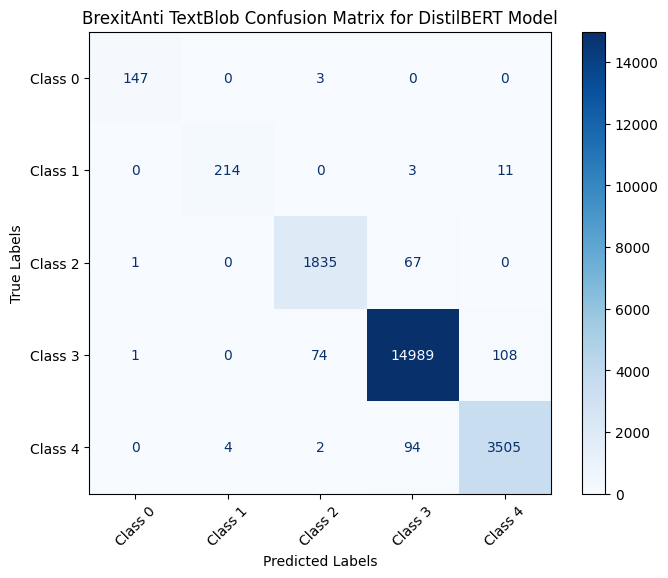

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 147,0,3,0,0],
 [ 0,214,0,3,11],
 [ 1,0,1835,67,0],
 [ 1,0,74,14989,108],
 [ 0,4,2,94,3505]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('BrexitAnti TextBlob Confusion Matrix for DistilBERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# **Dataset 4: Brexit Pro**

In [3]:
df_pro = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/Brexit Polarity Tweets/TweetDataset_ProBrexit_Jan-Mar2022.csv')
pd.set_option('display.max_columns',None)
df_pro.head(5)

,Unnamed: 0,Date,Headline,URL,Opening Text,Hit Sentence,Source,Influencer,Country,Subregion,Language,Reach,Desktop Reach,Mobile Reach,Twitter Social Echo,Facebook Social Echo,Reddit Social Echo,National Viewership,Engagement,AVE,Sentiment,Key Phrases,Input Name,Keywords,Twitter Authority,Tweet Id,Twitter Id,Twitter Client,Twitter Screen Name,User Profile Url,Twitter Bio,Twitter Followers,Twitter Following,Alternate Date Format,Time,State,City,Document Tags
0,0,15-Jan-2022 11:58PM,NaN,https://twitter.com/dianemcgregor8/statuses/14...,NaN,RT @re11ddy: QT @sandieshoes: Do this if you v...,Twitter,@dianemcgregor8,Cameroon,NaN,English,122,0,0,NaN,NaN,NaN,0,NaN,1.13,Neutral,NaN,Adhoc Search Export,Brexit,4.0,'1482502364728893442',2333154780,Twitter for Android,Diane M McGregor,https://twitter.com/dianemcgregor8,Veggie burger! Lover of all Animals and Nature...,122.0,185.0,"Jan 15, 2022",11:58 PM,North,NaN,NaN
1,1,15-Jan-2022 11:57PM,NaN,http://twitter.com/DeniseMembery/statuses/1482...,NaN,RT @RickSacrop: Michael Fabricant is absolutel...,Twitter,@DeniseMembery,United Kingdom,NaN,English,5721,0,0,NaN,NaN,NaN,0,NaN,52.92,Negative,"hell bent,precious EU",Adhoc Search Export,EU,7.0,'1482502266603118599',3678878175,Twitter for Android,Denise M.,http://www.twitter.com/DeniseMembery,"🇬🇧✡️ Proud to be British. 🇬🇧 Animal lover, m...",5721.0,6291.0,"Jan 15, 2022",11:57 PM,England,NaN,NaN
2,2,15-Jan-2022 11:56PM,NaN,https://twitter.com/007Stirling/statuses/14825...,NaN,@StokieDrew2 I do find it rich; that Tory vote...,Twitter,@007stirling,United Kingdom,NaN,English,7219,0,0,NaN,NaN,NaN,0,NaN,66.78,Negative,"Johnson leadership,Tory voters",Adhoc Search Export,"Brexit,EU",7.0,'1482501928479301632',1384540273494069249,Twitter for Android,Finlay Stirling 🇬🇧☘️❤️🏴󠁧󠁢󠁳󠁣󠁴󠁿,https://twitter.com/007Stirling,BRITISH/IRISH/ULSTER-SCOTS PUL\nRIGHT-WING. \n...,7219.0,7433.0,"Jan 15, 2022",11:56 PM,Northern Ireland,Belfast,NaN
3,3,15-Jan-2022 11:54PM,NaN,https://twitter.com/UKleadstheworld/statuses/1...,NaN,RT @denistmurray: Brexit Britain win as London...,Twitter,@ukleadstheworld,United Kingdom,NaN,English,700,0,0,NaN,NaN,NaN,0,NaN,6.48,Positive,best city,Adhoc Search Export,Brexit,5.0,'1482501439624732672',1394212805071577089,Twitter for iPhone,BestofBritish,https://twitter.com/UKleadstheworld,"GB News, Conservatives, Brexiteer, Block all ads.",700.0,1014.0,"Jan 15, 2022",11:54 PM,NaN,NaN,NaN
4,4,15-Jan-2022 11:53PM,NaN,https://twitter.com/paul_beamish/statuses/1482...,NaN,@afneil If Johnson is taken down by The Tories...,Twitter,@paul_beamish,United Kingdom,NaN,English,200,0,0,NaN,NaN,NaN,0,NaN,1.85,Neutral,"credible Brexiteer,droves,likelihood",Adhoc Search Export,"Brexiteers,Brexiteer",4.0,'1482501195767898119',971698786148986880,Twitter for Android,Paul Beamish,https://twitter.com/paul_beamish,Brexiteer and Shipbuilder (Plater/Welder) livi...,200.0,822.0,"Jan 15, 2022",11:53 PM,England,NaN,NaN


In [ ]:
# 147631 rows and 38 columns
df_pro.shape

(147631, 38)

In [ ]:
df_pro['Sentiment'].value_counts()

Sentiment
Neutral      85812
Negative     44829
Positive     14584
Not Rated     2406
Name: count, dtype: int64

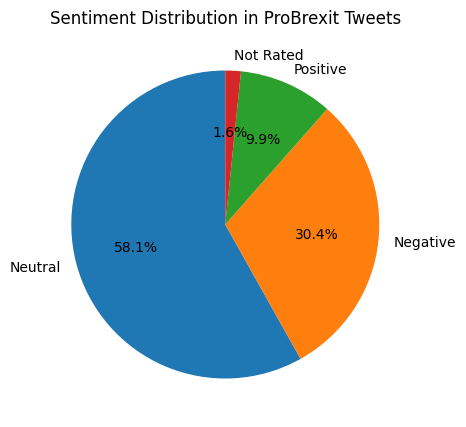

In [ ]:
import matplotlib.pyplot as plt
# Count the occurrences of each sentiment
sentiment_counts = df_pro['Sentiment'].value_counts()

# Create a pie chart
plt.figure(figsize=(5, 5))
plt.pie(sentiment_counts, labels=sentiment_counts.index, autopct='%1.1f%%', startangle=90)
plt.title('Sentiment Distribution in ProBrexit Tweets')
plt.show()


In [ ]:
df_pro.isnull().all()

Unnamed: 0               False
Date                     False
Headline                  True
URL                      False
Opening Text              True
Hit Sentence             False
Source                   False
Influencer               False
Country                  False
Subregion                 True
Language                 False
Reach                    False
Desktop Reach            False
Mobile Reach             False
Twitter Social Echo       True
Facebook Social Echo      True
Reddit Social Echo        True
National Viewership      False
Engagement               False
AVE                      False
Sentiment                False
Key Phrases              False
Input Name               False
Keywords                 False
Twitter Authority        False
Tweet Id                 False
Twitter Id               False
Twitter Client           False
Twitter Screen Name      False
User Profile Url         False
Twitter Bio              False
Twitter Followers        False
Twitter 

In [ ]:
import pandas as pd
import re
import string
import nltk
from nltk.corpus import stopwords
from bs4 import BeautifulSoup
from transformers import BertTokenizer, BertForSequenceClassification, pipeline

nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:
# Function to clean text
def clean_text(text):
    # Remove HTML
    text = BeautifulSoup(text, "html.parser").get_text()
    # Remove contractions
    contractions = {
        "can't": "cannot",
        "won't": "will not",
        "n't": " not",
        "'re": " are",
        "'s": " is",
        "'d": " would",
        "'ll": " will",
        "'t": " not",
        "'ve": " have",
        "'m": " am"
    }
    for contraction, expanded in contractions.items():
        text = re.sub(contraction, expanded, text)
    # Remove hashtags
    text = re.sub(r'#\w+', '', text)
    # Remove emojis
    text = re.sub(r'[^\x00-\x7F]+', '', text)
    # Lowercase
    text = text.lower()
    # Remove punctuation
    text = text.translate(str.maketrans('', '', string.punctuation))
    # Remove extra whitespace
    text = re.sub(r'\s+', ' ', text).strip()
    return text


In [ ]:
# Apply the cleaning function to the 'Hit Sentence' column
df_pro['cleaned_text'] = df_pro['Hit Sentence'].apply(clean_text)

# Ensure the cleaned text is of string type
df_pro['cleaned_text'] = df_pro['cleaned_text'].astype(str)

# Display the first few rows of the cleaned dataset
df_pro[['Hit Sentence', 'cleaned_text']].head()

# Save dataframe to CSV
df_pro.to_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv', index=False)

<ipython-input-42-6efe0af02fb2>:4: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  text = BeautifulSoup(text, "html.parser").get_text()


# Visualise the distribution of token counts

                                        cleaned_text  token_count
0  rt re11ddy qt sandieshoes do this if you value...           69
1  rt ricksacrop michael fabricant is absolutely ...           59
2  stokiedrew2 i do find it rich that tory voters...           78
3  rt denistmurray brexit britain win as london n...           34
4  afneil if johnson is taken down by the tories ...           69


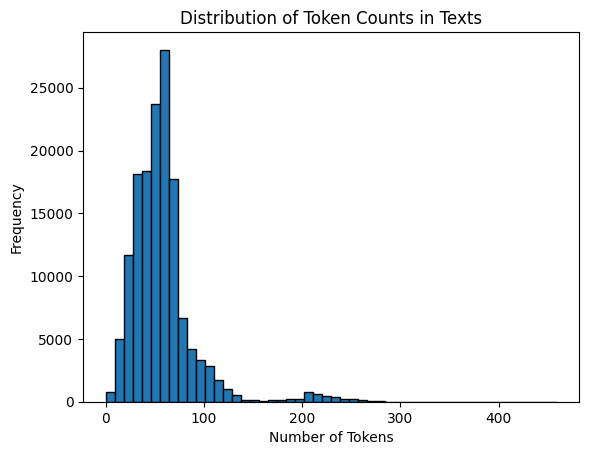

count    147631.000000
mean         57.520866
std          33.998327
min           0.000000
25%          37.000000
50%          54.000000
75%          66.000000
max         459.000000
Name: token_count, dtype: float64


In [ ]:
# Initialize the BERT tokenizer
model_name = "nlptown/bert-base-multilingual-uncased-sentiment"
tokenizer = BertTokenizer.from_pretrained(model_name)

# Tokenize the texts and count the number of tokens
df_pro['token_count'] = df_pro['cleaned_text'].apply(lambda x: len(tokenizer.tokenize(x)))

# Display the first few rows to check the token counts
print(df_pro[['cleaned_text', 'token_count']].head())

# Plot the distribution of token counts
import matplotlib.pyplot as plt
plt.hist(df_pro['token_count'], bins=50, edgecolor='k')
plt.xlabel('Number of Tokens')
plt.ylabel('Frequency')
plt.title('Distribution of Token Counts in Texts')
plt.show()

# Print basic statistics
print(df_pro['token_count'].describe())

# Save dataframe to CSV
df_pro.to_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv', index=False)

# 4.1 BERT Sentiment Pipline

In [ ]:
sentiment_pipeline = pipeline("sentiment-analysis", model=model_name, tokenizer=tokenizer)

pytorch_model.bin:   0%|          | 0.00/669M [00:00<?, ?B/s]

In [ ]:
# Function to calculate sentiment score using BERT with proper truncation
def bert_sentiment(text):
    inputs = tokenizer(text, max_length=256, truncation=True, return_tensors='pt') # pytorch
    tokens = tokenizer.convert_ids_to_tokens(inputs['input_ids'][0])
    truncated_text = tokenizer.convert_tokens_to_string(tokens)
    result = sentiment_pipeline(truncated_text)[0]

    if result['label'] == '1 star':
        score = -1.0
        label = 'Extremely Negative'
    elif result['label'] == '2 stars':
        score = -0.5
        label = 'Negative'
    elif result['label'] == '3 stars':
        score = 0.0
        label = 'Neutral'
    elif result['label'] == '4 stars':
        score = 0.5
        label = 'Positive'
    else:
        score = 1.0
        label = 'Extremely Positive'

    return score, label

In [ ]:
df_pro[['bert_sentiment_score', 'bert_sentiment_label']] = df_pro['cleaned_text'].apply(bert_sentiment).apply(pd.Series)
print(df_pro[['cleaned_text', 'bert_sentiment_score', 'bert_sentiment_label']].head(5))

# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

# Save dataframe to CSV
df_pro.to_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv', index=False)

                                        cleaned_text  bert_sentiment_score  \
0  rt re11ddy qt sandieshoes do this if you value...                  -1.0   
1  rt ricksacrop michael fabricant is absolutely ...                  -1.0   
2  stokiedrew2 i do find it rich that tory voters...                  -0.5   
3  rt denistmurray brexit britain win as london n...                   1.0   
4  afneil if johnson is taken down by the tories ...                  -0.5   

  bert_sentiment_label  
0   Extremely Negative  
1   Extremely Negative  
2             Negative  
3   Extremely Positive  
4             Negative  
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


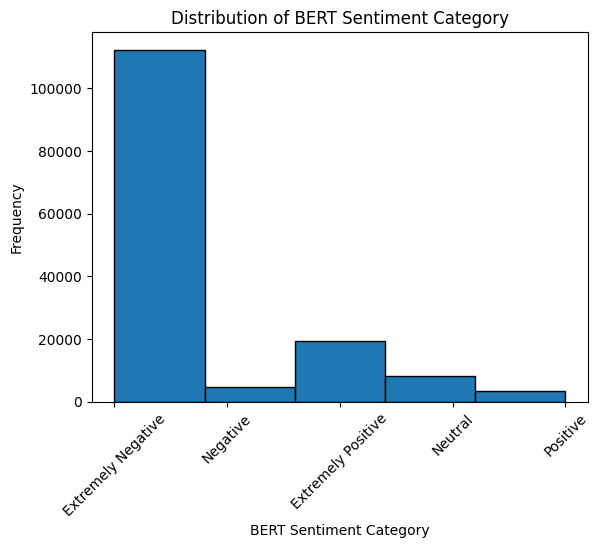

In [ ]:
# Inspect the distribution of sentiment labels
plt.hist(df_pro['bert_sentiment_label'], bins=5, edgecolor='k')
plt.xlabel('BERT Sentiment Category')
plt.ylabel('Frequency')
plt.title('Distribution of BERT Sentiment Category')
plt.xticks(rotation=45)
plt.show()

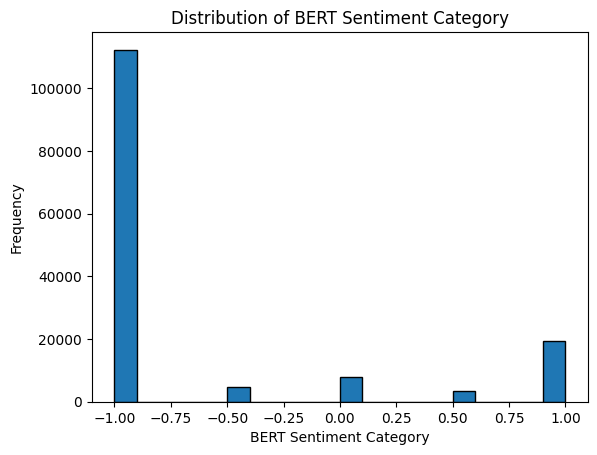

In [ ]:
# The distribution of sentiment scores
plt.hist(df_pro['bert_sentiment_score'], bins=20, edgecolor='k')
plt.xlabel('BERT Sentiment Category')
plt.ylabel('Frequency')
plt.title('Distribution of BERT Sentiment Category')
plt.show()

# Prepare for the data

In [ ]:
# Read Brexit dataset
df_pro = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv')
pd.set_option('display.max_columns',None)
df_pro.head(5)

,Unnamed: 0.1,Unnamed: 0,Date,Headline,URL,Opening Text,Hit Sentence,Source,Influencer,Country,Subregion,Language,Reach,Desktop Reach,Mobile Reach,Twitter Social Echo,Facebook Social Echo,Reddit Social Echo,National Viewership,Engagement,AVE,Sentiment,Key Phrases,Input Name,Keywords,Twitter Authority,Tweet Id,Twitter Id,Twitter Client,Twitter Screen Name,User Profile Url,Twitter Bio,Twitter Followers,Twitter Following,Alternate Date Format,Time,State,City,Document Tags,cleaned_text,token_count,bert_sentiment_score,bert_sentiment_label,label,vader_sentiment_score,vader_sentiment_category,textblob_sentiment_score,textblob_sentiment_numeric,textblob_sentiment_category
0,0,0,15-Jan-2022 11:58PM,NaN,https://twitter.com/dianemcgregor8/statuses/14...,NaN,RT @re11ddy: QT @sandieshoes: Do this if you v...,Twitter,@dianemcgregor8,Cameroon,NaN,English,122,0,0,NaN,NaN,NaN,0,NaN,1.13,Neutral,NaN,Adhoc Search Export,Brexit,4.0,'1482502364728893442',2333154780,Twitter for Android,Diane M McGregor,https://twitter.com/dianemcgregor8,Veggie burger! Lover of all Animals and Nature...,122.0,185.0,"Jan 15, 2022",11:58 PM,North,NaN,NaN,rt re11ddy qt sandieshoes do this if you value...,69,-1.0,Extremely Negative,3,0.8360,Extremely Positive,0.019444,2,Neutral
1,1,1,15-Jan-2022 11:57PM,NaN,http://twitter.com/DeniseMembery/statuses/1482...,NaN,RT @RickSacrop: Michael Fabricant is absolutel...,Twitter,@DeniseMembery,United Kingdom,NaN,English,5721,0,0,NaN,NaN,NaN,0,NaN,52.92,Negative,"hell bent,precious EU",Adhoc Search Export,EU,7.0,'1482502266603118599',3678878175,Twitter for Android,Denise M.,http://www.twitter.com/DeniseMembery,"🇬🇧✡️ Proud to be British. 🇬🇧 Animal lover, m...",5721.0,6291.0,"Jan 15, 2022",11:57 PM,England,NaN,NaN,rt ricksacrop michael fabricant is absolutely ...,59,-1.0,Extremely Negative,4,-0.8442,Extremely Negative,0.225397,3,Positive
2,2,2,15-Jan-2022 11:56PM,NaN,https://twitter.com/007Stirling/statuses/14825...,NaN,@StokieDrew2 I do find it rich; that Tory vote...,Twitter,@007stirling,United Kingdom,NaN,English,7219,0,0,NaN,NaN,NaN,0,NaN,66.78,Negative,"Johnson leadership,Tory voters",Adhoc Search Export,"Brexit,EU",7.0,'1482501928479301632',1384540273494069249,Twitter for Android,Finlay Stirling 🇬🇧☘️❤️🏴󠁧󠁢󠁳󠁣󠁴󠁿,https://twitter.com/007Stirling,BRITISH/IRISH/ULSTER-SCOTS PUL\nRIGHT-WING. \n...,7219.0,7433.0,"Jan 15, 2022",11:56 PM,Northern Ireland,Belfast,NaN,stokiedrew2 i do find it rich that tory voters...,78,-0.5,Negative,4,0.0516,Neutral,0.375000,3,Positive
3,3,3,15-Jan-2022 11:54PM,NaN,https://twitter.com/UKleadstheworld/statuses/1...,NaN,RT @denistmurray: Brexit Britain win as London...,Twitter,@ukleadstheworld,United Kingdom,NaN,English,700,0,0,NaN,NaN,NaN,0,NaN,6.48,Positive,best city,Adhoc Search Export,Brexit,5.0,'1482501439624732672',1394212805071577089,Twitter for iPhone,BestofBritish,https://twitter.com/UKleadstheworld,"GB News, Conservatives, Brexiteer, Block all ads.",700.0,1014.0,"Jan 15, 2022",11:54 PM,NaN,NaN,NaN,rt denistmurray brexit britain win as london n...,34,1.0,Extremely Positive,4,0.9136,Extremely Positive,0.580000,3,Positive
4,4,4,15-Jan-2022 11:53PM,NaN,https://twitter.com/paul_beamish/statuses/1482...,NaN,@afneil If Johnson is taken down by The Tories...,Twitter,@paul_beamish,United Kingdom,NaN,English,200,0,0,NaN,NaN,NaN,0,NaN,1.85,Neutral,"credible Brexiteer,droves,likelihood",Adhoc Search Export,"Brexiteers,Brexiteer",4.0,'1482501195767898119',971698786148986880,Twitter for Android,Paul Beamish,https://twitter.com/paul_beamish,Brexiteer and Shipbuilder (Plater/Welder) livi...,200.0,822.0,"Jan 15, 2022",11:53 PM,England,NaN,NaN,afneil if johnson is taken down by the tories ...,69,-0.5,Negative,3,-0.6808,Negative,0.032222,2,Neutral


In [ ]:
# Encode the labels (convert sentiment scores to categories)
#label_dict = {-1.0: 0, -0.5: 1, 0: 2, 0.5: 3, 1.0: 4}
#df_pro['label'] = df_pro['bert_sentiment_score'].map(label_dict)

# Ensure all labels are within the correct range
#assert df_pro['label'].between(0, 4).all(), "Labels are out of expected range!"

# Print unique labels to verify
#print(df_pro['label'].unique())


[0 1 4 2 3]


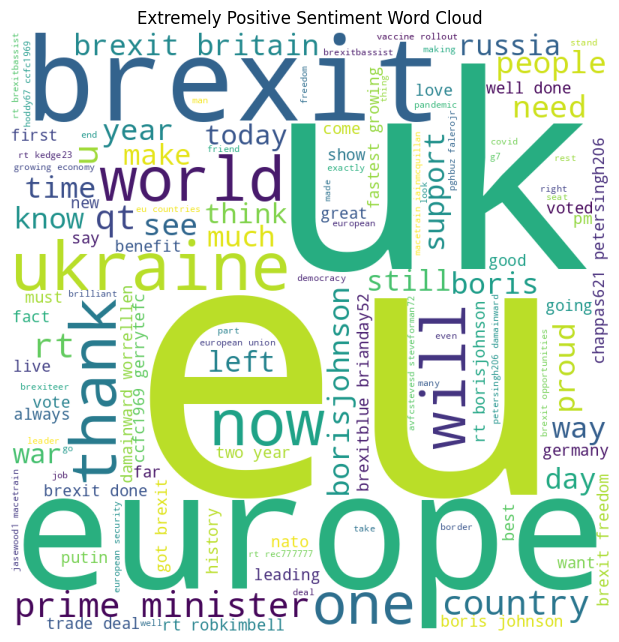

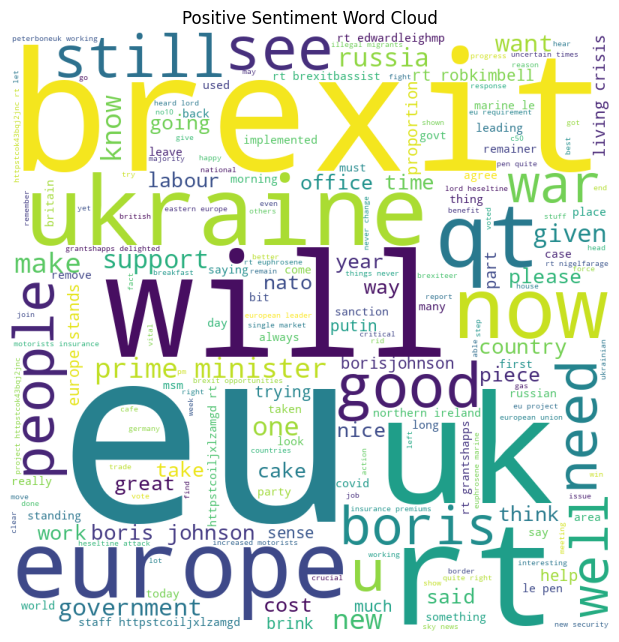

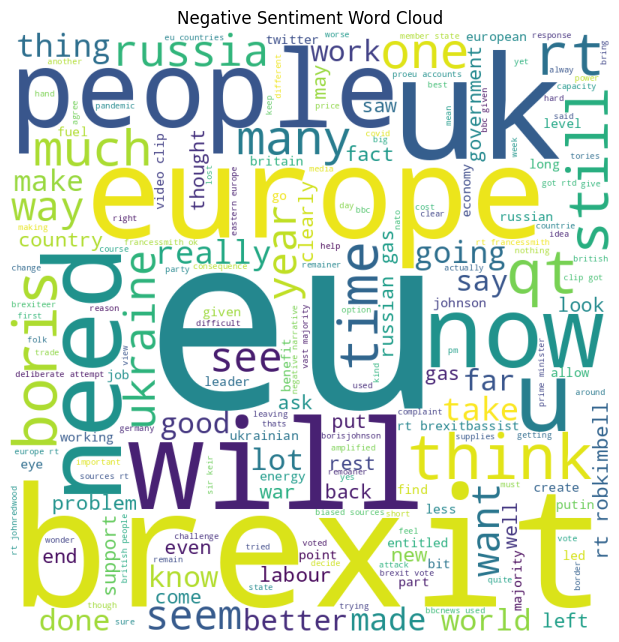

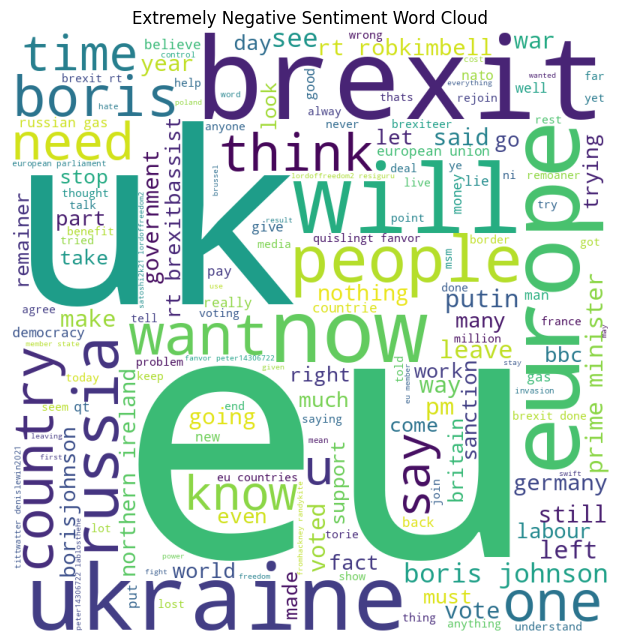

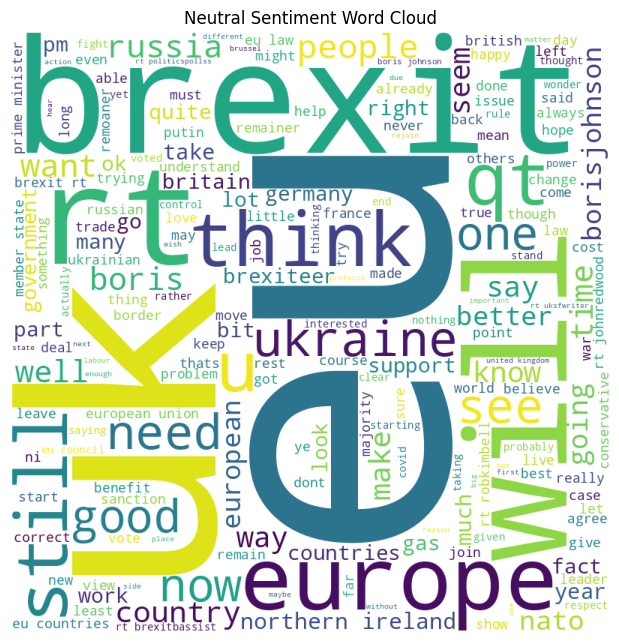

In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

# Filter the DataFrame for each sentiment label
extremely_positive_df = df_pro[df_pro['bert_sentiment_label'] == 'Extremely Positive']
positive_df = df_pro[df_pro['bert_sentiment_label'] == 'Positive']
negative_df = df_pro[df_pro['bert_sentiment_label'] == 'Negative']
extremely_negative_df = df_pro[df_pro['bert_sentiment_label'] == 'Extremely Negative']
neutral_df = df_pro[df_pro['bert_sentiment_label'] == 'Neutral']

# Combine text for each sentiment
extremely_positive_text = " ".join(extremely_positive_df['cleaned_text'])
positive_text = " ".join(str(text) for text in positive_df['cleaned_text']) # Convert each item to string
negative_text = " ".join(negative_df['cleaned_text'])
extremely_negative_text = " ".join(extremely_negative_df['cleaned_text'])
neutral_text = " ".join(str(text) for text in neutral_df['cleaned_text'])

# Create WordCloud objects
stopwords = set(STOPWORDS)
wordcloud_ep = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_positive_text)
wordcloud_p = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(positive_text)
wordcloud_n = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(negative_text)
wordcloud_en = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_negative_text)

wordcloud_ne = WordCloud(width = 800, height = 800,
                background_color = 'white',
                stopwords = stopwords,
                min_font_size = 10).generate(neutral_text)

# Plot the WordClouds
plt.figure(figsize = (6, 8), facecolor = None)
plt.imshow(wordcloud_ep)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 8), facecolor = None)
plt.imshow(wordcloud_p)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 8), facecolor = None)
plt.imshow(wordcloud_n)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 8), facecolor = None)
plt.imshow(wordcloud_en)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 8), facecolor = None)
plt.imshow(wordcloud_ne)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Neutral Sentiment Word Cloud")
plt.show()


# (NEW)Tokenise the text

In [31]:
# Read Brexit dataset
df_pro = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv')
pd.set_option('display.max_columns',None)
df_pro.head(5)

,Unnamed: 0.1,Unnamed: 0,Date,Headline,URL,Opening Text,Hit Sentence,Source,Influencer,Country,Subregion,Language,Reach,Desktop Reach,Mobile Reach,Twitter Social Echo,Facebook Social Echo,Reddit Social Echo,National Viewership,Engagement,AVE,Sentiment,Key Phrases,Input Name,Keywords,Twitter Authority,Tweet Id,Twitter Id,Twitter Client,Twitter Screen Name,User Profile Url,Twitter Bio,Twitter Followers,Twitter Following,Alternate Date Format,Time,State,City,Document Tags,cleaned_text,token_count,bert_sentiment_score,bert_sentiment_label,label,vader_sentiment_score,vader_sentiment_category,textblob_sentiment_score,textblob_sentiment_numeric,textblob_sentiment_category,vader_cleaned_text,vader_token_counts
0,0,0,15-Jan-2022 11:58PM,NaN,https://twitter.com/dianemcgregor8/statuses/14...,NaN,RT @re11ddy: QT @sandieshoes: Do this if you v...,Twitter,@dianemcgregor8,Cameroon,NaN,English,122,0,0,NaN,NaN,NaN,0,NaN,1.13,Neutral,NaN,Adhoc Search Export,Brexit,4.0,'1482502364728893442',2333154780,Twitter for Android,Diane M McGregor,https://twitter.com/dianemcgregor8,Veggie burger! Lover of all Animals and Nature...,122.0,185.0,"Jan 15, 2022",11:58 PM,North,NaN,NaN,rt re11ddy qt sandieshoes do this if you value...,69,-1.0,Extremely Negative,3,0.8360,Extremely Positive,0.019444,2,Neutral,"['rt', 're11ddy', 'qt', 'sandieshoes', 'do', '...",58
1,1,1,15-Jan-2022 11:57PM,NaN,http://twitter.com/DeniseMembery/statuses/1482...,NaN,RT @RickSacrop: Michael Fabricant is absolutel...,Twitter,@DeniseMembery,United Kingdom,NaN,English,5721,0,0,NaN,NaN,NaN,0,NaN,52.92,Negative,"hell bent,precious EU",Adhoc Search Export,EU,7.0,'1482502266603118599',3678878175,Twitter for Android,Denise M.,http://www.twitter.com/DeniseMembery,"🇬🇧✡️ Proud to be British. 🇬🇧 Animal lover, m...",5721.0,6291.0,"Jan 15, 2022",11:57 PM,England,NaN,NaN,rt ricksacrop michael fabricant is absolutely ...,59,-1.0,Extremely Negative,4,-0.8442,Extremely Negative,0.225397,3,Positive,"['rt', 'ricksacrop', 'michael', 'fabricant', '...",52
2,2,2,15-Jan-2022 11:56PM,NaN,https://twitter.com/007Stirling/statuses/14825...,NaN,@StokieDrew2 I do find it rich; that Tory vote...,Twitter,@007stirling,United Kingdom,NaN,English,7219,0,0,NaN,NaN,NaN,0,NaN,66.78,Negative,"Johnson leadership,Tory voters",Adhoc Search Export,"Brexit,EU",7.0,'1482501928479301632',1384540273494069249,Twitter for Android,Finlay Stirling 🇬🇧☘️❤️🏴󠁧󠁢󠁳󠁣󠁴󠁿,https://twitter.com/007Stirling,BRITISH/IRISH/ULSTER-SCOTS PUL\nRIGHT-WING. \n...,7219.0,7433.0,"Jan 15, 2022",11:56 PM,Northern Ireland,Belfast,NaN,stokiedrew2 i do find it rich that tory voters...,78,-0.5,Negative,4,0.0516,Neutral,0.375000,3,Positive,"['stokiedrew2', 'i', 'do', 'find', 'it', 'rich...",51
3,3,3,15-Jan-2022 11:54PM,NaN,https://twitter.com/UKleadstheworld/statuses/1...,NaN,RT @denistmurray: Brexit Britain win as London...,Twitter,@ukleadstheworld,United Kingdom,NaN,English,700,0,0,NaN,NaN,NaN,0,NaN,6.48,Positive,best city,Adhoc Search Export,Brexit,5.0,'1482501439624732672',1394212805071577089,Twitter for iPhone,BestofBritish,https://twitter.com/UKleadstheworld,"GB News, Conservatives, Brexiteer, Block all ads.",700.0,1014.0,"Jan 15, 2022",11:54 PM,NaN,NaN,NaN,rt denistmurray brexit britain win as london n...,34,1.0,Extremely Positive,4,0.9136,Extremely Positive,0.580000,3,Positive,"['rt', 'denistmurray', 'brexit', 'britain', 'w...",21
4,4,4,15-Jan-2022 11:53PM,NaN,https://twitter.com/paul_beamish/statuses/1482...,NaN,@afneil If Johnson is taken down by The Tories...,Twitter,@paul_beamish,United Kingdom,NaN,English,200,0,0,NaN,NaN,NaN,0,NaN,1.85,Neutral,"credible Brexiteer,droves,likelihood",Adhoc Search Export,"Brexiteers,Brexiteer",4.0,'1482501195767898119',971698786148986880,Twitter for Android,Paul Beamish,https://twitter.com/paul_beamish,Brexiteer and Shipbuilder (Plater/Welder) livi...,200.0,822.0,"Jan 15, 2022",11:53 PM,England,NaN,NaN,afneil if johnson is taken down by the tories ...,69,-0.5,Negative,3,-0.6808,Negative,0.032222,2,Neutral,"['afneil', 'if'

In [32]:
# Check for NaN values and handle them
df_pro = df_pro.dropna(subset=['cleaned_text'])  # Remove rows with NaN in 'cleaned_text'

# Ensure all text is string type
df_pro['cleaned_text'] = df_pro['cleaned_text'].astype(str)

<ipython-input-32-0035b46a51fa>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_pro['cleaned_text'] = df_pro['cleaned_text'].astype(str)


In [33]:
# Assume df_anti is already loaded and cleaned
# Encode the labels (convert sentiment scores to categories)
label_dict = {-1.0: 0, -0.5: 1, 0: 2, 0.5: 3, 1.0: 4}
df_pro['label'] = df_pro['bert_sentiment_score'].map(label_dict)

# Split data into training and validation sets
train_texts, val_texts, train_labels, val_labels = train_test_split(
    df_pro['cleaned_text'], df_pro['label'], test_size=0.2, random_state=42)

In [34]:
from torch.utils.data import Dataset, DataLoader
from transformers import BertTokenizer

# Initialize BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

In [35]:
# Define a custom dataset class for BERT
class SentimentDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]
        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            padding='max_length',
            truncation=True,
            return_attention_mask=True,
            return_tensors='pt',
        )
        return {
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Create datasets and dataloaders
train_dataset = SentimentDataset(train_texts.values, train_labels.values, tokenizer, max_len=256)
val_dataset = SentimentDataset(val_texts.values, val_labels.values, tokenizer, max_len=256)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# Load a pre-trained BERT model for sequence classification
model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=5)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


BertForSequenceClassification(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSdpaSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e

In [36]:
# Define optimizer and loss function
optimizer = AdamW(model.parameters(), lr=2e-5)
loss_fn = CrossEntropyLoss().to(device)

# Set up learning rate scheduler
total_steps = len(train_loader) * 3  # Assuming 3 epochs
scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=0, num_training_steps=total_steps)

# Parameters for early stopping
patience = 2  # Number of epochs to wait for improvement
best_val_loss = float('inf')
epochs_without_improvement = 0

# Training loop
epochs = 3
for epoch in range(epochs):
    model.train()
    total_loss = 0
    train_labels = []
    train_preds = []

    for batch in train_loader:
        optimizer.zero_grad()

        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['label'].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        total_loss += loss.item()

        # Collect predictions for training metrics
        logits = outputs.logits
        preds = torch.argmax(logits, dim=1).flatten()

        train_labels.extend(labels.cpu().numpy())
        train_preds.extend(preds.cpu().numpy())

        loss.backward()
        optimizer.step()
        scheduler.step()

    avg_train_loss = total_loss / len(train_loader)

    # Convert to numpy arrays
    train_labels = np.array(train_labels)
    train_preds = np.array(train_preds)

    # Ensure train_labels and train_preds are valid
    if len(train_labels) > 0 and len(train_preds) > 0 and not np.any(np.isnan(train_labels)) and not np.any(np.isnan(train_preds)):
        train_accuracy = accuracy_score(train_labels, train_preds)
        train_f1 = f1_score(train_labels, train_preds, average='weighted', zero_division=0)
        train_recall = recall_score(train_labels, train_preds, average='weighted', zero_division=0)
        train_precision = precision_score(train_labels, train_preds, average='weighted', zero_division=0)

        print(f"Epoch {epoch+1}/{epochs} - Training loss: {avg_train_loss}")
        print(f"Training Accuracy: {train_accuracy}")
        print(f"Training F1 Score: {train_f1}")
        print(f"Training Recall: {train_recall}")
        print(f"Training Precision: {train_precision}")
    else:
        print("Invalid training predictions or labels. Skipping training metrics calculation.")

    # Validation
    model.eval()
    val_loss = 0
    val_labels = []
    val_preds = []

    with torch.no_grad():
        for batch in val_loader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['label'].to(device)

            outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
            loss = outputs.loss
            val_loss += loss.item()

            logits = outputs.logits
            preds = torch.argmax(logits, dim=1).flatten()

            val_labels.extend(labels.cpu().numpy())
            val_preds.extend(preds.cpu().numpy())

    avg_val_loss = val_loss / len(val_loader)

    # Convert to numpy arrays
    val_labels = np.array(val_labels)
    val_preds = np.array(val_preds)

    # Ensure val_labels and val_preds are valid
    if len(val_labels) > 0 and len(val_preds) > 0 and not np.any(np.isnan(val_labels)) and not np.any(np.isnan(val_preds)):
        val_accuracy = accuracy_score(val_labels, val_preds)
        val_f1 = f1_score(val_labels, val_preds, average='weighted', zero_division=0)
        val_recall = recall_score(val_labels, val_preds, average='weighted', zero_division=0)
        val_precision = precision_score(val_labels, val_preds, average='weighted', zero_division=0)

        print(f"Epoch {epoch+1}/{epochs} - Validation loss: {avg_val_loss}")
        print(f"Validation Accuracy: {val_accuracy}")
        print(f"Validation F1 Score: {val_f1}")
        print(f"Validation Recall: {val_recall}")
        print(f"Validation Precision: {val_precision}")

        # Print the confusion matrix
        cm = confusion_matrix(val_labels, val_preds)
        print(f"Confusion Matrix:\n{cm}")
    else:
        print("Invalid validation predictions or labels. Skipping validation metrics calculation.")

    # Early stopping check
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        epochs_without_improvement = 0
        print("Validation loss improved. Saving model...")
        # Save the best model (optional)
        # torch.save(model.state_dict(), 'best_model.pt')
    else:
        epochs_without_improvement += 1
        print(f"No improvement for {epochs_without_improvement} epoch(s).")

    if epochs_without_improvement >= patience:
        print("Early stopping triggered.")
        break

/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:591: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Epoch 1/3 - Training loss: 0.3154643951830424
Training Accuracy: 0.8904092190714884
Training F1 Score: 0.884161039467261
Training Recall: 0.8904092190714884
Training Precision: 0.8823527343786556
Epoch 1/3 - Validation loss: 0.22733038275291736
Validation Accuracy: 0.918546365914787
Validation F1 Score: 0.9137684736195038
Validation Recall: 0.918546365914787
Validation Precision: 0.9139678745923026
Confusion Matrix:
[[22098    43    78    18   224]
 [  369   521    75     5    11]
 [  459    68   970    50    38]
 [  125     4    87   405    80]
 [  572     1    34    64  3127]]
Validation loss improved. Saving model...
Epoch 2/3 - Training loss: 0.13059254970950926
Training Accuracy: 0.9529647849758262
Training F1 Score: 0.9524043962960155
Training Recall: 0.9529647849758262
Training Precision: 0.9520187683992966
Epoch 2/3 - Validation loss: 0.235312950007508
Validation Accuracy: 0.9207478154846576
Validation F1 Score: 0.9210221778491365
Validation Recall: 0.9207478154846576
Validatio

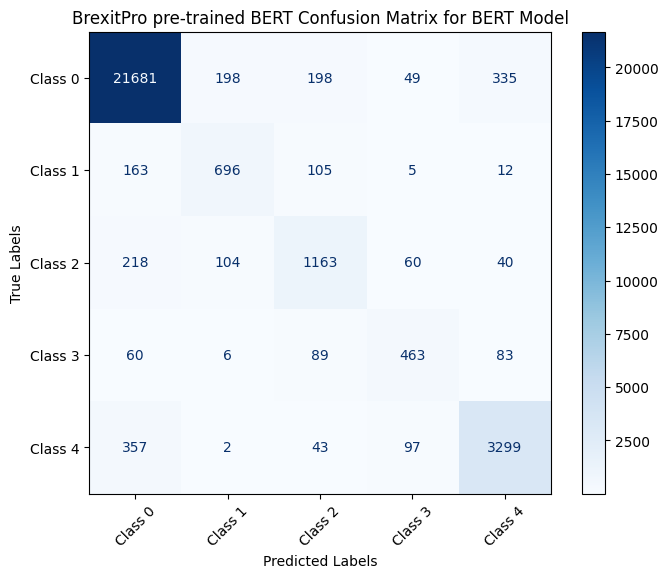

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 21681,198,198,49,335],
 [ 163,696,105,5,12],
 [ 218,104,1163,60,40],
 [  60,6,89,463,83],
 [ 357,2,43,97,3299]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('BrexitPro pre-trained BERT Confusion Matrix for BERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

In [4]:
# Read Brexit dataset
df_pro = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv')
pd.set_option('display.max_columns',None)
df_pro.head(5)

,Unnamed: 0.1,Unnamed: 0,Date,Headline,URL,Opening Text,Hit Sentence,Source,Influencer,Country,Subregion,Language,Reach,Desktop Reach,Mobile Reach,Twitter Social Echo,Facebook Social Echo,Reddit Social Echo,National Viewership,Engagement,AVE,Sentiment,Key Phrases,Input Name,Keywords,Twitter Authority,Tweet Id,Twitter Id,Twitter Client,Twitter Screen Name,User Profile Url,Twitter Bio,Twitter Followers,Twitter Following,Alternate Date Format,Time,State,City,Document Tags,cleaned_text,token_count,bert_sentiment_score,bert_sentiment_label,label,vader_sentiment_score,vader_sentiment_category,textblob_sentiment_score,textblob_sentiment_numeric,textblob_sentiment_category,vader_cleaned_text,vader_token_counts
0,0,0,15-Jan-2022 11:58PM,NaN,https://twitter.com/dianemcgregor8/statuses/14...,NaN,RT @re11ddy: QT @sandieshoes: Do this if you v...,Twitter,@dianemcgregor8,Cameroon,NaN,English,122,0,0,NaN,NaN,NaN,0,NaN,1.13,Neutral,NaN,Adhoc Search Export,Brexit,4.0,'1482502364728893442',2333154780,Twitter for Android,Diane M McGregor,https://twitter.com/dianemcgregor8,Veggie burger! Lover of all Animals and Nature...,122.0,185.0,"Jan 15, 2022",11:58 PM,North,NaN,NaN,rt re11ddy qt sandieshoes do this if you value...,69,-1.0,Extremely Negative,3,0.8360,Extremely Positive,0.019444,2,Neutral,"['rt', 're11ddy', 'qt', 'sandieshoes', 'do', '...",58
1,1,1,15-Jan-2022 11:57PM,NaN,http://twitter.com/DeniseMembery/statuses/1482...,NaN,RT @RickSacrop: Michael Fabricant is absolutel...,Twitter,@DeniseMembery,United Kingdom,NaN,English,5721,0,0,NaN,NaN,NaN,0,NaN,52.92,Negative,"hell bent,precious EU",Adhoc Search Export,EU,7.0,'1482502266603118599',3678878175,Twitter for Android,Denise M.,http://www.twitter.com/DeniseMembery,"🇬🇧✡️ Proud to be British. 🇬🇧 Animal lover, m...",5721.0,6291.0,"Jan 15, 2022",11:57 PM,England,NaN,NaN,rt ricksacrop michael fabricant is absolutely ...,59,-1.0,Extremely Negative,4,-0.8442,Extremely Negative,0.225397,3,Positive,"['rt', 'ricksacrop', 'michael', 'fabricant', '...",52
2,2,2,15-Jan-2022 11:56PM,NaN,https://twitter.com/007Stirling/statuses/14825...,NaN,@StokieDrew2 I do find it rich; that Tory vote...,Twitter,@007stirling,United Kingdom,NaN,English,7219,0,0,NaN,NaN,NaN,0,NaN,66.78,Negative,"Johnson leadership,Tory voters",Adhoc Search Export,"Brexit,EU",7.0,'1482501928479301632',1384540273494069249,Twitter for Android,Finlay Stirling 🇬🇧☘️❤️🏴󠁧󠁢󠁳󠁣󠁴󠁿,https://twitter.com/007Stirling,BRITISH/IRISH/ULSTER-SCOTS PUL\nRIGHT-WING. \n...,7219.0,7433.0,"Jan 15, 2022",11:56 PM,Northern Ireland,Belfast,NaN,stokiedrew2 i do find it rich that tory voters...,78,-0.5,Negative,4,0.0516,Neutral,0.375000,3,Positive,"['stokiedrew2', 'i', 'do', 'find', 'it', 'rich...",51
3,3,3,15-Jan-2022 11:54PM,NaN,https://twitter.com/UKleadstheworld/statuses/1...,NaN,RT @denistmurray: Brexit Britain win as London...,Twitter,@ukleadstheworld,United Kingdom,NaN,English,700,0,0,NaN,NaN,NaN,0,NaN,6.48,Positive,best city,Adhoc Search Export,Brexit,5.0,'1482501439624732672',1394212805071577089,Twitter for iPhone,BestofBritish,https://twitter.com/UKleadstheworld,"GB News, Conservatives, Brexiteer, Block all ads.",700.0,1014.0,"Jan 15, 2022",11:54 PM,NaN,NaN,NaN,rt denistmurray brexit britain win as london n...,34,1.0,Extremely Positive,4,0.9136,Extremely Positive,0.580000,3,Positive,"['rt', 'denistmurray', 'brexit', 'britain', 'w...",21
4,4,4,15-Jan-2022 11:53PM,NaN,https://twitter.com/paul_beamish/statuses/1482...,NaN,@afneil If Johnson is taken down by The Tories...,Twitter,@paul_beamish,United Kingdom,NaN,English,200,0,0,NaN,NaN,NaN,0,NaN,1.85,Neutral,"credible Brexiteer,droves,likelihood",Adhoc Search Export,"Brexiteers,Brexiteer",4.0,'1482501195767898119',971698786148986880,Twitter for Android,Paul Beamish,https://twitter.com/paul_beamish,Brexiteer and Shipbuilder (Plater/Welder) livi...,200.0,822.0,"Jan 15, 2022",11:53 PM,England,NaN,NaN,afneil if johnson is taken down by the tories ...,69,-0.5,Negative,3,-0.6808,Negative,0.032222,2,Neutral,"['afneil', 'if'

In [5]:
import pandas as pd
from sklearn.model_selection import train_test_split
from torch.utils.data import Dataset, DataLoader
from transformers import DistilBertTokenizer, DistilBertForSequenceClassification
from transformers import AdamW, get_linear_schedule_with_warmup
from torch.nn import CrossEntropyLoss
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
import torch
import numpy as np


# Check for NaN values and handle them
df_pro = df_pro.dropna(subset=['cleaned_text'])  # Remove rows with NaN in 'cleaned_text'

# Ensure all text is string type
df_pro['cleaned_text'] = df_pro['cleaned_text'].astype(str)

# Assume df_anti is already loaded and cleaned
# Encode the labels (convert sentiment scores to categories)
label_dict = {-1.0: 0, -0.5: 1, 0: 2, 0.5: 3, 1.0: 4}
df_pro['label'] = df_pro['bert_sentiment_score'].map(label_dict)

# Split data into training and validation sets
train_texts, val_texts, train_labels, val_labels = train_test_split(
    df_pro['cleaned_text'], df_pro['label'], test_size=0.2, random_state=42)


# Initialize DistilBERT tokenizer
tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')

# Define a custom dataset class for DistilBERT
class SentimentDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]
        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            padding='max_length',
            truncation=True,
            return_attention_mask=True,
            return_tensors='pt',
        )
        return {
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Create datasets and dataloaders
train_dataset = SentimentDataset(train_texts.values, train_labels.values, tokenizer, max_len=256)
val_dataset = SentimentDataset(val_texts.values, val_labels.values, tokenizer, max_len=256)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)

# Load a pre-trained DistilBERT model for sequence classification
model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=5)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

# Define optimizer and loss function
optimizer = AdamW(model.parameters(), lr=2e-5)
loss_fn = CrossEntropyLoss().to(device)

# Set up learning rate scheduler
total_steps = len(train_loader) * 3  # Assuming 3 epochs
scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=0, num_training_steps=total_steps)

# Parameters for early stopping
patience = 2  # Number of epochs to wait for improvement
best_val_loss = float('inf')
epochs_without_improvement = 0

# Training loop
epochs = 3
for epoch in range(epochs):
    model.train()
    total_loss = 0
    train_labels = []
    train_preds = []

    for batch in train_loader:
        optimizer.zero_grad()

        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['label'].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        total_loss += loss.item()

        # Collect predictions for training metrics
        logits = outputs.logits
        preds = torch.argmax(logits, dim=1).flatten()

        train_labels.extend(labels.cpu().numpy())
        train_preds.extend(preds.cpu().numpy())

        loss.backward()
        optimizer.step()
        scheduler.step()

    avg_train_loss = total_loss / len(train_loader)

    # Convert to numpy arrays
    train_labels = np.array(train_labels)
    train_preds = np.array(train_preds)

    # Ensure train_labels and train_preds are valid
    if len(train_labels) > 0 and len(train_preds) > 0 and not np.any(np.isnan(train_labels)) and not np.any(np.isnan(train_preds)):
        train_accuracy = accuracy_score(train_labels, train_preds)
        train_f1 = f1_score(train_labels, train_preds, average='weighted', zero_division=0)
        train_recall = recall_score(train_labels, train_preds, average='weighted', zero_division=0)
        train_precision = precision_score(train_labels, train_preds, average='weighted', zero_division=0)

        print(f"Epoch {epoch+1}/{epochs} - Training loss: {avg_train_loss}")
        print(f"Training Accuracy: {train_accuracy}")
        print(f"Training F1 Score: {train_f1}")
        print(f"Training Recall: {train_recall}")
        print(f"Training Precision: {train_precision}")
    else:
        print("Invalid training predictions or labels. Skipping training metrics calculation.")

    # Validation
    model.eval()
    val_loss = 0
    val_labels = []
    val_preds = []

    with torch.no_grad():
        for batch in val_loader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['label'].to(device)

            outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
            loss = outputs.loss
            val_loss += loss.item()

            logits = outputs.logits
            preds = torch.argmax(logits, dim=1).flatten()

            val_labels.extend(labels.cpu().numpy())
            val_preds.extend(preds.cpu().numpy())

    avg_val_loss = val_loss / len(val_loader)

    # Convert to numpy arrays
    val_labels = np.array(val_labels)
    val_preds = np.array(val_preds)

    # Ensure val_labels and val_preds are valid
    if len(val_labels) > 0 and len(val_preds) > 0 and not np.any(np.isnan(val_labels)) and not np.any(np.isnan(val_preds)):
        val_accuracy = accuracy_score(val_labels, val_preds)
        val_f1 = f1_score(val_labels, val_preds, average='weighted', zero_division=0)
        val_recall = recall_score(val_labels, val_preds, average='weighted', zero_division=0)
        val_precision = precision_score(val_labels, val_preds, average='weighted', zero_division=0)

        print(f"Epoch {epoch+1}/{epochs} - Validation loss: {avg_val_loss}")
        print(f"Validation Accuracy: {val_accuracy}")
        print(f"Validation F1 Score: {val_f1}")
        print(f"Validation Recall: {val_recall}")
        print(f"Validation Precision: {val_precision}")

        # Print the confusion matrix
        cm = confusion_matrix(val_labels, val_preds)
        print(f"Confusion Matrix:\n{cm}")
    else:
        print("Invalid validation predictions or labels. Skipping validation metrics calculation.")

    # Early stopping check
    if avg_val_loss < best_val_loss:
        best_val_loss = avg_val_loss
        epochs_without_improvement = 0
        print("Validation loss improved. Saving model...")
        # Save the best model (optional)
        # torch.save(model.state_dict(), 'best_model.pt')
    else:
        epochs_without_improvement += 1
        print(f"No improvement for {epochs_without_improvement} epoch(s).")

    if epochs_without_improvement >= patience:
        print("Early stopping triggered.")
        break


<ipython-input-5-5bb83e5bf47e>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_pro['cleaned_text'] = df_pro['cleaned_text'].astype(str)
<ipython-input-5-5bb83e5bf47e>:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_pro['label'] = df_pro['bert_sentiment_score'].map(label_dict)
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings 

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/483 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:591: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Epoch 1/3 - Training loss: 0.3189158649141546
Training Accuracy: 0.8895032302312388
Training F1 Score: 0.8833499787262512
Training Recall: 0.8895032302312388
Training Precision: 0.8813609558971132
Epoch 1/3 - Validation loss: 0.22462951002253032
Validation Accuracy: 0.9187157081893924
Validation F1 Score: 0.9157749687294673
Validation Recall: 0.9187157081893924
Validation Precision: 0.9152935829348731
Confusion Matrix:
[[21907    82   164    24   284]
 [  276   540   145     5    15]
 [  363    44  1085    49    44]
 [  116     3   111   397    74]
 [  487     0    25    89  3197]]
Validation loss improved. Saving model...
Epoch 2/3 - Training loss: 0.14217485973122093
Training Accuracy: 0.9492984936877132
Training F1 Score: 0.9485608026202657
Training Recall: 0.9492984936877132
Training Precision: 0.9480809476074148
Epoch 2/3 - Validation loss: 0.21776954774367185
Validation Accuracy: 0.9218993429519745
Validation F1 Score: 0.9220860103137639
Validation Recall: 0.9218993429519745
Vali

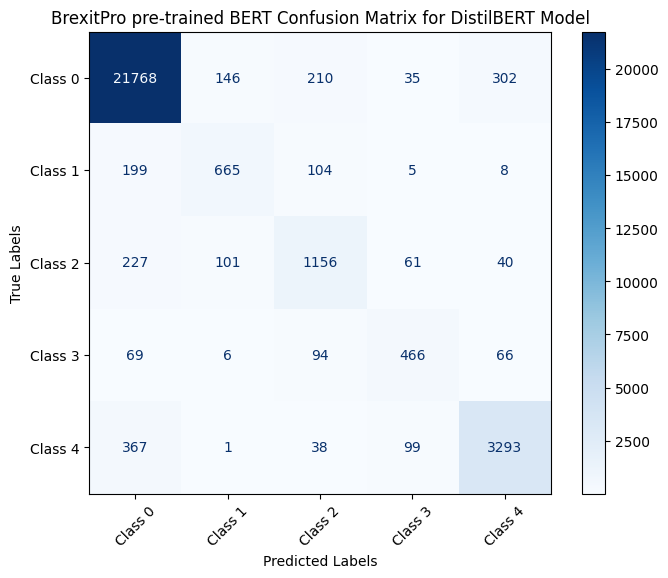

In [7]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 21768,146,210,35,302],
 [ 199,665,104,5,8],
 [ 227,101,1156,61,40],
 [  69,6,94,466,66],
 [ 367,1,38,99,3293]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('BrexitPro pre-trained BERT Confusion Matrix for DistilBERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

#(OLD)

In [ ]:
# Define a custom dataset class for BERT
class SentimentDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]
        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            truncation=True,  # Explicitly set truncation
            padding='max_length',  # Use new padding method
            return_attention_mask=True,
            return_tensors='pt',
        )
        return {
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Create datasets and dataloaders
train_dataset = SentimentDataset(train_texts.values, train_labels.values, tokenizer, max_len=256)
val_dataset = SentimentDataset(val_texts.values, val_labels.values, tokenizer, max_len=256)

train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False)


# 4.1 BERT via BERT Model

In [ ]:
from transformers import BertForSequenceClassification

# Load a pre-trained BERT model for sequence classification
model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=5)

# Move model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


BertForSequenceClassification(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSdpaSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e

In [ ]:
# Save dataframe to CSV
df_pro.to_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv', index=False)

# Define BERT model

In [ ]:
from transformers import AdamW, get_linear_schedule_with_warmup
from torch.nn import CrossEntropyLoss
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score

# Define optimizer and loss function
optimizer = AdamW(model.parameters(), lr=2e-5)
loss_fn = CrossEntropyLoss().to(device)

# Set up learning rate scheduler
total_steps = len(train_loader) * 3  # Assuming 3 epochs
scheduler = get_linear_schedule_with_warmup(optimizer, num_warmup_steps=0, num_training_steps=total_steps)

/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:588: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


In [ ]:
# Training loop
epochs = 3
for epoch in range(epochs):
    model.train()
    total_loss = 0

    for batch in train_loader:
        optimizer.zero_grad()

        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        labels = batch['label'].to(device)

        outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
        loss = outputs.loss
        total_loss += loss.item()

        loss.backward()
        optimizer.step()
        scheduler.step()

    avg_train_loss = total_loss / len(train_loader)
    print(f"Epoch {epoch+1}/{epochs} - Training loss: {avg_train_loss}")

    # Validation
    model.eval()
    val_loss = 0
    all_labels = []
    all_preds = []

    with torch.no_grad():
        for batch in val_loader:
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            labels = batch['label'].to(device)

            outputs = model(input_ids=input_ids, attention_mask=attention_mask, labels=labels)
            loss = outputs.loss
            val_loss += loss.item()

            logits = outputs.logits
            preds = torch.argmax(logits, dim=1).flatten()

            all_labels.extend(labels.cpu().numpy())
            all_preds.extend(preds.cpu().numpy())

    avg_val_loss = val_loss / len(val_loader)
    val_accuracy = accuracy_score(all_labels, all_preds)
    val_f1 = f1_score(all_labels, all_preds, average='weighted')
    val_recall = recall_score(all_labels, all_preds, average='weighted')
    val_precision = precision_score(all_labels, all_preds, average='weighted')

    print(f"Epoch {epoch+1}/{epochs} - Validation loss: {avg_val_loss}")
    print(f"Validation Accuracy: {val_accuracy}")
    print(f"Validation F1 Score: {val_f1}")
    print(f"Validation Recall: {val_recall}")
    print(f"Validation Precision: {val_precision}")

# Save dataframe to CSV
df_pro.to_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv', index=False)

Epoch 1/3 - Training loss: 0.31662690017451345
Epoch 1/3 - Validation loss: 0.22951894793808278
Validation Accuracy: 0.9188200629931926
Validation F1 Score: 0.913808380930556
Validation Recall: 0.9188200629931926
Validation Precision: 0.91576792467647
Epoch 2/3 - Training loss: 0.13186934299810732
Epoch 2/3 - Validation loss: 0.23114552296872024
Validation Accuracy: 0.926575676499475
Validation F1 Score: 0.9246415090301431
Validation Recall: 0.926575676499475
Validation Precision: 0.9240386306451839
Epoch 3/3 - Training loss: 0.05205883358409136
Epoch 3/3 - Validation loss: 0.2703575734257901
Validation Accuracy: 0.9266434111152505
Validation F1 Score: 0.9265367119933652
Validation Recall: 0.9266434111152505
Validation Precision: 0.9264855374557445


# 4.2 BERT SA via DistilModel

In [ ]:
import torch
from transformers import DistilBertTokenizer, DistilBertForSequenceClassification, Trainer, TrainingArguments
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
from torch.utils.data import DataLoader, Dataset

# Define a custom Dataset class
class TextDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]

        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            padding='max_length',
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )

        return {
            'text': text,
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Prepare the data for DistilBERT
def prepare_data(df, tokenizer, max_len, batch_size):
    le = LabelEncoder()
    df['label'] = le.fit_transform(df['bert_sentiment_label'])

    train_texts, val_texts, train_labels, val_labels = train_test_split(
        df['cleaned_text'].values,
        df['label'].values,
        test_size=0.1,
        random_state=42
    )

    train_dataset = TextDataset(
        texts=train_texts,
        labels=train_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    val_dataset = TextDataset(
        texts=val_texts,
        labels=val_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size)

    return train_loader, val_loader, val_labels, le

# Define evaluation metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    acc = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    recall = recall_score(labels, preds, average='weighted')
    precision = precision_score(labels, preds, average='weighted')
    return {
        'accuracy': acc,
        'f1': f1,
        'recall': recall,
        'precision': precision
    }


In [ ]:
# Handle missing values in 'cleaned_text'
df_pro.fillna({'cleaned_text': ''}, inplace=True)

# Set parameters
MAX_LEN = 128
BATCH_SIZE = 16

# Prepare data for DistilBERT
distilbert_tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
train_loader, val_loader, val_labels, label_encoder = prepare_data(df_pro, distilbert_tokenizer, MAX_LEN, BATCH_SIZE)

# Initialize DistilBERT model
distilbert_model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=5)

# Train DistilBERT model with modified training arguments
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    evaluation_strategy="epoch",
    save_steps=500,
    save_total_limit=1
)

trainer = Trainer(
    model=distilbert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

# saving data
df_pro.to_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv')

# Print DistilBERT evaluation results
val_accuracy = results['eval_accuracy']
print(f"Validation loss: {results['eval_loss']}")
print(f"Validation accuracy: {val_accuracy}")

# Confusion Matrix for DistilBERT
preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
cm_distilbert = confusion_matrix(val_labels, preds)

# Compute additional metrics
accuracy = accuracy_score(val_labels, preds)
f1 = f1_score(val_labels, preds, average='weighted')
recall = recall_score(val_labels, preds, average='weighted')
precision = precision_score(val_labels, preds, average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1}")
print(f"Recall: {recall}")
print(f"Precision: {precision}")

# Print confusion matrix
print("Confusion Matrix for DistilBERT:")
print(cm_distilbert)

# saving data
df_pro.to_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv')

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.154300,0.307116,0.902127,0.896258,0.902127,0.899823
2,0.083800,0.299922,0.919669,0.919218,0.919669,0.919407
3,0.076000,0.382934,0.923259,0.922524,0.923259,0.921997


Validation loss: 0.38293400406837463
Validation accuracy: 0.9232592793280954
Accuracy: 0.9232592793280954
F1 Score: 0.922523785201596
Recall: 0.9232592793280954
Precision: 0.9219969536201325
Confusion Matrix for DistilBERT:
[[10871   144    88   103    22]
 [  229  1674     2    12    34]
 [  103     1   330    40     3]
 [  123    23    53   541    34]
 [   32    35     1    51   215]]


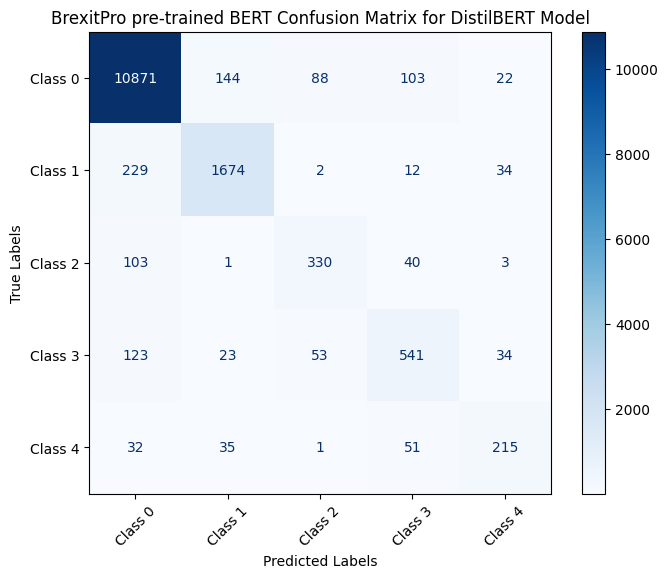

In [16]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 10871,144,88,103,22],
 [ 229,1674,2,12,34],
 [ 103,1,330,40,3],
 [ 123,23,53,541,34],
 [ 32,35,1,51,215]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('BrexitPro pre-trained BERT Confusion Matrix for DistilBERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# 4.3 VADER Sentiment Analyzer

# 4.3 VADER via BERT Model

In [ ]:
# Read Brexit dataset
df_pro = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv')
pd.set_option('display.max_columns',None)
df_pro.head(5)

,Unnamed: 0.1,Unnamed: 0,Date,Headline,URL,Opening Text,Hit Sentence,Source,Influencer,Country,Subregion,Language,Reach,Desktop Reach,Mobile Reach,Twitter Social Echo,Facebook Social Echo,Reddit Social Echo,National Viewership,Engagement,AVE,Sentiment,Key Phrases,Input Name,Keywords,Twitter Authority,Tweet Id,Twitter Id,Twitter Client,Twitter Screen Name,User Profile Url,Twitter Bio,Twitter Followers,Twitter Following,Alternate Date Format,Time,State,City,Document Tags,cleaned_text,token_count,bert_sentiment_score,bert_sentiment_label,label,vader_sentiment_score,vader_sentiment_category,textblob_sentiment_score,textblob_sentiment_numeric,textblob_sentiment_category
0,0,0,15-Jan-2022 11:58PM,NaN,https://twitter.com/dianemcgregor8/statuses/14...,NaN,RT @re11ddy: QT @sandieshoes: Do this if you v...,Twitter,@dianemcgregor8,Cameroon,NaN,English,122,0,0,NaN,NaN,NaN,0,NaN,1.13,Neutral,NaN,Adhoc Search Export,Brexit,4.0,'1482502364728893442',2333154780,Twitter for Android,Diane M McGregor,https://twitter.com/dianemcgregor8,Veggie burger! Lover of all Animals and Nature...,122.0,185.0,"Jan 15, 2022",11:58 PM,North,NaN,NaN,rt re11ddy qt sandieshoes do this if you value...,69,-1.0,Extremely Negative,3,0.8360,Extremely Positive,0.019444,2,Neutral
1,1,1,15-Jan-2022 11:57PM,NaN,http://twitter.com/DeniseMembery/statuses/1482...,NaN,RT @RickSacrop: Michael Fabricant is absolutel...,Twitter,@DeniseMembery,United Kingdom,NaN,English,5721,0,0,NaN,NaN,NaN,0,NaN,52.92,Negative,"hell bent,precious EU",Adhoc Search Export,EU,7.0,'1482502266603118599',3678878175,Twitter for Android,Denise M.,http://www.twitter.com/DeniseMembery,"🇬🇧✡️ Proud to be British. 🇬🇧 Animal lover, m...",5721.0,6291.0,"Jan 15, 2022",11:57 PM,England,NaN,NaN,rt ricksacrop michael fabricant is absolutely ...,59,-1.0,Extremely Negative,4,-0.8442,Extremely Negative,0.225397,3,Positive
2,2,2,15-Jan-2022 11:56PM,NaN,https://twitter.com/007Stirling/statuses/14825...,NaN,@StokieDrew2 I do find it rich; that Tory vote...,Twitter,@007stirling,United Kingdom,NaN,English,7219,0,0,NaN,NaN,NaN,0,NaN,66.78,Negative,"Johnson leadership,Tory voters",Adhoc Search Export,"Brexit,EU",7.0,'1482501928479301632',1384540273494069249,Twitter for Android,Finlay Stirling 🇬🇧☘️❤️🏴󠁧󠁢󠁳󠁣󠁴󠁿,https://twitter.com/007Stirling,BRITISH/IRISH/ULSTER-SCOTS PUL\nRIGHT-WING. \n...,7219.0,7433.0,"Jan 15, 2022",11:56 PM,Northern Ireland,Belfast,NaN,stokiedrew2 i do find it rich that tory voters...,78,-0.5,Negative,4,0.0516,Neutral,0.375000,3,Positive
3,3,3,15-Jan-2022 11:54PM,NaN,https://twitter.com/UKleadstheworld/statuses/1...,NaN,RT @denistmurray: Brexit Britain win as London...,Twitter,@ukleadstheworld,United Kingdom,NaN,English,700,0,0,NaN,NaN,NaN,0,NaN,6.48,Positive,best city,Adhoc Search Export,Brexit,5.0,'1482501439624732672',1394212805071577089,Twitter for iPhone,BestofBritish,https://twitter.com/UKleadstheworld,"GB News, Conservatives, Brexiteer, Block all ads.",700.0,1014.0,"Jan 15, 2022",11:54 PM,NaN,NaN,NaN,rt denistmurray brexit britain win as london n...,34,1.0,Extremely Positive,4,0.9136,Extremely Positive,0.580000,3,Positive
4,4,4,15-Jan-2022 11:53PM,NaN,https://twitter.com/paul_beamish/statuses/1482...,NaN,@afneil If Johnson is taken down by The Tories...,Twitter,@paul_beamish,United Kingdom,NaN,English,200,0,0,NaN,NaN,NaN,0,NaN,1.85,Neutral,"credible Brexiteer,droves,likelihood",Adhoc Search Export,"Brexiteers,Brexiteer",4.0,'1482501195767898119',971698786148986880,Twitter for Android,Paul Beamish,https://twitter.com/paul_beamish,Brexiteer and Shipbuilder (Plater/Welder) livi...,200.0,822.0,"Jan 15, 2022",11:53 PM,England,NaN,NaN,afneil if johnson is taken down by the tories ...,69,-0.5,Negative,3,-0.6808,Negative,0.032222,2,Neutral


In [ ]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import pandas as pd
import matplotlib.pyplot as plt

# Initialize VADER sentiment analyzer
analyzer = SentimentIntensityAnalyzer()

# Function to get sentiment score using VADER
def get_vader_sentiment(text):
    score = analyzer.polarity_scores(text)['compound']
    return score

# Function to categorize the sentiment score
def categorize_sentiment(score):
    if score >= 0.7:
        return 'Extremely Positive'
    elif score > 0.2:
        return 'Positive'
    elif -0.2 <= score <= 0.2:
        return 'Neutral'
    elif score >= -0.7:
        return 'Negative'
    else:
        return 'Extremely Negative'

# Apply VADER sentiment analysis
df_pro['vader_sentiment_score'] = df_pro['cleaned_text'].apply(get_vader_sentiment)
df_pro['vader_sentiment_category'] = df_pro['vader_sentiment_score'].apply(categorize_sentiment)

# Save df_anti dataset
df_pro.to_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv')

print(df_pro[['vader_sentiment_score','vader_sentiment_category']].head())

   vader_sentiment_score vader_sentiment_category
0                 0.8360       Extremely Positive
1                -0.8442       Extremely Negative
2                 0.0516                  Neutral
3                 0.9136       Extremely Positive
4                -0.6808                 Negative


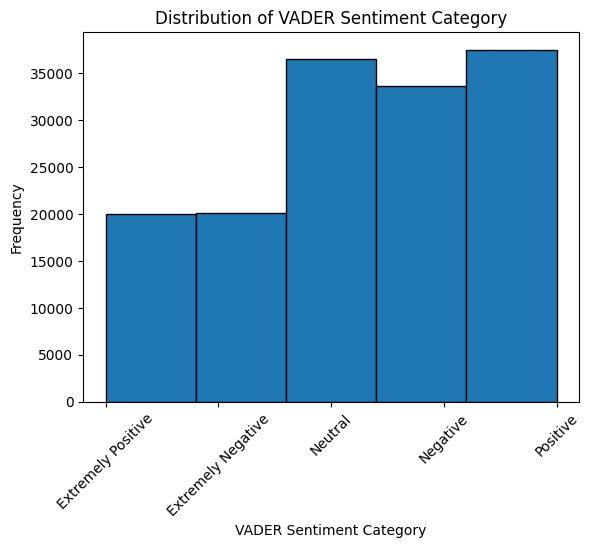

In [ ]:
plt.hist(df_pro['vader_sentiment_category'], bins=5, edgecolor='k')
plt.xlabel('VADER Sentiment Category')
plt.ylabel('Frequency')
plt.title('Distribution of VADER Sentiment Category')
plt.xticks(rotation=45)
plt.show()

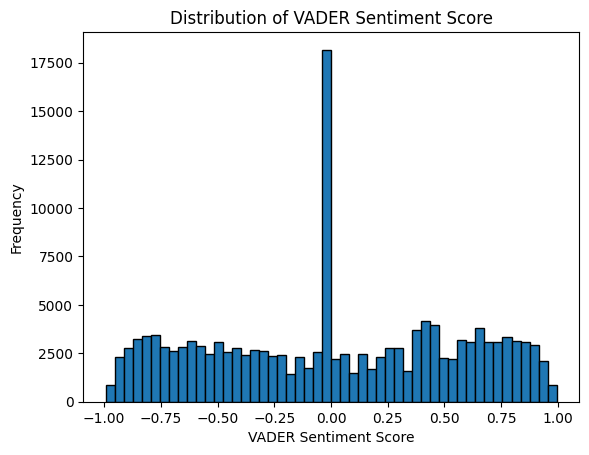

In [ ]:
plt.hist(df_pro['vader_sentiment_score'], bins=50, edgecolor='k')
plt.xlabel('VADER Sentiment Score')
plt.ylabel('Frequency')
plt.title('Distribution of VADER Sentiment Score')
#plt.xticks(rotation=45)
plt.show()

In [ ]:
from nltk.tokenize import word_tokenize

# Ensure 'text_clean' column contains strings
df_pro['vader_cleaned_text'] = df_pro['cleaned_text'].astype(str)

# Tokenize the text
df_pro['vader_cleaned_text'] = df_pro['vader_cleaned_text'].apply(word_tokenize)

# Calculate token counts
df_pro['vader_token_counts'] = df_pro['vader_cleaned_text'].apply(len)

In [ ]:
# Display the DataFrame with token counts
df_pro.head()

,Unnamed: 0.1,Unnamed: 0,Date,Headline,URL,Opening Text,Hit Sentence,Source,Influencer,Country,Subregion,Language,Reach,Desktop Reach,Mobile Reach,Twitter Social Echo,Facebook Social Echo,Reddit Social Echo,National Viewership,Engagement,AVE,Sentiment,Key Phrases,Input Name,Keywords,Twitter Authority,Tweet Id,Twitter Id,Twitter Client,Twitter Screen Name,User Profile Url,Twitter Bio,Twitter Followers,Twitter Following,Alternate Date Format,Time,State,City,Document Tags,cleaned_text,token_count,bert_sentiment_score,bert_sentiment_label,label,vader_sentiment_score,vader_sentiment_category,textblob_sentiment_score,textblob_sentiment_numeric,textblob_sentiment_category,vader_cleaned_text,vader_token_counts
0,0,0,15-Jan-2022 11:58PM,NaN,https://twitter.com/dianemcgregor8/statuses/14...,NaN,RT @re11ddy: QT @sandieshoes: Do this if you v...,Twitter,@dianemcgregor8,Cameroon,NaN,English,122,0,0,NaN,NaN,NaN,0,NaN,1.13,Neutral,NaN,Adhoc Search Export,Brexit,4.0,'1482502364728893442',2333154780,Twitter for Android,Diane M McGregor,https://twitter.com/dianemcgregor8,Veggie burger! Lover of all Animals and Nature...,122.0,185.0,"Jan 15, 2022",11:58 PM,North,NaN,NaN,rt re11ddy qt sandieshoes do this if you value...,69,-1.0,Extremely Negative,3,0.8360,Extremely Positive,0.019444,2,Neutral,"[rt, re11ddy, qt, sandieshoes, do, this, if, y...",58
1,1,1,15-Jan-2022 11:57PM,NaN,http://twitter.com/DeniseMembery/statuses/1482...,NaN,RT @RickSacrop: Michael Fabricant is absolutel...,Twitter,@DeniseMembery,United Kingdom,NaN,English,5721,0,0,NaN,NaN,NaN,0,NaN,52.92,Negative,"hell bent,precious EU",Adhoc Search Export,EU,7.0,'1482502266603118599',3678878175,Twitter for Android,Denise M.,http://www.twitter.com/DeniseMembery,"🇬🇧✡️ Proud to be British. 🇬🇧 Animal lover, m...",5721.0,6291.0,"Jan 15, 2022",11:57 PM,England,NaN,NaN,rt ricksacrop michael fabricant is absolutely ...,59,-1.0,Extremely Negative,4,-0.8442,Extremely Negative,0.225397,3,Positive,"[rt, ricksacrop, michael, fabricant, is, absol...",52
2,2,2,15-Jan-2022 11:56PM,NaN,https://twitter.com/007Stirling/statuses/14825...,NaN,@StokieDrew2 I do find it rich; that Tory vote...,Twitter,@007stirling,United Kingdom,NaN,English,7219,0,0,NaN,NaN,NaN,0,NaN,66.78,Negative,"Johnson leadership,Tory voters",Adhoc Search Export,"Brexit,EU",7.0,'1482501928479301632',1384540273494069249,Twitter for Android,Finlay Stirling 🇬🇧☘️❤️🏴󠁧󠁢󠁳󠁣󠁴󠁿,https://twitter.com/007Stirling,BRITISH/IRISH/ULSTER-SCOTS PUL\nRIGHT-WING. \n...,7219.0,7433.0,"Jan 15, 2022",11:56 PM,Northern Ireland,Belfast,NaN,stokiedrew2 i do find it rich that tory voters...,78,-0.5,Negative,4,0.0516,Neutral,0.375000,3,Positive,"[stokiedrew2, i, do, find, it, rich, that, tor...",51
3,3,3,15-Jan-2022 11:54PM,NaN,https://twitter.com/UKleadstheworld/statuses/1...,NaN,RT @denistmurray: Brexit Britain win as London...,Twitter,@ukleadstheworld,United Kingdom,NaN,English,700,0,0,NaN,NaN,NaN,0,NaN,6.48,Positive,best city,Adhoc Search Export,Brexit,5.0,'1482501439624732672',1394212805071577089,Twitter for iPhone,BestofBritish,https://twitter.com/UKleadstheworld,"GB News, Conservatives, Brexiteer, Block all ads.",700.0,1014.0,"Jan 15, 2022",11:54 PM,NaN,NaN,NaN,rt denistmurray brexit britain win as london n...,34,1.0,Extremely Positive,4,0.9136,Extremely Positive,0.580000,3,Positive,"[rt, denistmurray, brexit, britain, win, as, l...",21
4,4,4,15-Jan-2022 11:53PM,NaN,https://twitter.com/paul_beamish/statuses/1482...,NaN,@afneil If Johnson is taken down by The Tories...,Twitter,@paul_beamish,United Kingdom,NaN,English,200,0,0,NaN,NaN,NaN,0,NaN,1.85,Neutral,"credible Brexiteer,droves,likelihood",Adhoc Search Export,"Brexiteers,Brexiteer",4.0,'1482501195767898119',971698786148986880,Twitter for Android,Paul Beamish,https://twitter.com/paul_beamish,Brexiteer and Shipbuilder (Plater/Welder) livi...,200.0,822.0,"Jan 15, 2022",11:53 PM,England,NaN,NaN,afneil if johnson is taken down by the tories ...,69,-0.5,Negative,3,-0.6808,Negative,0.032222,2,Neutral,"[afneil, if, jo

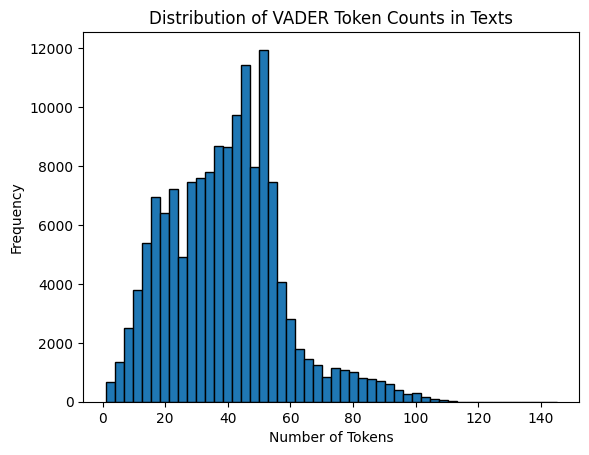

count    147631.000000
mean         39.219066
std          18.174130
min           1.000000
25%          26.000000
50%          40.000000
75%          50.000000
max         145.000000
Name: vader_token_counts, dtype: float64


<Figure size 640x480 with 0 Axes>

In [ ]:
# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv'
df_pro.to_csv(output_file_path, index=False)

import matplotlib.pyplot as plt
plt.hist(df_pro['vader_token_counts'], bins=50, edgecolor='k')
plt.xlabel('Number of Tokens')
plt.ylabel('Frequency')
plt.title('Distribution of VADER Token Counts in Texts')
plt.show()
plt.savefig('/content/drive/MyDrive/Colab Notebooks/pro_token_count_VADER_distribution.png')

# Print basic statistics
print(df_pro['vader_token_counts'].describe())

# WordCloud

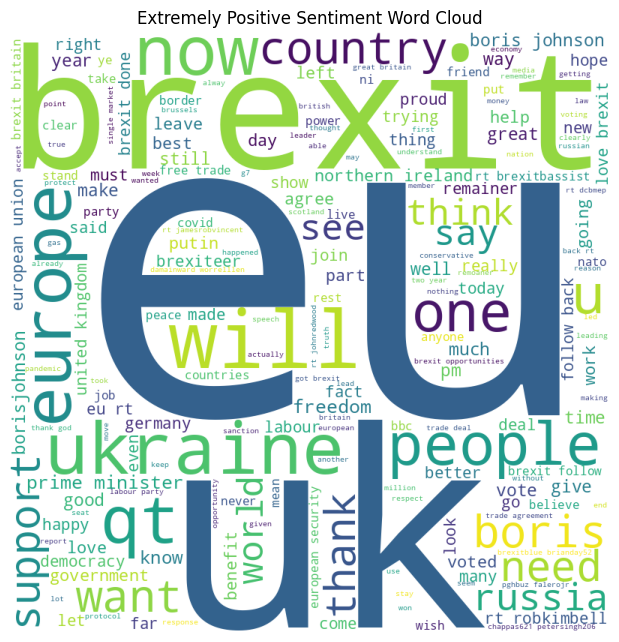

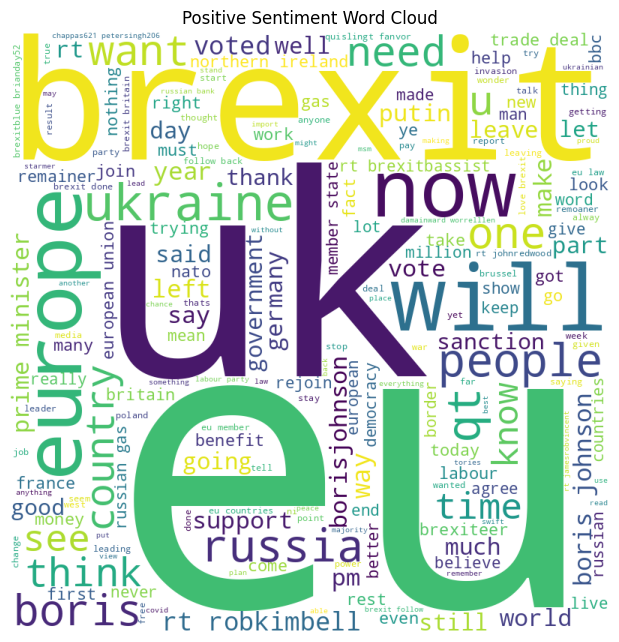

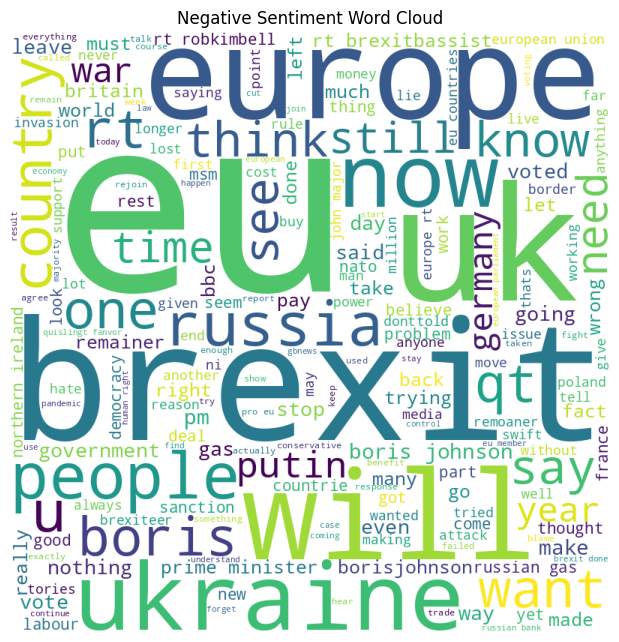

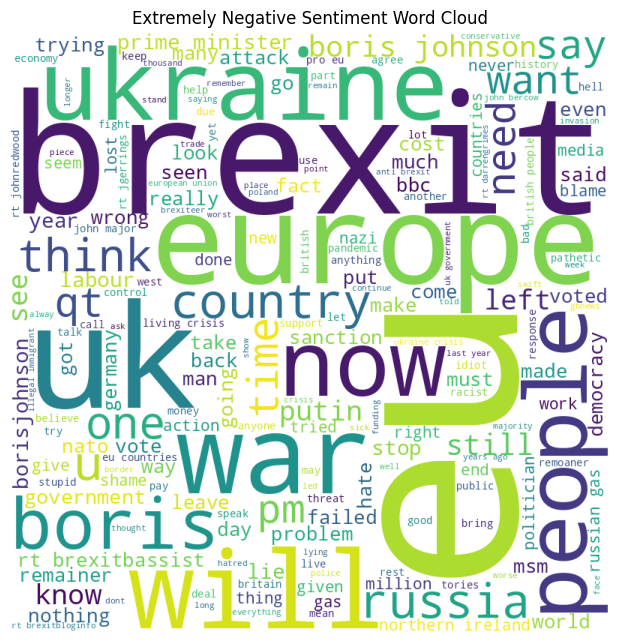

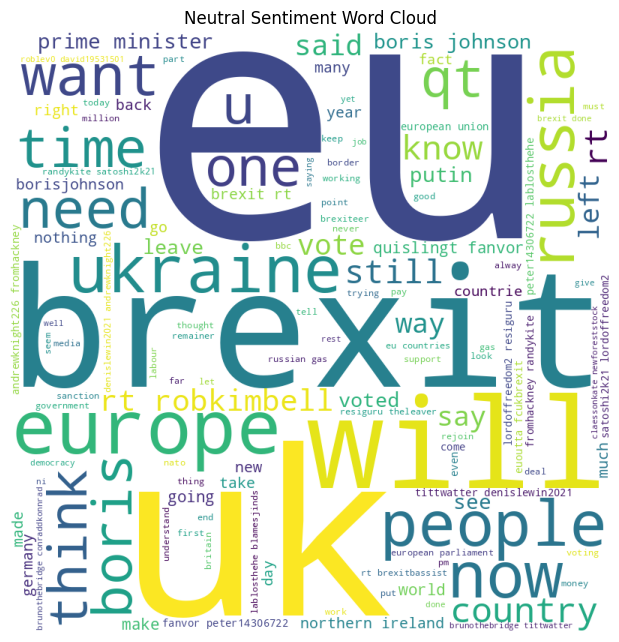

In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

# Filter the DataFrame for each sentiment label
extremely_positive_df = df_pro[df_pro['vader_sentiment_category'] == 'Extremely Positive']
positive_df = df_pro[df_pro['vader_sentiment_category'] == 'Positive']
negative_df = df_pro[df_pro['vader_sentiment_category'] == 'Negative']
extremely_negative_df = df_pro[df_pro['vader_sentiment_category'] == 'Extremely Negative']
neutral_df = df_pro[df_pro['vader_sentiment_category'] == 'Neutral']

# Combine text for each sentiment
extremely_positive_text = " ".join(extremely_positive_df['cleaned_text'])
positive_text = " ".join(str(text) for text in positive_df['cleaned_text'])
negative_text = " ".join(str(text) for text in negative_df['cleaned_text'])
extremely_negative_text = " ".join(str(text) for text in extremely_negative_df['cleaned_text'])
neutral_text = " ".join(str(text) for text in neutral_df['cleaned_text'])

# Create WordCloud objects
stopwords = set(STOPWORDS)
wordcloud_ep = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_positive_text)
wordcloud_p = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(positive_text)
wordcloud_n = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(negative_text)
wordcloud_en = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_negative_text)

wordcloud_ne = WordCloud(width = 800, height = 800,
                background_color = 'white',
                stopwords = stopwords,
                min_font_size = 10).generate(neutral_text)

# Plot the WordClouds
plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ep)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_p)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_n)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_en)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ne)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Neutral Sentiment Word Cloud")
plt.show()


In [ ]:
import torch
from transformers import BertTokenizer, BertForSequenceClassification, DistilBertTokenizer, DistilBertForSequenceClassification, Trainer, TrainingArguments
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
from torch.utils.data import DataLoader, Dataset

# Define a custom Dataset class
class TextDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]

        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            padding='max_length',
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )

        return {
            'text': text,
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Prepare the data for BERT and DistilBERT
def prepare_data(df, tokenizer, max_len, batch_size):
    le = LabelEncoder()
    df['label'] = le.fit_transform(df['vader_sentiment_category'])

    train_texts, val_texts, train_labels, val_labels = train_test_split(
        df['cleaned_text'].values,
        df['label'].values,
        test_size=0.1,
        random_state=42
    )

    train_dataset = TextDataset(
        texts=train_texts,
        labels=train_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    val_dataset = TextDataset(
        texts=val_texts,
        labels=val_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size)

    return train_loader, val_loader, val_labels, le

# Define evaluation metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    acc = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    recall = recall_score(labels, preds, average='weighted')
    precision = precision_score(labels, preds, average='weighted')
    return {
        'accuracy': acc,
        'f1': f1,
        'recall': recall,
        'precision': precision
    }


In [ ]:
df_pro.fillna({'cleaned_text': ''}, inplace=True)

# Set parameters
MAX_LEN = 128
BATCH_SIZE = 16

# Prepare data for BERT
bert_tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
train_loader, val_loader, val_labels, label_encoder = prepare_data(df_pro, bert_tokenizer, MAX_LEN, BATCH_SIZE)

# Initialize BERT model
bert_model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=5)

# Train BERT model with modified training arguments
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    evaluation_strategy="epoch",
    save_steps=500,
    save_total_limit=1
)

trainer = Trainer(
    model=bert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

# Save df_anti dataset
df_pro.to_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv')

# Print BERT evaluation results
val_accuracy = results['eval_accuracy']
print(f"Validation loss: {results['eval_loss']}")
print(f"Validation accuracy: {val_accuracy}")

# Confusion Matrix for BERT
preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
cm_bert = confusion_matrix(val_labels, preds)

# Compute additional metrics
accuracy = accuracy_score(val_labels, preds)
f1 = f1_score(val_labels, preds, average='weighted')
recall = recall_score(val_labels, preds, average='weighted')
precision = precision_score(val_labels, preds, average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1}")
print(f"Recall: {recall}")
print(f"Precision: {precision}")

# Print confusion matrix
print("Confusion Matrix for BERT:")
print(cm_bert)

# Save df_anti dataset
df_pro.to_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv')

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.277500,0.302335,0.889867,0.889780,0.889867,0.891792
2,0.191600,0.251347,0.923327,0.923258,0.923327,0.924041
3,0.198700,0.249778,0.939583,0.939595,0.939583,0.940185


Validation loss: 0.24977819621562958
Validation accuracy: 0.9395827688973178
Accuracy: 0.9395827688973178
F1 Score: 0.9395953859713989
Recall: 0.9395827688973178
Precision: 0.9401848267359424
Confusion Matrix for BERT:
[[1927    0   49   15    1]
 [   0 1889    0   16   59]
 [ 113    0 3122  166    7]
 [   1    4   99 3445   85]
 [   1  106   12  158 3489]]


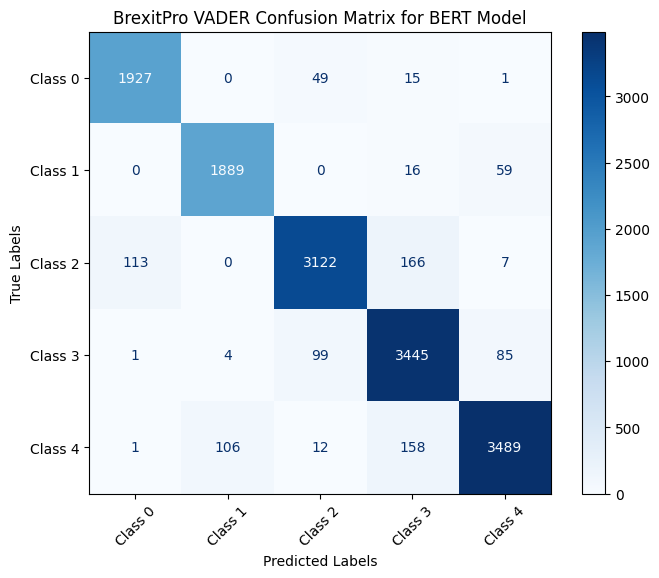

In [18]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 1927,0,49,15,1],
 [ 0,1889,0,16,59],
 [ 113,0,3122,166,7],
 [ 1,4,99,3445,85],
 [ 1,106,12,158,3489]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('BrexitPro VADER Confusion Matrix for BERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# 4.4 VADER via DistilBERT Model

In [ ]:
# Prepare data for DistilBERT
distilbert_tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
train_loader, val_loader, val_labels, label_encoder = prepare_data(df_pro, distilbert_tokenizer, MAX_LEN, BATCH_SIZE)

# Initialize DistilBERT model
distilbert_model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=5)

# Train DistilBERT model with modified training arguments
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    evaluation_strategy="epoch",
    save_steps=500,
    save_total_limit=1
)

trainer = Trainer(
    model=distilbert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

# Save df_anti dataset
df_pro.to_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv')

# Print DistilBERT evaluation results
val_accuracy = results['eval_accuracy']
print(f"Validation loss: {results['eval_loss']}")
print(f"Validation accuracy: {val_accuracy}")

# Confusion Matrix for DistilBERT
preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
cm_distilbert = confusion_matrix(val_labels, preds)

# Compute additional metrics
accuracy = accuracy_score(val_labels, preds)
f1 = f1_score(val_labels, preds, average='weighted')
recall = recall_score(val_labels, preds, average='weighted')
precision = precision_score(val_labels, preds, average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1}")
print(f"Recall: {recall}")
print(f"Precision: {precision}")

# Print confusion matrix
print("Confusion Matrix for DistilBERT:")
print(cm_distilbert)

# Save df_anti dataset
df_pro.to_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv')


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.350900,0.270762,0.898266,0.898502,0.898266,0.899579
2,0.138400,0.257379,0.921972,0.921905,0.921972,0.923104
3,0.121400,0.274862,0.934232,0.934205,0.934232,0.934762


Validation loss: 0.2748623490333557
Validation accuracy: 0.9342319154700623
Accuracy: 0.9342319154700623
F1 Score: 0.9342053539718016
Recall: 0.9342319154700623
Precision: 0.9347624418100753
Confusion Matrix for DistilBERT:
[[1925    0   51   15    1]
 [   0 1885    0   13   66]
 [ 152    0 3080  165   11]
 [   2    4  118 3412   98]
 [   1  100    9  165 3491]]


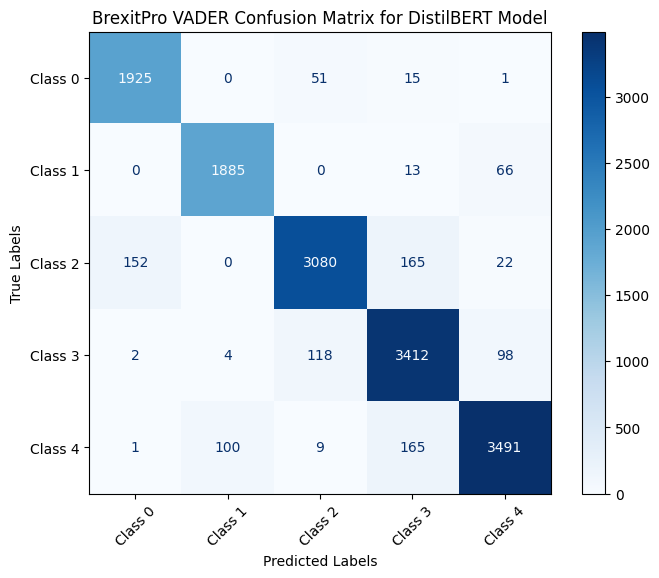

In [19]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 1925,0,51,15,1],
 [ 0,1885,0,13,66],
 [ 152,0,3080,165,22],
 [ 2,4,118,3412,98],
 [ 1,100,9,165,3491]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('BrexitPro VADER Confusion Matrix for DistilBERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# 4.5 TextBlob

In [ ]:
# Read Brexit dataset
df_pro = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv')
pd.set_option('display.max_columns',None)
df_pro.head(5)

,Unnamed: 0.1,Unnamed: 0,Date,Headline,URL,Opening Text,Hit Sentence,Source,Influencer,Country,Subregion,Language,Reach,Desktop Reach,Mobile Reach,Twitter Social Echo,Facebook Social Echo,Reddit Social Echo,National Viewership,Engagement,AVE,Sentiment,Key Phrases,Input Name,Keywords,Twitter Authority,Tweet Id,Twitter Id,Twitter Client,Twitter Screen Name,User Profile Url,Twitter Bio,Twitter Followers,Twitter Following,Alternate Date Format,Time,State,City,Document Tags,cleaned_text,token_count,bert_sentiment_score,bert_sentiment_label,label,vader_sentiment_score,vader_sentiment_category,textblob_sentiment_score,textblob_sentiment_numeric,textblob_sentiment_category,vader_cleaned_text,vader_token_counts
0,0,0,15-Jan-2022 11:58PM,NaN,https://twitter.com/dianemcgregor8/statuses/14...,NaN,RT @re11ddy: QT @sandieshoes: Do this if you v...,Twitter,@dianemcgregor8,Cameroon,NaN,English,122,0,0,NaN,NaN,NaN,0,NaN,1.13,Neutral,NaN,Adhoc Search Export,Brexit,4.0,'1482502364728893442',2333154780,Twitter for Android,Diane M McGregor,https://twitter.com/dianemcgregor8,Veggie burger! Lover of all Animals and Nature...,122.0,185.0,"Jan 15, 2022",11:58 PM,North,NaN,NaN,rt re11ddy qt sandieshoes do this if you value...,69,-1.0,Extremely Negative,3,0.8360,Extremely Positive,0.019444,2,Neutral,"['rt', 're11ddy', 'qt', 'sandieshoes', 'do', '...",58
1,1,1,15-Jan-2022 11:57PM,NaN,http://twitter.com/DeniseMembery/statuses/1482...,NaN,RT @RickSacrop: Michael Fabricant is absolutel...,Twitter,@DeniseMembery,United Kingdom,NaN,English,5721,0,0,NaN,NaN,NaN,0,NaN,52.92,Negative,"hell bent,precious EU",Adhoc Search Export,EU,7.0,'1482502266603118599',3678878175,Twitter for Android,Denise M.,http://www.twitter.com/DeniseMembery,"🇬🇧✡️ Proud to be British. 🇬🇧 Animal lover, m...",5721.0,6291.0,"Jan 15, 2022",11:57 PM,England,NaN,NaN,rt ricksacrop michael fabricant is absolutely ...,59,-1.0,Extremely Negative,4,-0.8442,Extremely Negative,0.225397,3,Positive,"['rt', 'ricksacrop', 'michael', 'fabricant', '...",52
2,2,2,15-Jan-2022 11:56PM,NaN,https://twitter.com/007Stirling/statuses/14825...,NaN,@StokieDrew2 I do find it rich; that Tory vote...,Twitter,@007stirling,United Kingdom,NaN,English,7219,0,0,NaN,NaN,NaN,0,NaN,66.78,Negative,"Johnson leadership,Tory voters",Adhoc Search Export,"Brexit,EU",7.0,'1482501928479301632',1384540273494069249,Twitter for Android,Finlay Stirling 🇬🇧☘️❤️🏴󠁧󠁢󠁳󠁣󠁴󠁿,https://twitter.com/007Stirling,BRITISH/IRISH/ULSTER-SCOTS PUL\nRIGHT-WING. \n...,7219.0,7433.0,"Jan 15, 2022",11:56 PM,Northern Ireland,Belfast,NaN,stokiedrew2 i do find it rich that tory voters...,78,-0.5,Negative,4,0.0516,Neutral,0.375000,3,Positive,"['stokiedrew2', 'i', 'do', 'find', 'it', 'rich...",51
3,3,3,15-Jan-2022 11:54PM,NaN,https://twitter.com/UKleadstheworld/statuses/1...,NaN,RT @denistmurray: Brexit Britain win as London...,Twitter,@ukleadstheworld,United Kingdom,NaN,English,700,0,0,NaN,NaN,NaN,0,NaN,6.48,Positive,best city,Adhoc Search Export,Brexit,5.0,'1482501439624732672',1394212805071577089,Twitter for iPhone,BestofBritish,https://twitter.com/UKleadstheworld,"GB News, Conservatives, Brexiteer, Block all ads.",700.0,1014.0,"Jan 15, 2022",11:54 PM,NaN,NaN,NaN,rt denistmurray brexit britain win as london n...,34,1.0,Extremely Positive,4,0.9136,Extremely Positive,0.580000,3,Positive,"['rt', 'denistmurray', 'brexit', 'britain', 'w...",21
4,4,4,15-Jan-2022 11:53PM,NaN,https://twitter.com/paul_beamish/statuses/1482...,NaN,@afneil If Johnson is taken down by The Tories...,Twitter,@paul_beamish,United Kingdom,NaN,English,200,0,0,NaN,NaN,NaN,0,NaN,1.85,Neutral,"credible Brexiteer,droves,likelihood",Adhoc Search Export,"Brexiteers,Brexiteer",4.0,'1482501195767898119',971698786148986880,Twitter for Android,Paul Beamish,https://twitter.com/paul_beamish,Brexiteer and Shipbuilder (Plater/Welder) livi...,200.0,822.0,"Jan 15, 2022",11:53 PM,England,NaN,NaN,afneil if johnson is taken down by the tories ...,69,-0.5,Negative,3,-0.6808,Negative,0.032222,2,Neutral,"['afneil', 'if'

In [ ]:
from textblob import TextBlob

# Load the updated dataset
file_path_anti = '/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv'
df_pro = pd.read_csv(file_path_anti)

# Preprocess the 'clean_text' column
df_pro['cleaned_text'] = df_pro['cleaned_text'].astype(str).fillna('')

# Function to get sentiment score using TextBlob
def get_textblob_sentiment(text):
    return TextBlob(text).sentiment.polarity

# Function to categorize the sentiment score
def categorize_sentiment(score):
    if score >= 0.7:
        return 4, 'Extremely Positive'  # Extremely Positive
    elif score > 0.2:
        return 3, 'Positive'  # Positive
    elif -0.2 <= score <= 0.2:
        return 2, 'Neutral'  # Neutral
    elif score >= -0.7:
        return 1, 'Negative'  # Negative
    else:
        return 0, 'Extremely Negative'  # Extremely Negative

# Apply TextBlob sentiment analysis
df_pro['textblob_sentiment_score'] = df_pro['cleaned_text'].apply(get_textblob_sentiment)

# Apply categorize_sentiment and create two new columns
df_pro[['textblob_sentiment_numeric', 'textblob_sentiment_category']] = df_pro['textblob_sentiment_score'].apply(categorize_sentiment).apply(pd.Series)

# Save dataframe to CSV
df_pro.to_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv', index=False)

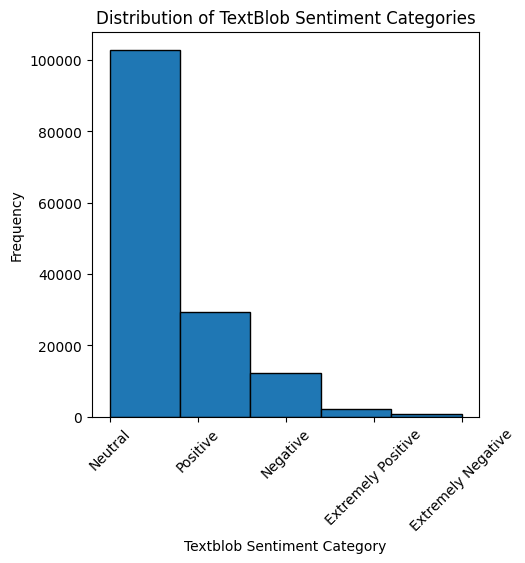

In [ ]:
# Plot the distribution of Textblob sentiment categories
plt.figure(figsize=(5,5))
plt.hist(df_pro['textblob_sentiment_category'], bins=5, edgecolor='k')
plt.xlabel('Textblob Sentiment Category')
plt.ylabel('Frequency')
plt.title('Distribution of TextBlob Sentiment Categories')
plt.xticks(rotation=45)
plt.show()

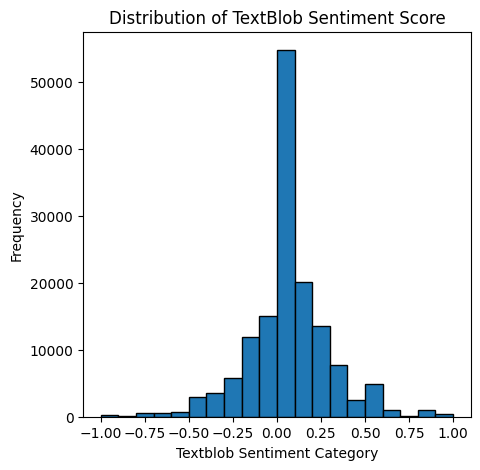

In [ ]:
# Plot the distribution of Textblob sentiment categories
plt.figure(figsize=(5,5))
plt.hist(df_pro['textblob_sentiment_score'], bins=20, edgecolor='k')
plt.xlabel('Textblob Sentiment Category')
plt.ylabel('Frequency')
plt.title('Distribution of TextBlob Sentiment Score')
#plt.xticks(rotation=45)
plt.show()

In [ ]:
# Tokenize 'text_clean' using TextBlob and count tokens
df_pro['textblob_tokenized_text'] = df_pro['cleaned_text'].apply(lambda x: TextBlob(str(x)).words)
df_pro['textblob_token_counts'] = df_pro['textblob_tokenized_text'].apply(len)
df_pro.head(5)

,Unnamed: 0.1,Unnamed: 0,Date,Headline,URL,Opening Text,Hit Sentence,Source,Influencer,Country,Subregion,Language,Reach,Desktop Reach,Mobile Reach,Twitter Social Echo,Facebook Social Echo,Reddit Social Echo,National Viewership,Engagement,AVE,Sentiment,Key Phrases,Input Name,Keywords,Twitter Authority,Tweet Id,Twitter Id,Twitter Client,Twitter Screen Name,User Profile Url,Twitter Bio,Twitter Followers,Twitter Following,Alternate Date Format,Time,State,City,Document Tags,cleaned_text,token_count,bert_sentiment_score,bert_sentiment_label,label,vader_sentiment_score,vader_sentiment_category,textblob_sentiment_score,textblob_sentiment_numeric,textblob_sentiment_category,vader_cleaned_text,vader_token_counts,textblob_tokenized_text,textblob_token_counts
0,0,0,15-Jan-2022 11:58PM,NaN,https://twitter.com/dianemcgregor8/statuses/14...,NaN,RT @re11ddy: QT @sandieshoes: Do this if you v...,Twitter,@dianemcgregor8,Cameroon,NaN,English,122,0,0,NaN,NaN,NaN,0,NaN,1.13,Neutral,NaN,Adhoc Search Export,Brexit,4.0,'1482502364728893442',2333154780,Twitter for Android,Diane M McGregor,https://twitter.com/dianemcgregor8,Veggie burger! Lover of all Animals and Nature...,122.0,185.0,"Jan 15, 2022",11:58 PM,North,NaN,NaN,rt re11ddy qt sandieshoes do this if you value...,69,-1.0,Extremely Negative,3,0.8360,Extremely Positive,0.019444,2,Neutral,"['rt', 're11ddy', 'qt', 'sandieshoes', 'do', '...",58,"[rt, re11ddy, qt, sandieshoes, do, this, if, y...",58
1,1,1,15-Jan-2022 11:57PM,NaN,http://twitter.com/DeniseMembery/statuses/1482...,NaN,RT @RickSacrop: Michael Fabricant is absolutel...,Twitter,@DeniseMembery,United Kingdom,NaN,English,5721,0,0,NaN,NaN,NaN,0,NaN,52.92,Negative,"hell bent,precious EU",Adhoc Search Export,EU,7.0,'1482502266603118599',3678878175,Twitter for Android,Denise M.,http://www.twitter.com/DeniseMembery,"🇬🇧✡️ Proud to be British. 🇬🇧 Animal lover, m...",5721.0,6291.0,"Jan 15, 2022",11:57 PM,England,NaN,NaN,rt ricksacrop michael fabricant is absolutely ...,59,-1.0,Extremely Negative,4,-0.8442,Extremely Negative,0.225397,3,Positive,"['rt', 'ricksacrop', 'michael', 'fabricant', '...",52,"[rt, ricksacrop, michael, fabricant, is, absol...",52
2,2,2,15-Jan-2022 11:56PM,NaN,https://twitter.com/007Stirling/statuses/14825...,NaN,@StokieDrew2 I do find it rich; that Tory vote...,Twitter,@007stirling,United Kingdom,NaN,English,7219,0,0,NaN,NaN,NaN,0,NaN,66.78,Negative,"Johnson leadership,Tory voters",Adhoc Search Export,"Brexit,EU",7.0,'1482501928479301632',1384540273494069249,Twitter for Android,Finlay Stirling 🇬🇧☘️❤️🏴󠁧󠁢󠁳󠁣󠁴󠁿,https://twitter.com/007Stirling,BRITISH/IRISH/ULSTER-SCOTS PUL\nRIGHT-WING. \n...,7219.0,7433.0,"Jan 15, 2022",11:56 PM,Northern Ireland,Belfast,NaN,stokiedrew2 i do find it rich that tory voters...,78,-0.5,Negative,4,0.0516,Neutral,0.375000,3,Positive,"['stokiedrew2', 'i', 'do', 'find', 'it', 'rich...",51,"[stokiedrew2, i, do, find, it, rich, that, tor...",51
3,3,3,15-Jan-2022 11:54PM,NaN,https://twitter.com/UKleadstheworld/statuses/1...,NaN,RT @denistmurray: Brexit Britain win as London...,Twitter,@ukleadstheworld,United Kingdom,NaN,English,700,0,0,NaN,NaN,NaN,0,NaN,6.48,Positive,best city,Adhoc Search Export,Brexit,5.0,'1482501439624732672',1394212805071577089,Twitter for iPhone,BestofBritish,https://twitter.com/UKleadstheworld,"GB News, Conservatives, Brexiteer, Block all ads.",700.0,1014.0,"Jan 15, 2022",11:54 PM,NaN,NaN,NaN,rt denistmurray brexit britain win as london n...,34,1.0,Extremely Positive,4,0.9136,Extremely Positive,0.580000,3,Positive,"['rt', 'denistmurray', 'brexit', 'britain', 'w...",21,"[rt, denistmurray, brexit, britain, win, as, l...",21
4,4,4,15-Jan-2022 11:53PM,NaN,https://twitter.com/paul_beamish/statuses/1482...,NaN,@afneil If Johnson is taken down by The Tories...,Twitter,@paul_beamish,United Kingdom,NaN,English,200,0,0,NaN,NaN,NaN,0,NaN,1.85,Neutral,"credible Brexiteer,droves,likelihood",Adhoc Search Export,"Brexiteers,Brexiteer",4.0,'1482501195767898119',971698786148986880,Twitter for Android,Pau

In [ ]:
# Display the results
print(df_pro[['textblob_token_counts', 'textblob_tokenized_text']].head())

# Save the updated dataset to a CSV file
output_file_path = '/content/drive/MyDrive/df_pro_updated.csv'
df_pro.to_csv(output_file_path, index=False)

   textblob_token_counts                            textblob_tokenized_text
0                     58  [rt, re11ddy, qt, sandieshoes, do, this, if, y...
1                     52  [rt, ricksacrop, michael, fabricant, is, absol...
2                     51  [stokiedrew2, i, do, find, it, rich, that, tor...
3                     21  [rt, denistmurray, brexit, britain, win, as, l...
4                     47  [afneil, if, johnson, is, taken, down, by, the...


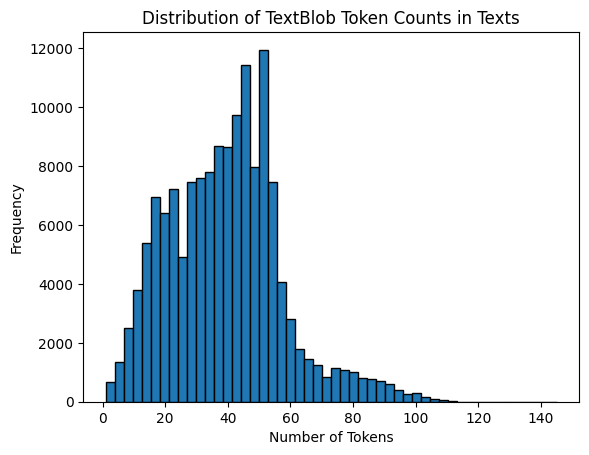

count    147631.000000
mean         39.219066
std          18.174130
min           1.000000
25%          26.000000
50%          40.000000
75%          50.000000
max         145.000000
Name: textblob_token_counts, dtype: float64


<Figure size 640x480 with 0 Axes>

In [ ]:
# Plot the distribution of token counts
import matplotlib.pyplot as plt

plt.hist(df_pro['textblob_token_counts'], bins=50, edgecolor='k')
plt.xlabel('Number of Tokens')
plt.ylabel('Frequency')
plt.title('Distribution of TextBlob Token Counts in Texts')
plt.show()
plt.savefig('/content/drive/MyDrive/DF_PRO_token_count_TextBlob_distribution.png')

# Print basic statistics
print(df_pro['textblob_token_counts'].describe())

# WordCloud

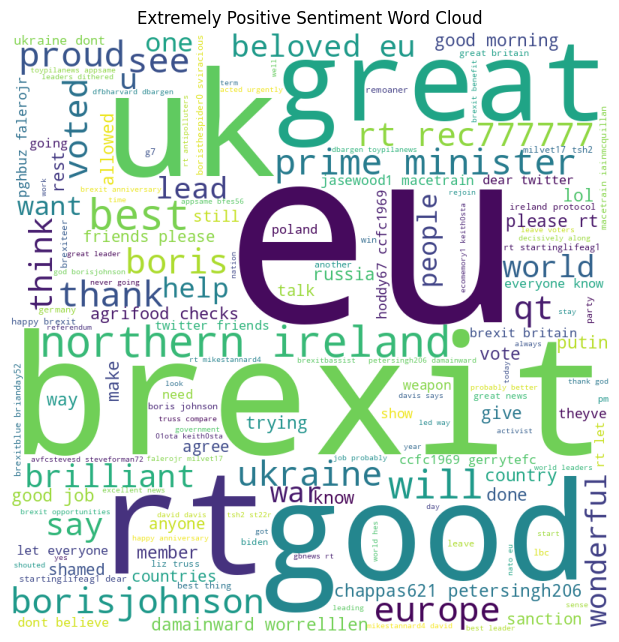

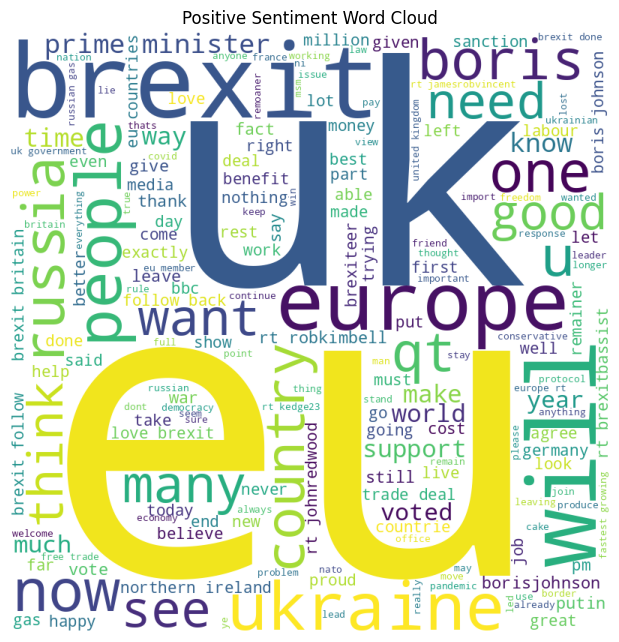

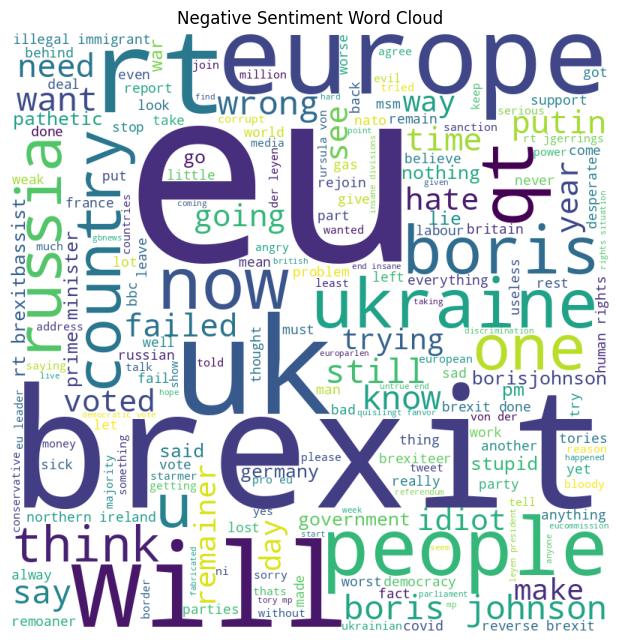

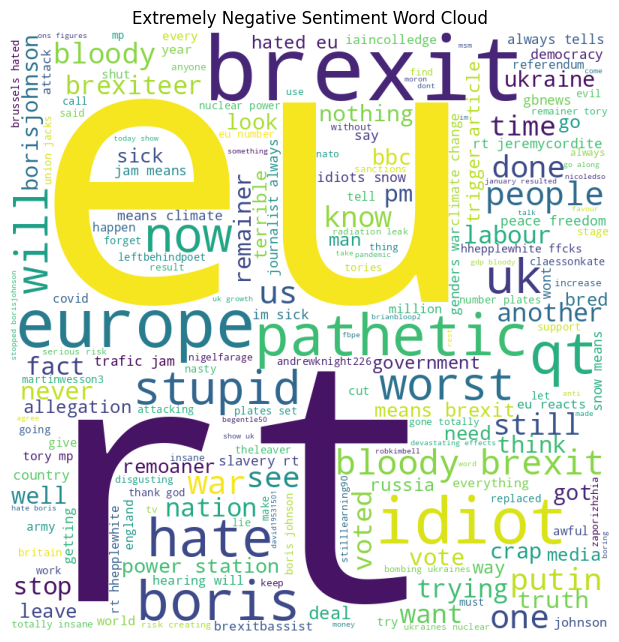

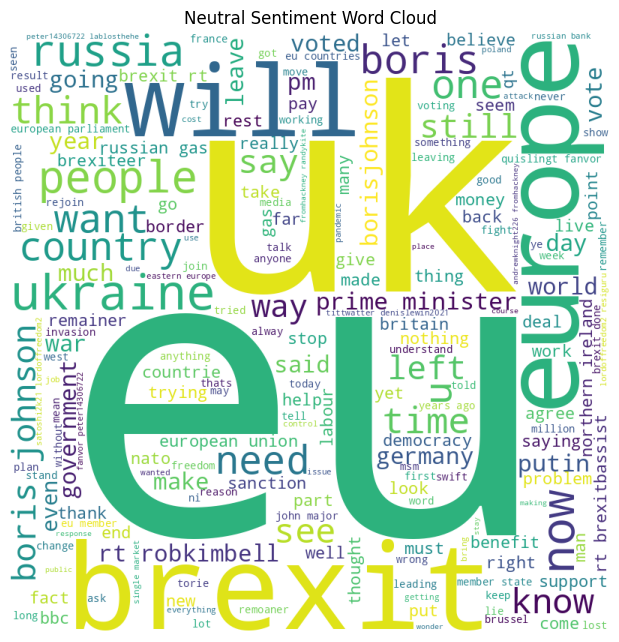

In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

# Filter the DataFrame for each sentiment label
extremely_positive_df = df_pro[df_pro['textblob_sentiment_category'] == 'Extremely Positive']
positive_df = df_pro[df_pro['textblob_sentiment_category'] == 'Positive']
negative_df = df_pro[df_pro['textblob_sentiment_category'] == 'Negative']
extremely_negative_df = df_pro[df_pro['textblob_sentiment_category'] == 'Extremely Negative']
neutral_df = df_pro[df_pro['textblob_sentiment_category'] == 'Neutral']

# Combine text for each sentiment
extremely_positive_text = " ".join(extremely_positive_df['cleaned_text'])
positive_text = " ".join(str(text) for text in positive_df['cleaned_text'])
negative_text = " ".join(str(text) for text in negative_df['cleaned_text'])
extremely_negative_text = " ".join(str(text) for text in extremely_negative_df['cleaned_text'])
neutral_text = " ".join(str(text) for text in neutral_df['cleaned_text'])

# Create WordCloud objects
stopwords = set(STOPWORDS)
wordcloud_ep = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_positive_text)
wordcloud_p = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(positive_text)
wordcloud_n = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(negative_text)
wordcloud_en = WordCloud(width = 800, height = 800,
                background_color ='white',
                stopwords = stopwords,
                min_font_size = 10).generate(extremely_negative_text)

wordcloud_ne = WordCloud(width = 800, height = 800,
                background_color = 'white',
                stopwords = stopwords,
                min_font_size = 10).generate(neutral_text)

# Plot the WordClouds
plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ep)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_p)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Positive Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_n)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_en)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Extremely Negative Sentiment Word Cloud")
plt.show()

plt.figure(figsize = (6, 6), facecolor = None)
plt.imshow(wordcloud_ne)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.title("Neutral Sentiment Word Cloud")
plt.show()


# 4.5 TextBlob via BERT Model

In [ ]:
import torch
from transformers import BertTokenizer, BertForSequenceClassification, DistilBertTokenizer, DistilBertForSequenceClassification, Trainer, TrainingArguments
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, f1_score, recall_score, precision_score, confusion_matrix
from torch.utils.data import DataLoader, Dataset

# Define a custom Dataset class
class TextDataset(Dataset):
    def __init__(self, texts, labels, tokenizer, max_len):
        self.texts = texts
        self.labels = labels
        self.tokenizer = tokenizer
        self.max_len = max_len

    def __len__(self):
        return len(self.texts)

    def __getitem__(self, idx):
        text = self.texts[idx]
        label = self.labels[idx]

        encoding = self.tokenizer.encode_plus(
            text,
            add_special_tokens=True,
            max_length=self.max_len,
            return_token_type_ids=False,
            padding='max_length',
            return_attention_mask=True,
            return_tensors='pt',
            truncation=True
        )

        return {
            'text': text,
            'input_ids': encoding['input_ids'].flatten(),
            'attention_mask': encoding['attention_mask'].flatten(),
            'label': torch.tensor(label, dtype=torch.long)
        }

# Prepare the data for BERT and DistilBERT
def prepare_data(df, tokenizer, max_len, batch_size):
    le = LabelEncoder()
    df['label'] = le.fit_transform(df['textblob_sentiment_category'])

    train_texts, val_texts, train_labels, val_labels = train_test_split(
        df['cleaned_text'].values,
        df['label'].values,
        test_size=0.1,
        random_state=42
    )

    train_dataset = TextDataset(
        texts=train_texts,
        labels=train_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    val_dataset = TextDataset(
        texts=val_texts,
        labels=val_labels,
        tokenizer=tokenizer,
        max_len=max_len
    )

    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size)

    return train_loader, val_loader, val_labels, le

# Define evaluation metrics
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    acc = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    recall = recall_score(labels, preds, average='weighted')
    precision = precision_score(labels, preds, average='weighted')
    return {
        'accuracy': acc,
        'f1': f1,
        'recall': recall,
        'precision': precision
    }


In [ ]:
# Set parameters
MAX_LEN = 128
BATCH_SIZE = 16

# Prepare data for BERT
bert_tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
train_loader, val_loader, val_labels, label_encoder = prepare_data(df_pro, bert_tokenizer, MAX_LEN, BATCH_SIZE)

# Initialize BERT model
bert_model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=5)

# Train BERT model with modified training arguments
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    evaluation_strategy="epoch",
    save_steps=500,
    save_total_limit=1
)

trainer = Trainer(
    model=bert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

# Save df_anti dataset
df_pro.to_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv')

# Print BERT evaluation results
val_accuracy = results['eval_accuracy']
print(f"Validation loss: {results['eval_loss']}")
print(f"Validation accuracy: {val_accuracy}")

# Confusion Matrix for BERT
preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
cm_bert = confusion_matrix(val_labels, preds)

# Compute additional metrics
accuracy = accuracy_score(val_labels, preds)
f1 = f1_score(val_labels, preds, average='weighted')
recall = recall_score(val_labels, preds, average='weighted')
precision = precision_score(val_labels, preds, average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1}")
print(f"Recall: {recall}")
print(f"Precision: {precision}")

# Print confusion matrix
print("Confusion Matrix for BERT:")
print(cm_bert)


# Save df_anti dataset
df_pro.to_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv')


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.227900,0.144096,0.956787,0.956889,0.956787,0.957112
2,0.129700,0.120101,0.970062,0.969853,0.970062,0.969989
3,0.049100,0.119409,0.974465,0.974376,0.974465,0.974383


Validation loss: 0.11940927058458328
Validation accuracy: 0.9744649146572745
Accuracy: 0.9744649146572745
F1 Score: 0.9743759829821212
Recall: 0.9744649146572745
Precision: 0.9743831991498323
Confusion Matrix for BERT:
[[   70     0     4     1     0]
 [    0   200     0     7     9]
 [    8     0  1143    79     1]
 [    0     2    49 10187    79]
 [    0     6     1   131  2787]]


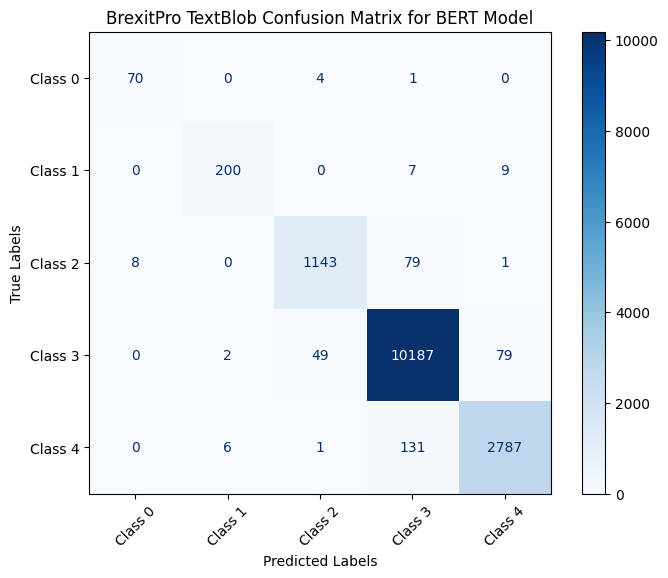

In [20]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 70,0,4,1,0],
 [ 0,200,0,7,9],
 [ 8,0,1143,79,1],
 [ 0,2,49,10187,79],
 [ 0,6,1,131,2787]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('BrexitPro TextBlob Confusion Matrix for BERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()

# 4.6 TextBlob via DistilBERT Model

In [ ]:
# Prepare data for DistilBERT
distilbert_tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
train_loader, val_loader, val_labels, label_encoder = prepare_data(df_pro, distilbert_tokenizer, MAX_LEN, BATCH_SIZE)

# Initialize DistilBERT model
distilbert_model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=5)

# Train DistilBERT model with modified training arguments
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=3,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    warmup_steps=500,
    weight_decay=0.01,
    logging_dir='./logs',
    logging_steps=10,
    evaluation_strategy="epoch",
    save_steps=500,
    save_total_limit=1
)

trainer = Trainer(
    model=distilbert_model,
    args=training_args,
    train_dataset=train_loader.dataset,
    eval_dataset=val_loader.dataset,
    compute_metrics=compute_metrics
)

trainer.train()
results = trainer.evaluate()

df_pro.to_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv')

# Print DistilBERT evaluation results
val_accuracy = results['eval_accuracy']
print(f"Validation loss: {results['eval_loss']}")
print(f"Validation accuracy: {val_accuracy}")

# Confusion Matrix for DistilBERT
preds = trainer.predict(val_loader.dataset).predictions.argmax(-1)
cm_distilbert = confusion_matrix(val_labels, preds)

# Compute additional metrics
accuracy = accuracy_score(val_labels, preds)
f1 = f1_score(val_labels, preds, average='weighted')
recall = recall_score(val_labels, preds, average='weighted')
precision = precision_score(val_labels, preds, average='weighted')

print(f"Accuracy: {accuracy}")
print(f"F1 Score: {f1}")
print(f"Recall: {recall}")
print(f"Precision: {precision}")

# Print confusion matrix
print("Confusion Matrix for DistilBERT:")
print(cm_distilbert)

# Save dataframe to CSV
df_pro.to_csv('/content/drive/MyDrive/Colab Notebooks/df_pro_updated.csv', index=False)

Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


Epoch,Training Loss,Validation Loss,Accuracy,F1,Recall,Precision
1,0.183600,0.165253,0.951910,0.951992,0.951910,0.952865
2,0.139900,0.128310,0.965660,0.965253,0.965660,0.965658
3,0.048700,0.117129,0.974059,0.973982,0.974059,0.973983


Validation loss: 0.11712872982025146
Validation accuracy: 0.9740585207260904
Accuracy: 0.9740585207260904
F1 Score: 0.9739822198537039
Recall: 0.9740585207260904
Precision: 0.9739826844390175
Confusion Matrix for DistilBERT:
[[   69     0     4     2     0]
 [    0   201     0     6     9]
 [    5     0  1155    71     0]
 [    0     0    53 10177    87]
 [    0     4     1   141  2779]]


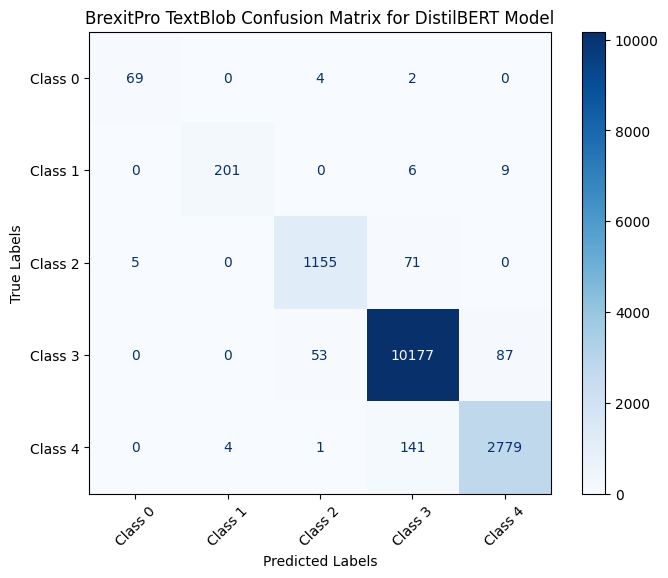

In [21]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import ConfusionMatrixDisplay

# Provided confusion matrix for BERT
cm = np.array([
 [ 69,0,4,2,0],
 [ 0,201,0,6,9],
 [ 5,0,1155,71,0],
 [ 0,0,53,10177,87],
 [ 0,4,1,141,2779]
])

# Define class labels
class_labels = ['Class 0', 'Class 1', 'Class 2', 'Class 3', 'Class 4']

# Create and plot the confusion matrix
fig, ax = plt.subplots(figsize=(8, 6))
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_labels)
disp.plot(cmap=plt.cm.Blues, ax=ax, values_format='g')  # 'g' formats numbers as integers
plt.title('BrexitPro TextBlob Confusion Matrix for DistilBERT Model')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(rotation=45)
plt.show()